In [4]:
import numpy as np
from scipy.sparse import csc_matrix, eye, diags
from scipy.sparse.linalg import spsolve

# Khởi tạo một số hàm khử nhiễu dao động
def WhittakerSmooth(x,w,lambda_,differences=1):
    '''
    Penalized least squares algorithm for background fitting
    
    input
        x: input data (i.e. chromatogram of spectrum)
        w: binary masks (value of the mask is zero if a point belongs to peaks and one otherwise)
        lambda_: parameter that can be adjusted by user. The larger lambda is,  the smoother the resulting background
        differences: integer indicating the order of the difference of penalties
    
    output
        the fitted background vector
    '''
    X=np.matrix(x)
    m=X.size
    E=eye(m,format='csc')
    for i in range(differences):
        E=E[1:]-E[:-1] # numpy.diff() does not work with sparse matrix. This is a workaround.
    W=diags(w,0,shape=(m,m))
    A=csc_matrix(W+(lambda_*E.T*E))
    B=csc_matrix(W*X.T)
    background=spsolve(A,B)
    return np.array(background)

def airPLS(x, lambda_=100, porder=1, itermax=15):
    '''
    Adaptive iteratively reweighted penalized least squares for baseline fitting
    
    input
        x: input data (i.e. chromatogram of spectrum)
        lambda_: parameter that can be adjusted by user. The larger lambda is,  the smoother the resulting background, z
        porder: adaptive iteratively reweighted penalized least squares for baseline fitting
    
    output
        the fitted background vector
    '''
    m=x.shape[0]
    w=np.ones(m)
    for i in range(1,itermax+1):
        z=WhittakerSmooth(x,w,lambda_, porder)
        d=x-z
        dssn=np.abs(d[d<0].sum())
        if(dssn<0.001*(abs(x)).sum() or i==itermax):
            if(i==itermax): print('WARING max iteration reached!')
            break
        w[d>=0]=0 # d>0 means that this point is part of a peak, so its weight is set to 0 in order to ignore it
        w[d<0]=np.exp(i*np.abs(d[d<0])/dssn)
        w[0]=np.exp(i*(d[d<0]).max()/dssn) 
        w[-1]=w[0]
    return z


# Sinh dữ liệu

In [32]:
import numpy as np

def poly_baseline(x):
    p = np.random.uniform(1, 3)  # Polynomial degree between 1 and 3
    intensity = np.random.uniform(0.5, 2)  # Amplitude between 0.5 and 2
    b = np.random.uniform(-0.3, 0.3)  # Offset between -0.3 and 0.3

    y = (x / len(x)) ** p + b
    return y * intensity 

def negative_poly_baseline(x):
    p = np.random.uniform(1, 3)  # Polynomial degree between 1 and 3
    intensity = np.random.uniform(0.5, 2)  # Amplitude between 0.5 and 2
    b = np.random.uniform(-0.3, 0.3)  # Offset between -0.3 and 0.3

    y = (x / len(x)) ** p + b
    return -1 * y * intensity 

def gaussian_baseline(x):
    mean = np.random.uniform(50, 250)  # Mean between 50 and 250
    sd = np.random.uniform(50, 150)  # Standard deviation between 50 and 150
    intensity = np.random.uniform(2, 5)  # Increased amplitude between 2 and 5
    b = np.random.uniform(-0.3, 0.3)  # Offset between -0.3 and 0.3


    y = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi)) + b
    return y * intensity 

def trigonometric_baseline(x):
    p = np.random.uniform(10, 8 * np.pi)
    intensity = np.random.uniform(0.5, 1.5)  # Amplitude between 0.5 and 1.5
    y = np.sin(p * x / len(x))
    if np.max(np.abs(y)) != 0:  # Avoid division by zero
        y = y / np.max(np.abs(y))
    return intensity * y + intensity

def generate_spectrum(input, num_baselines=2):
    x_range = np.linspace(0, input.shape[0] - 1, input.shape[0])

    # Ensure at least one baseline is applied
    while True:
        baseline_labels = np.random.randint(0, 2, size=num_baselines) 
        if np.any(baseline_labels != 0):  # Exit if at least one value is not 0
            break

    baselines = [poly_baseline, negative_poly_baseline, gaussian_baseline, trigonometric_baseline]

    # Ensure noisy_spectrum and applied_baselines are one-dimensional
    noisy_spectrum = np.copy(input).flatten()
    applied_baselines = np.zeros_like(noisy_spectrum)

    for i in range(num_baselines):
        if baseline_labels[i] == 1:
            baseline_func = baselines[i]
            baseline = baseline_func(x_range).flatten()
            noisy_spectrum += baseline
            applied_baselines += baseline

    return noisy_spectrum, baseline_labels, applied_baselines

In [5]:
import numpy as np

def poly_baseline(x):
    p = np.random.uniform(1, 3)
    intensity = np.random.uniform(0.5, 1.5)
    b = np.random.uniform(-0.3, 0.3)
    y = (x / len(x)) ** p
    return (y / y.max()) * intensity + b 

def negative_poly_baseline(x):
    p = np.random.uniform(1, 3)
    intensity = np.random.uniform(0.5, 1.5)
    b = np.random.uniform(-0.3, 0.3)
    y = (x / len(x)) ** p
    return (-y / y.max()) * intensity + b

def gaussian_baseline(x):
    mean = np.random.uniform(0, 50)
    sd = np.random.uniform(150, 250)
    intensity = np.random.uniform(0.5, 1.5)
    b = np.random.uniform(-0.3, 0.3)
    y = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return (y / y.max()) * intensity + b

# Additional baselines combining polynomial and Gaussian
def pg_baseline(x):
    p = np.random.uniform(1, 3)
    intensity1, intensity2 = np.random.uniform(0.5, 1.5, 2)
    mean, sd = np.random.uniform(0, 50), np.random.uniform(400, 550)
    b = np.random.uniform(-0.3, 0.3)
    y1 = (x / len(x)) ** p
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return (y1 / y1.max() * intensity1 + y2 / y2.max() * intensity2) + b

def pd_baseline(x):
    p1, p2 = np.random.uniform(1, 3, 2)
    intensity1, intensity2 = np.random.uniform(0.5, 1.5, 2)
    b = np.random.uniform(-0.3, 0.3)
    y1 = (x / len(x)) ** p1
    y2 = -(x / len(x)) ** p2 + 1
    return (y1 / y1.max() * intensity1 + y2 / y2.max() * intensity2) + b

def dg_baseline(x):
    p = np.random.uniform(1, 3)
    intensity1, intensity2 = np.random.uniform(0.5, 1.5, 2)
    mean, sd = np.random.uniform(0, 50), np.random.uniform(400, 550)
    b = np.random.uniform(-0.3, 0.3)
    y1 = -(x / len(x)) ** p + 1
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return (y1 / y1.max() * intensity1 + y2 / y2.max() * intensity2) + b

def pdg_baseline(x):
    p1, p2 = np.random.uniform(1, 3, 2)
    intensity1, intensity2, intensity3 = np.random.uniform(0.5, 1.5, 3)
    mean, sd = np.random.uniform(0, 50), np.random.uniform(400, 550)
    b = np.random.uniform(-0.3, 0.3)
    y1 = (x / len(x)) ** p1
    y2 = -(x / len(x)) ** p2 + 1
    y3 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return (y1 / y1.max() * intensity1 + y2 / y2.max() * intensity2 + y3 / y3.max() * intensity3) + b

def polynomial_baseline(x):
    a, b, c, d, e = np.random.uniform(-1e-3, 1e-3, 5)
    y = a * x**4 + b * x**3 + c * x**2 + d * x + e
    return y

def polynomial_baseline2(x):
    a, b, c, d, e, f = np.random.uniform(-1e-3, 1e-3, 6)
    y = a * x**5 + b * x**4 + c * x**3 + d * x**2 + e * x + f
    return y

# Generate spectrum with multiple baseline functions and output baseline labels
def generate_spectrum(input, num_baselines=3):
    x_range = np.linspace(0, input.shape[0] - 1, input.shape[0])
    
    while True:
        baseline_labels = np.random.randint(0, 2, size=num_baselines) 
        if np.any(baseline_labels != 0):  # Exit if at least one value is not 0
            break

    baselines = [poly_baseline, negative_poly_baseline, gaussian_baseline]

    # Ensure noisy_spectrum and applied_baselines are one-dimensional
    noisy_spectrum = np.copy(input).flatten()
    applied_baselines = np.zeros_like(noisy_spectrum)

    for i in range(num_baselines):
        if baseline_labels[i] == 1:
            baseline_func = baselines[i]
            baseline = baseline_func(x_range).flatten()
            noisy_spectrum += baseline
            applied_baselines += baseline

    return noisy_spectrum, baseline_labels, applied_baselines


In [6]:
import pandas as pd
import numpy as np
# Tạo dữ liệu cho 20,000 mẫu
num_samples = 5000
all_noisy_spectra = []
all_baseline_labels = []
all_baseline_applied = []

print("đang chạy")
# Load dataset
Input_Data = './data/dataset_pure_132.npy'
Inputs = np.load(Input_Data)

Inputs = Inputs.reshape(-1, Inputs.shape[2], Inputs.shape[3], Inputs.shape[4])
for inputs in Inputs:
    noisy_spectrum, baseline_labels, baseline_applied = generate_spectrum(inputs[1, : , :], num_baselines=3)
    all_baseline_labels.append(baseline_labels)  # Sử dụng np.ravel() để biến mảng thành mảng một chiều
    all_noisy_spectra.append(noisy_spectrum.flatten())  # Sử dụng np.ravel() để biến mảng thành mảng một chiều
    all_baseline_applied.append(baseline_applied.flatten())

# Chuyển đổi danh sách thành mảng numpy
all_baseline_labels = np.array(all_baseline_labels)
all_noisy_spectra = np.array(all_noisy_spectra)
all_baseline_applied = np.array(all_baseline_applied)

# Tạo DataFrame từ dữ liệu
df_labels = pd.DataFrame(all_baseline_labels)  # Tạo DataFrame cho labels
df_spectra = pd.DataFrame(all_noisy_spectra)  # Tạo DataFrame cho dữ liệu spectrum
df_basline = pd.DataFrame(all_baseline_applied)

# Kết hợp DataFrame cho labels và dữ liệu spectrum
df = pd.concat([df_labels, df_spectra, df_basline], axis=1)

# Lưu DataFrame vào file CSV
df.to_csv('./data/Baseline_noise_132.csv', index=False)
print("ok")

đang chạy
ok


In [207]:
import numpy as np
import pandas as pd

# Thiết lập số lượng mẫu cần sinh
num_samples = 3200
all_noisy_spectra = []
all_baseline_labels = []
all_baseline_applied = []

# Load dataset
Input_Data = './data/dataset_noise_pure_1411.npy'
Inputs = np.load(Input_Data)
Inputs = Inputs.reshape(-1, Inputs.shape[2], Inputs.shape[3], Inputs.shape[4])

# Sinh 3200 mẫu
sample_count = 0
for inputs in Inputs:
    if sample_count >= num_samples:
        break
    noisy_spectrum, baseline_labels, baseline_applied = generate_spectrum(inputs[1, :, :], num_baselines=3)
    
    all_baseline_labels.append(baseline_labels.flatten())
    all_noisy_spectra.append(noisy_spectrum.flatten())
    all_baseline_applied.append(baseline_applied.flatten())
    
    sample_count += 1  # Tăng số lượng mẫu đã sinh lên 1

# Chuyển đổi danh sách thành mảng numpy
all_baseline_labels = np.array(all_baseline_labels)
all_noisy_spectra = np.array(all_noisy_spectra)
all_baseline_applied = np.array(all_baseline_applied)

print(all_baseline_applied.shape)

# Tạo DataFrame từ dữ liệu
df_labels = pd.DataFrame(all_baseline_labels)  # Tạo DataFrame cho labels
df_spectra = pd.DataFrame(all_noisy_spectra)  # Tạo DataFrame cho dữ liệu spectrum
df_basline = pd.DataFrame(all_baseline_applied)

# Kết hợp DataFrame cho labels và dữ liệu spectrum
df = pd.concat([df_labels, df_spectra, df_basline], axis=1)

# Lưu DataFrame vào file CSV
df.to_csv('./data/Baseline_test_1811.csv', index=False)
print('ok')


(3200, 880)
ok


In [7]:
import pandas as pd
import tensorflow as tf
# Đọc dữ liệu từ tệp CSV vào DataFrame, bỏ qua dòng đầu tiên
df = pd.read_csv("./data/Baseline_noise_132.csv", skiprows=1, header=None)

# Chuyển đổi DataFrame thành mảng numpy
data_array = df.values

print("Đọc dữ liệu")
# Tách nhãn từ dữ liệu
y_train = data_array[:, :3]
y_train = tf.cast(y_train, tf.float32)

# Tách dữ liệu vào x_train
x_train = data_array[:, 3:883]
baseline_train = data_array[:, 883:]

# Hiển thị kích thước của x_train và y_train+
print("Kích thước x_train:", x_train.shape)
print("Kích thước y_train:", y_train.shape)
print("Kích thước baseline_train:", baseline_train.shape)

2025-02-13 04:24:29.053218: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-02-13 04:24:29.134146: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-02-13 04:24:29.168525: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-02-13 04:24:29.177526: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-13 04:24:29.236940: I tensorflow/core/platform/cpu_feature_guar

Đọc dữ liệu
Kích thước x_train: (15000, 880)
Kích thước y_train: (15000, 3)
Kích thước baseline_train: (15000, 880)


I0000 00:00:1739395481.758801    3414 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1739395481.993504    3414 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1739395481.993600    3414 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1739395482.012216    3414 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1739395482.012313    3414 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:0

In [8]:
import tensorflow as tf
from tensorflow import keras

def ConvClassifica():
    input = tf.keras.layers.Input((880,))
    input_reshaped = tf.keras.layers.Reshape((880, 1))(input)  # Reshape to (880, 1) for Conv1D compatibility
    conv1 = tf.keras.layers.Conv1D(filters=16, kernel_size=5, strides=1, activation='relu')(input_reshaped)
    pool1 = tf.keras.layers.AveragePooling1D(pool_size=2, strides=2)(conv1)
    flatten = tf.keras.layers.Flatten()(pool1)
    fc1 = tf.keras.layers.Dense(100, activation='relu')(flatten)
    fc2 = tf.keras.layers.Dense(3, activation='softmax')(fc1)  # Set units=3 and activation='softmax' for 3 classes
    model = tf.keras.Model(inputs=input, outputs=fc2)
    return model

# Example usage:

# Tạo một thể hiện của mạng ConvClassifica
model = ConvClassifica()

# Kiểm tra kiến trúc của mô hình TensorFlow
model.summary()
# model = ConvClassifica()
# model.load_weights('model_1811.weights.h5')

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 880)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 880, 1)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d (Conv1D)                 │ (None, 876, 16)        │            96 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling1d               │ (None, 438, 16)        │             0 │
│ (AveragePooling1D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 7008)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │       700,900 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │           303 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 701,299 (2.68 MB)

 Trainable params: 701,299 (2.68 MB)

 Non-trainable params: 0 (0.00 B)

In [9]:
import tensorflow as tf
import tensorflow.keras.backend as K

spectra_num = len(x_train)
train_split = round(0.8 * spectra_num)
val_split = round(0.2 * spectra_num)

x_trainn = x_train[:train_split]
x_test = x_train[train_split:train_split + val_split]

y_trainn = y_train[:train_split]
y_test = y_train[train_split:train_split + val_split]

# Create Dataset for training and testing
train_dataset = tf.data.Dataset.from_tensor_slices((x_trainn, y_trainn)).batch(64)
test_dataset = tf.data.Dataset.from_tensor_slices((x_test, y_test)).batch(32)

# Define custom Hamming loss functions
def Custom_Hamming_Loss(y_true, y_pred):
    return K.mean(y_true * (1 - y_pred) + (1 - y_true) * y_pred)

def Custom_Hamming_Loss1(y_true, y_pred):
    tmp = K.abs(y_true - y_pred)
    return K.mean(K.cast(K.greater(tmp, 0.5), dtype=tf.float32))

# Compile the model with the specified optimizer, loss function, and metrics
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy', Custom_Hamming_Loss, Custom_Hamming_Loss1])

# Train the model
history = model.fit(train_dataset, validation_data=test_dataset, epochs=50)

# Save the model weights
model.save_weights('./model_132.weights.h5')


Epoch 1/50


I0000 00:00:1739395485.416473    4773 service.cc:146] XLA service 0x7fab840048e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1739395485.416660    4773 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2025-02-13 04:24:45.473970: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-02-13 04:24:45.758446: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907
2025-02-13 04:24:46.805103: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_550', 16 bytes spill stores, 16 bytes spill loads



 44/188 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6554 - custom__hamming__loss: 0.2940 - custom__hamming__loss1: 0.2826 - loss: 0.3636

I0000 00:00:1739395490.212336    4773 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


187/188 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6366 - custom__hamming__loss: 0.2607 - custom__hamming__loss1: 0.2550 - loss: 0.2788

2025-02-13 04:24:51.409017: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_550', 16 bytes spill stores, 16 bytes spill loads



188/188 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - accuracy: 0.6364 - custom__hamming__loss: 0.2605 - custom__hamming__loss1: 0.2549 - loss: 0.2782 - val_accuracy: 0.6180 - val_custom__hamming__loss: 0.2492 - val_custom__hamming__loss1: 0.2480 - val_loss: 0.1837
Epoch 2/50
188/188 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6237 - custom__hamming__loss: 0.2350 - custom__hamming__loss1: 0.2343 - loss: 0.1832 - val_accuracy: 0.6220 - val_custom__hamming__loss: 0.2485 - val_custom__hamming__loss1: 0.2482 - val_loss: 0.1703
Epoch 3/50
188/188 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.6460 - custom__hamming__loss: 0.2345 - custom__hamming__loss1: 0.2341 - loss: 0.1705 - val_accuracy: 0.6427 - val_custom__hamming__loss: 0.2483 - val_custom__hamming__loss1: 0.2482 - val_loss: 0.1655
Epoch 4/50
188/188 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6743 - custom__hamming__loss: 0.2341 - custom__hamming__loss1: 0.2339 - loss: 0.1607 - val_accuracy: 0.6707 - val_custom__hamming__loss: 0.2481 -

In [3]:
import tensorflow as tf
from tensorflow import keras

def ConvClassifica():
    input = tf.keras.layers.Input((880,))
    input_reshaped = tf.keras.layers.Reshape((880, 1))(input)  # Reshape to (880, 1) for Conv1D compatibility
    conv1 = tf.keras.layers.Conv1D(filters=16, kernel_size=5, strides=1, activation='relu')(input_reshaped)
    pool1 = tf.keras.layers.AveragePooling1D(pool_size=2, strides=2)(conv1)
    flatten = tf.keras.layers.Flatten()(pool1)
    fc1 = tf.keras.layers.Dense(100, activation='relu')(flatten)
    fc2 = tf.keras.layers.Dense(3, activation='softmax')(fc1)  # Set units=3 and activation='softmax' for 3 classes
    model = tf.keras.Model(inputs=input, outputs=fc2)
    return model

# Example usage:

# Tạo một thể hiện của mạng ConvClassifica
model = ConvClassifica()

# Kiểm tra kiến trúc của mô hình TensorFlow
model.summary()
# model = ConvClassifica()
model.load_weights('model_1811.weights.h5')

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 880)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 880, 1)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d (Conv1D)                 │ (None, 876, 16)        │            96 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ average_pooling1d               │ (None, 438, 16)        │             0 │
│ (AveragePooling1D)              │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 7008)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │       700,900 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │           303 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 701,299 (2.68 MB)

 Trainable params: 701,299 (2.68 MB)

 Non-trainable params: 0 (0.00 B)

In [10]:
# Chọn một mẫu dữ liệu từ x_train
sample_index = 80
sample_data = x_train[sample_index]

# Chuẩn bị mẫu dữ liệu này để phù hợp với đầu vào của mô hình
sample_data = tf.expand_dims(sample_data, axis=0)  # Thêm chiều batch

# Sử dụng mô hình để dự đoán đầu ra cho mẫu dữ liệu đã chọn
predicted_output = model.predict(sample_data)
print("Ground True output for sample", y_train[sample_index])
print("Predicted output for sample", sample_index, ":", predicted_output)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step
Ground True output for sample tf.Tensor([0. 0. 1.], shape=(3,), dtype=float32)
Predicted output for sample 80 : [[1.9768047e-05 7.7499688e-05 9.9990273e-01]]


In [212]:
import numpy as np
from scipy.optimize import curve_fit

def poly_baseline(x, p, intensity, b):
    y = (x / len(x)) ** p + b
    return y * intensity 

def gaussian_baseline(x, mean, sd, intensity, b):
    y = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi)) + b
    return y * intensity 

def pg_baseline(x, p, in1, mean, sd, in2, b):
    y1 = (x / len(x)) ** p + b
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi)) + b
    return y1 * in1 + y2 * in2

def mix_min(sp, baseline ,Previous_Dev):
    # new_baseline = np.minimum(baseline,sp)
    condition1 = (sp > baseline)
    condition1_2 = (sp < baseline + Previous_Dev)
    condition2_2 = (baseline - Previous_Dev < sp)
    # new_baseline = np.where(sp < baseline + Previous_Dev, sp, baseline + Previous_Dev)
    new_baseline = np.where(condition1, np.where(condition1_2, sp, baseline + Previous_Dev), np.where(condition2_2, baseline - Previous_Dev, sp))

    return new_baseline

def iterative_fitting_with_bounds(sp, ite):
    # Initialize the baseline
    fitted_baseline = np.zeros(880)
    #The bounds is in data_generatorf2.R
    x = np.linspace(1, 880, 880)
    tempb = sp
    torch_tempb = tf.expand_dims(tempb, axis=0)
    i = 0
    tem = []
    Previous_Dev = 0
    while i < ite:
        tadvice = model(torch_tempb)
        if i > 0:
            Previous_Dev = Dev
        if tadvice[0][0] >= 0.4 and tadvice[0][1] >= 0.4:
            p, c = curve_fit(pg_baseline, x, tempb, bounds=([1,0.5,300,50,0.5,-0.3],[3,2,580,150,2,0.3]), maxfev=100000)
            fitted_baseline = pg_baseline(x, p[0], p[1], p[2], p[3], p[4], p[5])
        elif tadvice[0][0] >= 0.4:
            p, c = curve_fit(poly_baseline, x, tempb, bounds=([1,0.5,-0.3],[3,2,0.3]),  maxfev=100000)
            fitted_baseline = poly_baseline(x, p[0], p[1], p[2])
        elif tadvice[0][1] >= 0.4:
            p, c = curve_fit(gaussian_baseline, x, tempb, bounds=([300,50,0.5,-0.3],[580,150,2,0.3]),  maxfev=100000)
            fitted_baseline = gaussian_baseline(x, p[0], p[1], p[2], p[3])
        Dev = np.std(tempb- abs(fitted_baseline))
        tempb = mix_min(sp, fitted_baseline, Dev)
        tem.append(tempb)
        # Convert to numpy array
        tempb_np = np.array(tempb)
        # Convert to tensor
        torch_tempb = tempb_np.reshape(1, 880)   
        i += 1
        if i >= 1:
            if np.abs((Dev-Previous_Dev)/Dev) < 0.005:
                break
    tadvice = model(torch_tempb)
    if tadvice[0][0] >= 0.3 and tadvice[0][1] >= 0.3:
                    p, c = curve_fit(pg_baseline, x, tempb, bounds=([1,0.5,300,50,0.5,-0.3],[3,2,580,150,2,0.3]),  maxfev=100000)
                    fitted_baseline = pg_baseline(x, p[0], p[1], p[2], p[3], p[4], p[5])
    elif tadvice[0][0] >= 0.3:
                    p, c = curve_fit(poly_baseline, x, tempb, bounds=([1,0.5,-0.3],[3,2,0.3]),  maxfev=100000)
                    fitted_baseline = poly_baseline(x, p[0], p[1], p[2])
    elif tadvice[0][1] >= 0.3:
                    p, c = curve_fit(gaussian_baseline, x, tempb, bounds=([300,50,0.5,-0.3],[580,150,2,0.3]), maxfev=100000)
                    fitted_baseline = gaussian_baseline(x, p[0], p[1], p[2], p[3])
    tempb_1 = fitted_baseline
    return tempb_1


In [213]:
from scipy.signal import savgol_filter
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

def mix_min(sp, baseline, Previous_Dev):
    condition1 = (sp > baseline)
    condition1_2 = (sp < baseline + Previous_Dev)
    condition2_2 = (baseline - Previous_Dev < sp)
    new_baseline = np.where(condition1, np.where(condition1_2, sp, baseline + Previous_Dev), np.where(condition2_2, baseline - Previous_Dev, sp))
    return new_baseline

def iterative_fitting_with_bounds(sp, ite):
    # Initialize the baseline
    fitted_baseline = np.zeros(880)
    #The bounds is in data_generatorf2.R
    x = np.linspace(1, 880, 880)
    tempb = sp
    torch_tempb = tf.expand_dims(tempb, axis=0)
    i = 0
    tem = []
    Previous_Dev = 0
    while i < ite:
        tadvice = model(torch_tempb)
        
        if i > 0:
            Previous_Dev = Dev  # Update Previous_Dev to current Dev from the previous iteration
        
        # Baseline fitting based on model advice
        if tadvice[0][0] >= 0.4 and tadvice[0][1] >= 0.4:
            p, _ = curve_fit(pg_baseline, x, tempb, bounds=([1, 0.5, 50, 50, 0.5, -0.3], [3, 2, 280, 150, 2, 0.3]), maxfev=100000)
            fitted_baseline = pg_baseline(x, *p)
        elif tadvice[0][0] >= 0.4:
            p, _ = curve_fit(poly_baseline, x, tempb, bounds=([1, 0.5, -0.3], [3, 2, 0.3]), maxfev=100000)
            fitted_baseline = poly_baseline(x, *p)
        elif tadvice[0][1] >= 0.4:
            p, _ = curve_fit(gaussian_baseline, x, tempb, bounds=([300, 50, 0.5, -0.3], [580, 150, 2, 0.3]), maxfev=100000)
            fitted_baseline = gaussian_baseline(x, *p)
        
        # Calculate deviation (Dev)
        Dev = np.std(tempb - np.abs(fitted_baseline))
        
        # Apply mix_min correction and update tempb
        tempb = mix_min(sp, fitted_baseline, Dev)
        tem.append(tempb)

        # Plotting at each iteration
        plt.figure(figsize=(10, 5))
        plt.plot(x, sp, label="Original Spectrum", color="gray")
        plt.plot(x, fitted_baseline, label=f"Fitted Baseline (Iteration {i+1})", color="blue")
        plt.plot(x, tempb, label="Updated Spectrum (tempb)", color="green")
        plt.plot(x, savgol_filter(baseline_data, window_length=11, polyorder=3), label="Smooth Spectrum (tempb)", color="red") 
        
        plt.title(f"Iteration {i+1}: Dev = {Dev:.4f}, Previous_Dev = {Previous_Dev:.4f}")
        plt.xlabel("Index")
        plt.ylabel("Intensity")
        plt.legend()
        plt.show()

        # Print Dev and Previous_Dev for detailed tracking
        print(f"Iteration {i+1} - Dev: {Dev:.4f}, Previous_Dev: {Previous_Dev:.4f}")

        # Early stopping condition
        if i >= 1 and np.abs((Dev - Previous_Dev) / Dev) < 0.005:
            print("Early stopping criteria met.")
            break

        i += 1

    return tempb


In [17]:
import numpy as np
from scipy.optimize import curve_fit
import numpy as np
from scipy.optimize import curve_fit

def poly_baseline(x, p, intensity, b):
    y = (x / len(x)) ** p
    return (y / y.max() if y.max() != 0 else y) * intensity + b 

def gaussian_baseline(x, mean, sd, intensity, b):
    y = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return (y / y.max() if y.max() != 0 else y) * intensity + b 

def pg_baseline(x, p, in1, mean, sd, in2, b):
    y1 = (x / len(x)) ** p
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2) + b

def negative_poly_baseline(x, p, intensity, b):
    y = -(x / len(x)) ** p
    return (y / y.max() if y.max() != 0 else y) * intensity + b 

def trigonometric_baseline(x, p, intensity):
    y = np.sin(p * x / len(x))
    return (y / np.max(np.abs(y)) if np.max(np.abs(y)) != 0 else y) * intensity + intensity

def pd_baseline(x, p1, in1, p2, in2, b):
    y1 = (x / len(x)) ** p1
    y2 = -(x / len(x)) ** p2 + 1
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2) + b

def dg_baseline(x, p, in1, mean, sd, in2, b):
    y1 = -(x / len(x)) ** p + 1
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2) + b

def pdg_baseline(x, p1, in1, p2, in2, mean, sd, in3, b):
    y1 = (x / len(x)) ** p1
    y2 = -(x / len(x)) ** p2 + 1
    y3 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2 + (y3 / y3.max() if y3.max() != 0 else y3) * in3) + b

def polynomial_baseline(x, a, b, c, d, e):
    y = a * x**4 + b * x**3 + c * x**2 + d * x + e
    return y / y.max() if y.max() != 0 else y  # Normalized if max != 0

def polynomial_baseline2(x, b, c, d, e, f, g):
    y = b * x**5 + c * x**4 + d * x**3 + e * x**2 + f * x + g
    return y / y.max() if y.max() != 0 else y  # Normalized if max != 0

# def mix_min(sp, baseline, Dev, ite):
#     """
#     Điều chỉnh baseline để nằm trong khoảng [baseline - Dev, baseline + Dev]
#     theo phương pháp học tập từ IModPoly.
# 
#     Parameters:
#         sp (np.array): Dữ liệu phổ gốc.
#         baseline (np.array): Đường baseline hiện tại.
#         Dev (float): Độ lệch chuẩn (Deviation) từ phổ đến baseline.
# 
#     Returns:
#         np.array: baseline mới sau khi điều chỉnh.
#     """
#     # Xác định các giới hạn trên và dưới cho baseline
#     upper_bound = baseline + Dev
#     lower_bound = baseline - Dev
# 
#     # Điều chỉnh baseline dựa trên giới hạn, giữ baseline gần sp nhất có thể
# 
#     if ite == 0:
#         new_baseline = np.where(
#         sp <= upper_bound, sp,  upper_bound)  # Nếu sp thấp hơn giới hạn dưới, gán bằng lower_bound, nếu không thì giữ nguyên sp
# 
#     else:
#         # Điều chỉnh baseline dựa trên giới hạn, giữ baseline gần sp nhất có thể
#         new_baseline = np.where(
#         sp > upper_bound, upper_bound,  # Nếu sp vượt giới hạn trên, gán bằng upper_bound
#         np.where(sp < lower_bound, lower_bound, sp)  # Nếu sp thấp hơn giới hạn dưới, gán bằng lower_bound, nếu không thì giữ nguyên sp
#     )
#     return new_baseline


def mix_min(sp, baseline, Dev, ite):
    """
    Điều chỉnh baseline để nằm trong khoảng [baseline - Dev, baseline + Dev].
    Đồng thời đảm bảo baseline không vượt quá sp.
    
    Parameters:
        sp (np.array): Dữ liệu phổ gốc.
        baseline (np.array): Đường baseline hiện tại.
        Dev (float): Độ lệch chuẩn (Deviation) từ phổ đến baseline.
        ite (int): Số lần lặp hiện tại.
    
    Returns:
        np.array: Baseline mới sau khi điều chỉnh.
    """
    # Xác định giới hạn trên và dưới
    upper_bound = baseline + Dev
    lower_bound = baseline - Dev

    # Điều chỉnh baseline dựa trên các giới hạn
    new_baseline = np.where(
        sp >= upper_bound, upper_bound,  # Nếu sp lớn hơn giới hạn trên, gán bằng upper_bound
        np.where(sp < lower_bound, lower_bound, baseline)  # Nếu nhỏ hơn giới hạn dưới, gán bằng lower_bound, nếu không giữ baseline
    )


    return new_baseline


# Hàm cập nhật danh sách dự đoán
def save_predicted_baseline(sample_index, iteration, baseline_name, params):
    all_predicted_baseline_details.append([sample_index, iteration, baseline_name] + list(params))

# Hàm fitting với lưu thông tin hệ số
def iterative_fitting_with_bounds(sp, ite, sample_index, threshold=0.005):
    x = np.linspace(1, 880, 880)  
    tempb = sp.copy()
    Previous_Dev = float('inf')  
    fitted_baseline = np.zeros(880)
    
    torch_tempb = np.expand_dims(tempb, axis=0)
   
    for i in range(ite):
        # Dự đoán loại baseline từ mô hình
        tadvice = model(torch_tempb)

        # Chọn baseline function dựa trên dự đoán
        if tadvice[0][0] > 0.5 and tadvice[0][1] > 0.5 and tadvice[0][2] > 0.5:
            baseline_name = "pdg_baseline"
            p, _ = curve_fit(pdg_baseline, x, tempb,
                             bounds=([1, 0.5, 1, 0.5, 0, 150, 0.5, -0.3],
                                     [3, 2, 3, 2, 50, 250, 2, 0.3]))
            fitted_baseline = pdg_baseline(x, *p)

        elif tadvice[0][0] > 0.5 and tadvice[0][1] > 0.5:
            baseline_name = "pd_baseline"
            p, _ = curve_fit(pd_baseline, x, tempb,
                             bounds=([1, 0.5, 1, 0.5, -0.3],
                                     [3, 2, 3, 2, 0.3]))
            fitted_baseline = pd_baseline(x, *p)

        elif tadvice[0][0] > 0.5 and tadvice[0][2] > 0.5:
            baseline_name = "pg_baseline"
            p, _ = curve_fit(pg_baseline, x, tempb,
                             bounds=([1, 0.5, 0, 150, 0.5, -0.3],
                                     [3, 2, 50, 250, 2, 0.3]))
            fitted_baseline = pg_baseline(x, *p)

        elif tadvice[0][1] > 0.5 and tadvice[0][2] > 0.5:
            baseline_name = "dg_baseline"
            p, _ = curve_fit(dg_baseline, x, tempb,
                             bounds=([1, 0.5, 0, 150, 0.5, -0.3],
                                     [3, 2, 50, 250, 2, 0.3]))
            fitted_baseline = dg_baseline(x, *p)

        elif tadvice[0][0] > 0.5:
            baseline_name = "poly_baseline"
            p, _ = curve_fit(poly_baseline, x, tempb,
                             bounds=([1, 0.5, -0.3], [3, 2, 0.3]))
            fitted_baseline = poly_baseline(x, *p)

        elif tadvice[0][1] > 0.5:
            baseline_name = "negative_poly_baseline"
            p, _ = curve_fit(negative_poly_baseline, x, tempb,
                             bounds=([1, 0.5, -0.3], [3, 2, 0.3]))
            fitted_baseline = negative_poly_baseline(x, *p)

        elif tadvice[0][2] > 0.5:
            baseline_name = "gaussian_baseline"
            p, _ = curve_fit(gaussian_baseline, x, tempb,
                             bounds=([0, 150, 0.5, -0.3], [50, 250, 2, 0.3]))
            fitted_baseline = gaussian_baseline(x, *p)

        else:
            continue  # Không áp dụng baseline nào

        # Lưu hệ số dự đoán vào danh sách
        save_predicted_baseline(sample_index, i, baseline_name, p)

        # Cập nhật giá trị phổ để tiếp tục lặp
        Dev = np.std(tempb - fitted_baseline)
        tempb = mix_min(sp, fitted_baseline, Dev, i)
        
        torch_tempb = np.expand_dims(tempb, axis=0)

        # Kiểm tra điều kiện dừng sớm
        if i > 0 and np.abs((Dev - Previous_Dev) / Dev) < threshold:
            break
        Previous_Dev = Dev

    return fitted_baseline

In [215]:
import numpy as np
from scipy.optimize import curve_fit

def poly_baseline(x, p, intensity, b):
    y = (x / len(x)) ** p + b
    return y * intensity 

def gaussian_baseline(x, mean, sd, intensity, b):
    y = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi)) + b
    return y * intensity 

def pg_baseline(x, p, in1, mean, sd, in2, b):
    y1 = (x / len(x)) ** p + b
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi)) + b
    return y1 * in1 + y2  * in2

def mix_min_no(sp, baseline):
    new_baseline = np.minimum(baseline,sp)    
    return new_baseline


def iterative_fitting_with_bounds_no(sp, ite):
    # Initialize the baseline
    fitted_baseline = np.zeros(880)
    #The bounds is in data_generatorf2.R
    x = np.linspace(1, 880, 880)
    tempb = sp
    torch_tempb = tf.expand_dims(tempb, axis=0)
    i = 0
    tem = []
    while i < ite:
        tadvice = model(torch_tempb)
        if tadvice[0][0] >= 0.4 and tadvice[0][1] >= 0.4:
            p, c = curve_fit(pg_baseline, x, tempb, bounds=([1,0.5,300,50,0.5,-0.3],[3,2,580,150,2,0.3]), maxfev=100000)
            fitted_baseline = pg_baseline(x, p[0], p[1], p[2], p[3], p[4], p[5])
        elif tadvice[0][0] >= 0.4:
            p, c = curve_fit(poly_baseline, x, tempb, bounds=([1,0.5,-0.3],[3,2,0.3]),  maxfev=100000)
            fitted_baseline = poly_baseline(x, p[0], p[1], p[2])
        elif tadvice[0][1] >= 0.4:
            p, c = curve_fit(gaussian_baseline, x, tempb, bounds=([300,50,0.5,-0.3],[580,150,2,0.3]),  maxfev=100000)
            fitted_baseline = gaussian_baseline(x, p[0], p[1], p[2], p[3])
        tempb = mix_min_no(tempb, fitted_baseline)
        tem.append(tempb)
        # Convert to numpy array
        tempb_np = np.array(tempb)
        # Convert to tensor
        torch_tempb = tempb_np.reshape(1, 880)  
        i += 1
        
    return tempb

In [27]:
import numpy as np
from scipy.optimize import curve_fit
import numpy as np
from scipy.optimize import curve_fit

def poly_baseline(x, p, intensity, b):
    y = (x / len(x)) ** p
    return (y / y.max() if y.max() != 0 else y) * intensity + b 

def gaussian_baseline(x, mean, sd, intensity, b):
    y = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return (y / y.max() if y.max() != 0 else y) * intensity + b 

def pg_baseline(x, p, in1, mean, sd, in2, b):
    y1 = (x / len(x)) ** p
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2) + b

def negative_poly_baseline(x, p, intensity, b):
    y = -(x / len(x)) ** p
    return (y / y.max() if y.max() != 0 else y) * intensity + b 

def trigonometric_baseline(x, p, intensity):
    y = np.sin(p * x / len(x))
    return (y / np.max(np.abs(y)) if np.max(np.abs(y)) != 0 else y) * intensity + intensity

def pd_baseline(x, p1, in1, p2, in2, b):
    y1 = (x / len(x)) ** p1
    y2 = -(x / len(x)) ** p2 + 1
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2) + b

def dg_baseline(x, p, in1, mean, sd, in2, b):
    y1 = -(x / len(x)) ** p + 1
    y2 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2) + b

def pdg_baseline(x, p1, in1, p2, in2, mean, sd, in3, b):
    y1 = (x / len(x)) ** p1
    y2 = -(x / len(x)) ** p2 + 1
    y3 = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return ((y1 / y1.max() if y1.max() != 0 else y1) * in1 + (y2 / y2.max() if y2.max() != 0 else y2) * in2 + (y3 / y3.max() if y3.max() != 0 else y3) * in3) + b


def polynomial_baseline(x, a, b, c, d, e):
    y = a * x**4 + b * x**3 + c * x**2 + d * x + e
    return y / y.max() if y.max() != 0 else y  # Normalized if max != 0

def polynomial_baseline2(x, b, c, d, e, f, g):
    y = b * x**5 + c * x**4 + d * x**3 + e * x**2 + f * x + g
    return y / y.max() if y.max() != 0 else y  # Normalized if max != 0

def mix_min_no(sp, baseline):
    new_baseline = np.minimum(baseline,sp)    
    return new_baseline

def iterative_fitting_with_bounds_no(sp, ite):
    x = np.linspace(1, 880, 880)  # Ensure x has 880 points
    tempb = sp
    i = 0
    fitted_baseline = np.zeros(880)
    torch_tempb = tf.expand_dims(tempb, axis=0)
   
        
    while i < ite:
        tadvice = model(torch_tempb)  # Get advice from the model
        # Get advice from the model
        # Select baseline function based on tadvice values
        if tadvice[0][0] > 0.4 and tadvice[0][1] > 0.4 and tadvice[0][2] > 0.4:
            p, _ = curve_fit(
                pdg_baseline, x, tempb,
                bounds=([1, 0.5, 1, 0.5, 0, 150, 0.5, -0.3], [3, 2, 3, 2, 50, 250, 1.5, 0.3])
            )
            fitted_baseline = pdg_baseline(x, *p)
        elif tadvice[0][0] > 0.4 and tadvice[0][1] > 0.4:
            p, _ = curve_fit(
                pd_baseline, x, tempb,
                bounds=([1, 0.5, 1, 0.5, -0.3], [3, 1.5, 3, 1.5, 0.3])
            )
            fitted_baseline = pd_baseline(x, *p)
        elif tadvice[0][0] > 0.4 and tadvice[0][2] > 0.4:
            p, _ = curve_fit(
                pg_baseline, x, tempb,
                bounds=([1, 0.5, 0, 150, 0.5, -0.3], [3, 1.5, 50, 250, 1.5, 0.3])
            )
            fitted_baseline = pg_baseline(x, *p)
        elif tadvice[0][1] > 0.4 and tadvice[0][2] > 0.4:
            p, _ = curve_fit(
                dg_baseline, x, tempb,
                bounds=([1, 0.5, 0, 150, 0.5, -0.3], [3, 1.5, 50, 250, 1.5, 0.3])
            )
            fitted_baseline = dg_baseline(x, *p)
        elif tadvice[0][0] > 0.4:
            p, _ = curve_fit(
                poly_baseline, x, tempb,
                bounds=([1, 0.5, -0.3], [3, 1.5, 0.3])
            )
            fitted_baseline = poly_baseline(x, *p)
        elif tadvice[0][1] > 0.4:
            p, _ = curve_fit(
                negative_poly_baseline, x, tempb,
                bounds=([1, 0.5, -0.3], [3, 1.5, 0.3])
            )
            fitted_baseline = negative_poly_baseline(x, *p)
        elif tadvice[0][2] > 0.4:
            p, _ = curve_fit(
                gaussian_baseline, x, tempb,
                bounds=([0, 150, 0.5, -0.3], [50, 250, 2, 0.3])
            )
            fitted_baseline = gaussian_baseline(x, *p)
        
        # # Handle cases when no dominant tadvice
        if max(tadvice[0]) <= 0.4:
             if tadvice[0][0] < 0.05 and tadvice[0][1] < 0.05 and tadvice[0][2] > 0.05:
                 p, _ = curve_fit(
                     gaussian_baseline, x, tempb,
                     bounds=([0, 150, 0.5, -0.3], [50, 250, 2, 0.3])
                 )
                 fitted_baseline = gaussian_baseline(x, *p)
             elif tadvice[0][0] < 0.05 and tadvice[0][2] < 0.05 and tadvice[0][1] > 0.05:
                 p, _ = curve_fit(
                     negative_poly_baseline, x, tempb,
                     bounds=([1, 0.5, -0.3], [3, 1.5, 0.3])
                 )
                 fitted_baseline = negative_poly_baseline(x, *p)
             elif tadvice[0][1] < 0.05 and tadvice[0][2] < 0.05 and tadvice[0][0] > 0.05:
                 p, _ = curve_fit(
                     poly_baseline, x, tempb,
                     bounds=([1, 0.5, -0.3], [3, 2, 0.3])
                 )
                 fitted_baseline = poly_baseline(x, *p)
             elif tadvice[0][0] < 0.05 and tadvice[0][1] > 0.05 and tadvice[0][2] > 0.05:
                 p, _ = curve_fit(
                     dg_baseline, x, tempb,
                     bounds=([1, 0.5, 0, 150, 0.5, -0.3], [3, 1.5, 50, 250, 1.5, 0.3])
                 )
                 fitted_baseline = dg_baseline(x, *p)
             elif tadvice[0][1] < 0.05 and tadvice[0][2] > 0.05 and tadvice[0][0] > 0.05:
                 p, _ = curve_fit(
                     pg_baseline, x, tempb,
                     bounds=([1, 0.5, 0, 150, 0.5, -0.3], [3, 1.5, 50, 250, 1.5, 0.3])
                 )
                 fitted_baseline = pg_baseline(x, *p)
             elif tadvice[0][0] > 0.05 and tadvice[0][1] > 0.05 and tadvice[0][2] < 0.05:
                 p, _ = curve_fit(
                     pd_baseline, x, tempb,
                     bounds=([1, 0.5, 1, 0.5, -0.3], [3, 1.5, 3, 1.5, 0.3])
                 )
                 fitted_baseline = pd_baseline(x, *p)
             elif all(t < 0.05 for t in tadvice[0]):
                 fitted_baseline = np.zeros(880)  # Zero baseline when all tadvice values are very low
         
        tempb = mix_min_no(tempb, fitted_baseline)
        tempb_np = np.array(tempb)
        # Convert to tensor
        torch_tempb = tempb_np.reshape(1, 880)

   
        if(max(tadvice[0])<0.01):
            #print(tadvice)
            break
        i += 1

    return tempb


In [13]:
import matplotlib.pyplot as plt
import tensorflow as tf
import pybaselines
import pandas as pd

# Đọc dữ liệu từ tệp CSV vào DataFrame, bỏ qua dòng đầu tiên
df = pd.read_csv("./data/Baseline_test_132.csv", skiprows=1, header=None)

# Chuyển đổi DataFrame thành mảng numpy
data_array = df.values

print("Đọc dữ liệu")

# Tách nhãn từ dữ liệu
y_train = data_array[:, :3]
y_train = tf.cast(y_train, tf.float32)

# Tách dữ liệu vào x_train và baseline_train
x_train = data_array[:, 3:883]
baseline_train = data_array[:, 883:]

Đọc dữ liệu


In [15]:
print(x_train.shape)
print(baseline_train.shape)
print(y_train.shape)
Input_Data = './data/dataset_pure_132.npy'

Inputs = np.load(Input_Data)
Inputs = Inputs.reshape(-1, Inputs.shape[2], Inputs.shape[3], Inputs.shape[4])
print(Inputs.shape)
input1 = Inputs[:,0,:,-1]
print(input1.size)
input2 = Inputs[:,1,:,-1]

(3200, 880)
(3200, 880)
(3200, 3)
(15000, 2, 880, 1)
13200000


tf.Tensor([[5.61613e-38 1.00000e+00 0.00000e+00]], shape=(1, 3), dtype=float32)


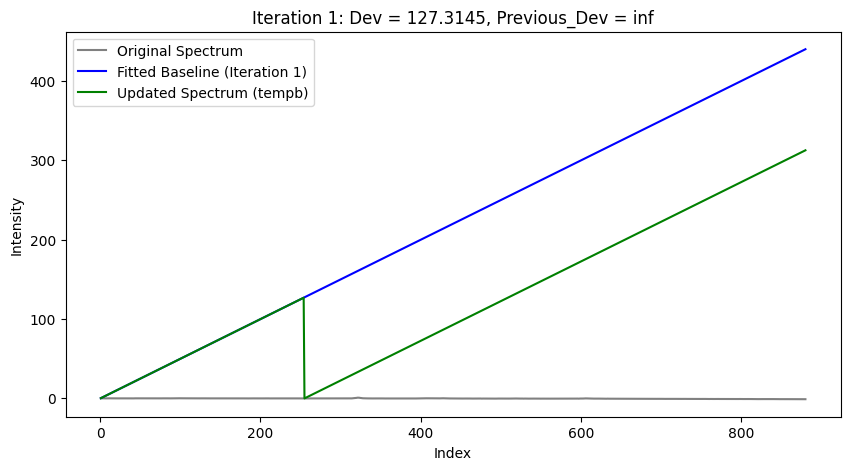

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


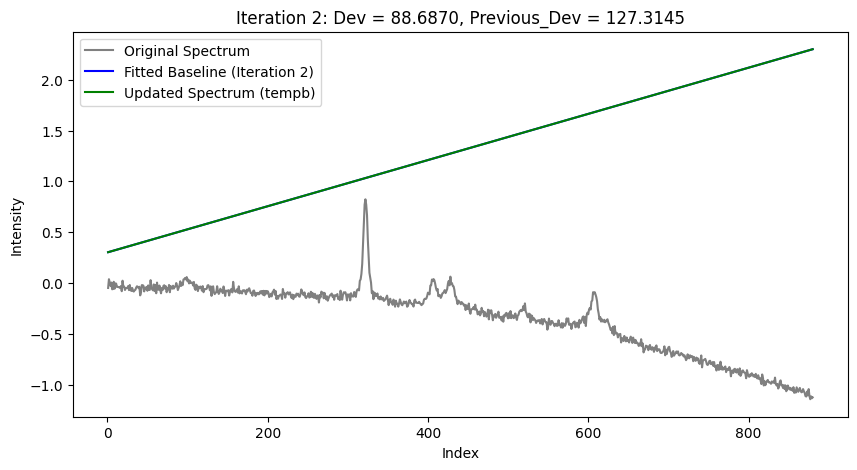

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


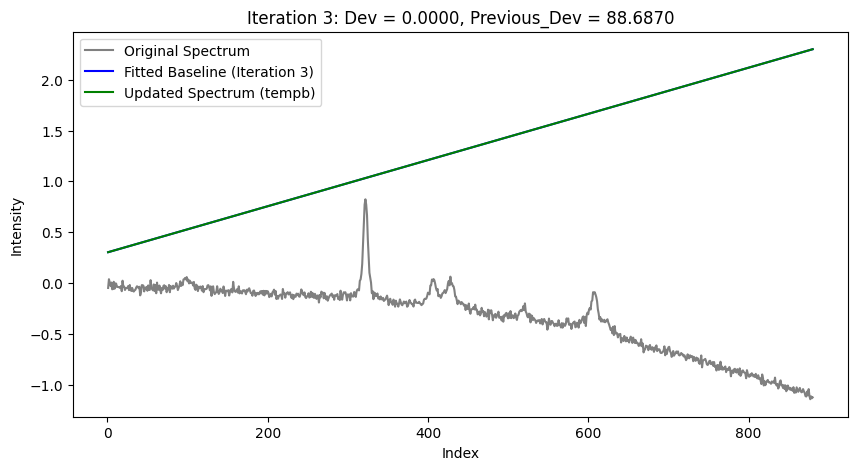

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


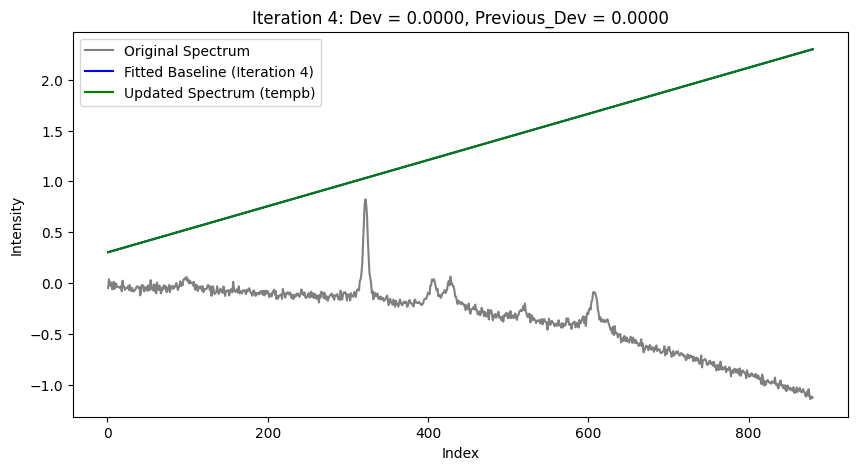

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


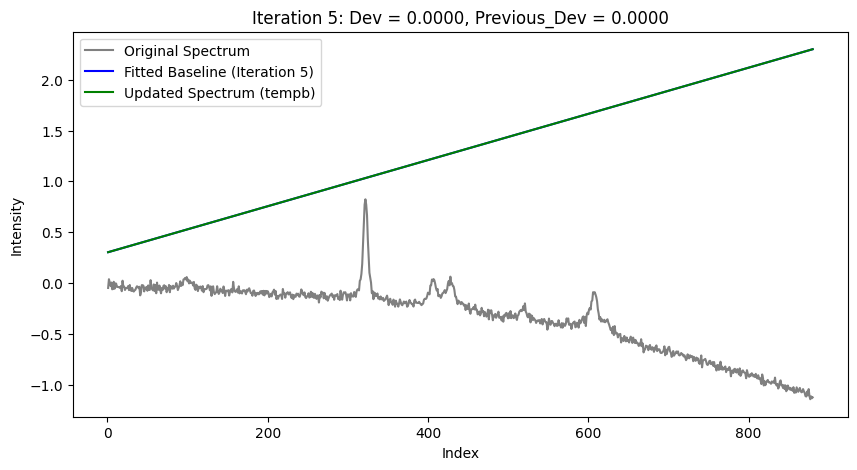

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


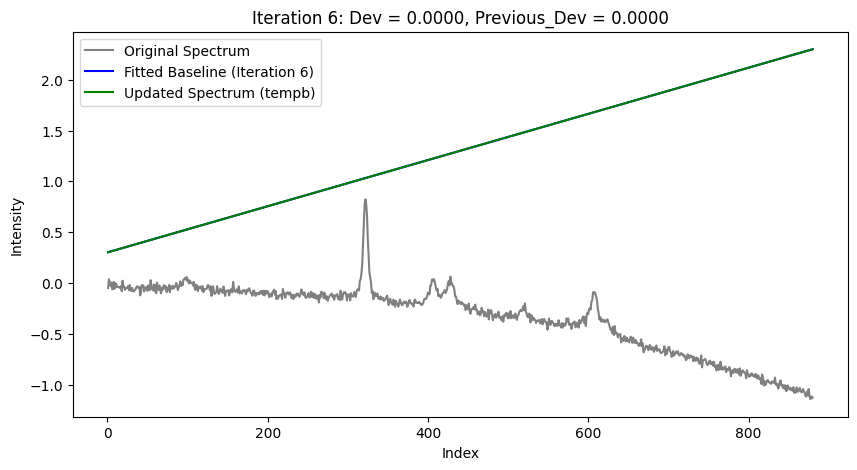

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


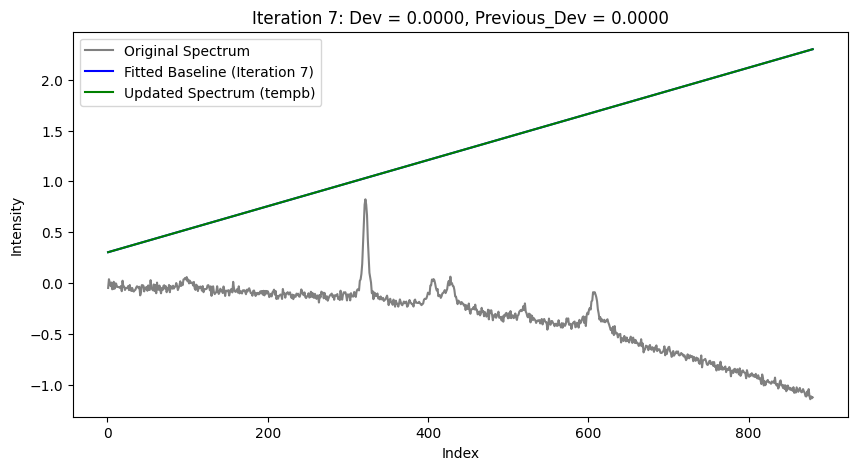

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


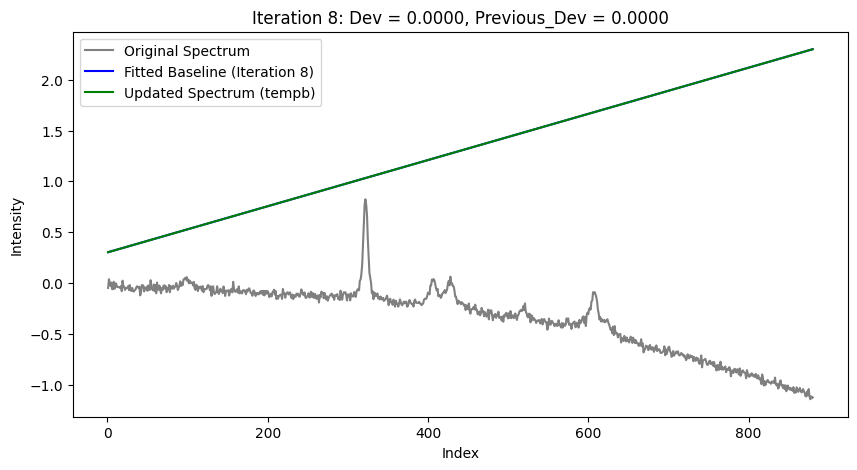

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


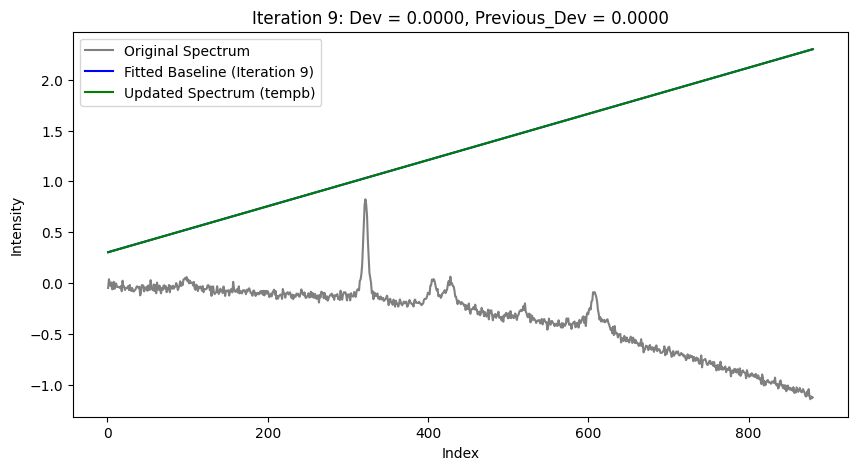

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


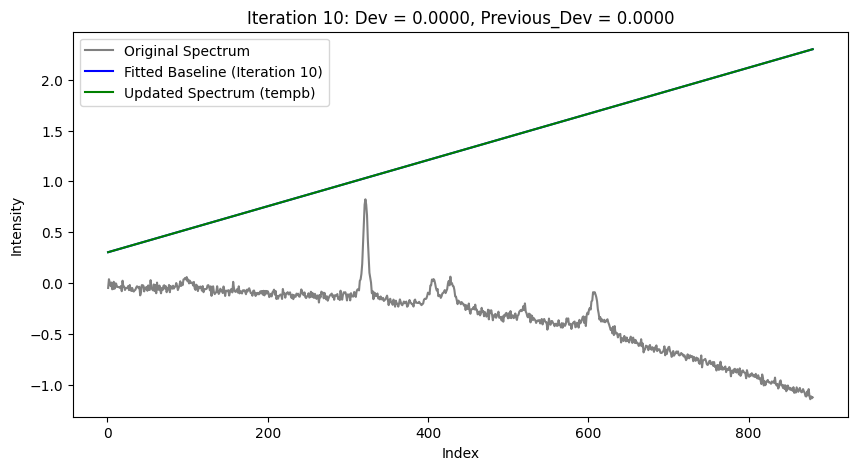

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


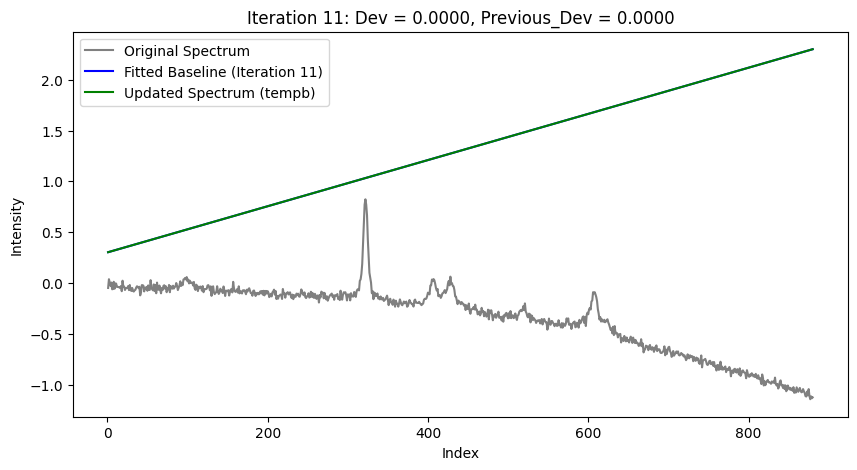

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


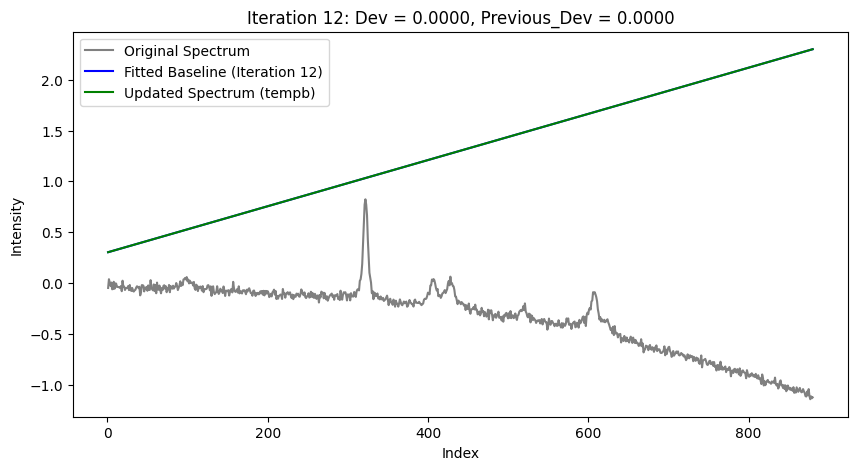

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


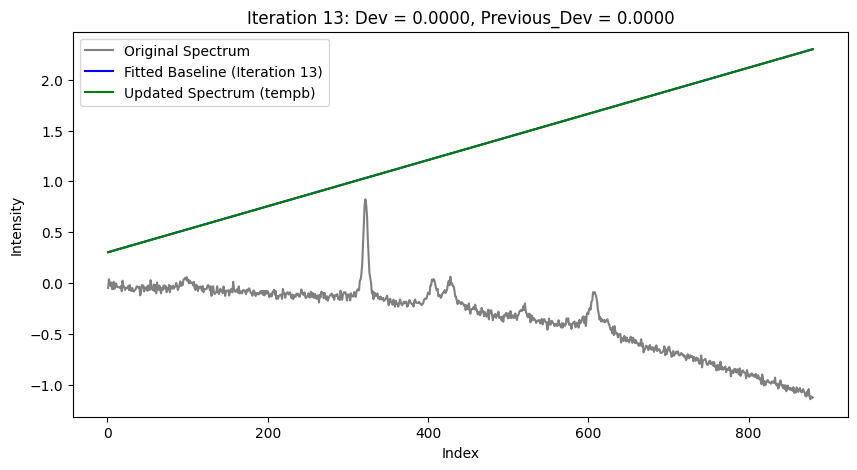

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


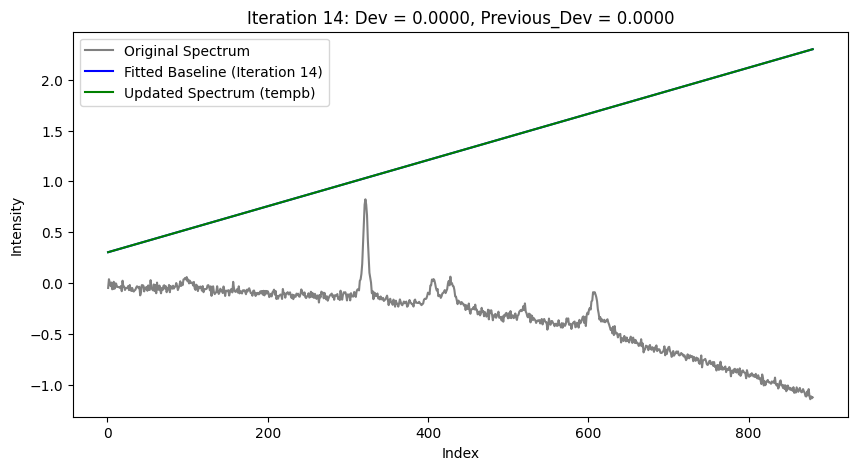

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


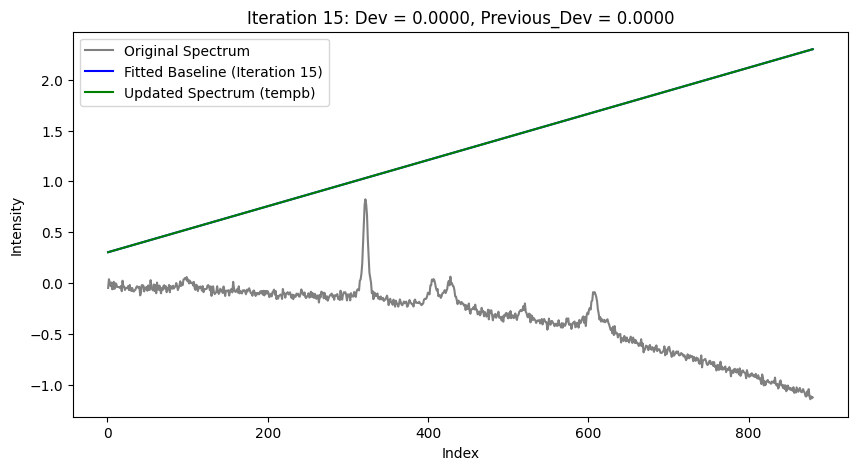

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


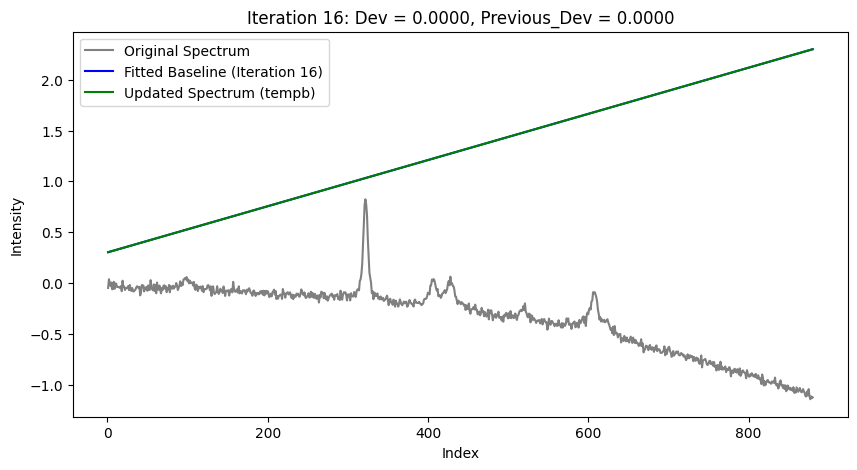

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


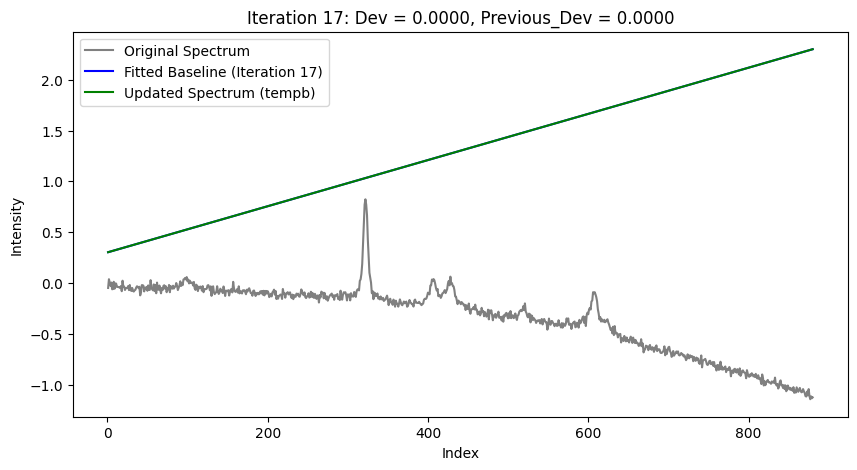

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


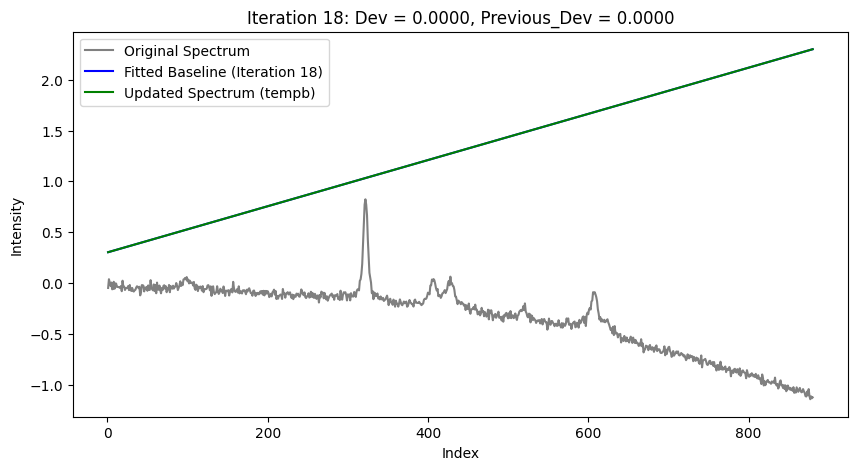

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


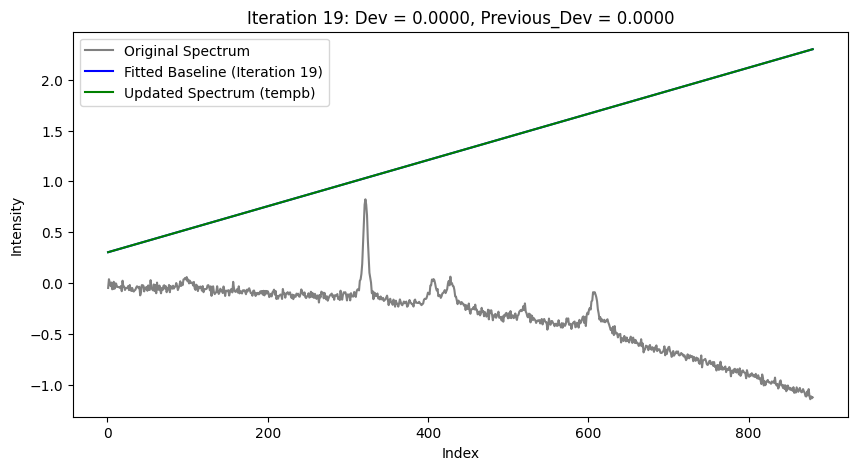

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


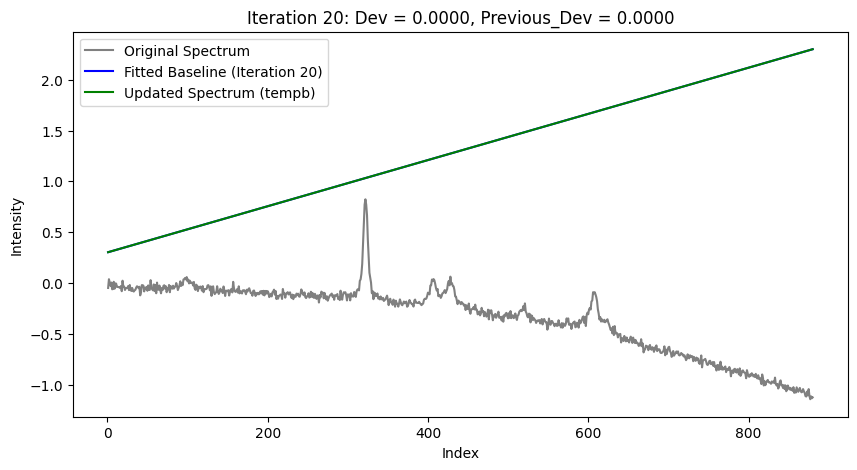

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


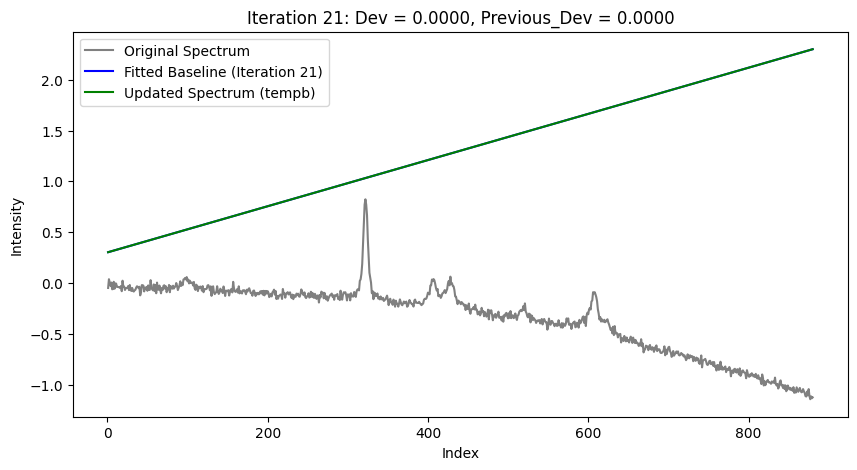

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


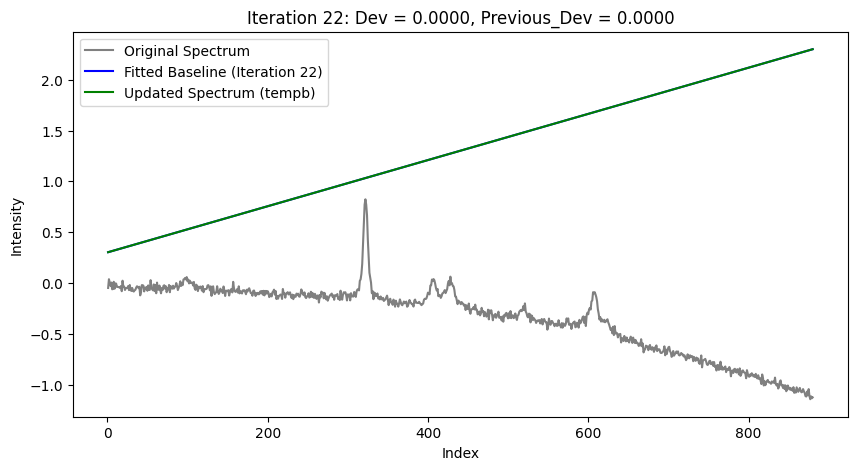

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


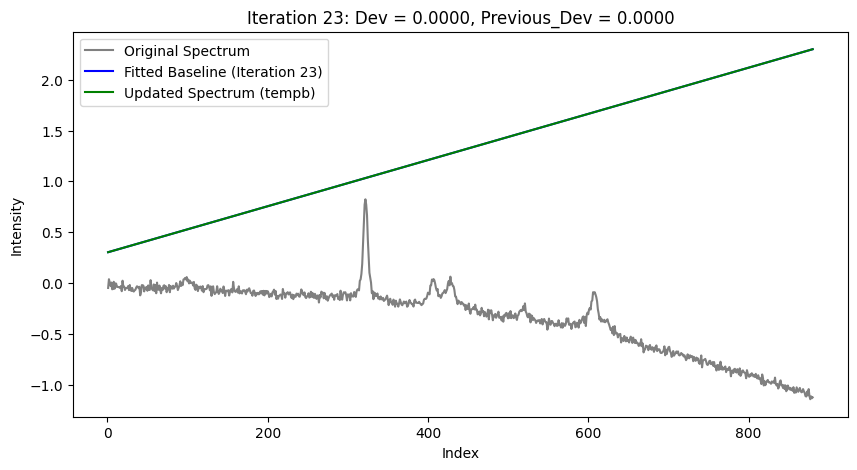

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


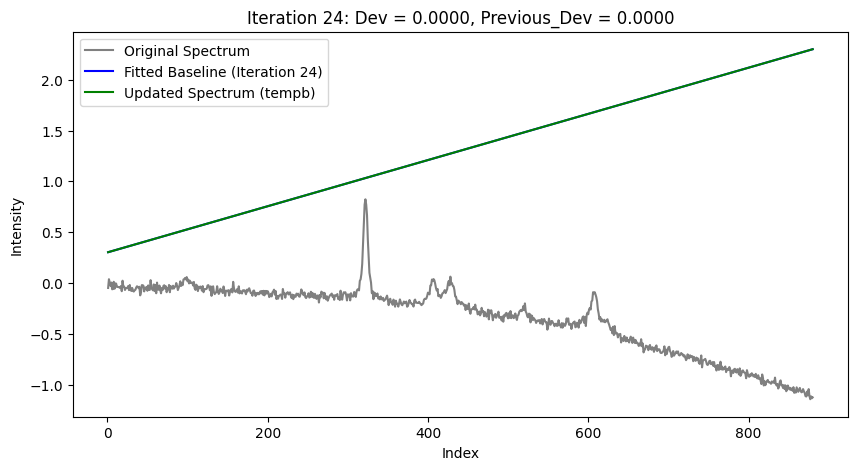

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


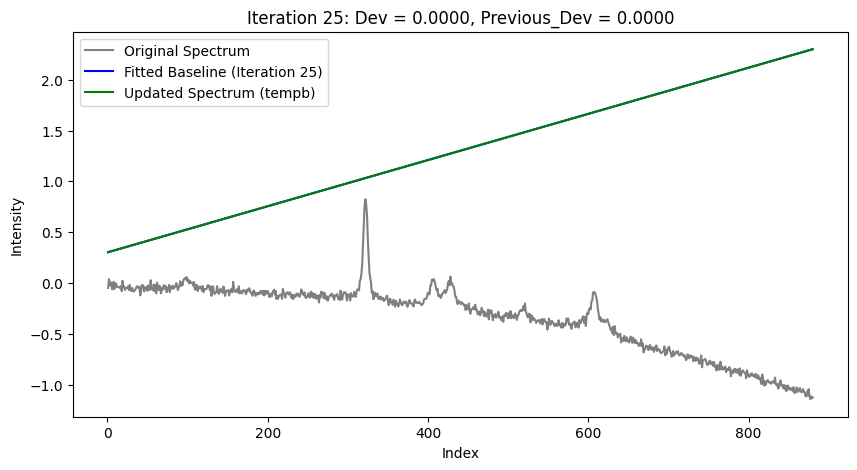

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


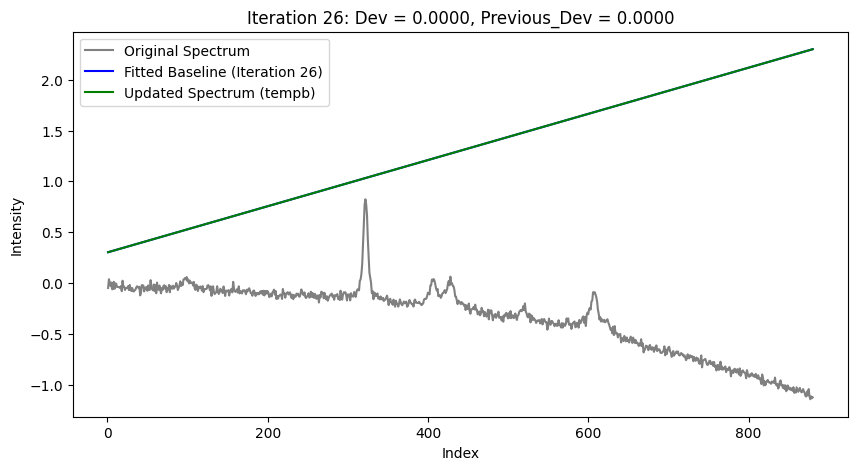

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


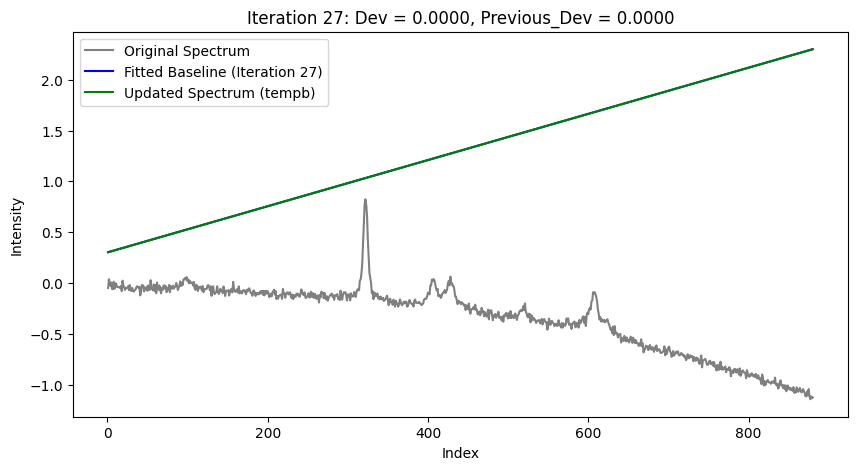

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


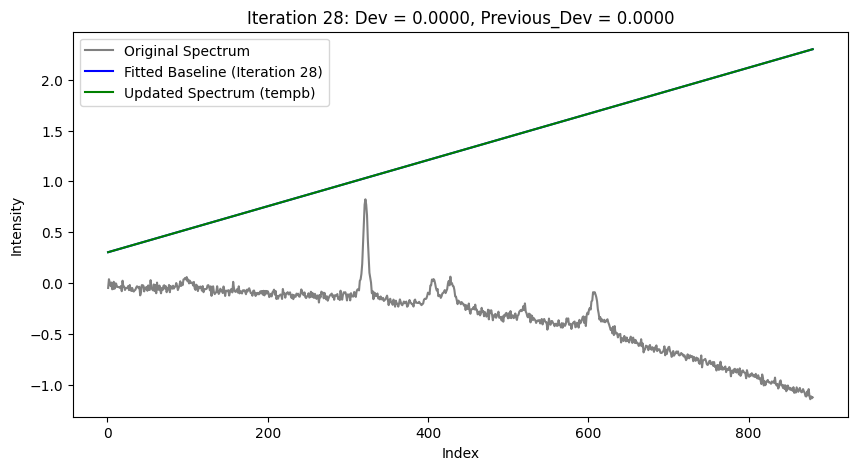

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


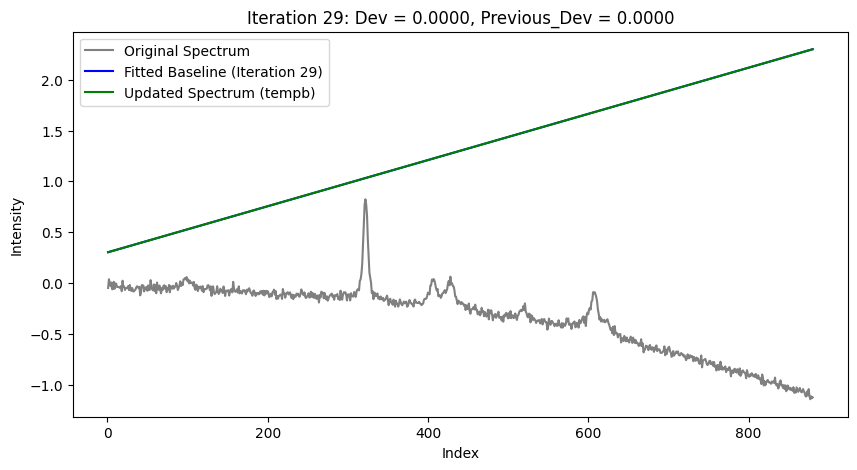

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


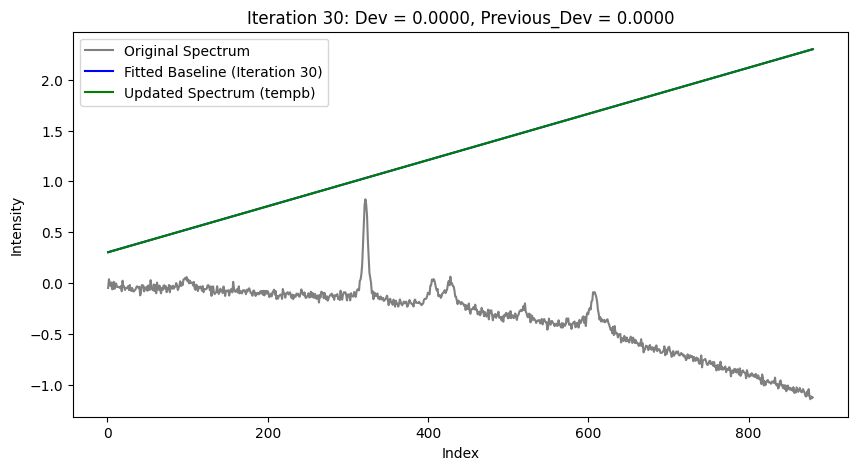

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


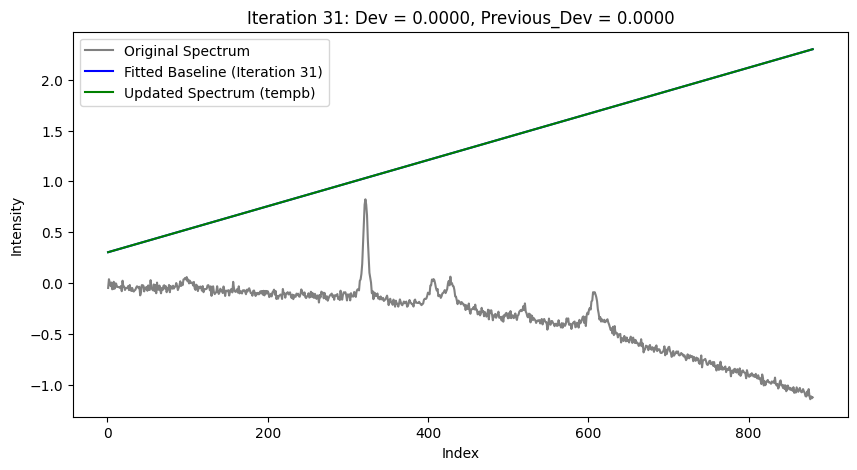

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


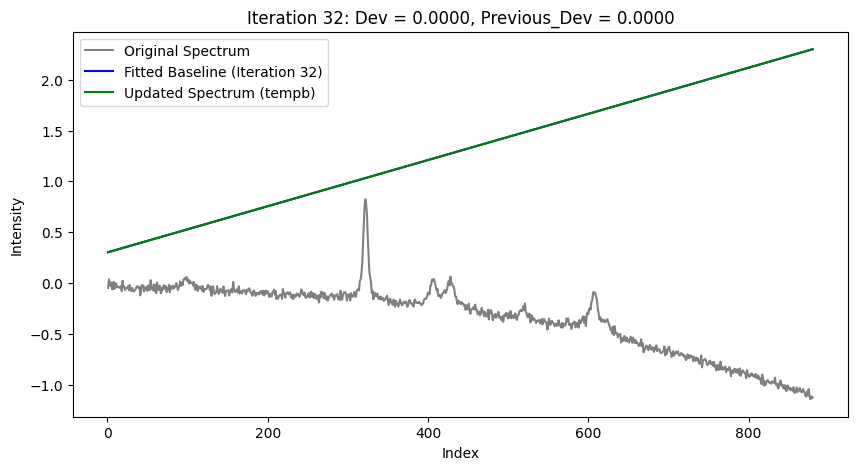

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


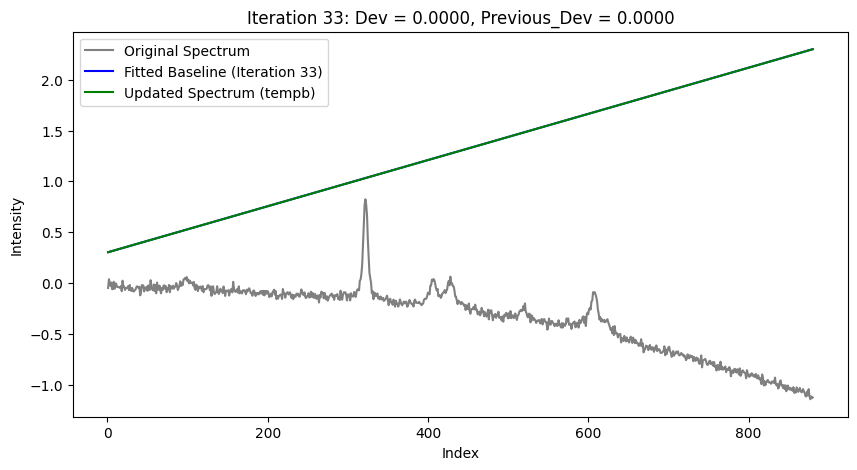

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


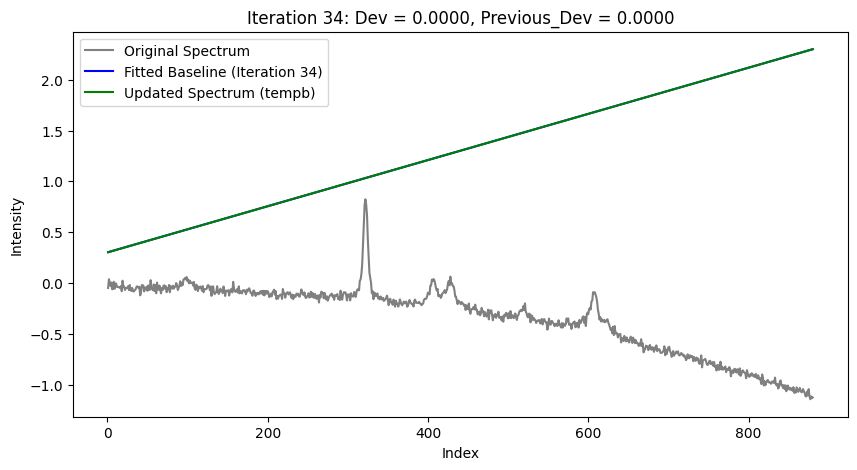

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


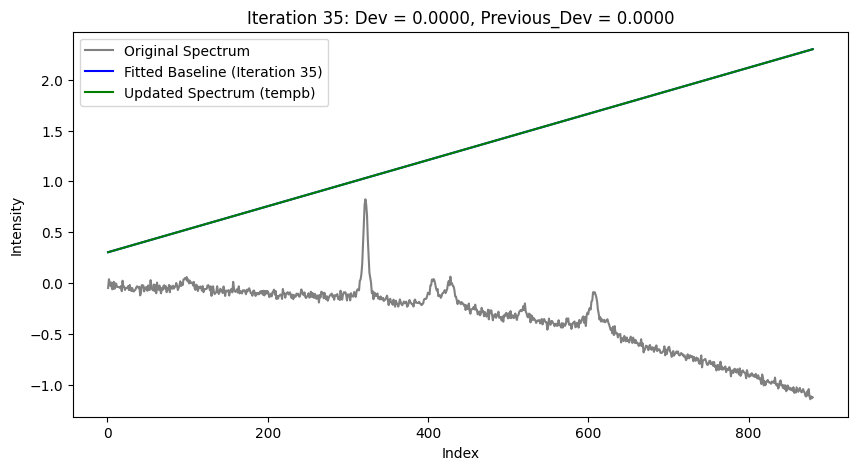

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


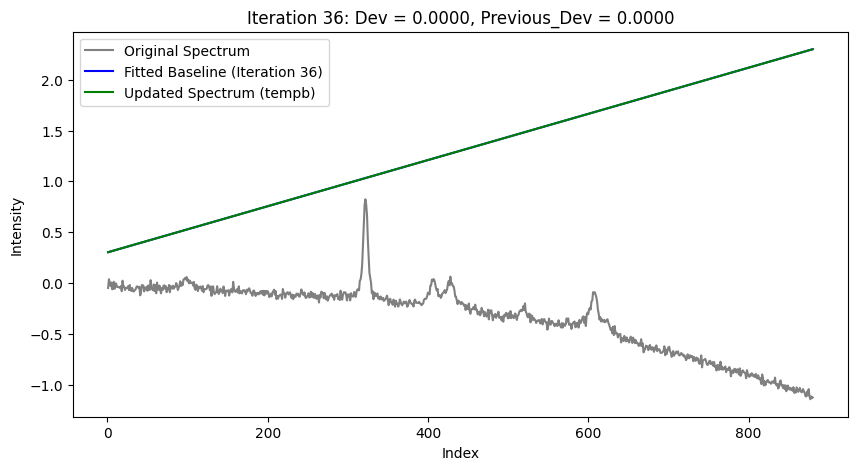

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


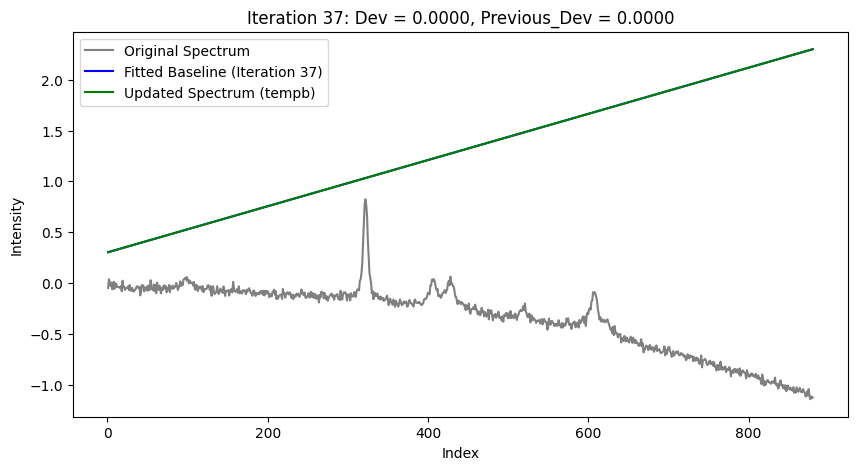

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


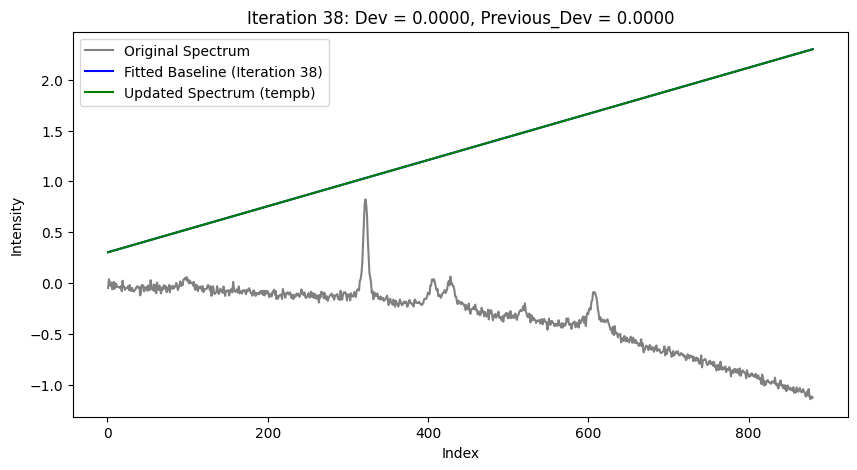

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


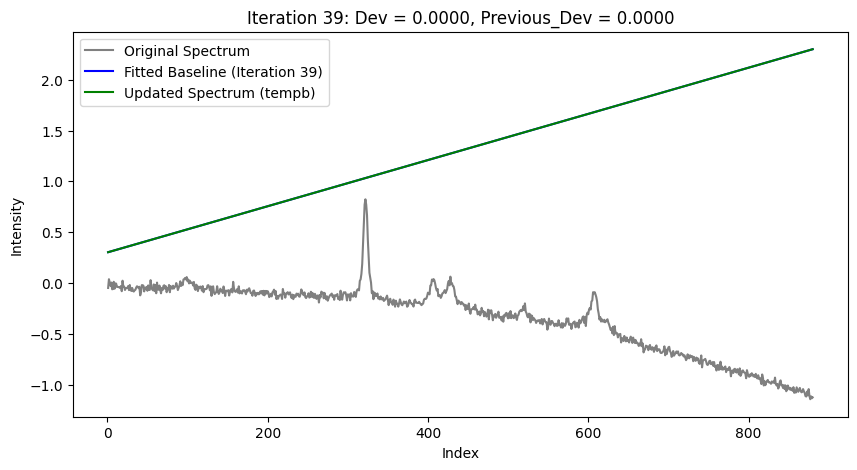

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


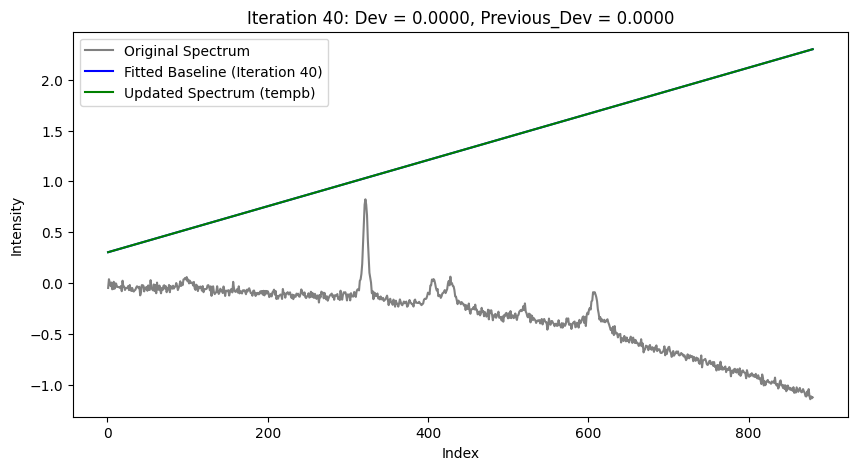

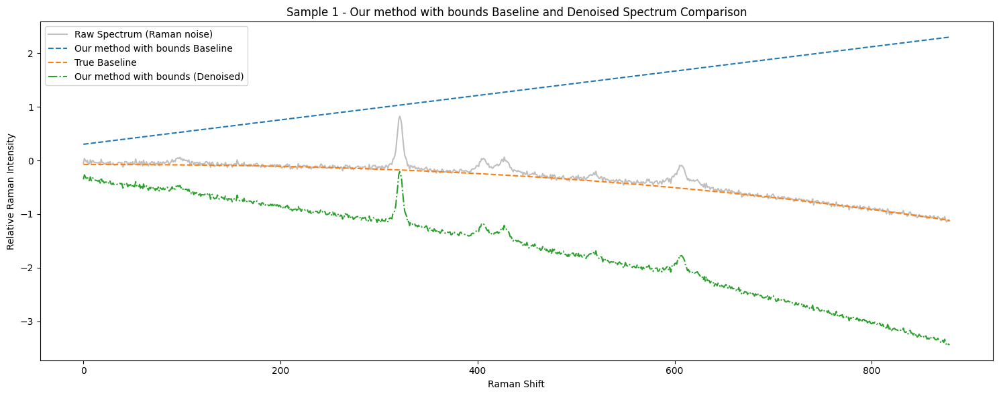

tf.Tensor([[1.1521826e-09 2.2423510e-09 1.0000000e+00]], shape=(1, 3), dtype=float32)


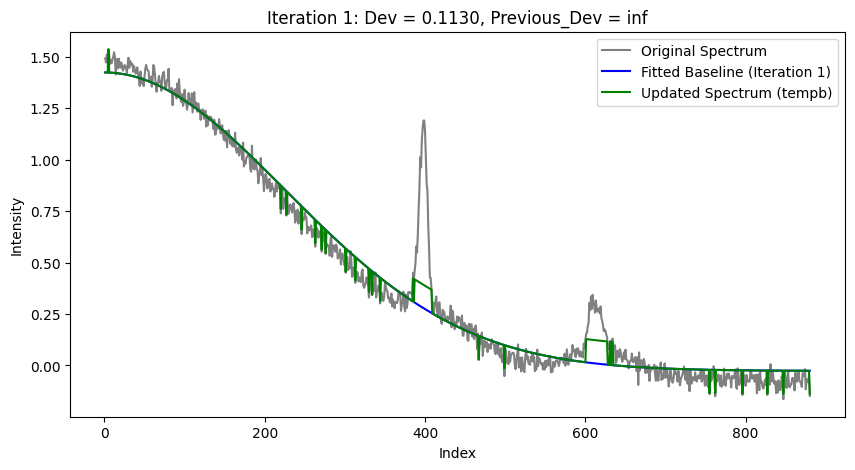

tf.Tensor([[4.9047804e-07 3.5234640e-07 9.9999917e-01]], shape=(1, 3), dtype=float32)


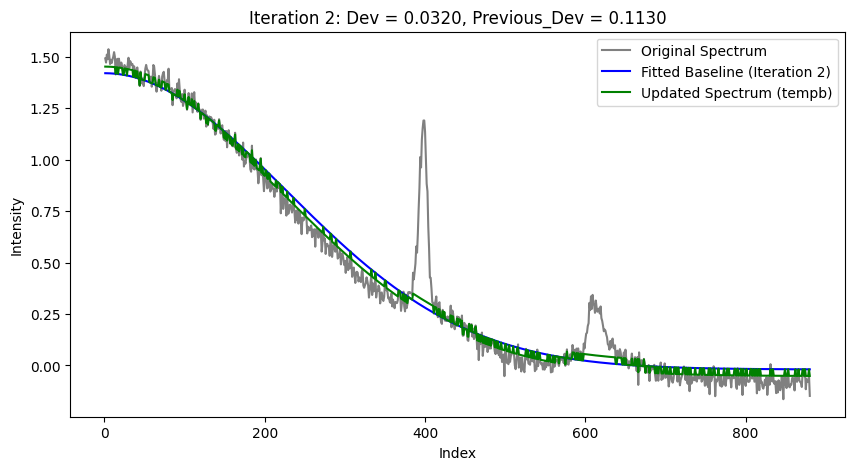

tf.Tensor([[2.7252995e-07 3.1787803e-07 9.9999940e-01]], shape=(1, 3), dtype=float32)


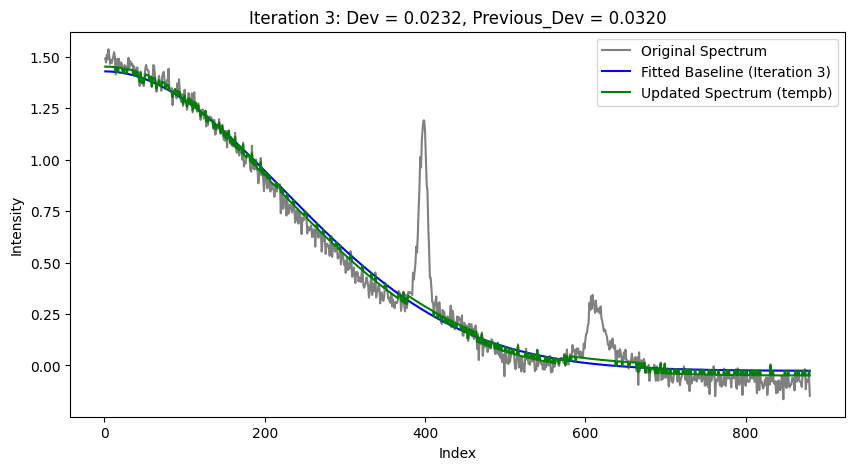

tf.Tensor([[7.5644482e-07 4.3885845e-07 9.9999881e-01]], shape=(1, 3), dtype=float32)


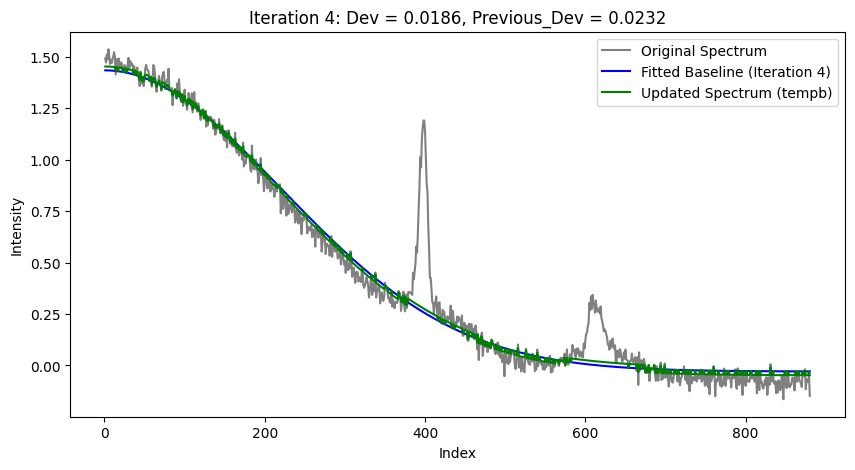

tf.Tensor([[1.3792761e-06 5.5206220e-07 9.9999809e-01]], shape=(1, 3), dtype=float32)


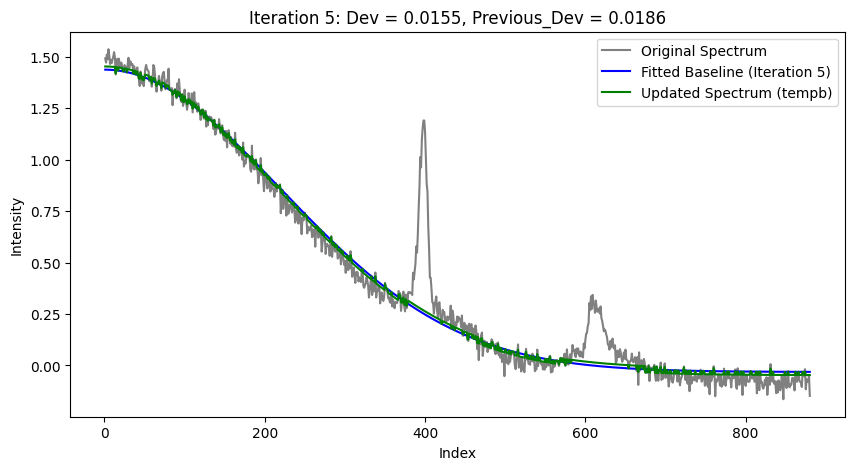

tf.Tensor([[2.1426572e-06 6.2962238e-07 9.9999726e-01]], shape=(1, 3), dtype=float32)


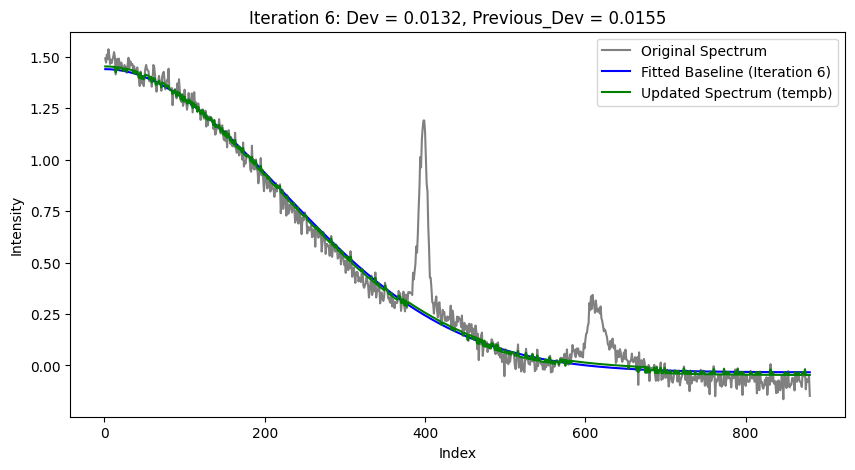

tf.Tensor([[3.1460195e-06 7.1498465e-07 9.9999619e-01]], shape=(1, 3), dtype=float32)


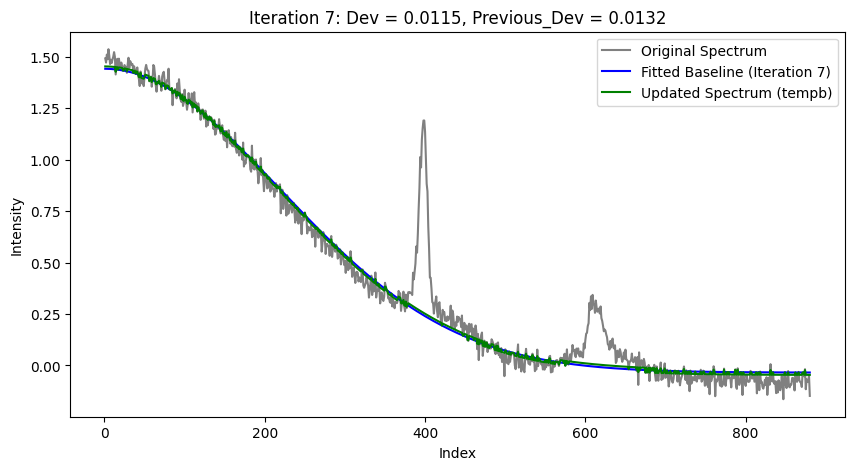

tf.Tensor([[4.1773874e-06 7.8704647e-07 9.9999499e-01]], shape=(1, 3), dtype=float32)


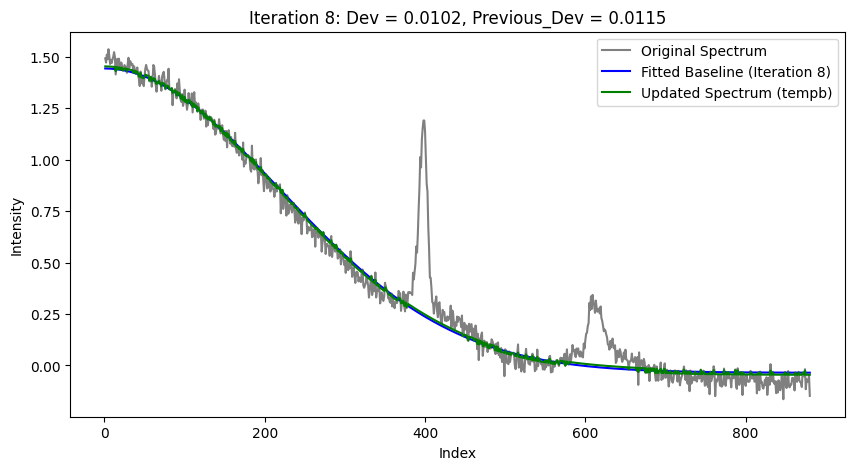

tf.Tensor([[5.2009946e-06 8.4270982e-07 9.9999392e-01]], shape=(1, 3), dtype=float32)


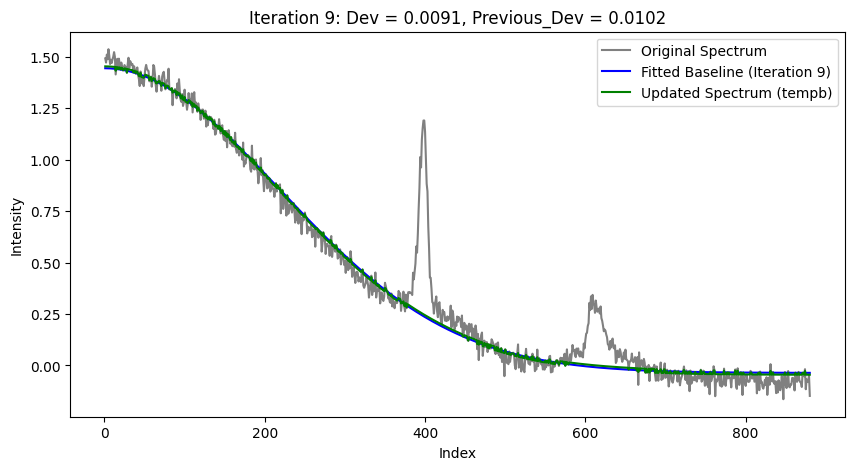

tf.Tensor([[6.1313031e-06 8.8632225e-07 9.9999297e-01]], shape=(1, 3), dtype=float32)


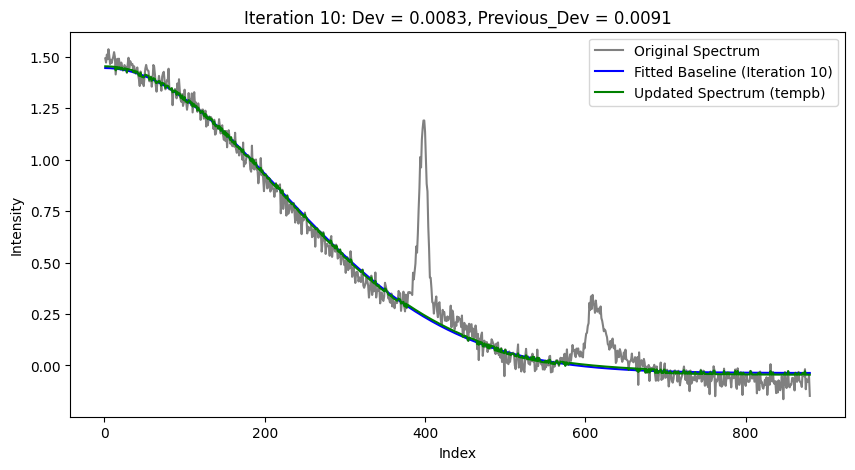

tf.Tensor([[7.3737951e-06 9.5363907e-07 9.9999166e-01]], shape=(1, 3), dtype=float32)


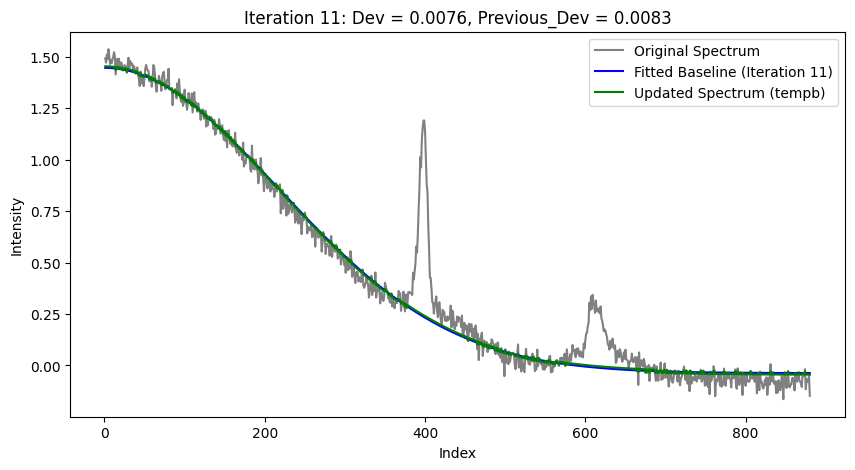

tf.Tensor([[7.894967e-06 9.528359e-07 9.999912e-01]], shape=(1, 3), dtype=float32)


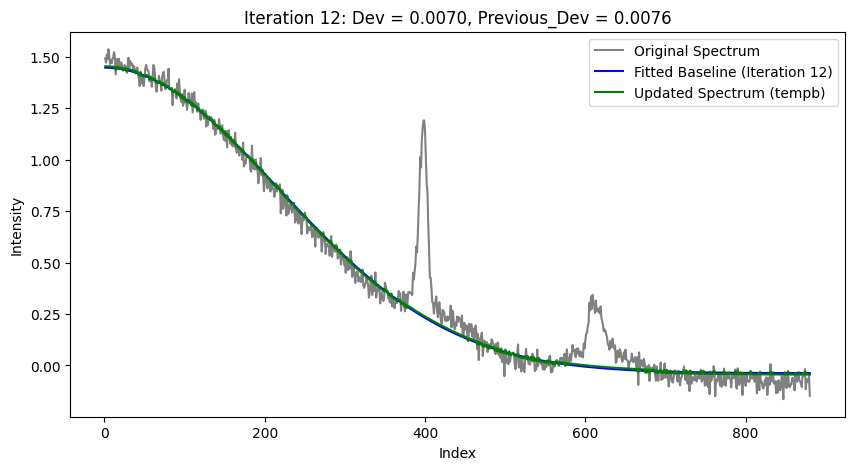

tf.Tensor([[8.4967005e-06 9.7492614e-07 9.9999058e-01]], shape=(1, 3), dtype=float32)


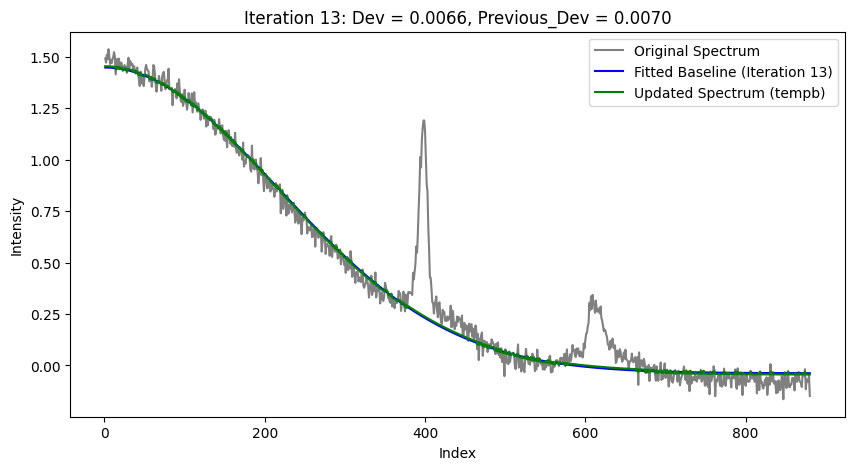

tf.Tensor([[9.057175e-06 9.996170e-07 9.999900e-01]], shape=(1, 3), dtype=float32)


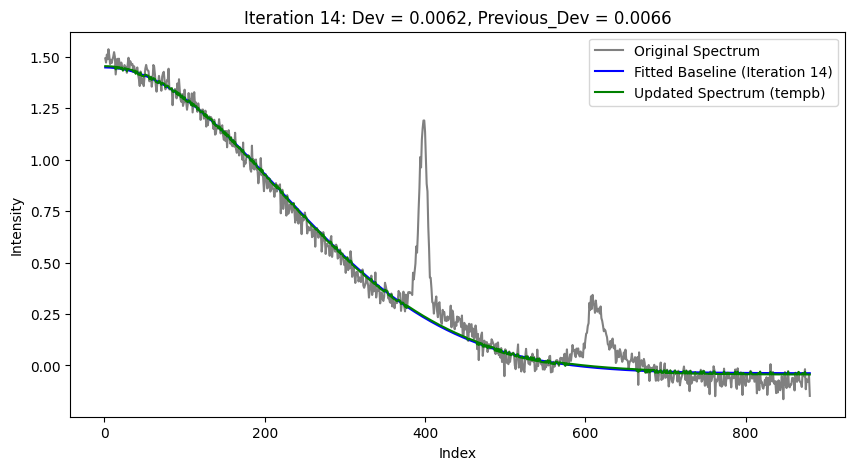

tf.Tensor([[9.9762801e-06 1.0404469e-06 9.9998903e-01]], shape=(1, 3), dtype=float32)


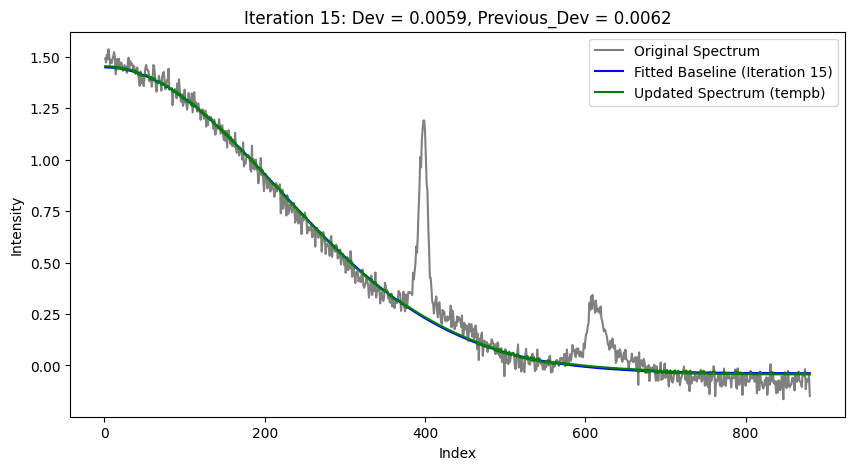

tf.Tensor([[1.0280480e-05 1.0435479e-06 9.9998868e-01]], shape=(1, 3), dtype=float32)


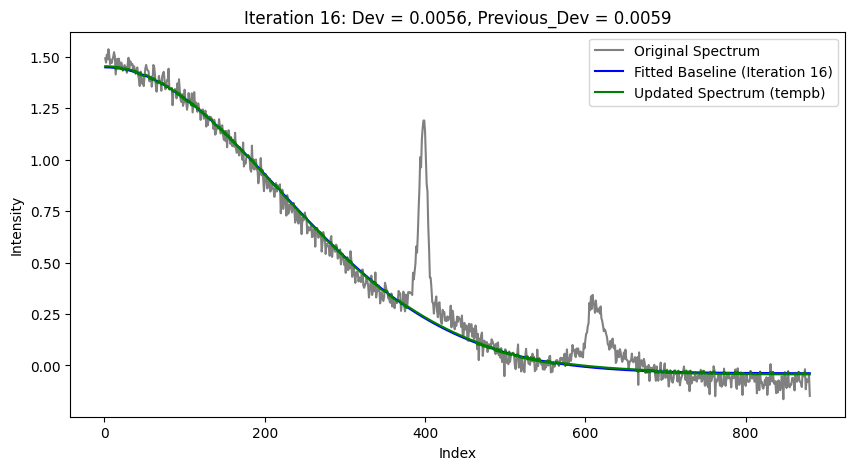

tf.Tensor([[1.0948903e-05 1.0713447e-06 9.9998796e-01]], shape=(1, 3), dtype=float32)


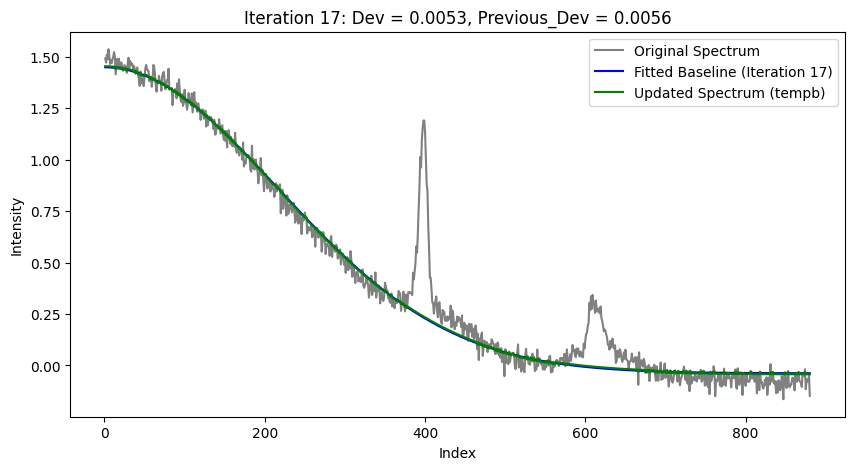

tf.Tensor([[1.1584582e-05 1.0920307e-06 9.9998736e-01]], shape=(1, 3), dtype=float32)


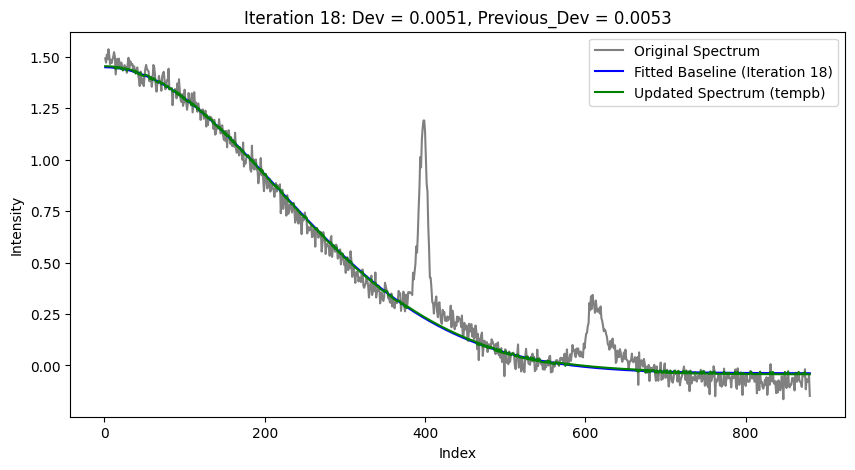

tf.Tensor([[1.2321687e-05 1.1246999e-06 9.9998653e-01]], shape=(1, 3), dtype=float32)


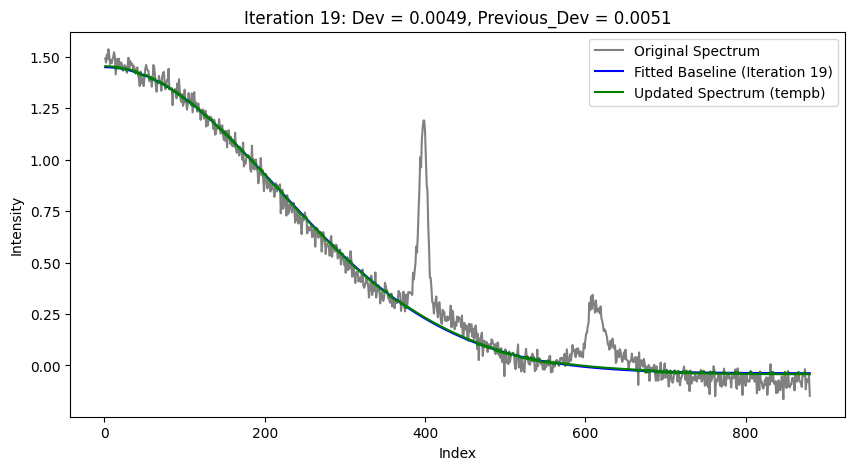

tf.Tensor([[1.2687427e-05 1.1372606e-06 9.9998617e-01]], shape=(1, 3), dtype=float32)


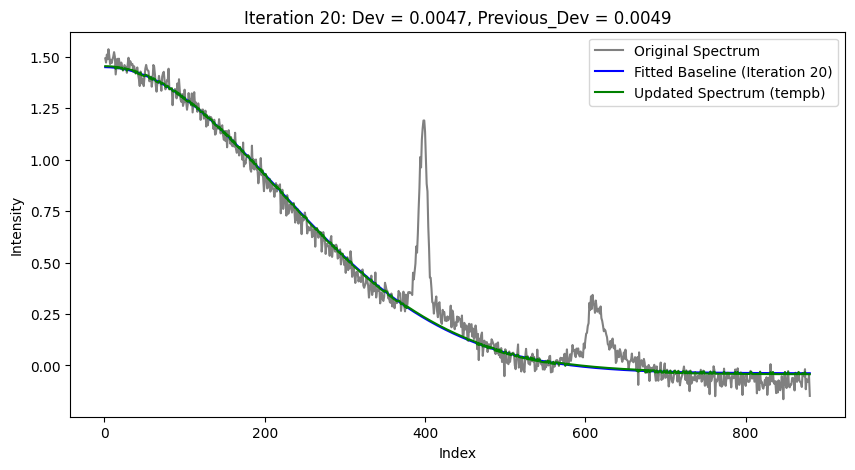

tf.Tensor([[1.31965935e-05 1.15665523e-06 9.99985695e-01]], shape=(1, 3), dtype=float32)


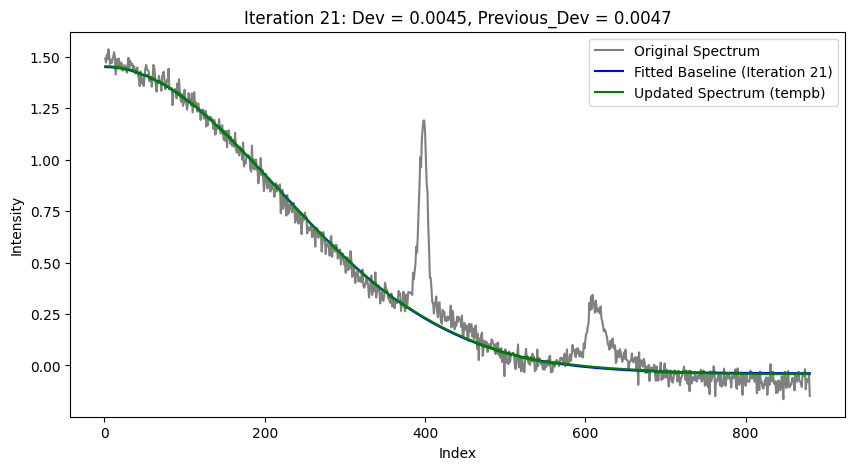

tf.Tensor([[1.3561609e-05 1.1667007e-06 9.9998522e-01]], shape=(1, 3), dtype=float32)


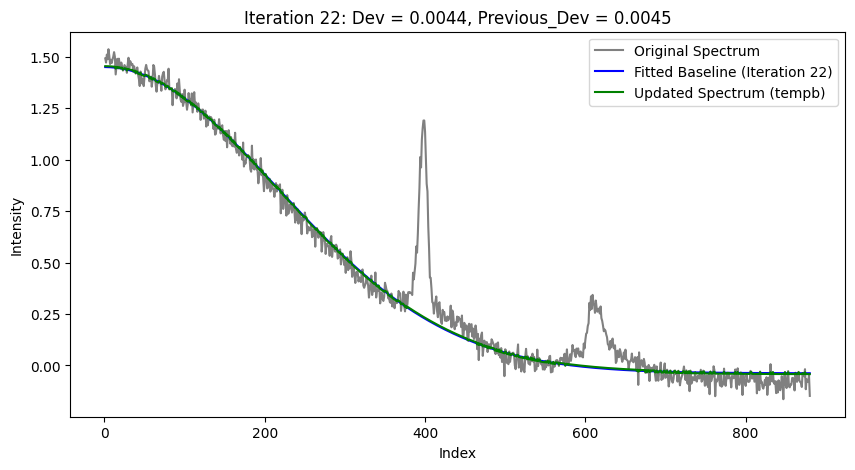

tf.Tensor([[1.4025747e-05 1.1829919e-06 9.9998474e-01]], shape=(1, 3), dtype=float32)


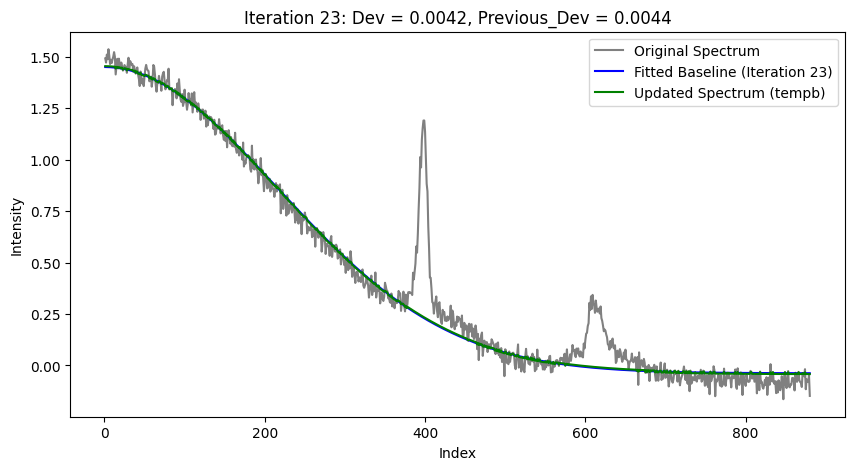

tf.Tensor([[1.4444053e-05 1.1974901e-06 9.9998438e-01]], shape=(1, 3), dtype=float32)


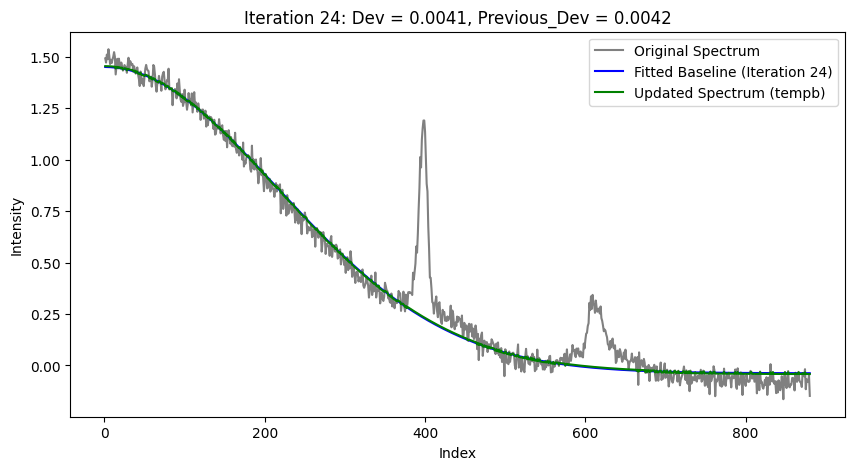

tf.Tensor([[1.4871855e-05 1.2142319e-06 9.9998391e-01]], shape=(1, 3), dtype=float32)


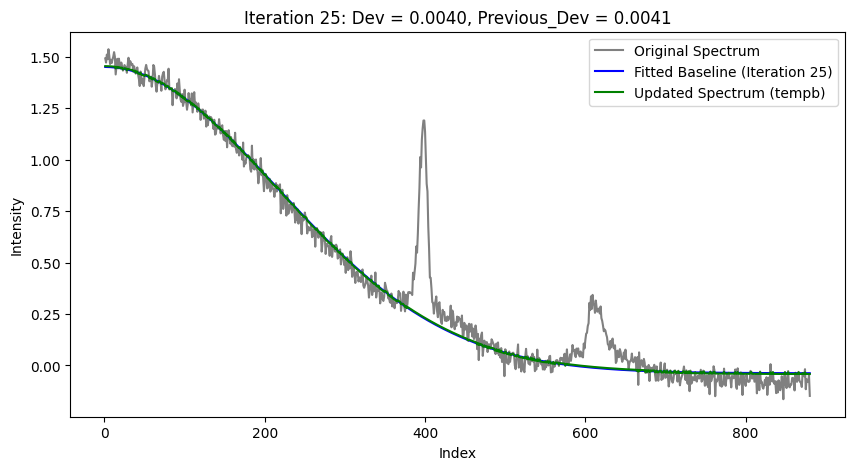

tf.Tensor([[1.5284402e-05 1.2293332e-06 9.9998343e-01]], shape=(1, 3), dtype=float32)


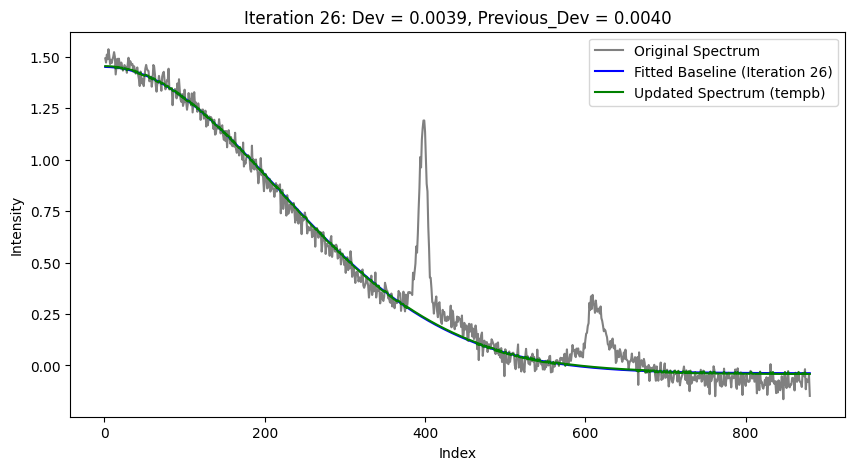

tf.Tensor([[1.5764521e-05 1.2474967e-06 9.9998295e-01]], shape=(1, 3), dtype=float32)


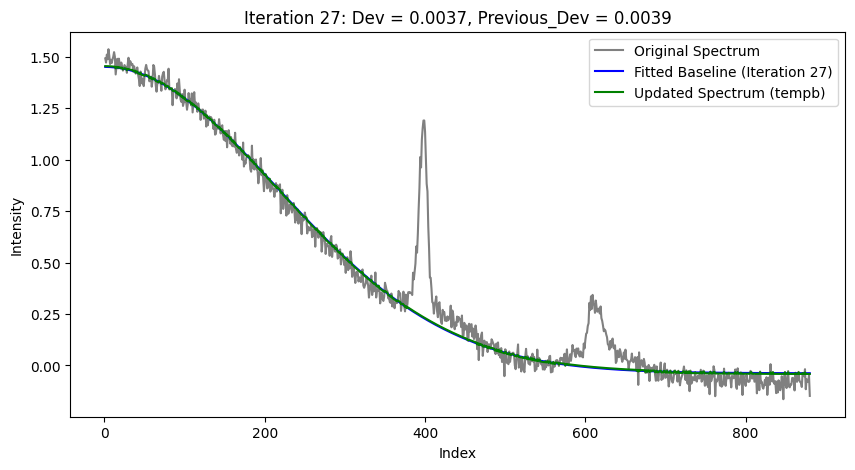

tf.Tensor([[1.6167196e-05 1.2611401e-06 9.9998260e-01]], shape=(1, 3), dtype=float32)


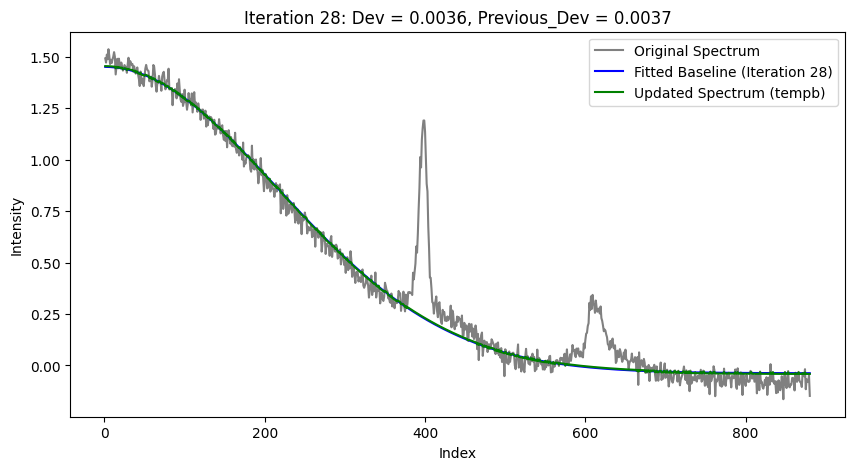

tf.Tensor([[1.6478798e-05 1.2724971e-06 9.9998224e-01]], shape=(1, 3), dtype=float32)


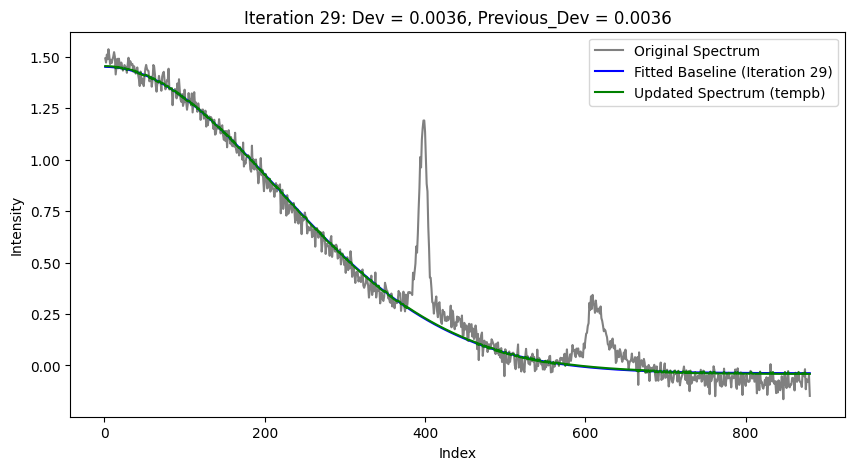

tf.Tensor([[1.6844673e-05 1.2881635e-06 9.9998188e-01]], shape=(1, 3), dtype=float32)


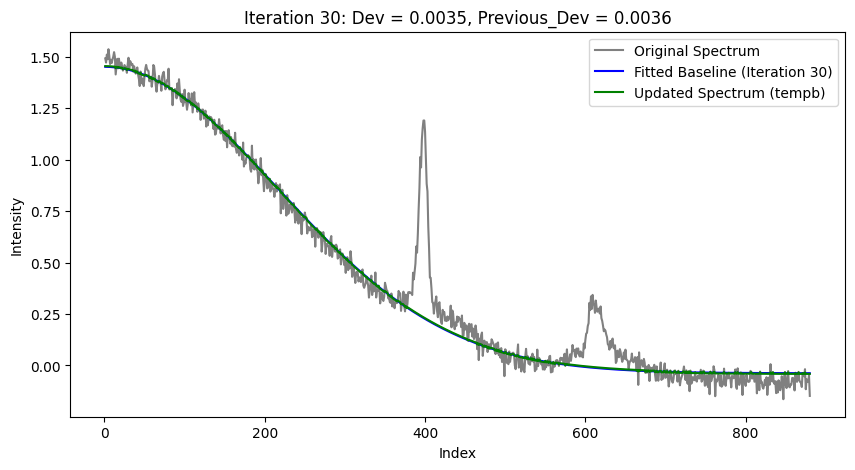

tf.Tensor([[1.7155078e-05 1.2981695e-06 9.9998152e-01]], shape=(1, 3), dtype=float32)


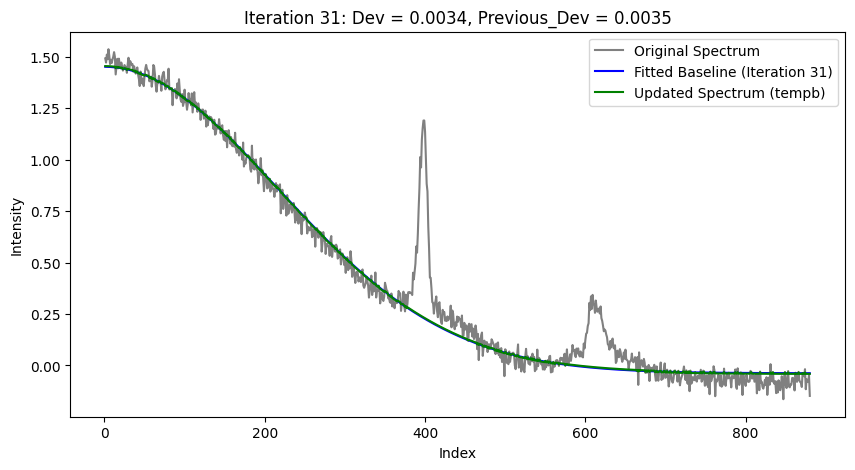

tf.Tensor([[1.7352164e-05 1.3032305e-06 9.9998140e-01]], shape=(1, 3), dtype=float32)


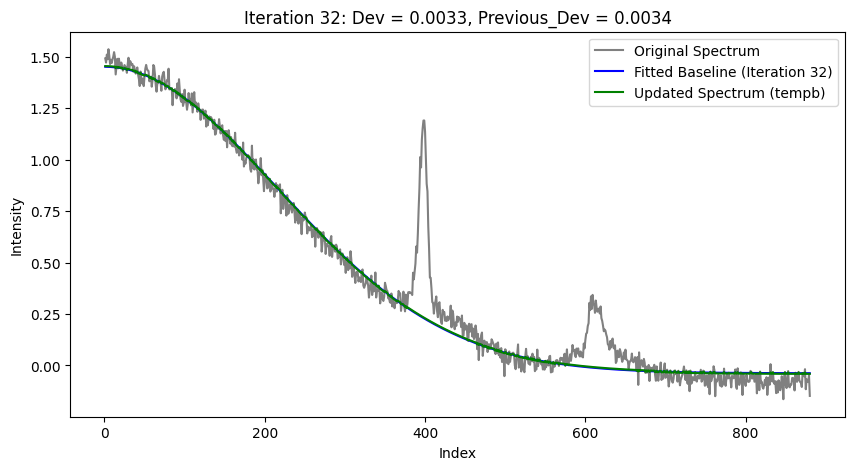

tf.Tensor([[1.7616792e-05 1.3121092e-06 9.9998105e-01]], shape=(1, 3), dtype=float32)


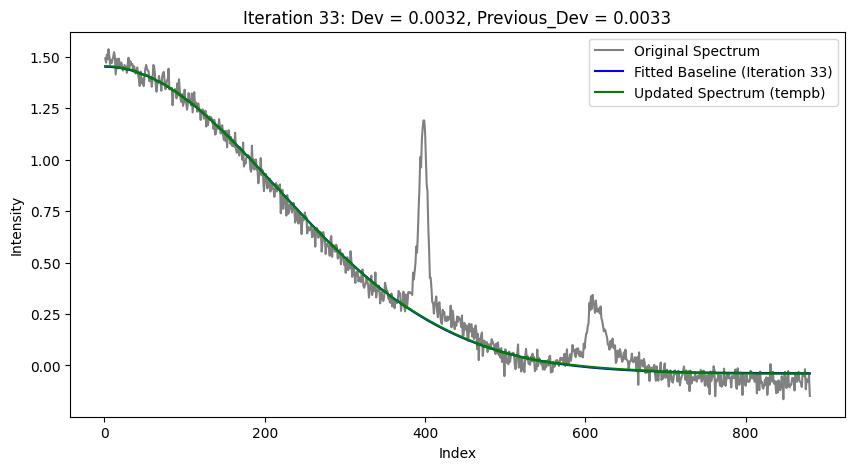

tf.Tensor([[1.7947052e-05 1.3239998e-06 9.9998069e-01]], shape=(1, 3), dtype=float32)


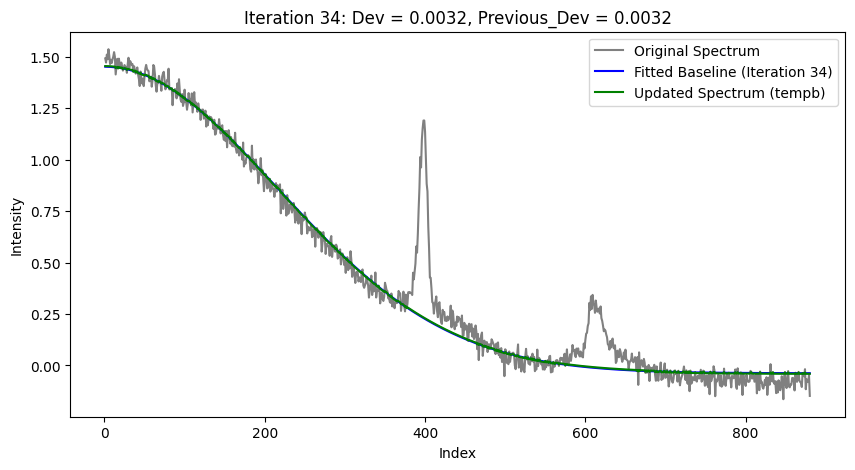

tf.Tensor([[1.8171684e-05 1.3276879e-06 9.9998045e-01]], shape=(1, 3), dtype=float32)


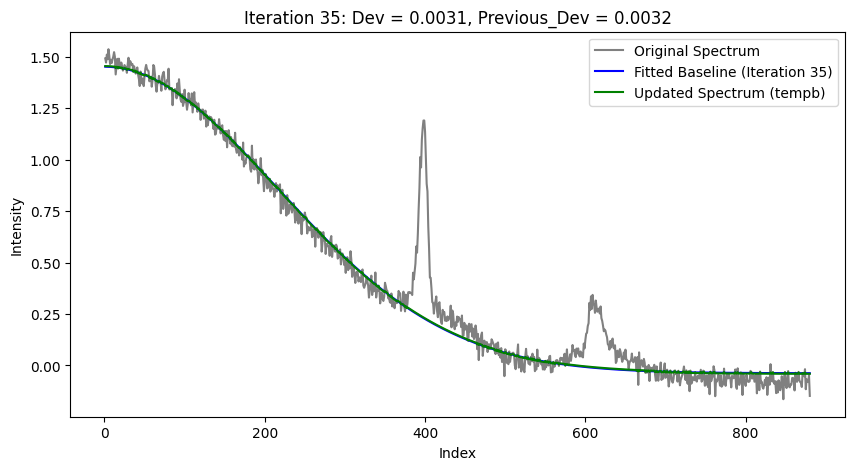

tf.Tensor([[1.8414870e-05 1.3365359e-06 9.9998021e-01]], shape=(1, 3), dtype=float32)


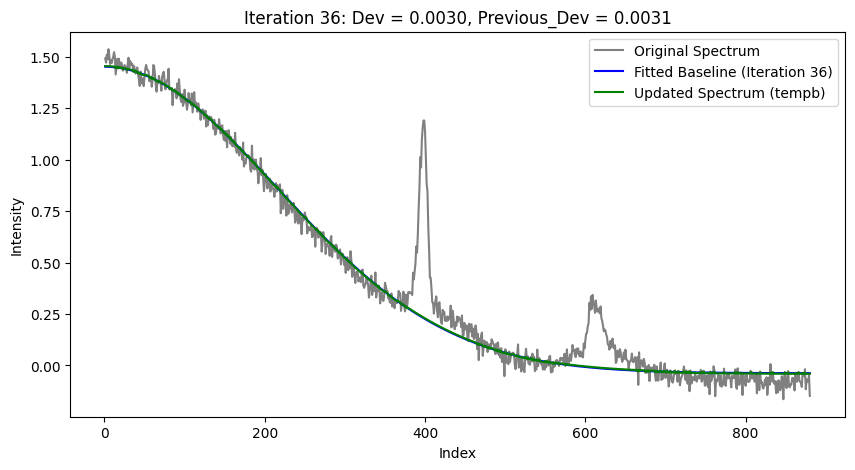

tf.Tensor([[1.8682982e-05 1.3459395e-06 9.9997997e-01]], shape=(1, 3), dtype=float32)


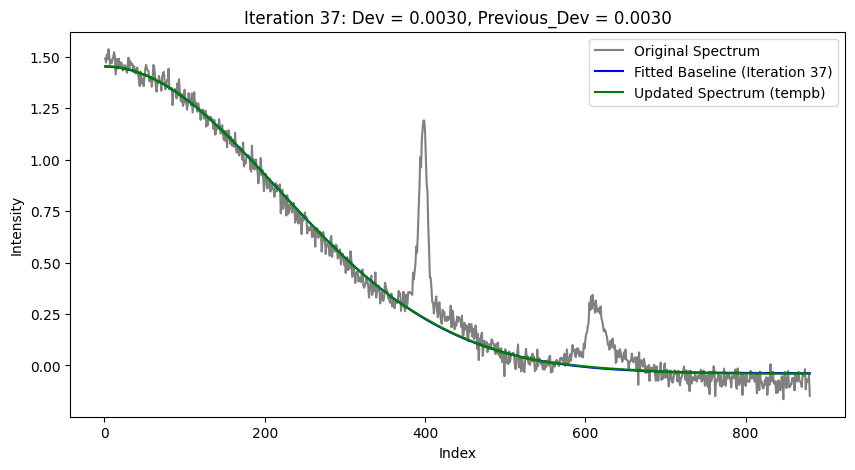

tf.Tensor([[1.8931803e-05 1.3534847e-06 9.9997973e-01]], shape=(1, 3), dtype=float32)


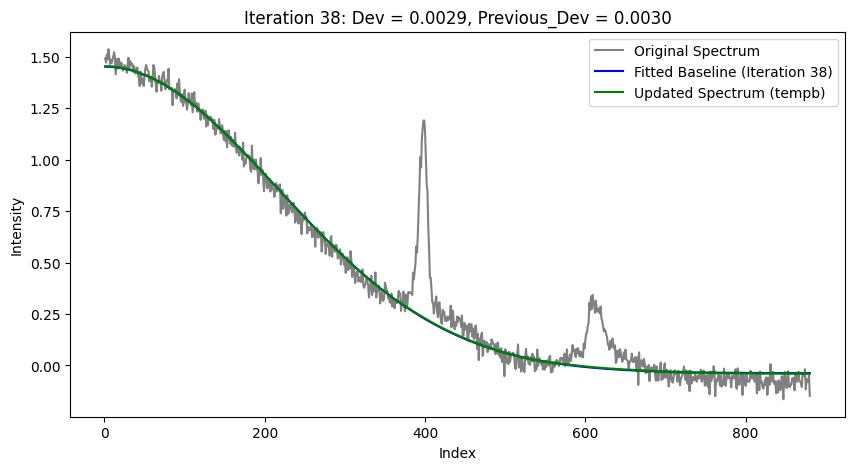

tf.Tensor([[1.9175010e-05 1.3615315e-06 9.9997950e-01]], shape=(1, 3), dtype=float32)


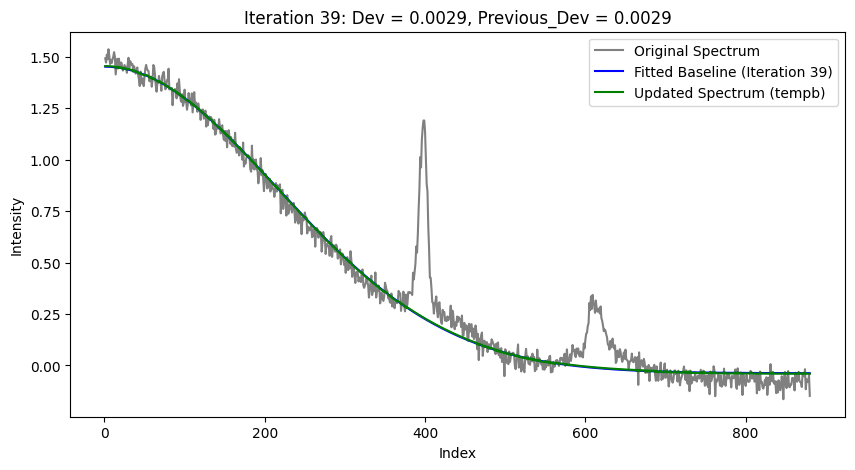

tf.Tensor([[1.9398667e-05 1.3678043e-06 9.9997926e-01]], shape=(1, 3), dtype=float32)


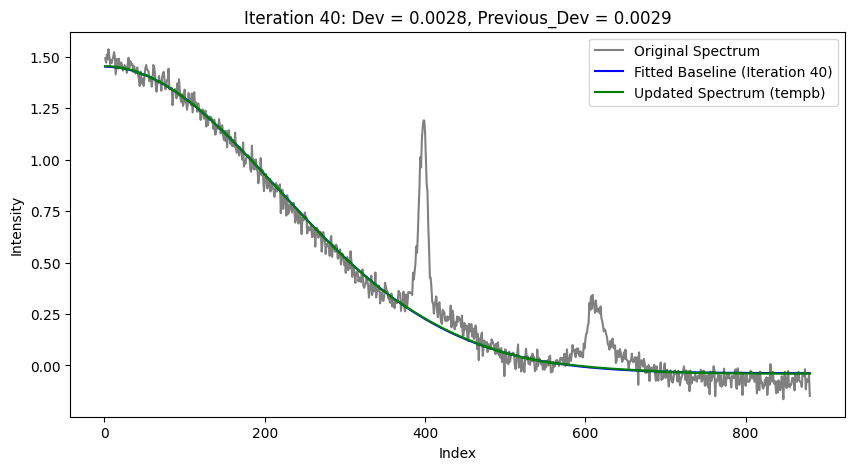

tf.Tensor([[1.9685962e-05 1.3770705e-06 9.9997890e-01]], shape=(1, 3), dtype=float32)


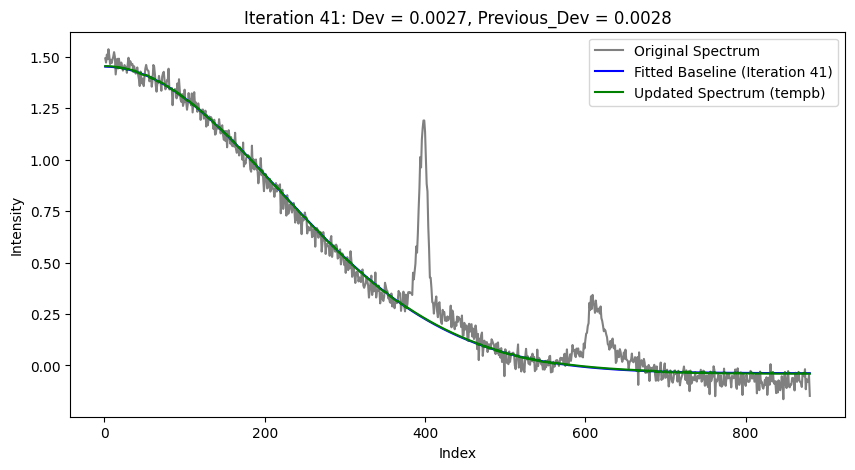

tf.Tensor([[1.9900010e-05 1.3838105e-06 9.9997866e-01]], shape=(1, 3), dtype=float32)


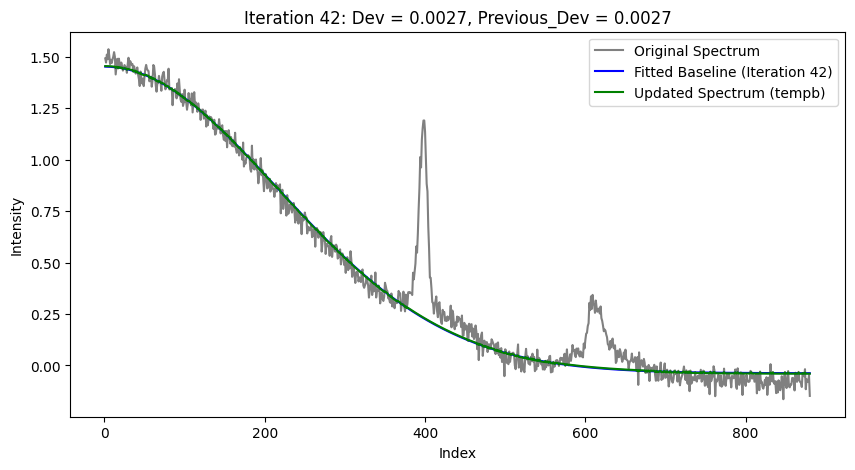

tf.Tensor([[2.0122316e-05 1.3911223e-06 9.9997854e-01]], shape=(1, 3), dtype=float32)


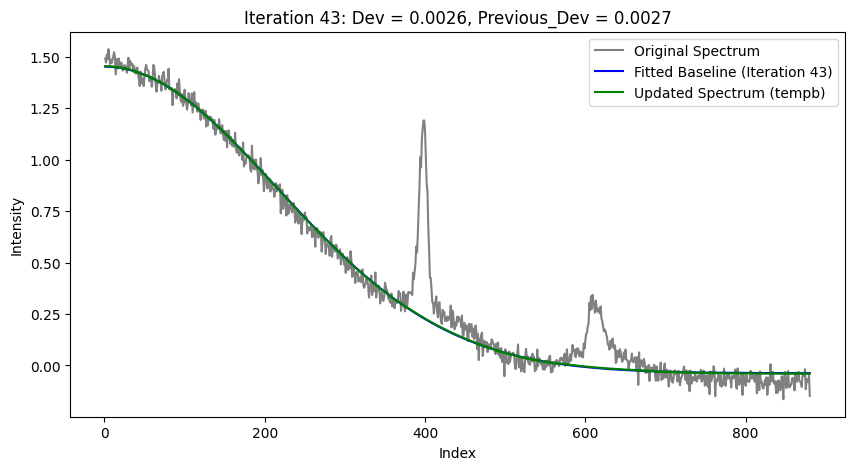

tf.Tensor([[2.0378950e-05 1.3990555e-06 9.9997818e-01]], shape=(1, 3), dtype=float32)


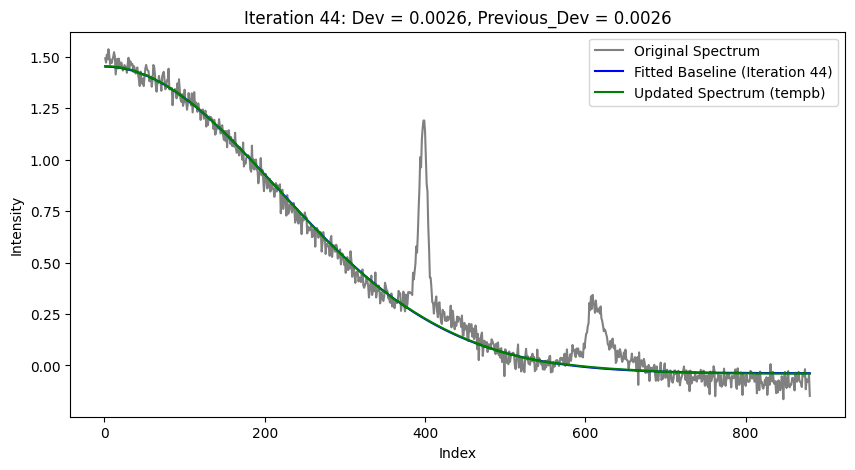

tf.Tensor([[2.0592792e-05 1.4062249e-06 9.9997795e-01]], shape=(1, 3), dtype=float32)


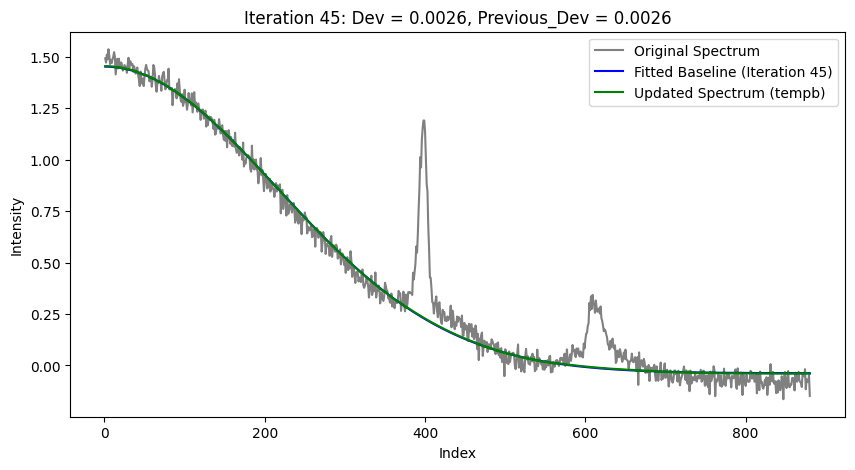

tf.Tensor([[2.0816206e-05 1.4128450e-06 9.9997783e-01]], shape=(1, 3), dtype=float32)


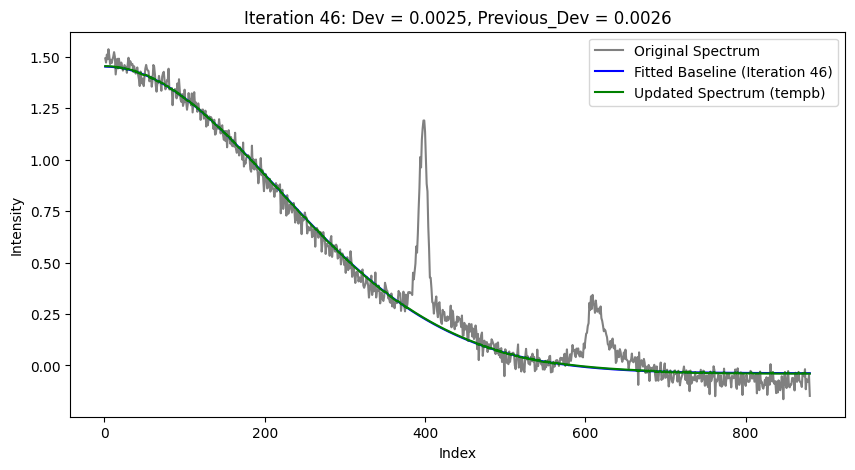

tf.Tensor([[2.1072203e-05 1.4216095e-06 9.9997747e-01]], shape=(1, 3), dtype=float32)


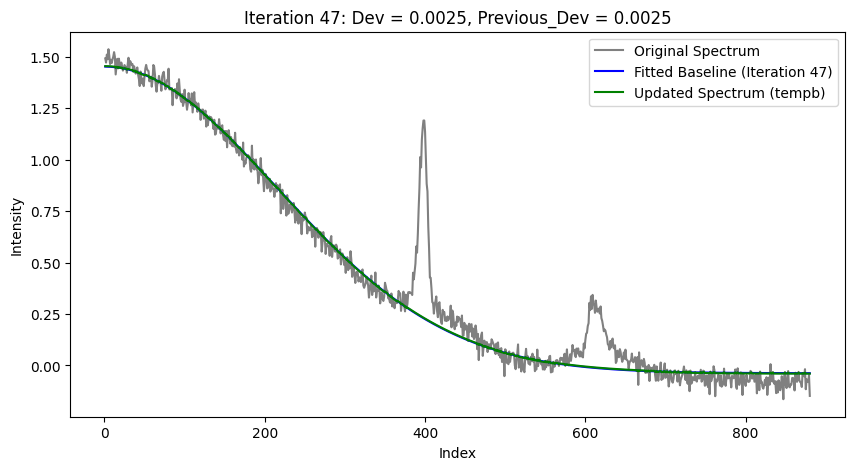

tf.Tensor([[2.1281059e-05 1.4295310e-06 9.9997723e-01]], shape=(1, 3), dtype=float32)


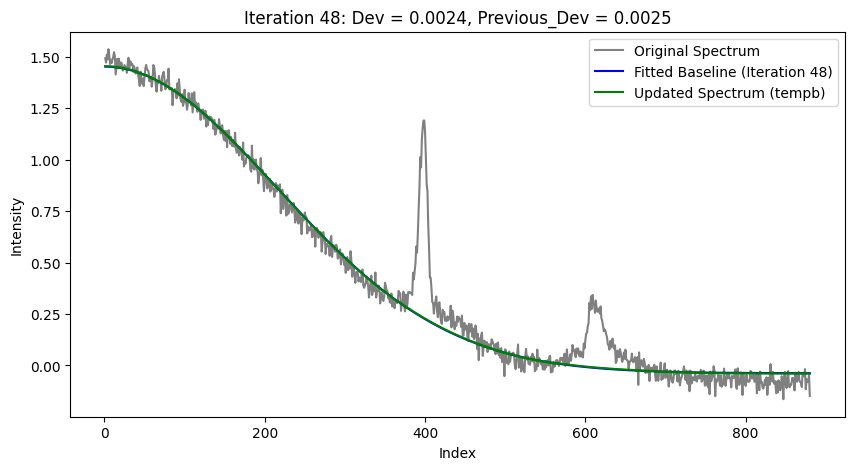

tf.Tensor([[2.1437107e-05 1.4351957e-06 9.9997711e-01]], shape=(1, 3), dtype=float32)


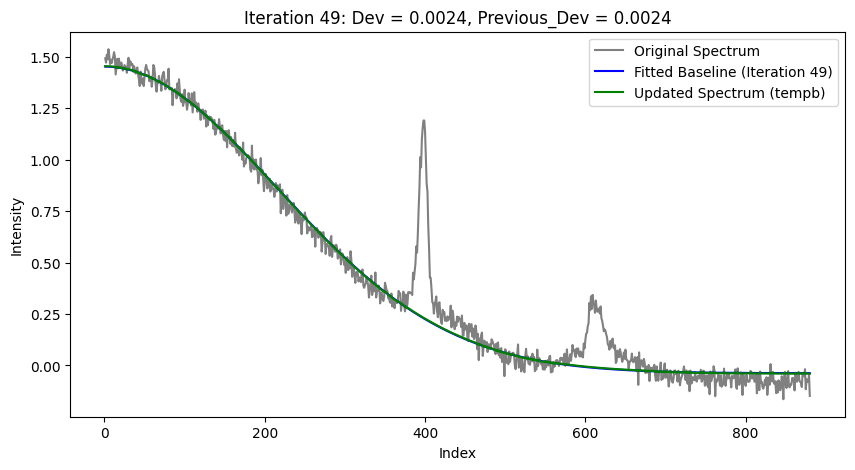

tf.Tensor([[2.1637732e-05 1.4411575e-06 9.9997687e-01]], shape=(1, 3), dtype=float32)


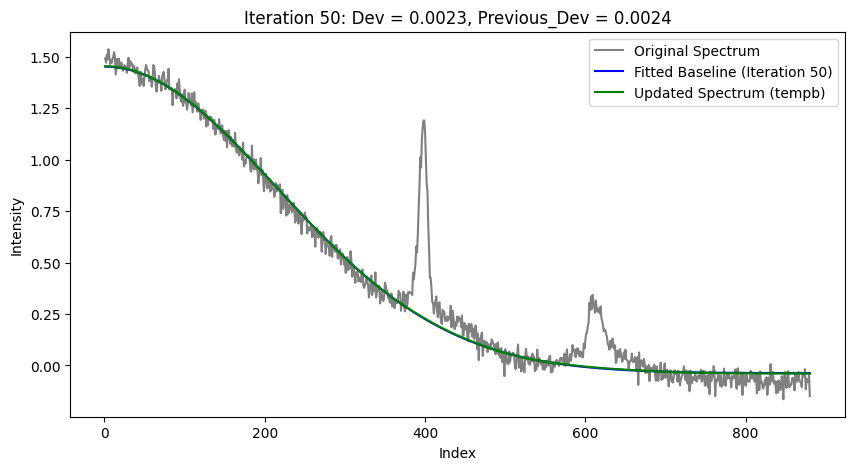

tf.Tensor([[2.1797434e-05 1.4464613e-06 9.9997675e-01]], shape=(1, 3), dtype=float32)


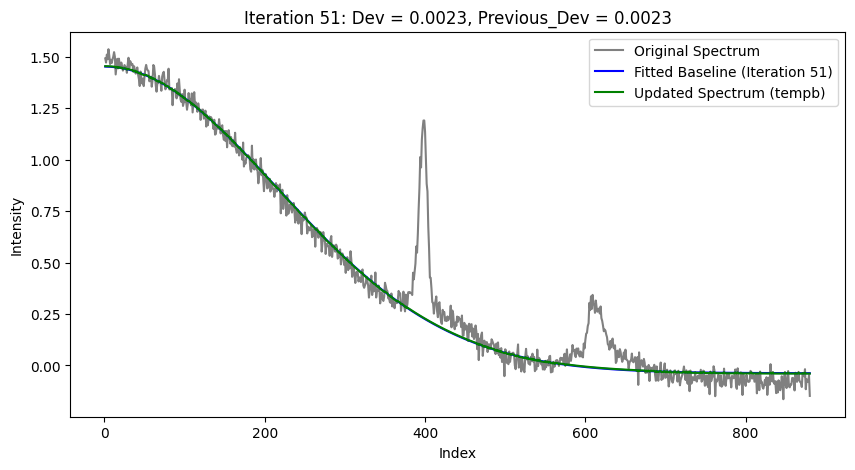

tf.Tensor([[2.2017175e-05 1.4532375e-06 9.9997652e-01]], shape=(1, 3), dtype=float32)


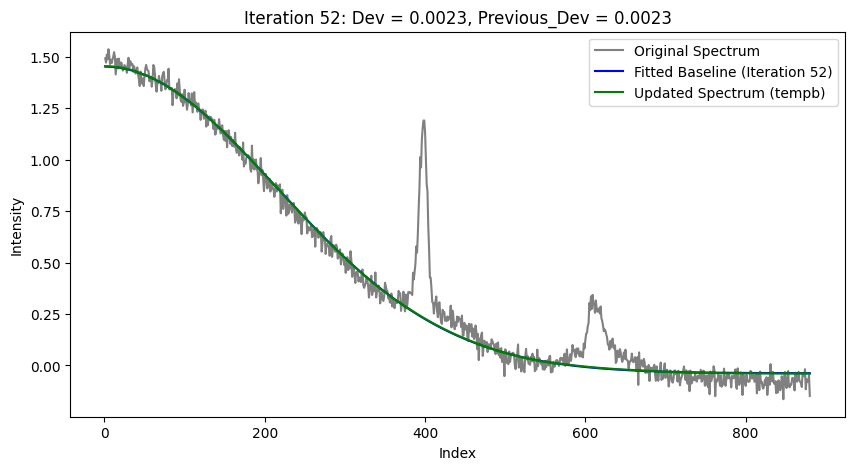

tf.Tensor([[2.2181877e-05 1.4580627e-06 9.9997640e-01]], shape=(1, 3), dtype=float32)


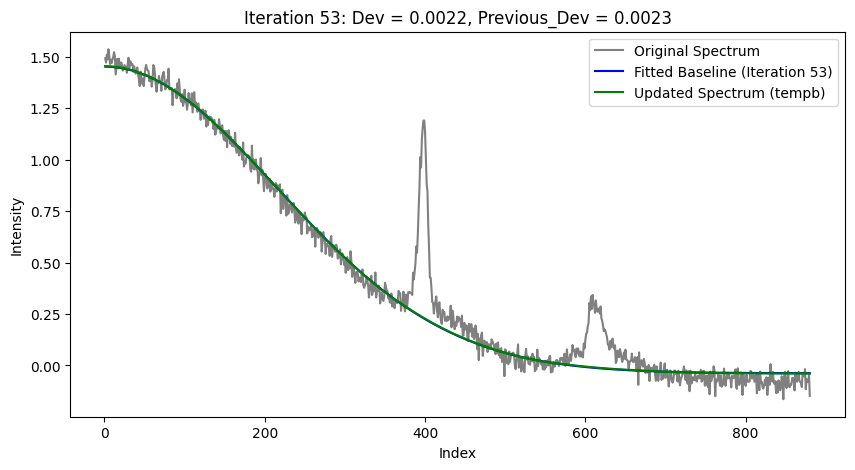

tf.Tensor([[2.2392356e-05 1.4640748e-06 9.9997616e-01]], shape=(1, 3), dtype=float32)


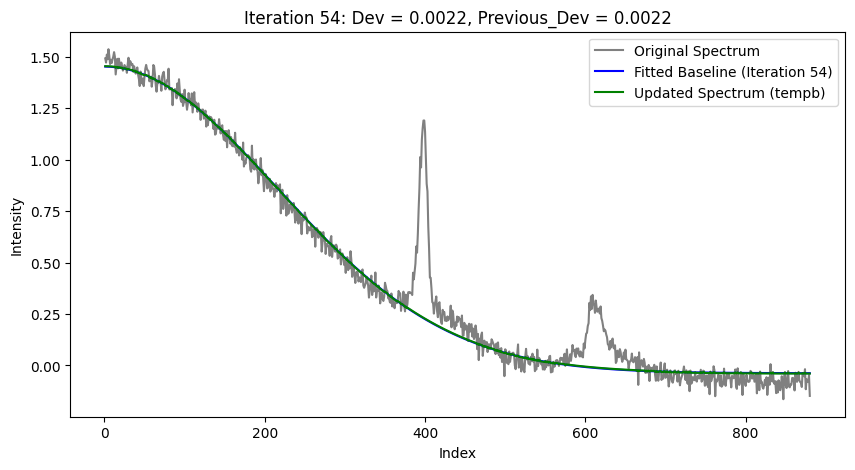

tf.Tensor([[2.2636132e-05 1.4730742e-06 9.9997592e-01]], shape=(1, 3), dtype=float32)


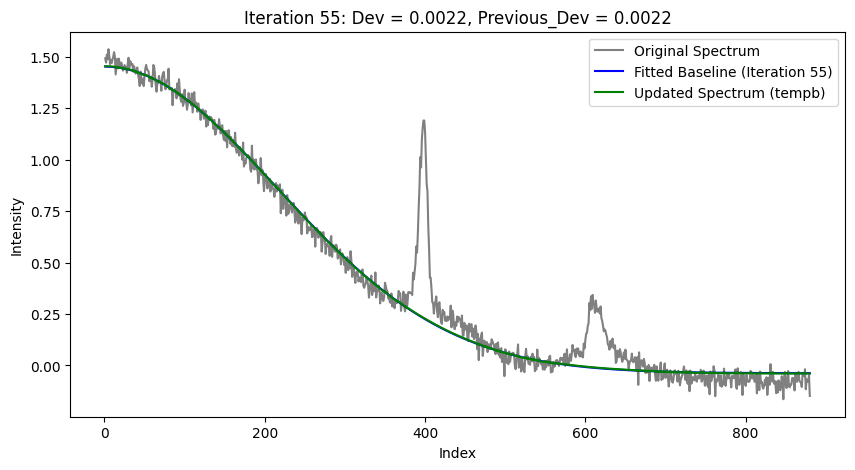

tf.Tensor([[2.2772281e-05 1.4766847e-06 9.9997580e-01]], shape=(1, 3), dtype=float32)


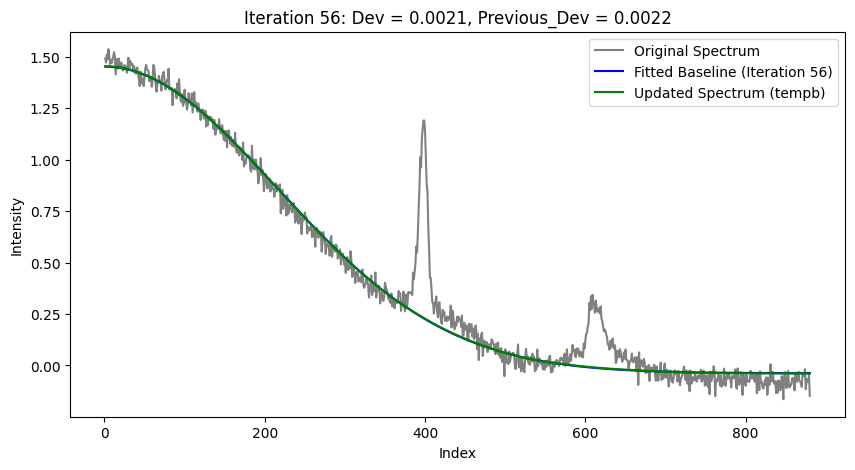

tf.Tensor([[2.2934513e-05 1.4818504e-06 9.9997556e-01]], shape=(1, 3), dtype=float32)


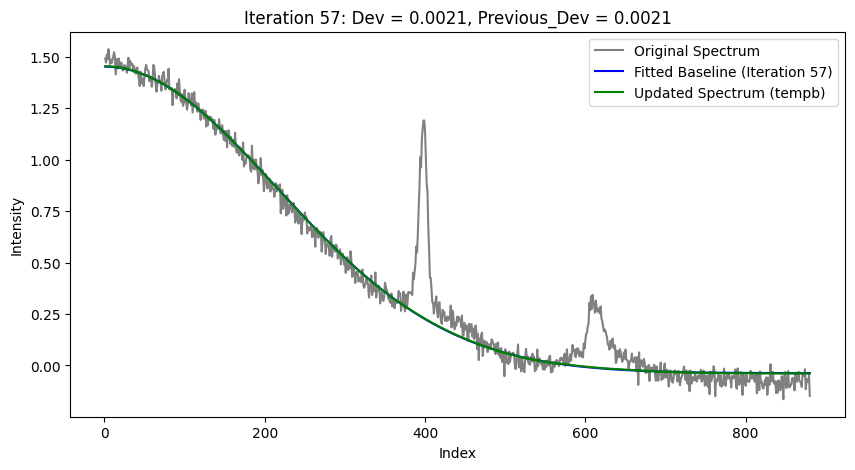

tf.Tensor([[2.3099998e-05 1.4867113e-06 9.9997544e-01]], shape=(1, 3), dtype=float32)


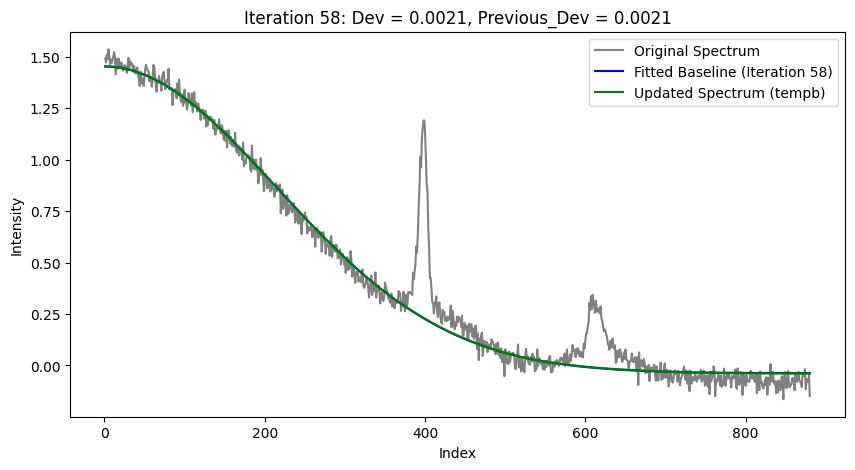

tf.Tensor([[2.3271425e-05 1.4926677e-06 9.9997520e-01]], shape=(1, 3), dtype=float32)


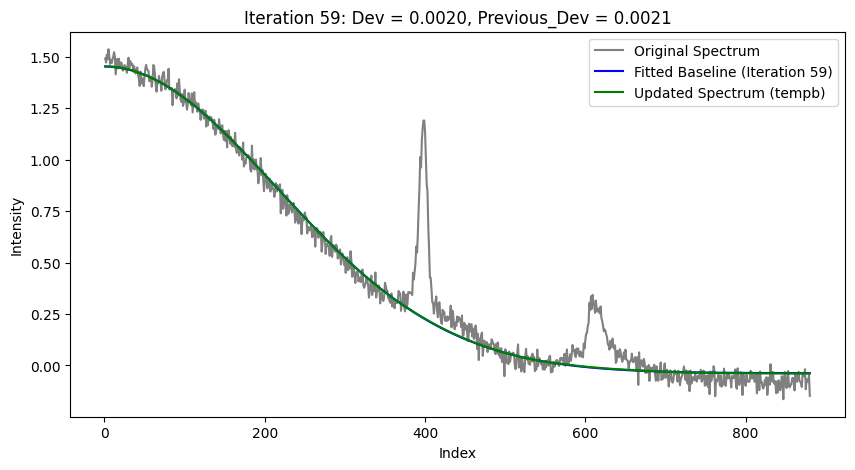

tf.Tensor([[2.3390548e-05 1.4943769e-06 9.9997509e-01]], shape=(1, 3), dtype=float32)


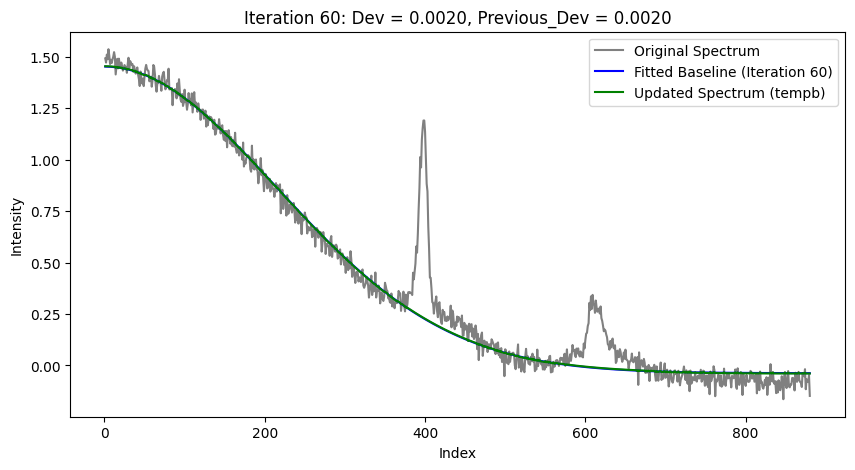

tf.Tensor([[2.3569190e-05 1.4997635e-06 9.9997497e-01]], shape=(1, 3), dtype=float32)


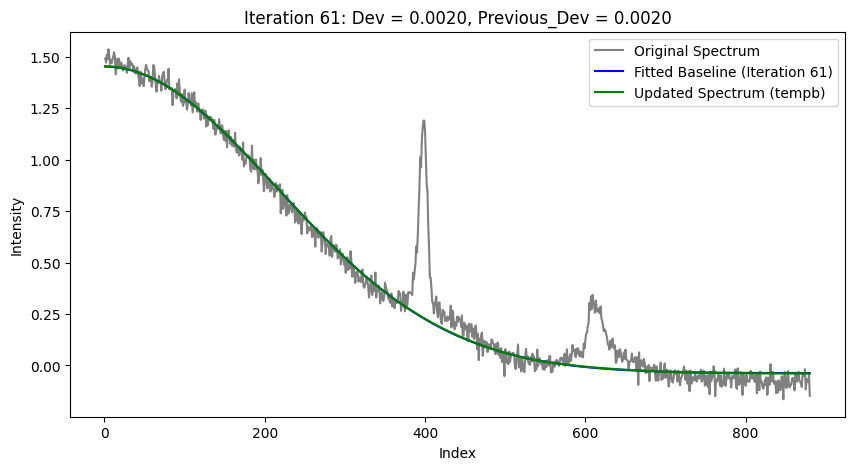

tf.Tensor([[2.3726849e-05 1.5046597e-06 9.9997473e-01]], shape=(1, 3), dtype=float32)


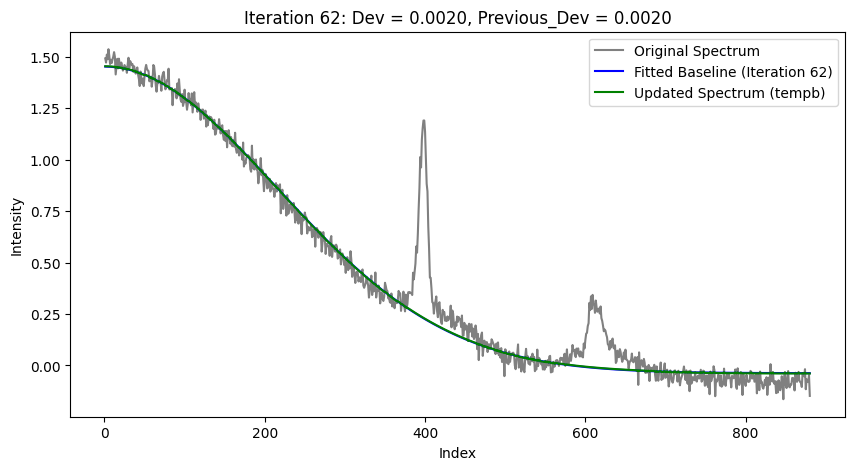

tf.Tensor([[2.3849758e-05 1.5081433e-06 9.9997461e-01]], shape=(1, 3), dtype=float32)


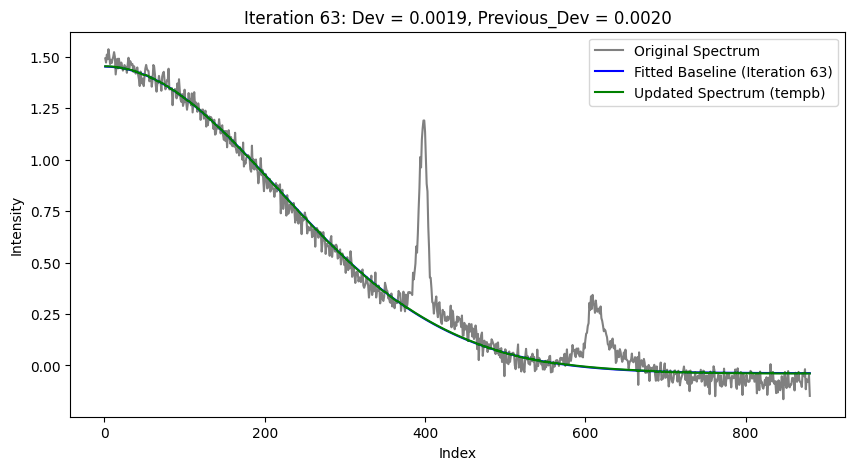

tf.Tensor([[2.4040182e-05 1.5150988e-06 9.9997449e-01]], shape=(1, 3), dtype=float32)


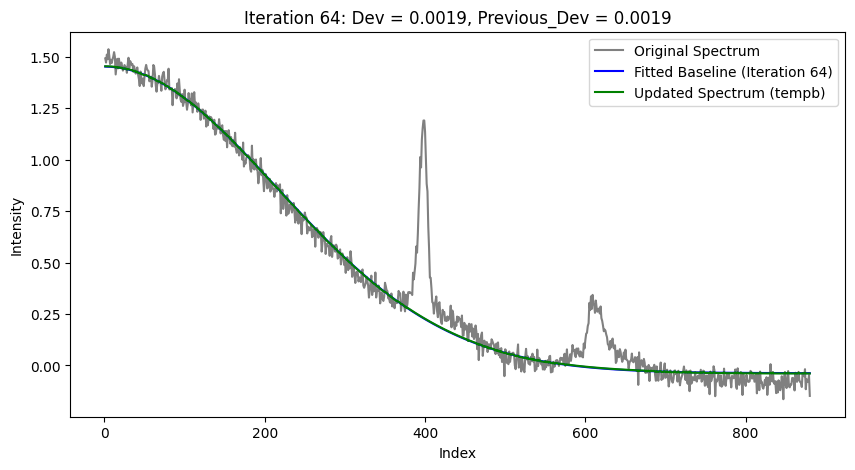

tf.Tensor([[2.4154555e-05 1.5171822e-06 9.9997437e-01]], shape=(1, 3), dtype=float32)


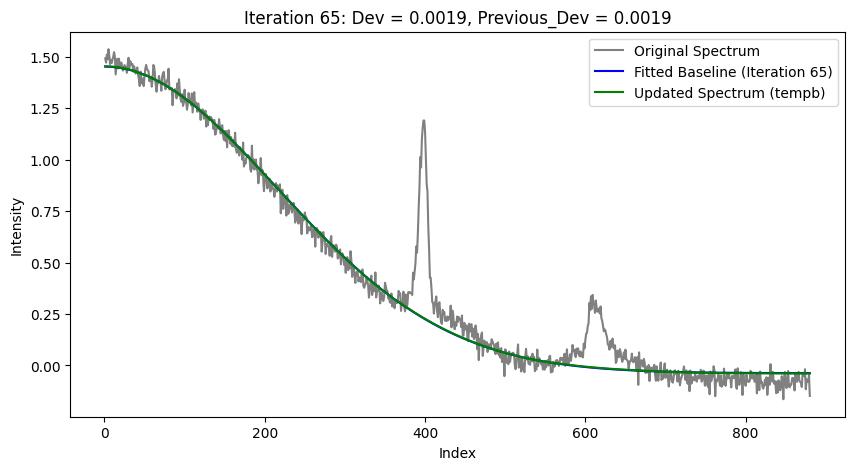

tf.Tensor([[2.4270768e-05 1.5202091e-06 9.9997425e-01]], shape=(1, 3), dtype=float32)


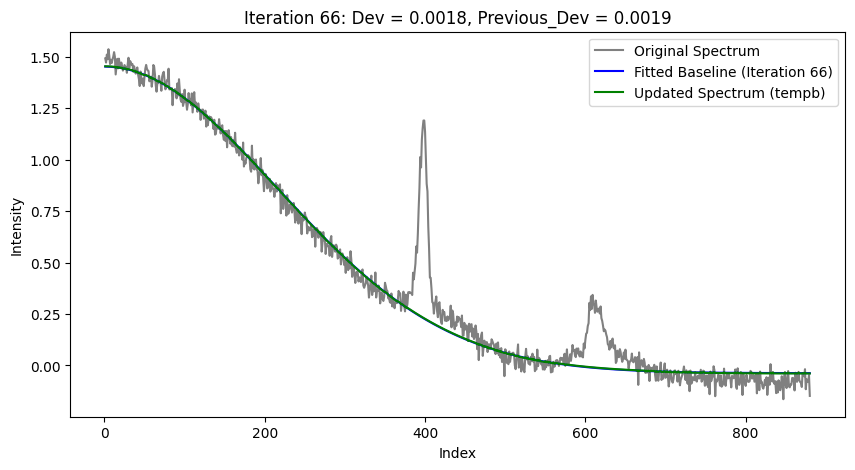

tf.Tensor([[2.4433610e-05 1.5257672e-06 9.9997401e-01]], shape=(1, 3), dtype=float32)


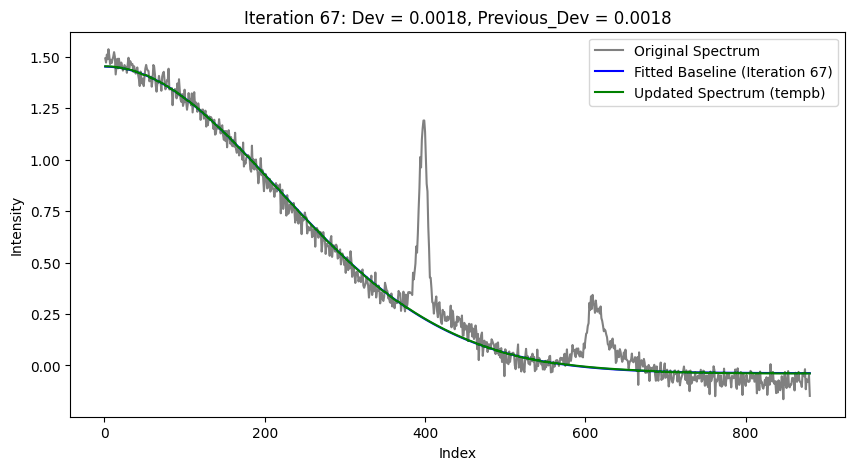

tf.Tensor([[2.4580826e-05 1.5303677e-06 9.9997389e-01]], shape=(1, 3), dtype=float32)


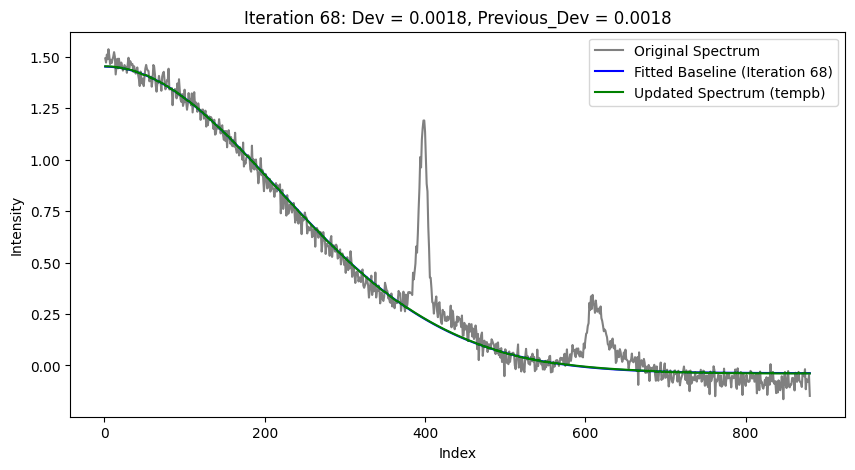

tf.Tensor([[2.4726383e-05 1.5352148e-06 9.9997377e-01]], shape=(1, 3), dtype=float32)


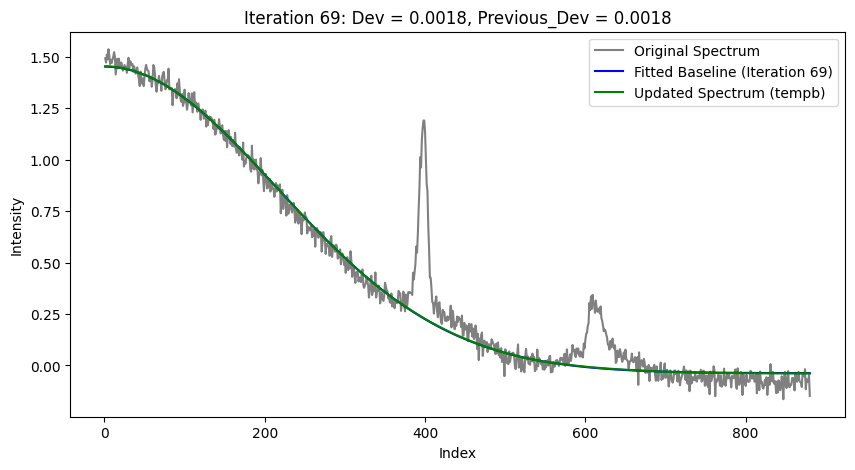

tf.Tensor([[2.4876927e-05 1.5397700e-06 9.9997354e-01]], shape=(1, 3), dtype=float32)


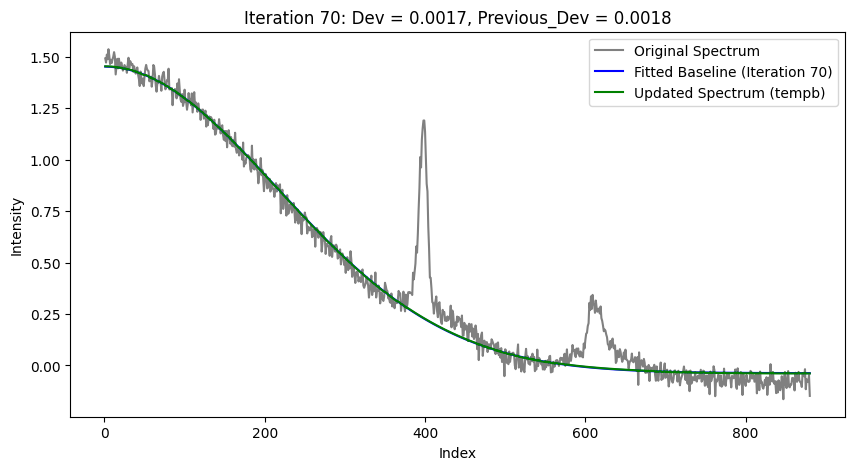

tf.Tensor([[2.5010158e-05 1.5428404e-06 9.9997342e-01]], shape=(1, 3), dtype=float32)


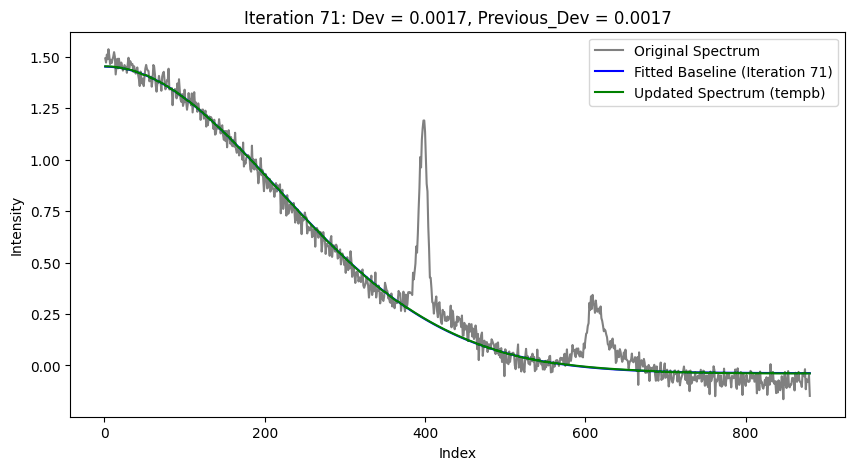

tf.Tensor([[2.5118989e-05 1.5455087e-06 9.9997330e-01]], shape=(1, 3), dtype=float32)


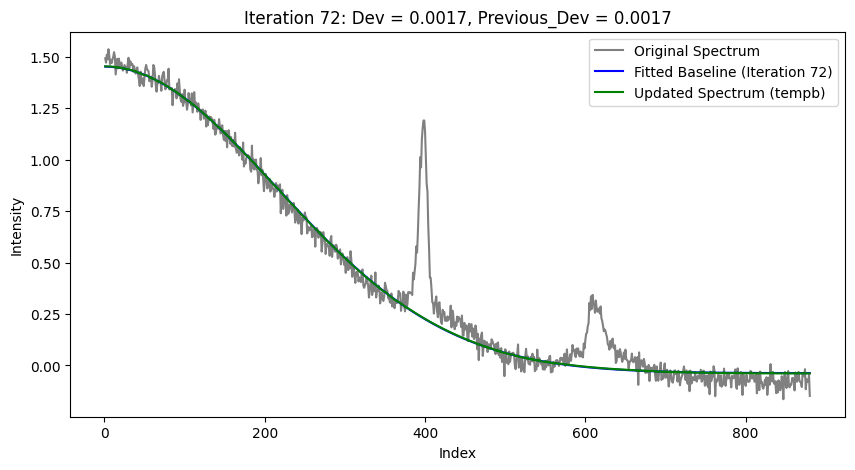

tf.Tensor([[2.5453857e-05 1.5579743e-06 9.9997294e-01]], shape=(1, 3), dtype=float32)


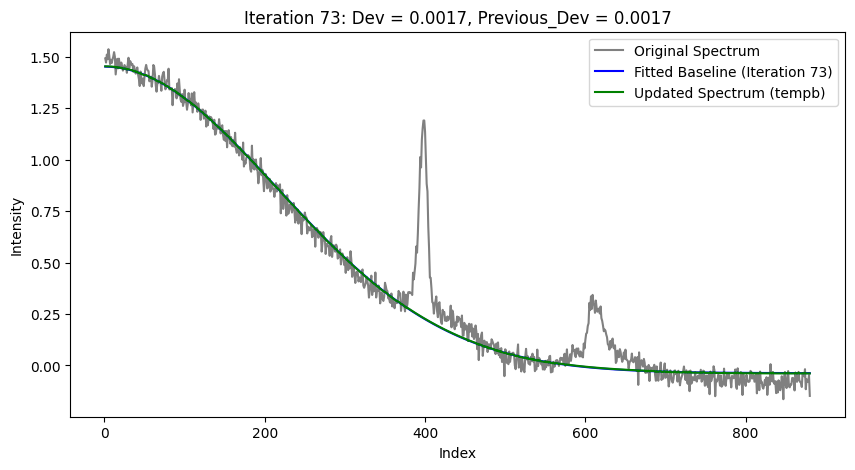

tf.Tensor([[2.5594260e-05 1.5628194e-06 9.9997282e-01]], shape=(1, 3), dtype=float32)


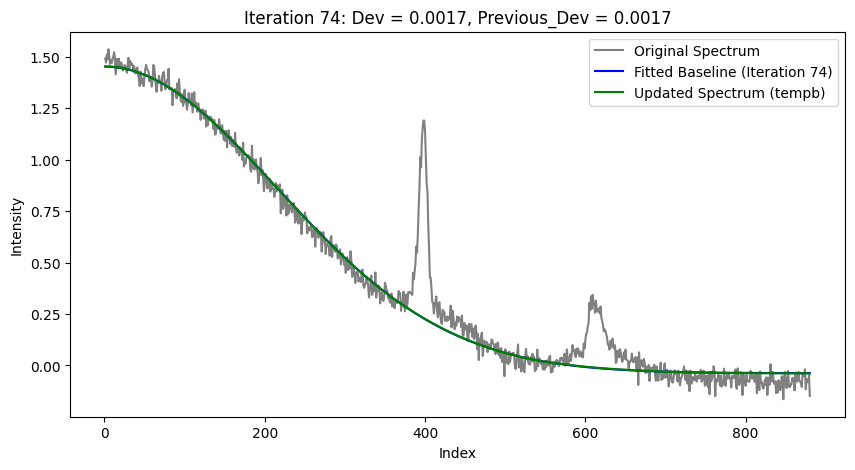

tf.Tensor([[2.5703766e-05 1.5668263e-06 9.9997270e-01]], shape=(1, 3), dtype=float32)


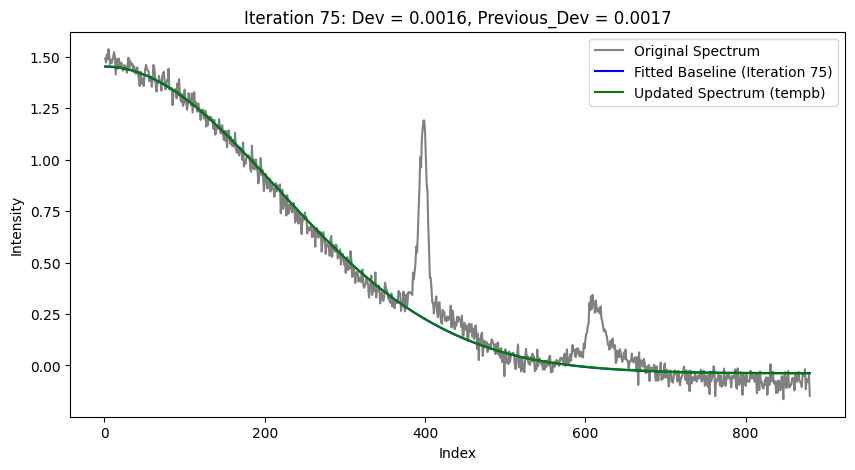

tf.Tensor([[2.5834357e-05 1.5712372e-06 9.9997258e-01]], shape=(1, 3), dtype=float32)


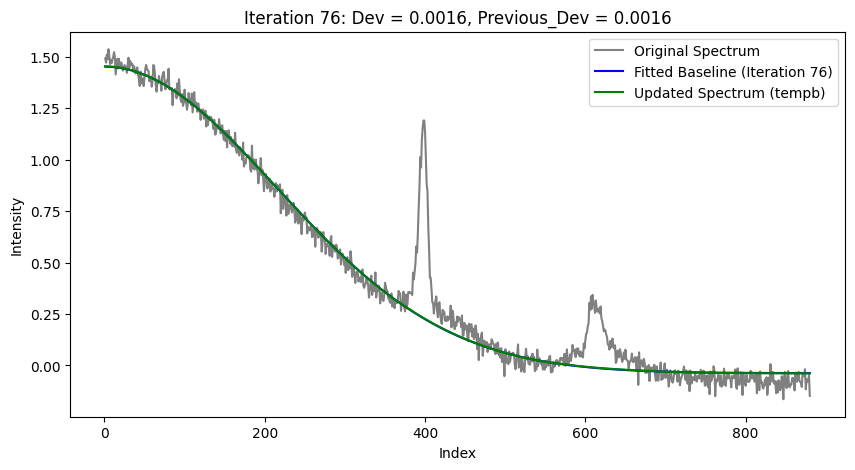

tf.Tensor([[2.5930469e-05 1.5732808e-06 9.9997246e-01]], shape=(1, 3), dtype=float32)


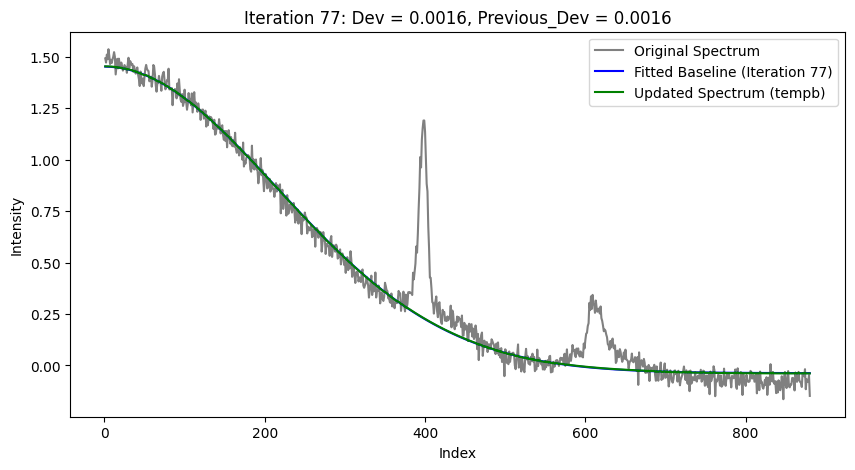

tf.Tensor([[2.6029125e-05 1.5758604e-06 9.9997234e-01]], shape=(1, 3), dtype=float32)


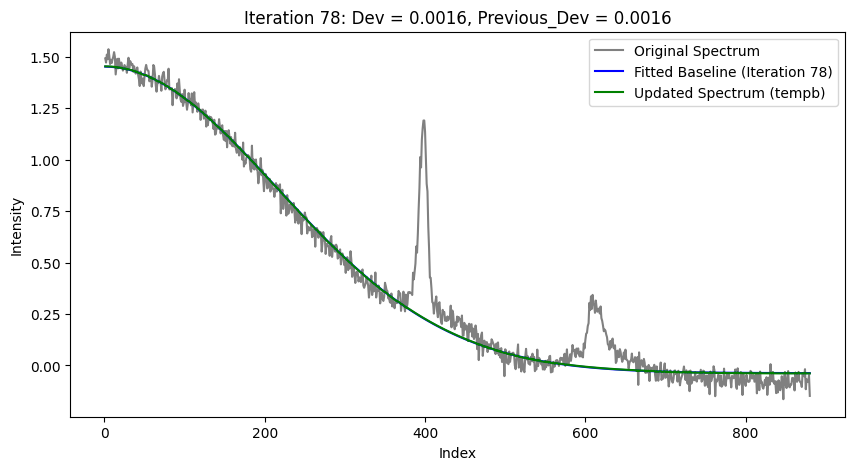

tf.Tensor([[2.6139247e-05 1.5788055e-06 9.9997222e-01]], shape=(1, 3), dtype=float32)


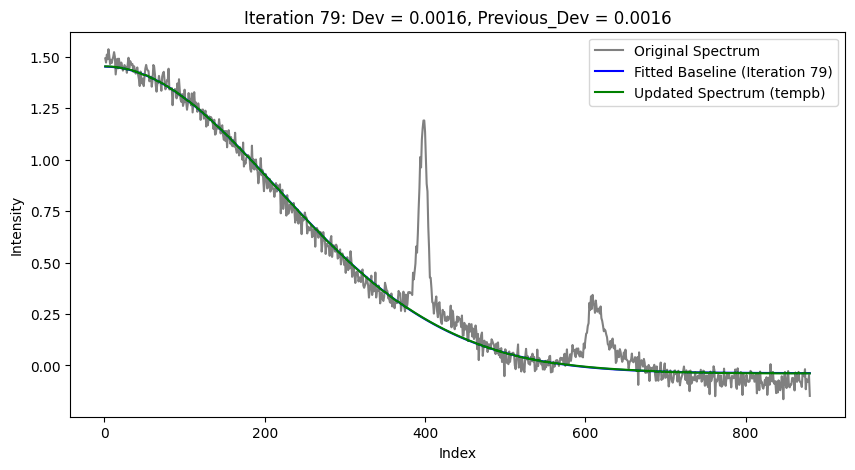

tf.Tensor([[2.6236748e-05 1.5822950e-06 9.9997222e-01]], shape=(1, 3), dtype=float32)


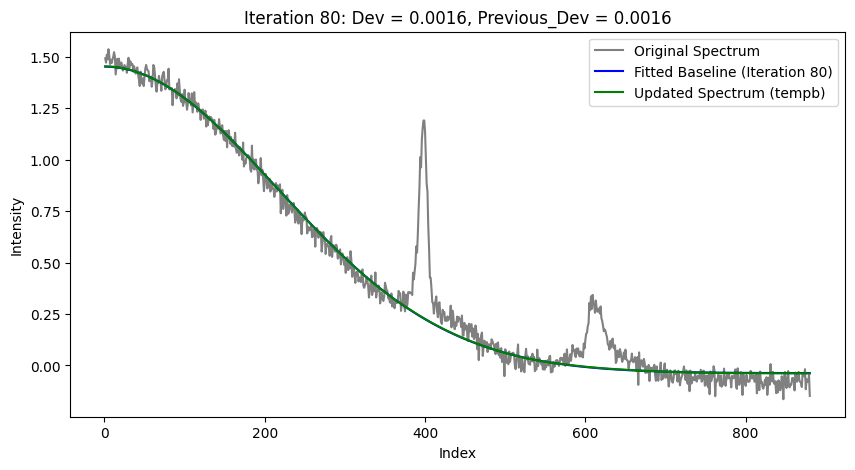

tf.Tensor([[2.6320049e-05 1.5845795e-06 9.9997211e-01]], shape=(1, 3), dtype=float32)


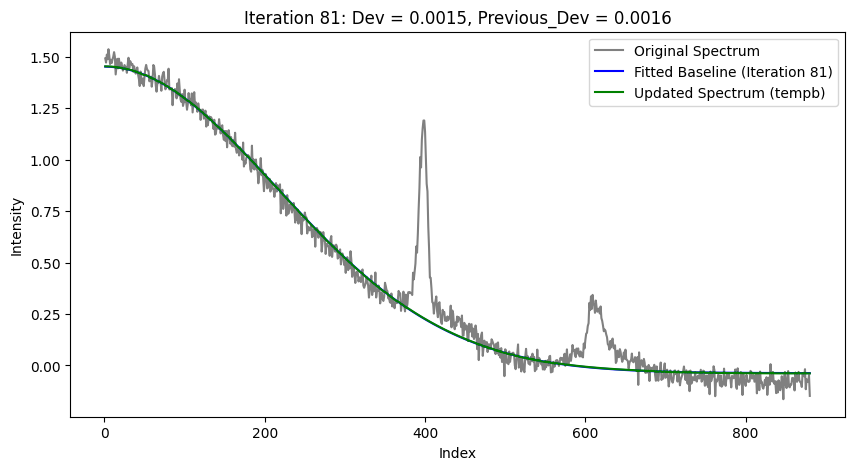

tf.Tensor([[2.6406709e-05 1.5868023e-06 9.9997199e-01]], shape=(1, 3), dtype=float32)


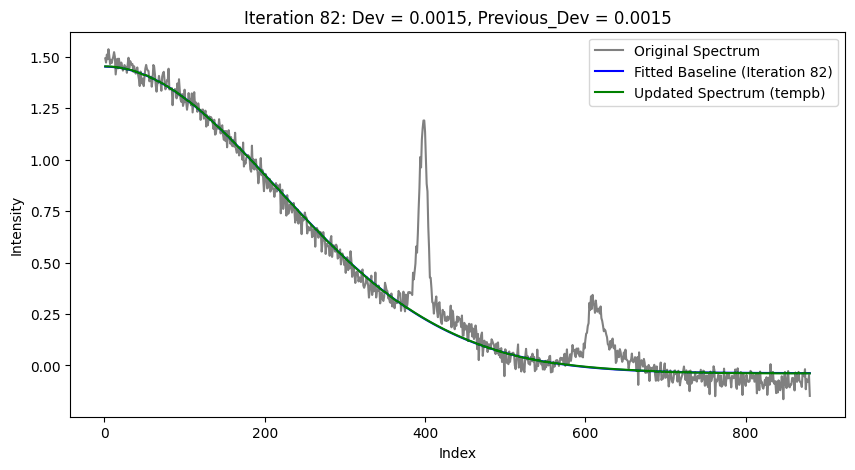

tf.Tensor([[2.6527561e-05 1.5903867e-06 9.9997187e-01]], shape=(1, 3), dtype=float32)


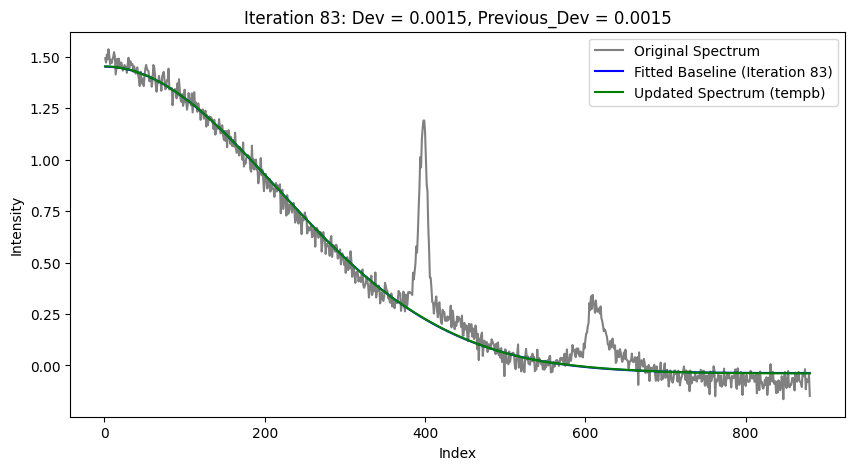

tf.Tensor([[2.6615771e-05 1.5933058e-06 9.9997175e-01]], shape=(1, 3), dtype=float32)


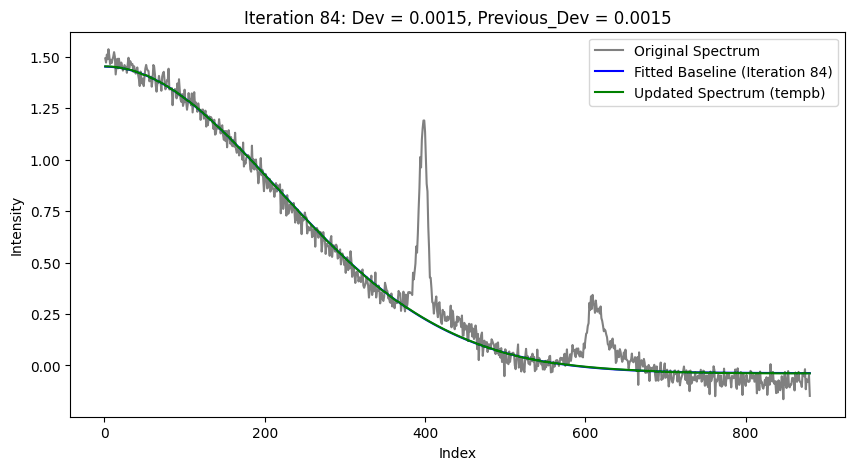

tf.Tensor([[2.6723810e-05 1.5966124e-06 9.9997163e-01]], shape=(1, 3), dtype=float32)


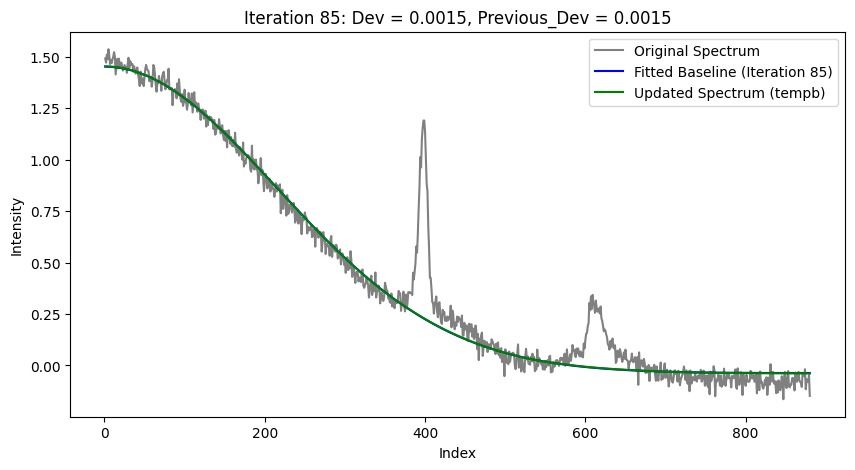

tf.Tensor([[2.6803626e-05 1.5970372e-06 9.9997163e-01]], shape=(1, 3), dtype=float32)


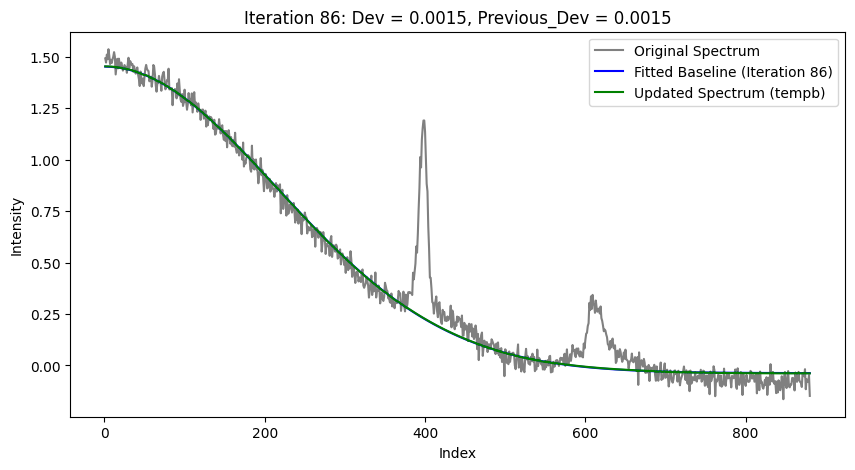

tf.Tensor([[2.6884209e-05 1.5992348e-06 9.9997151e-01]], shape=(1, 3), dtype=float32)


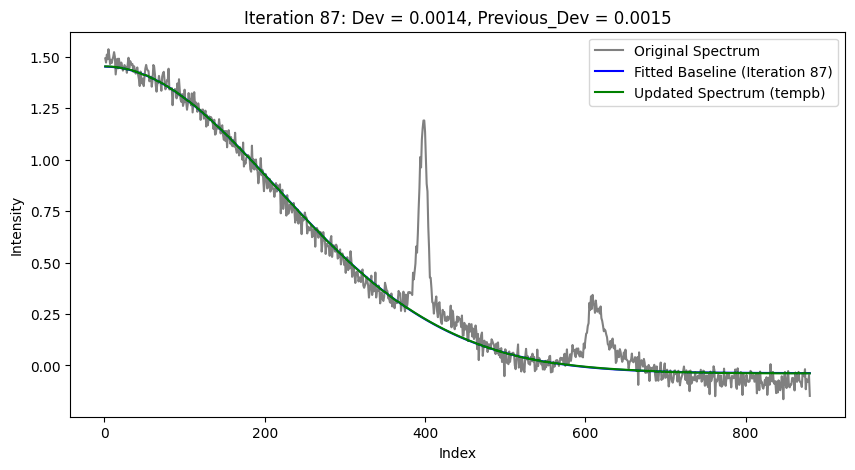

tf.Tensor([[2.6965039e-05 1.6017011e-06 9.9997139e-01]], shape=(1, 3), dtype=float32)


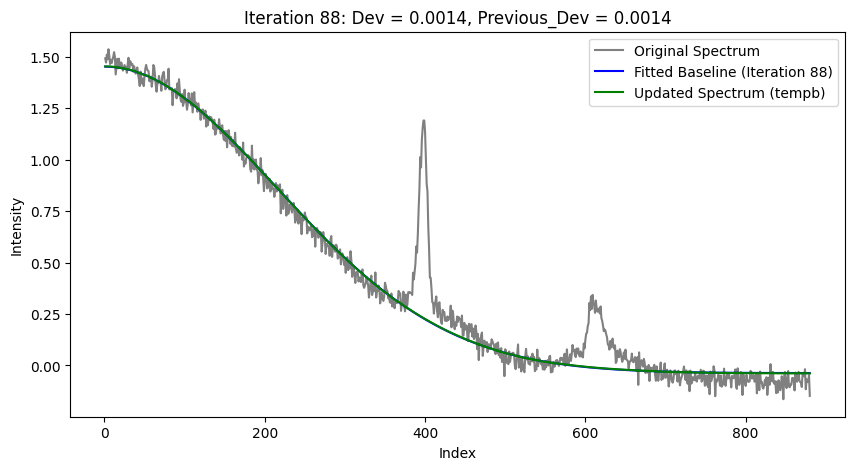

tf.Tensor([[2.7068714e-05 1.6053222e-06 9.9997127e-01]], shape=(1, 3), dtype=float32)


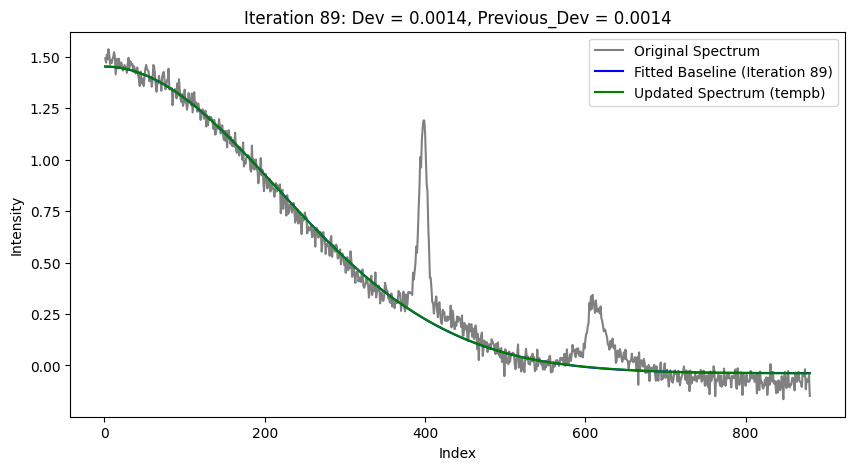

tf.Tensor([[2.7154765e-05 1.6086186e-06 9.9997127e-01]], shape=(1, 3), dtype=float32)


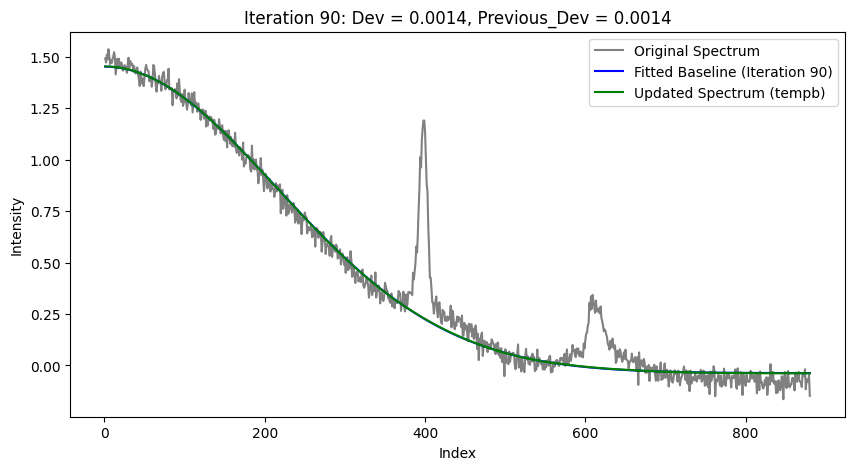

tf.Tensor([[2.7236278e-05 1.6106218e-06 9.9997115e-01]], shape=(1, 3), dtype=float32)


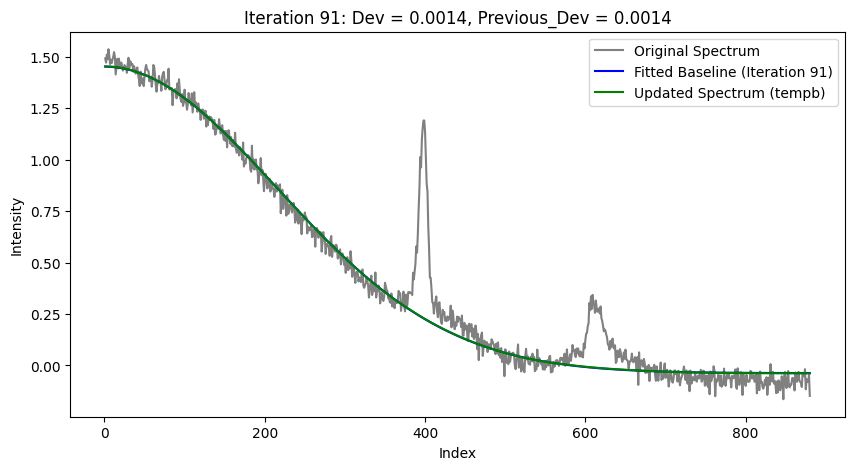

tf.Tensor([[2.7329761e-05 1.6135119e-06 9.9997103e-01]], shape=(1, 3), dtype=float32)


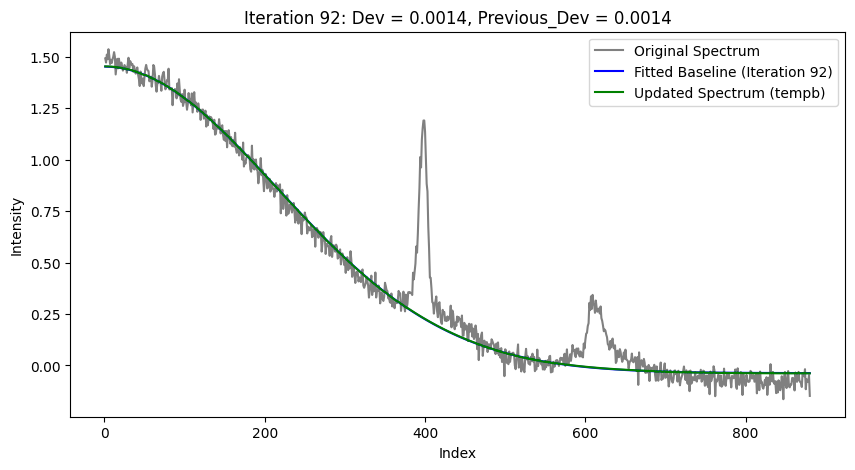

tf.Tensor([[2.7450960e-05 1.6172152e-06 9.9997091e-01]], shape=(1, 3), dtype=float32)


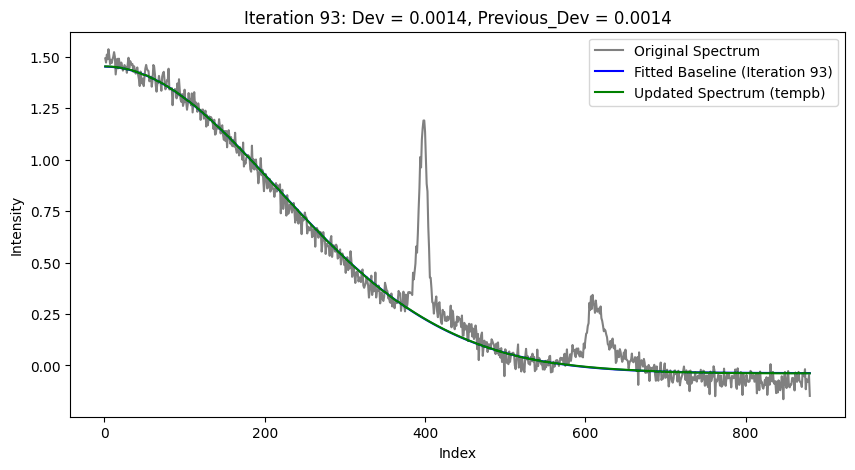

tf.Tensor([[2.7525804e-05 1.6187689e-06 9.9997091e-01]], shape=(1, 3), dtype=float32)


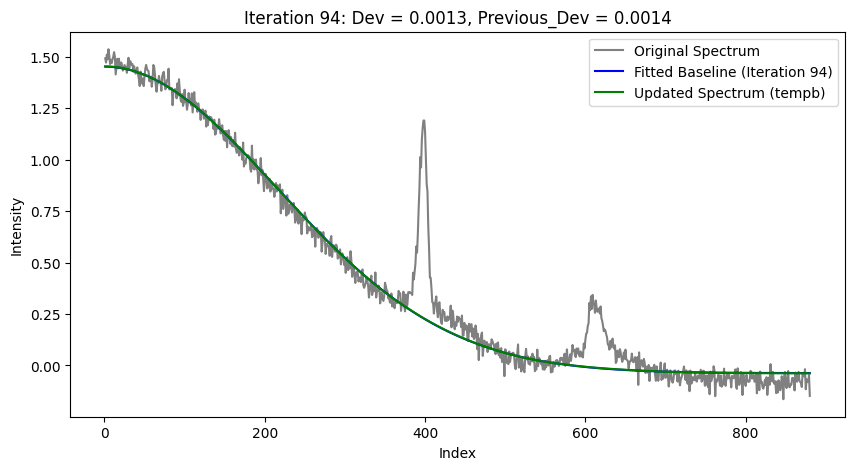

tf.Tensor([[2.757764e-05 1.619493e-06 9.999708e-01]], shape=(1, 3), dtype=float32)


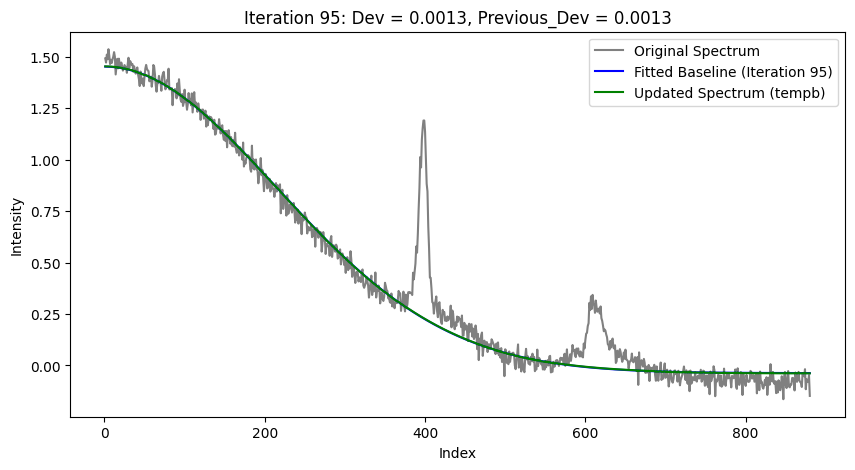

tf.Tensor([[2.7633216e-05 1.6207306e-06 9.9997079e-01]], shape=(1, 3), dtype=float32)


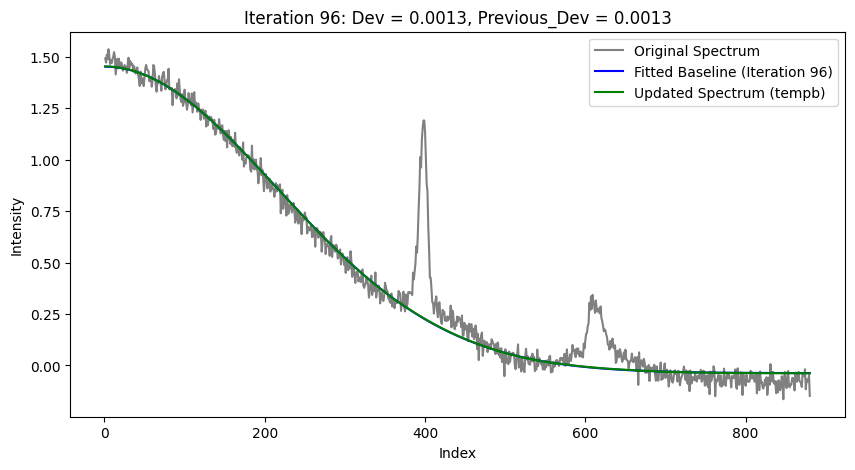

tf.Tensor([[2.7691385e-05 1.6223015e-06 9.9997067e-01]], shape=(1, 3), dtype=float32)


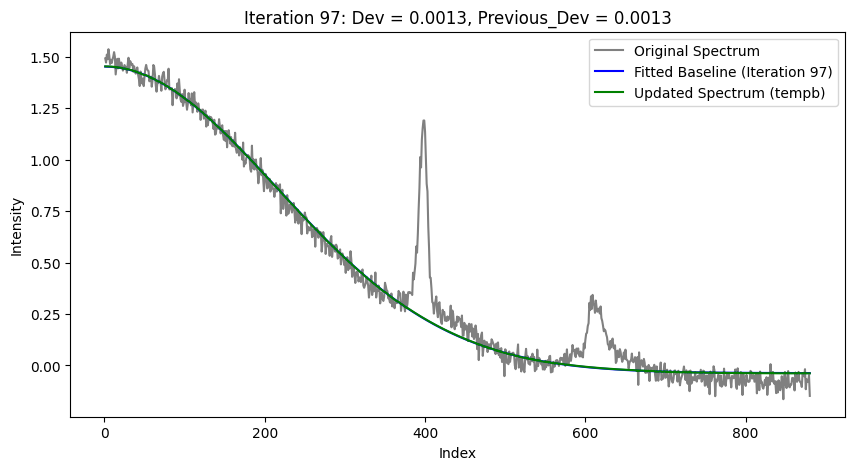

tf.Tensor([[2.7827984e-05 1.6265506e-06 9.9997056e-01]], shape=(1, 3), dtype=float32)


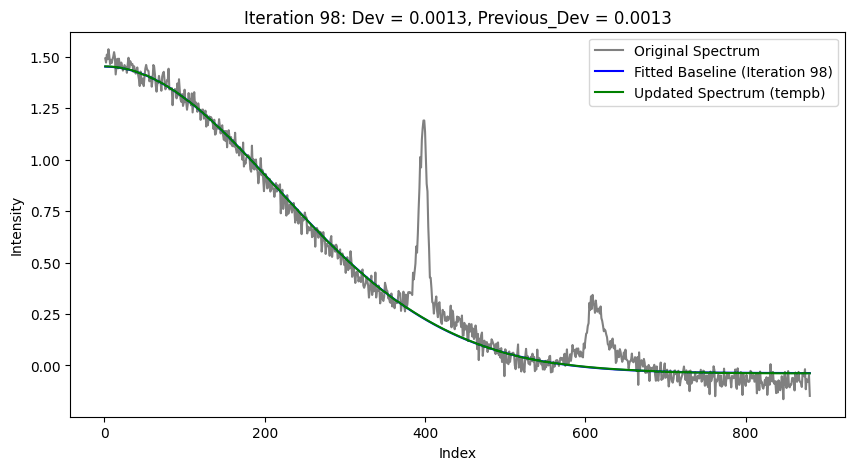

tf.Tensor([[2.7891774e-05 1.6279953e-06 9.9997044e-01]], shape=(1, 3), dtype=float32)


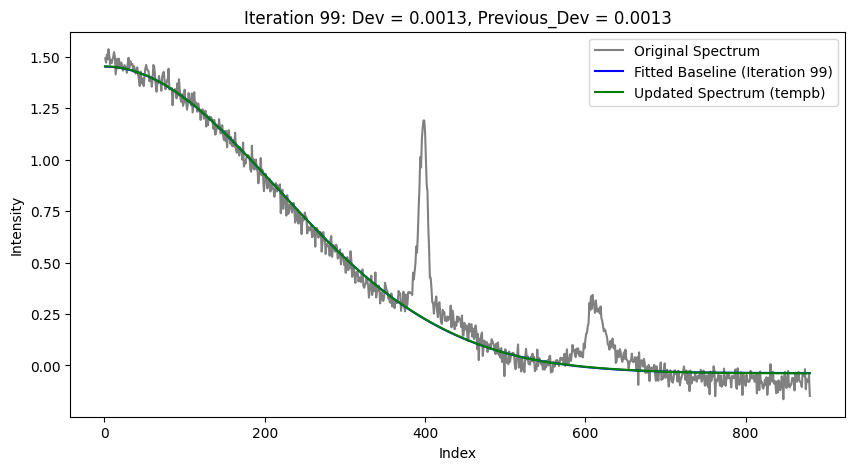

tf.Tensor([[2.7973792e-05 1.6301018e-06 9.9997044e-01]], shape=(1, 3), dtype=float32)


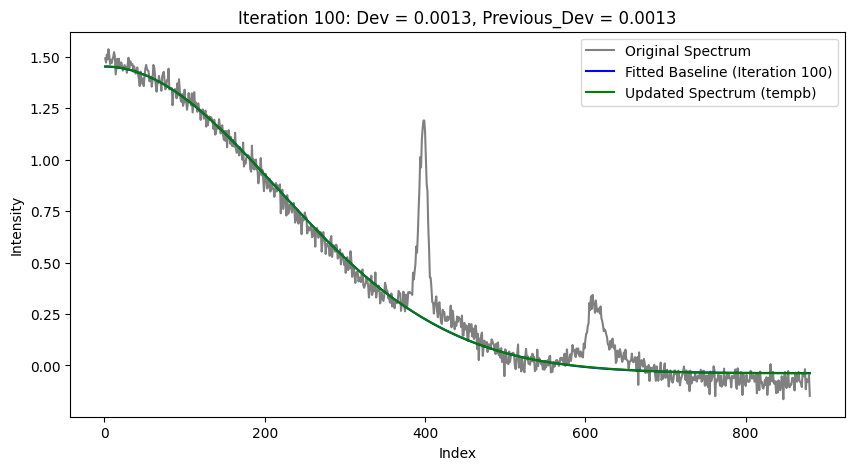

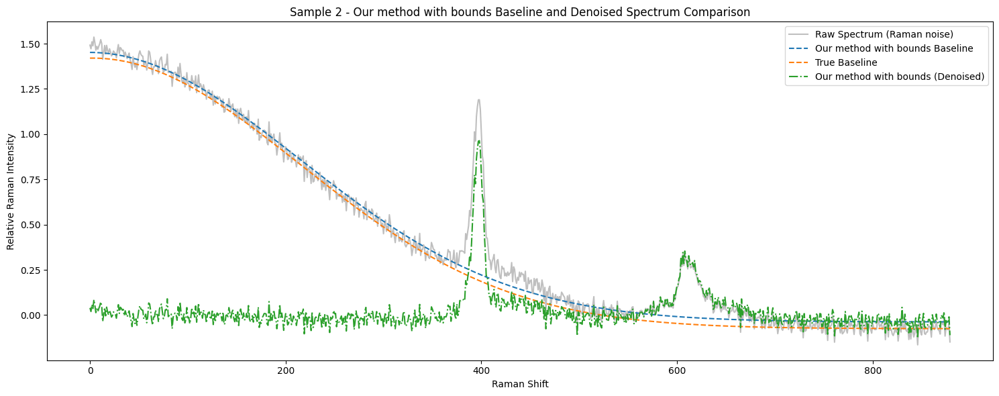

tf.Tensor([[1.8433920e-36 1.0000000e+00 1.6005105e-28]], shape=(1, 3), dtype=float32)


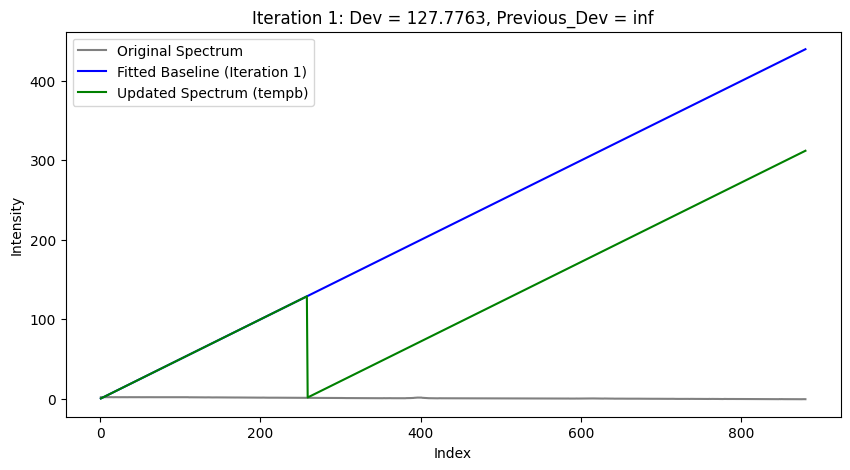

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


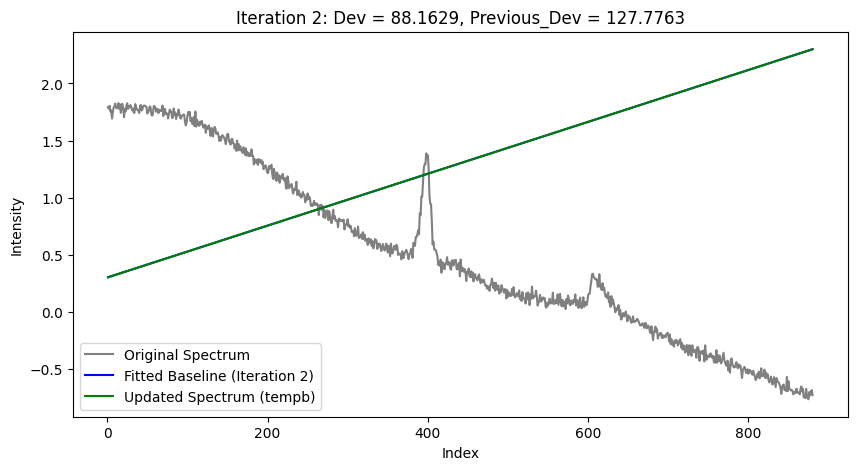

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


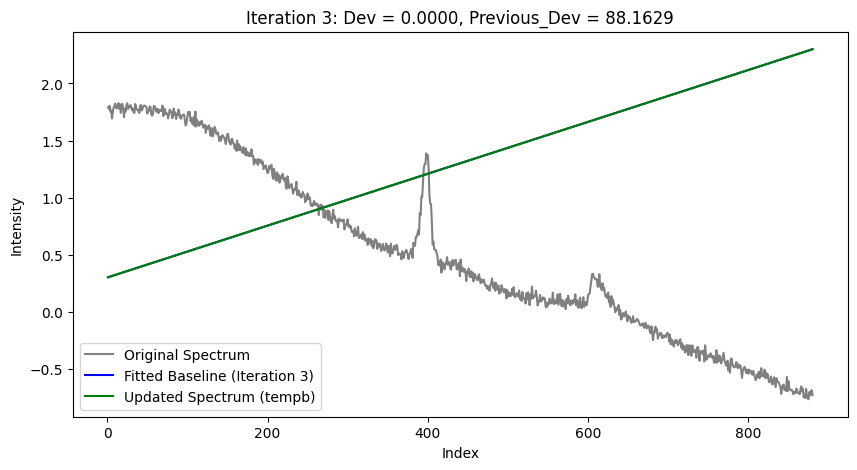

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


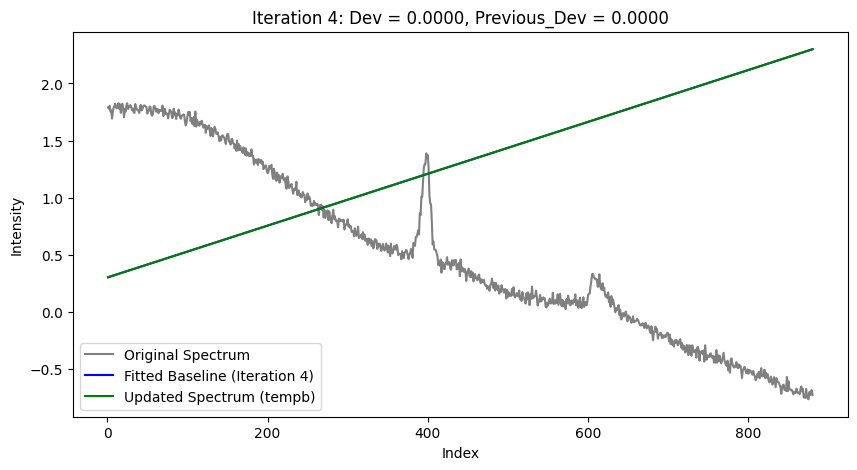

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


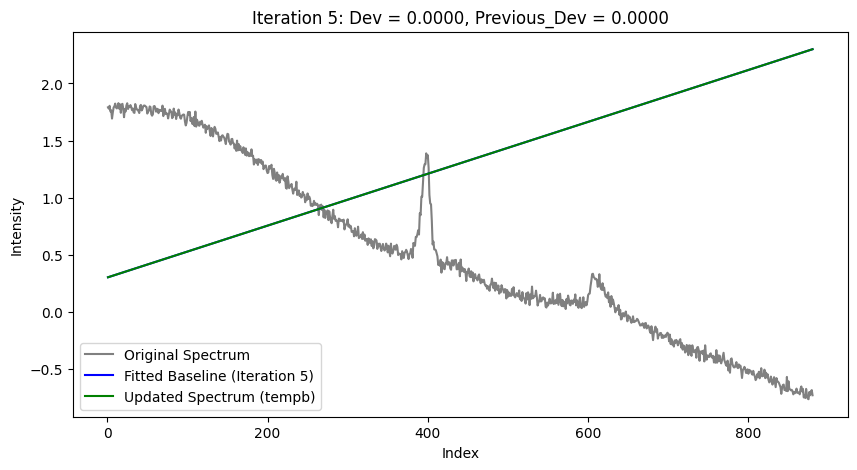

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


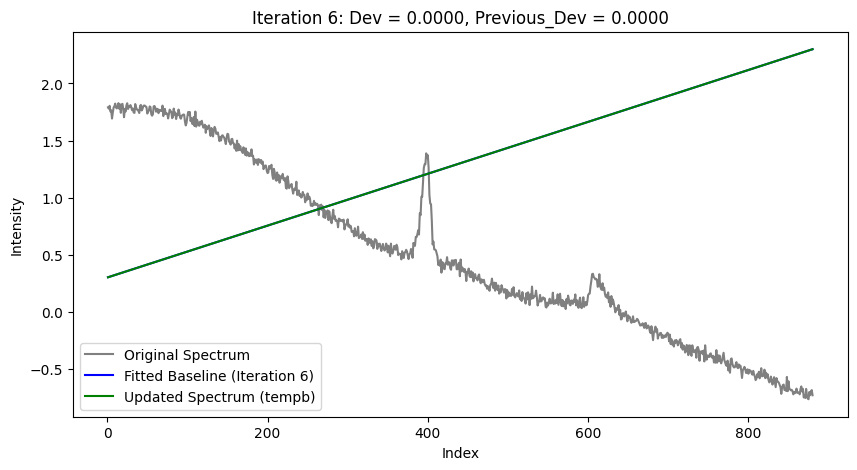

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


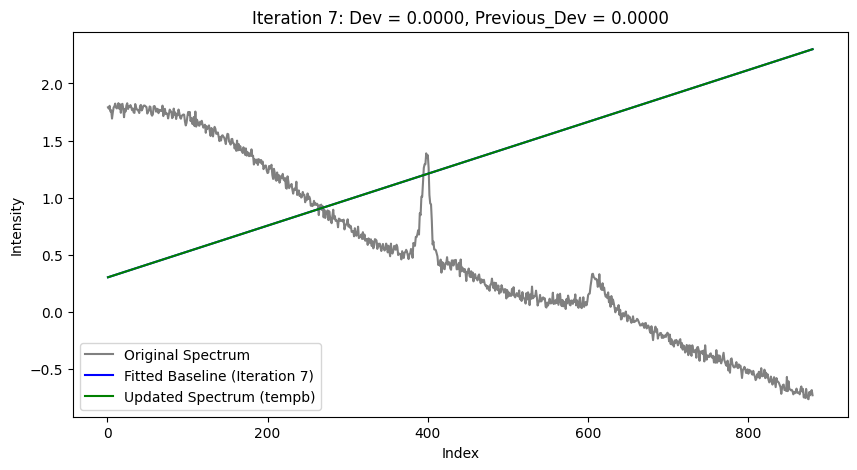

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


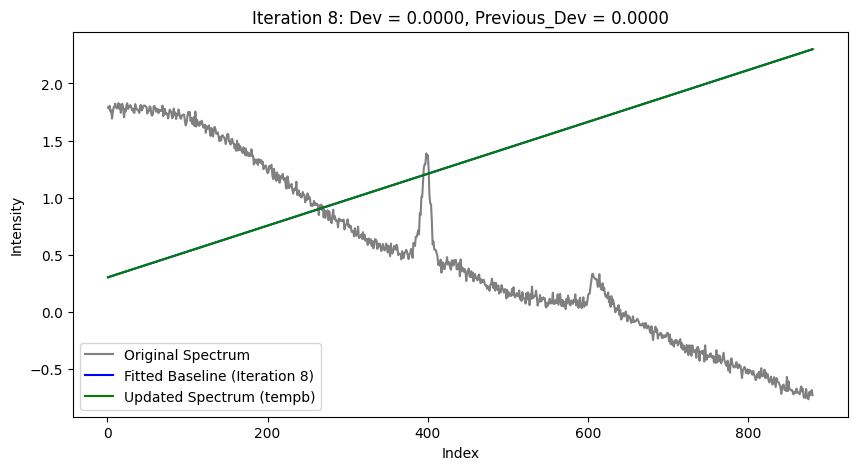

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


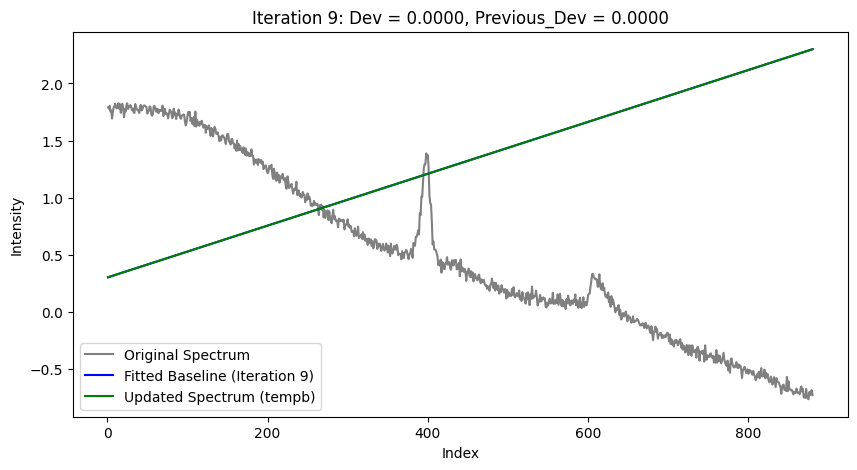

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


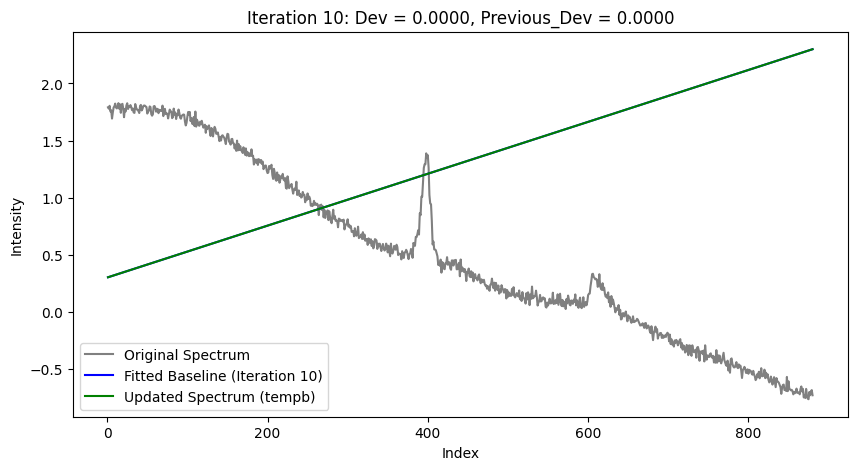

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


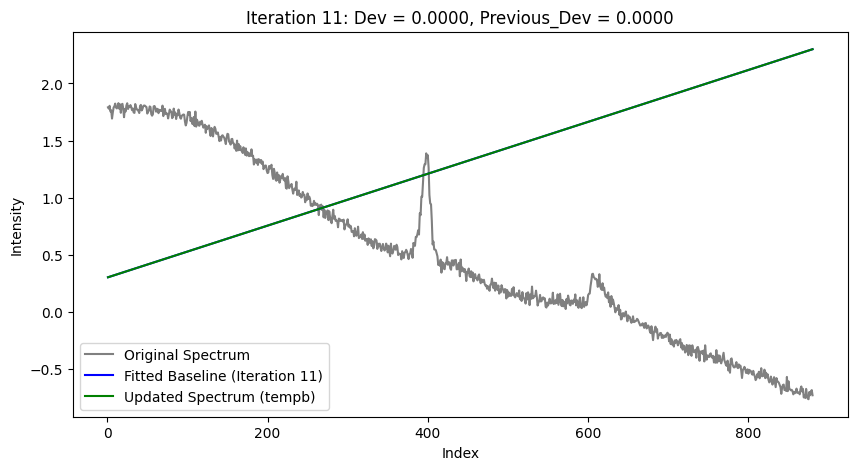

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


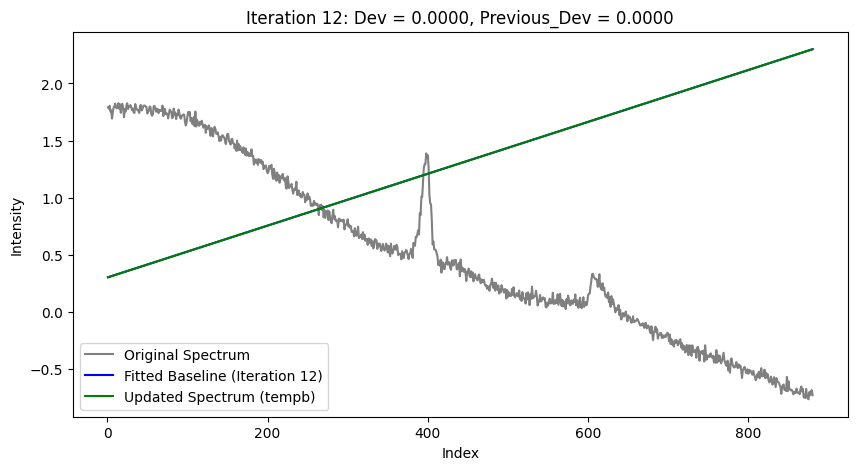

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


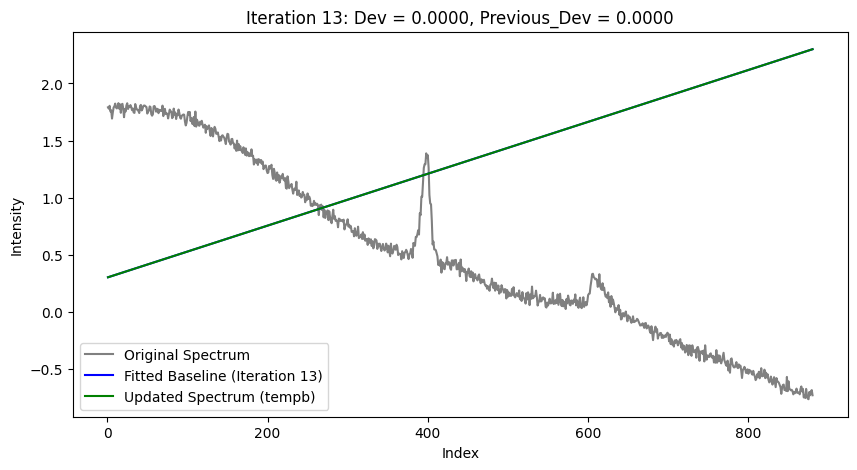

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


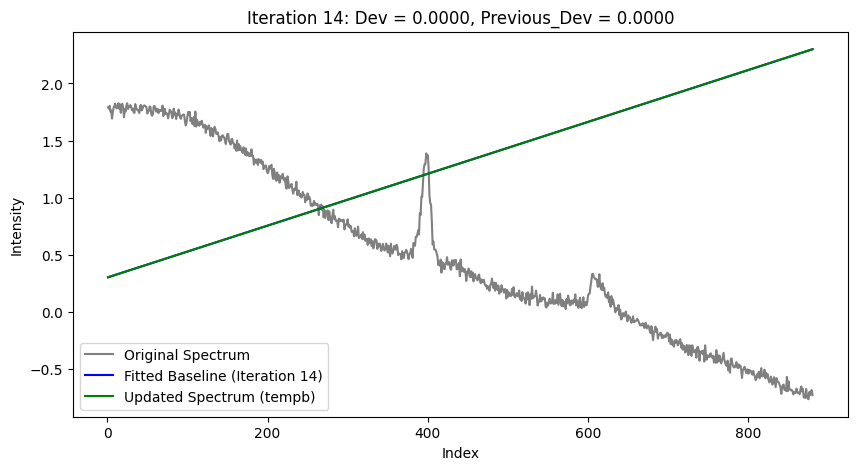

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


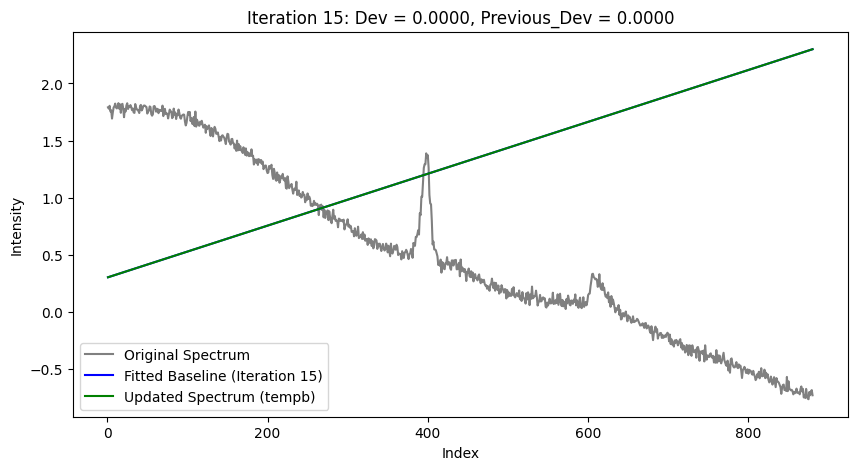

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


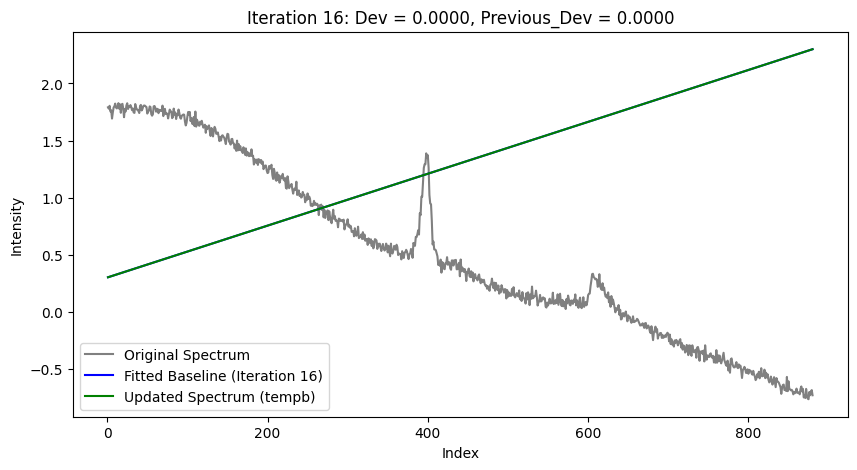

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


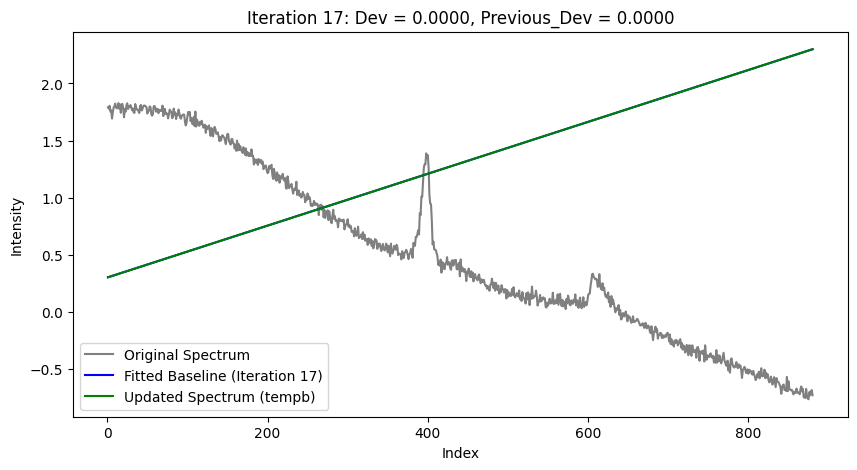

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


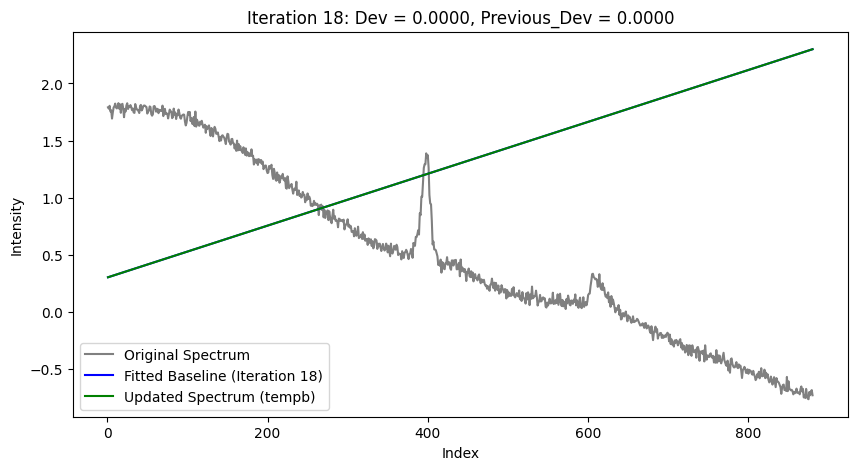

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


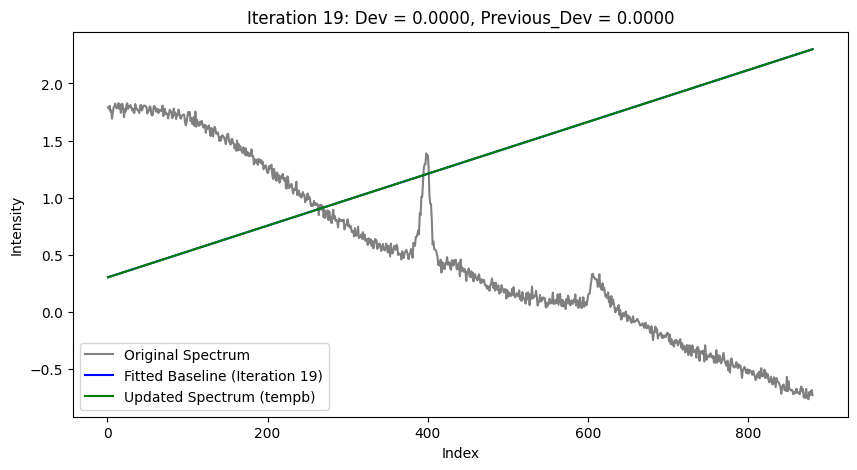

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


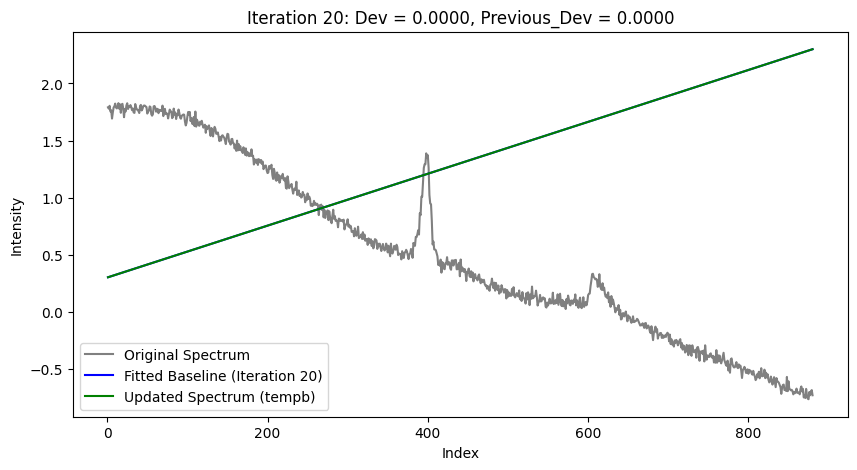

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


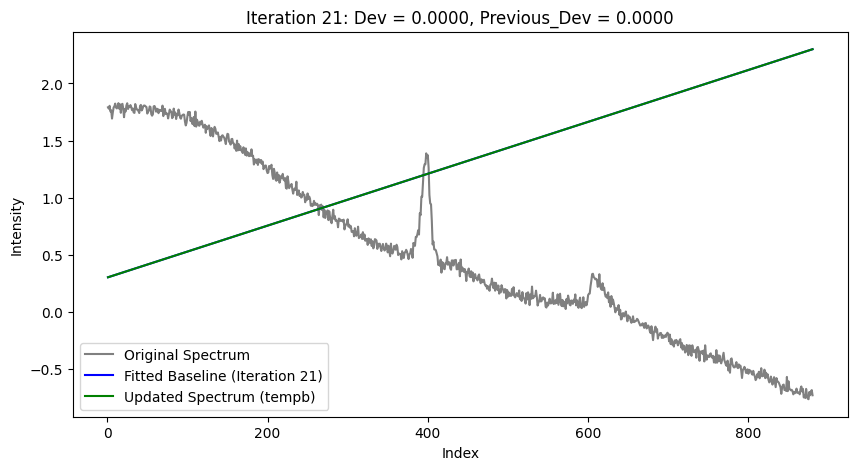

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


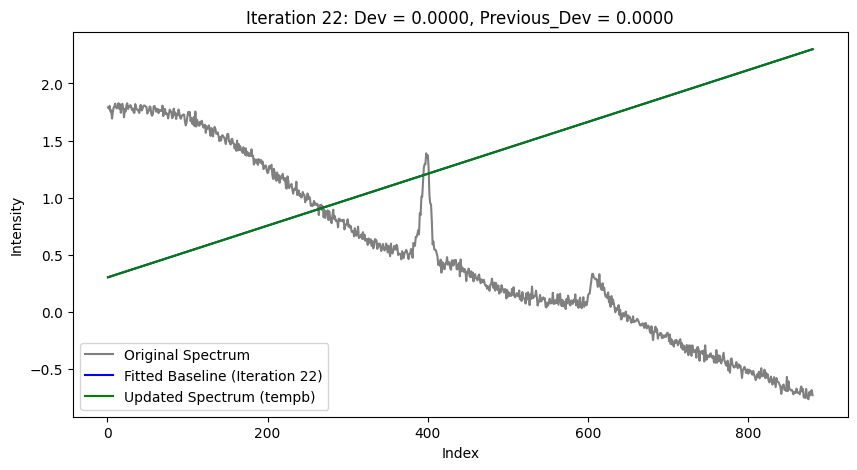

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


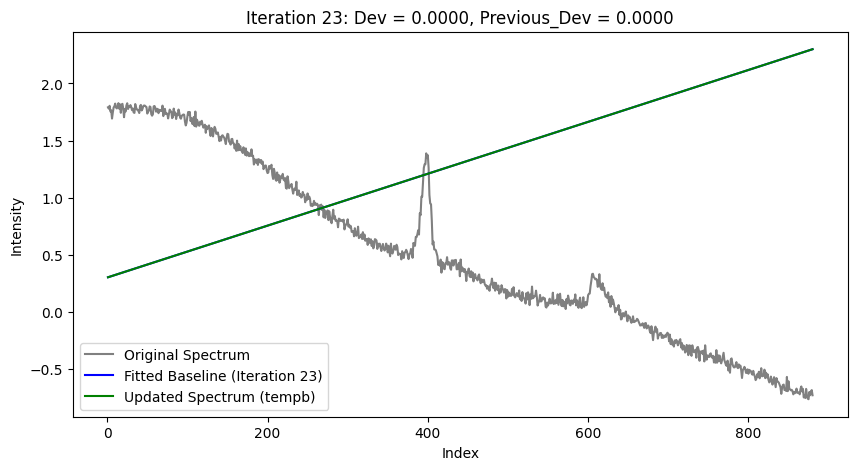

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


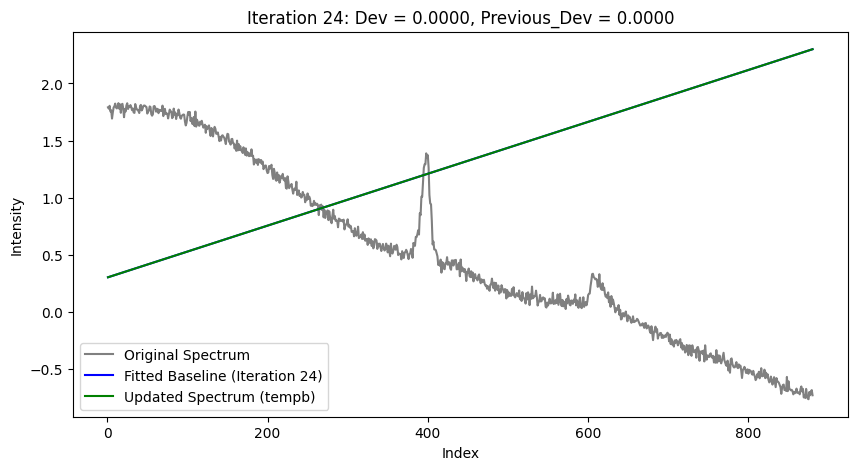

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


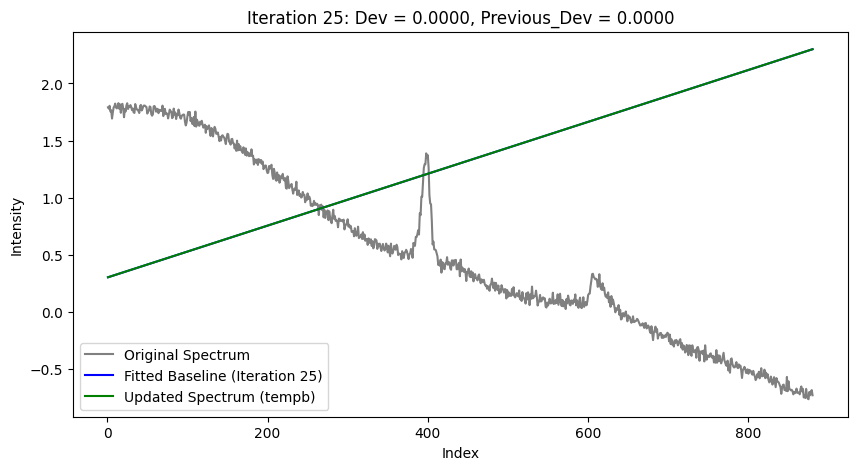

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


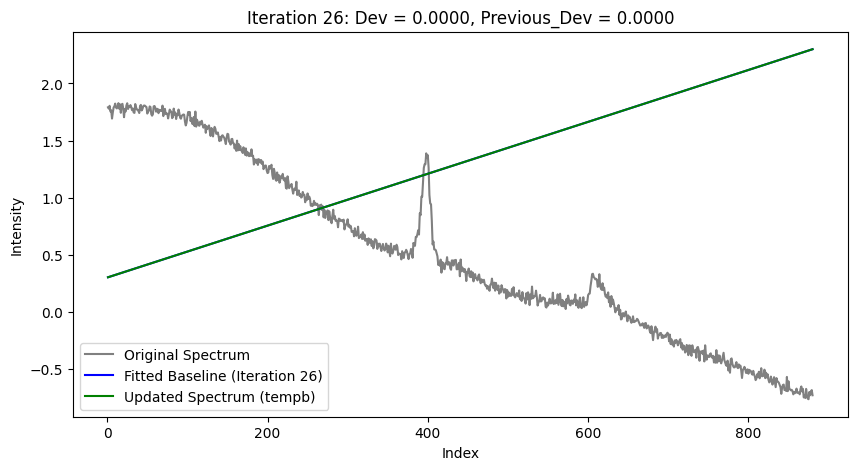

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


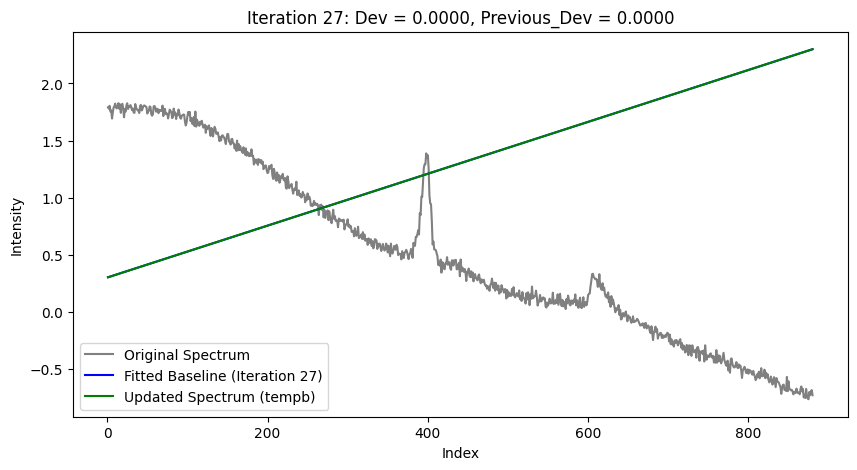

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


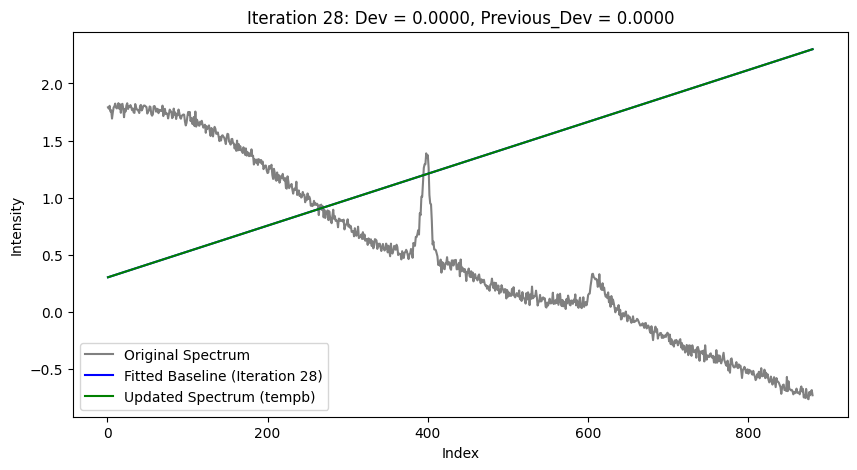

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


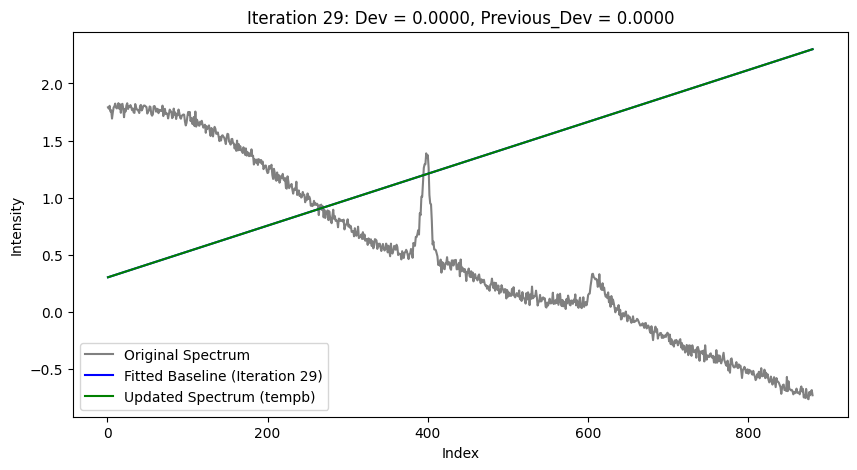

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


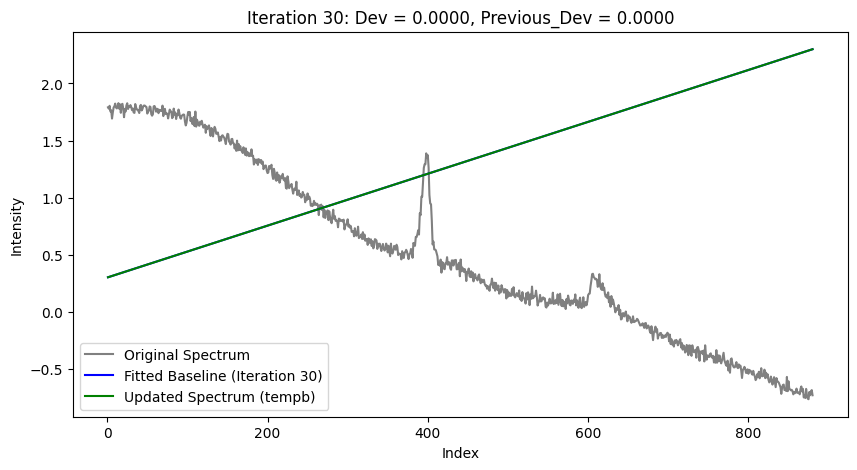

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


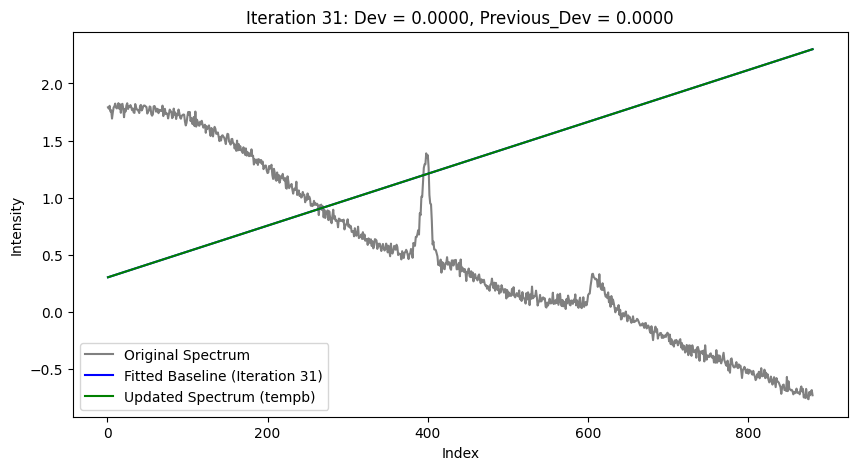

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


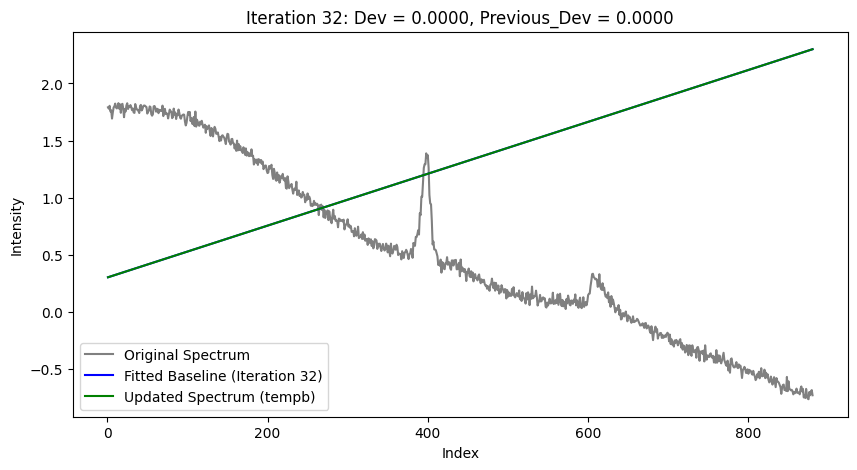

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


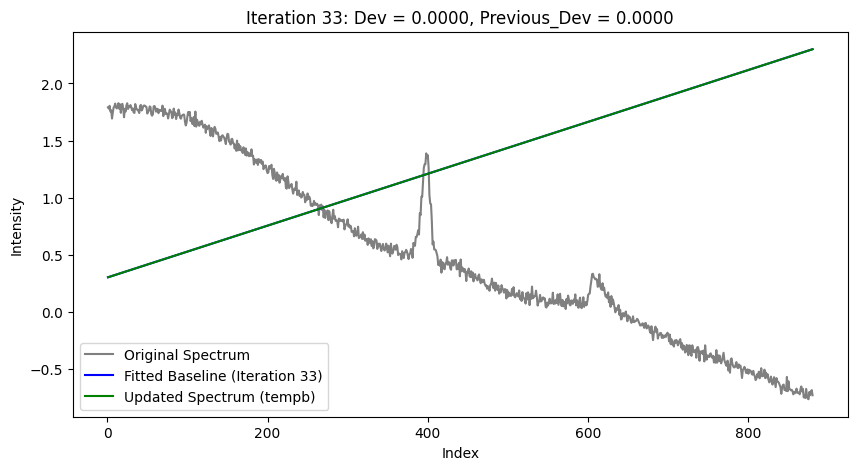

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


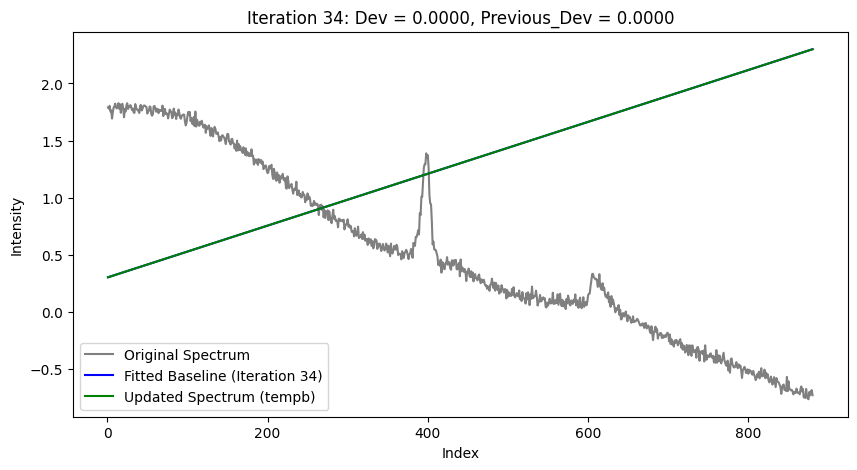

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


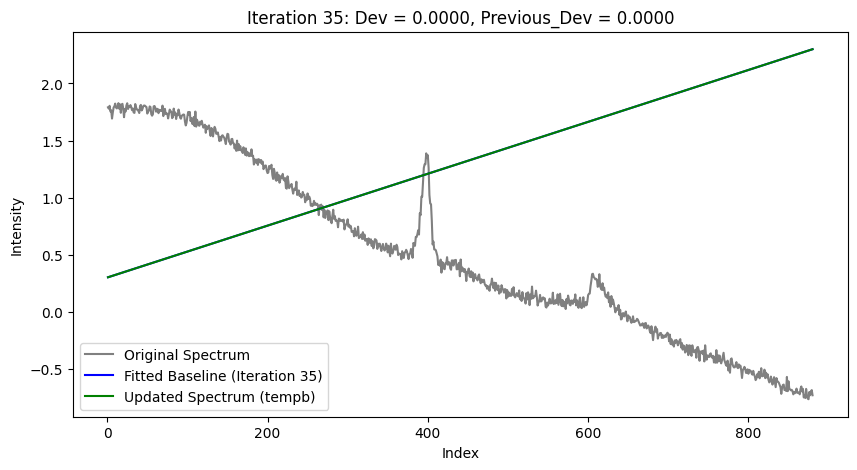

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


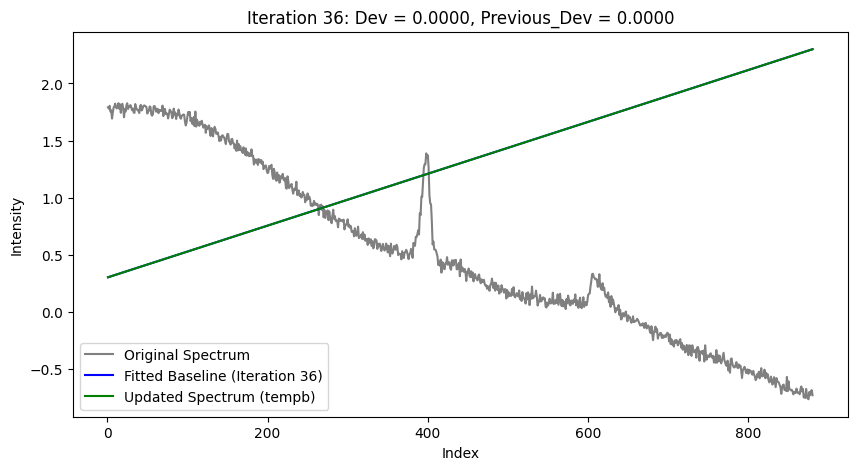

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


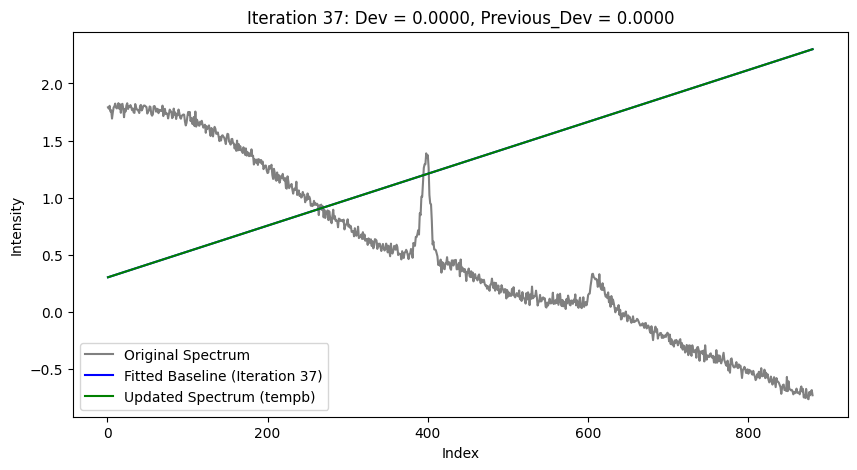

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


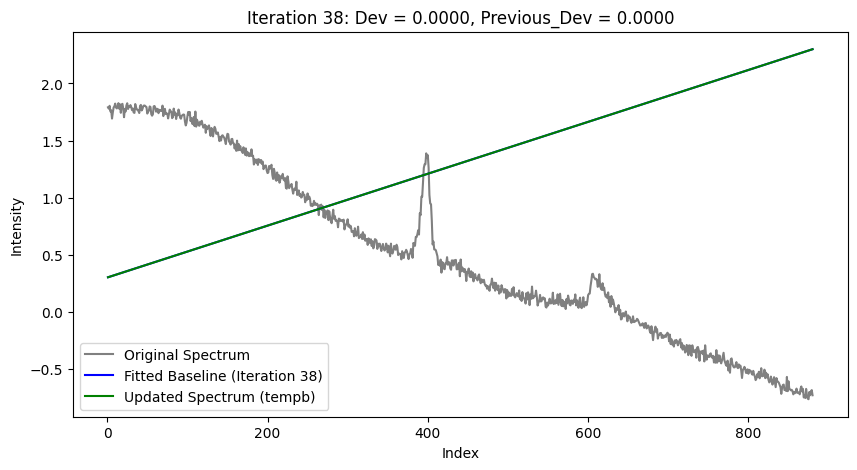

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


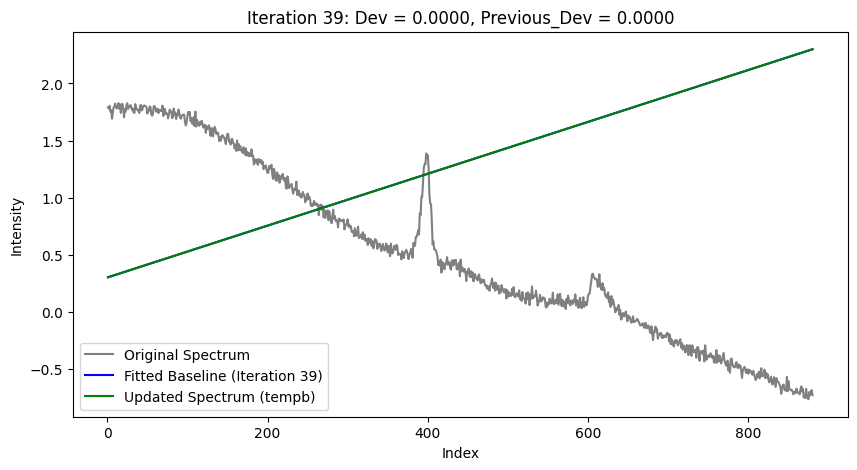

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


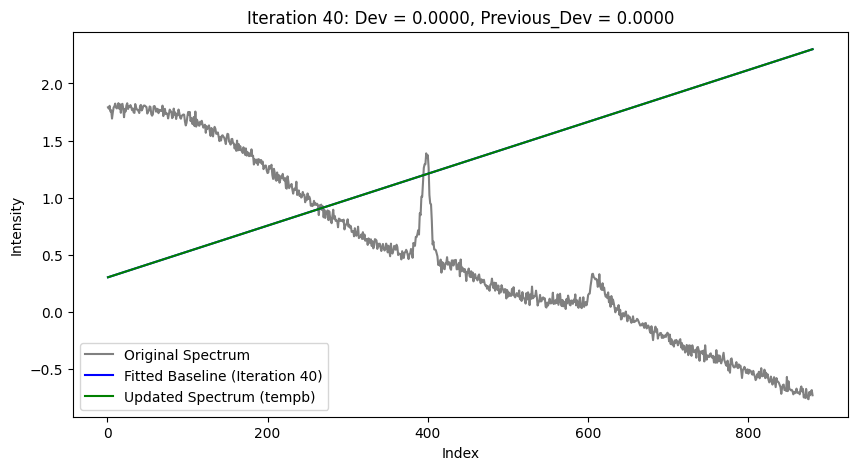

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


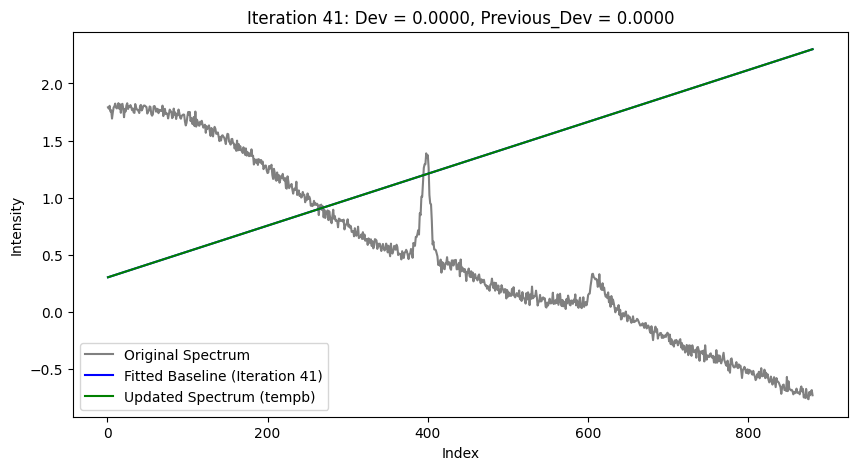

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


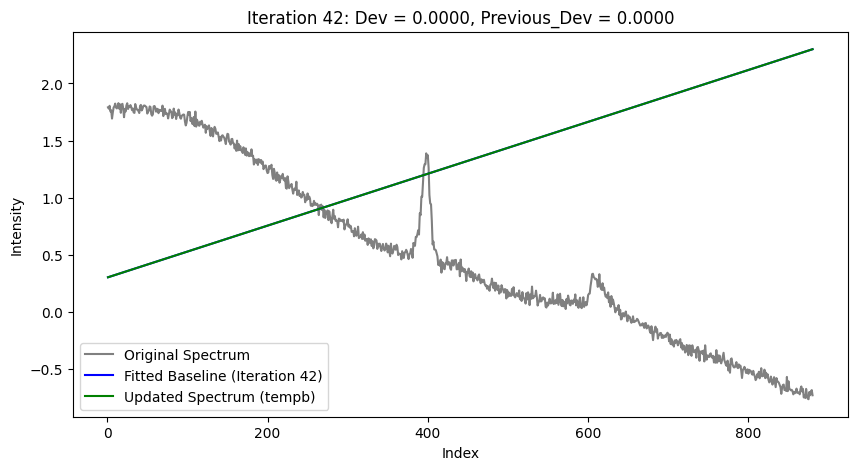

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


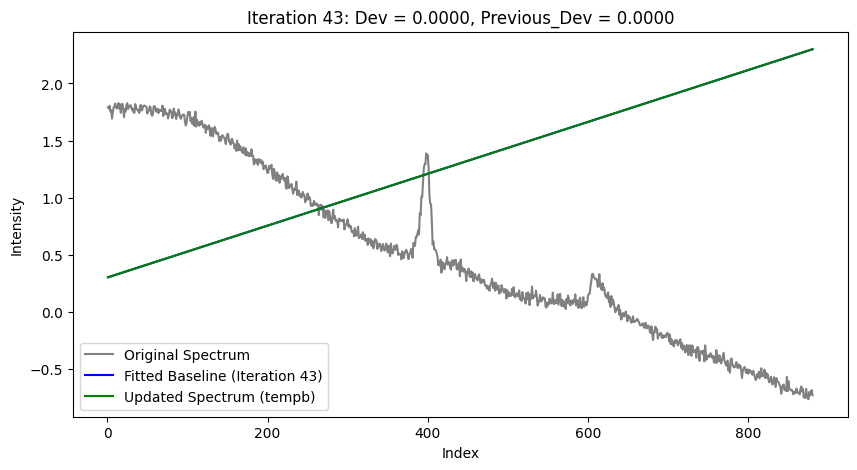

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


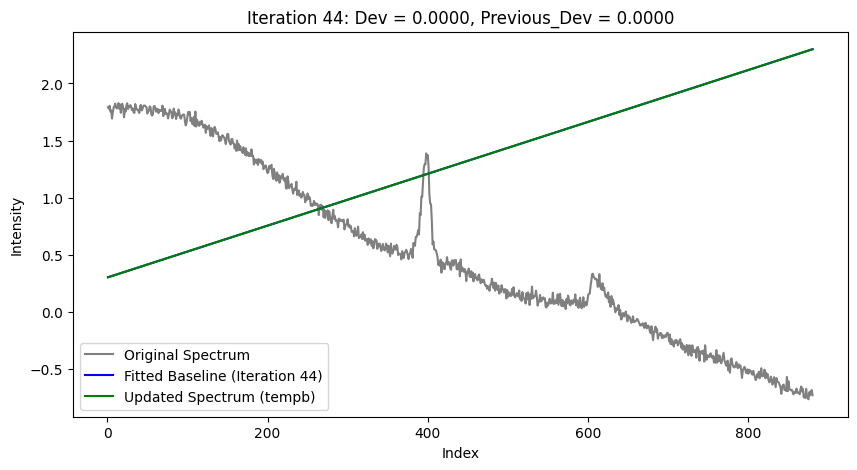

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


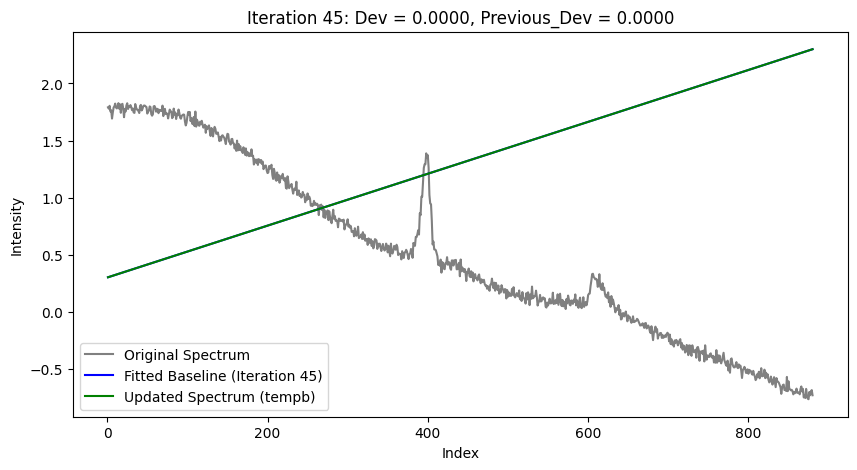

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


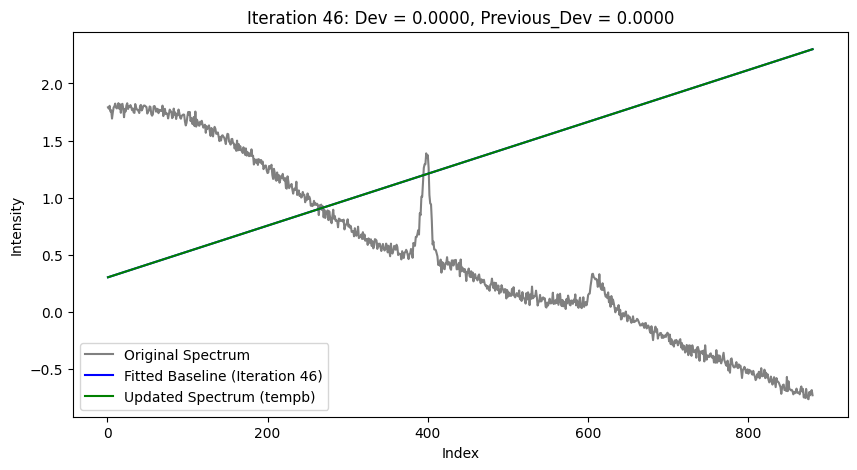

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


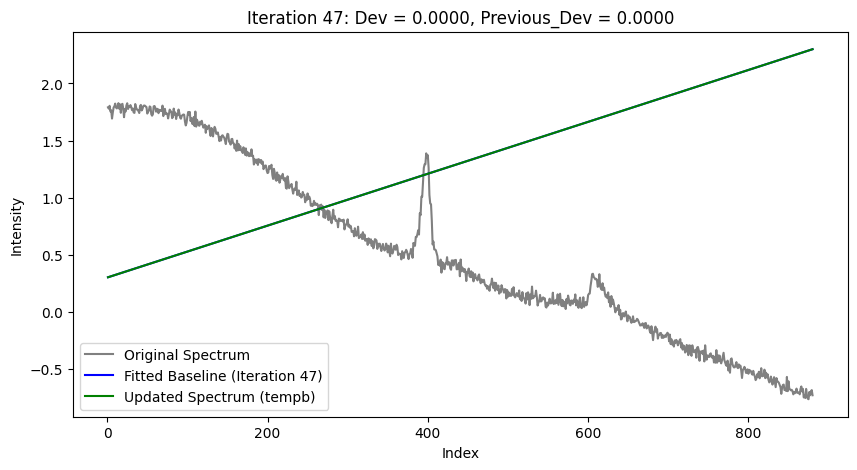

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


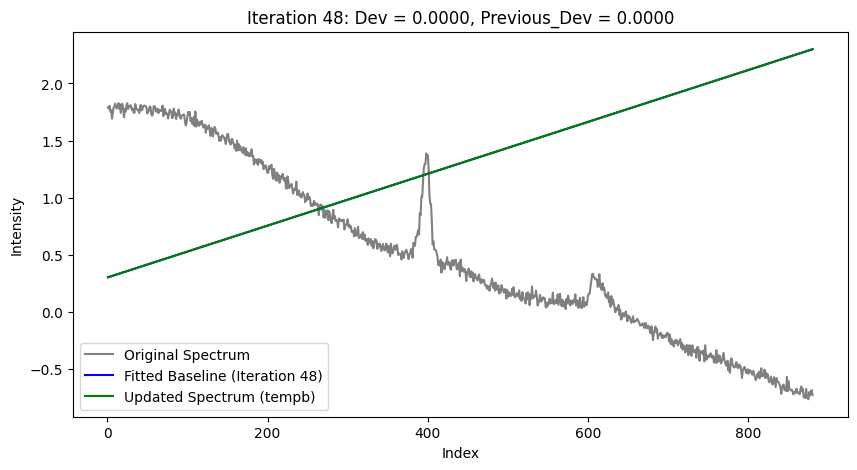

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


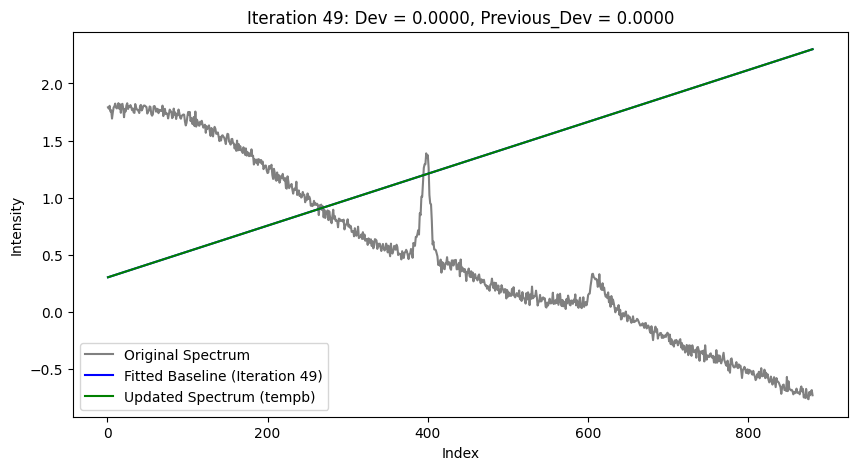

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


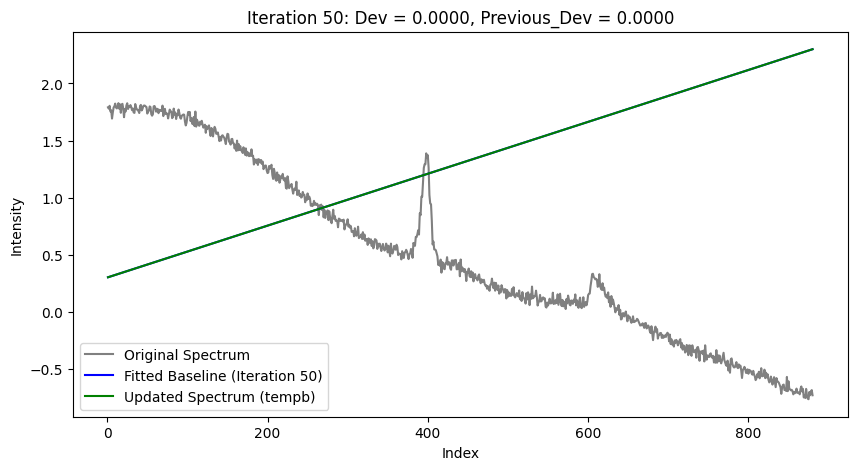

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


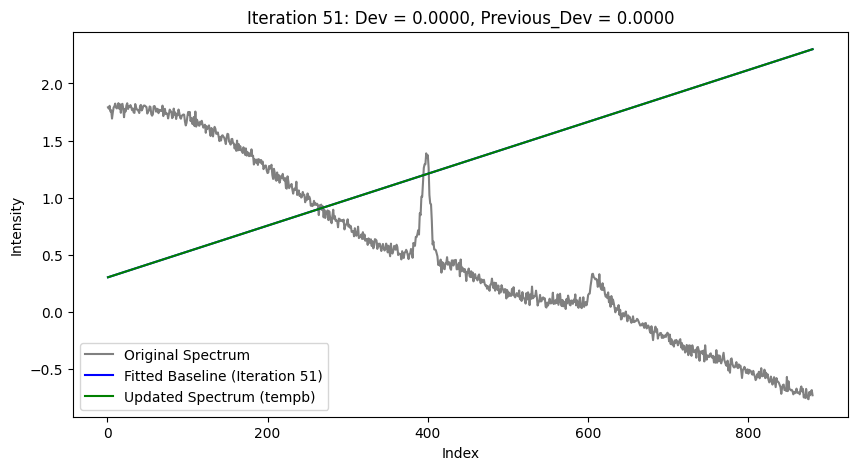

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


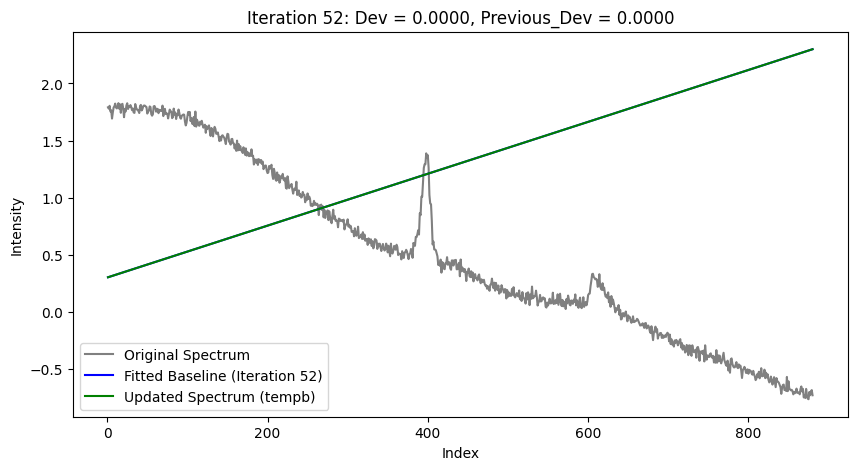

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


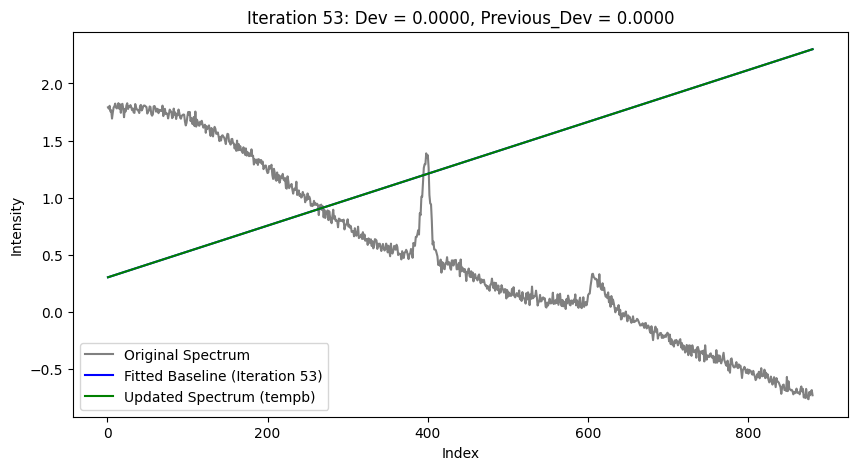

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


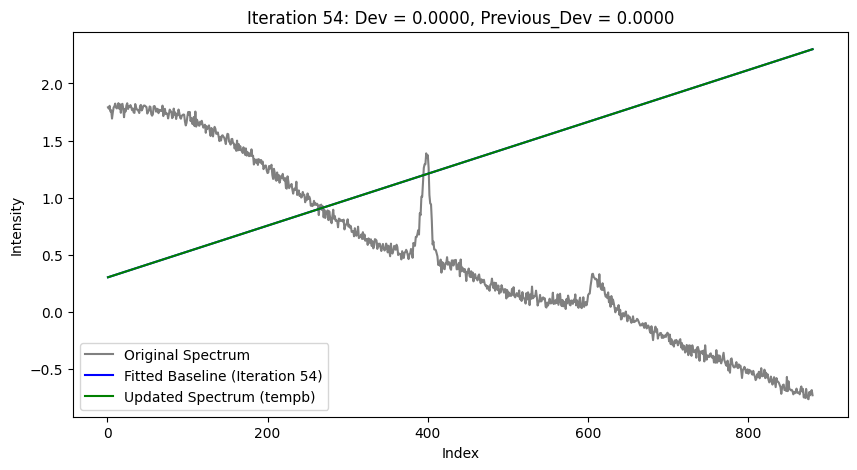

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


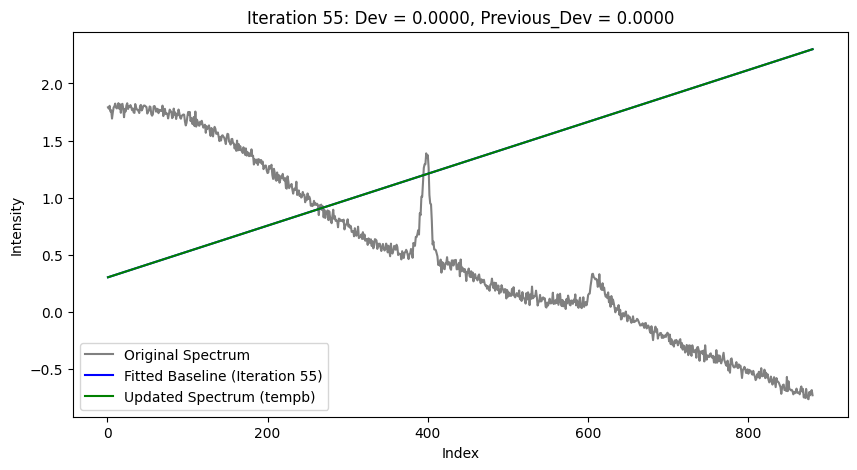

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


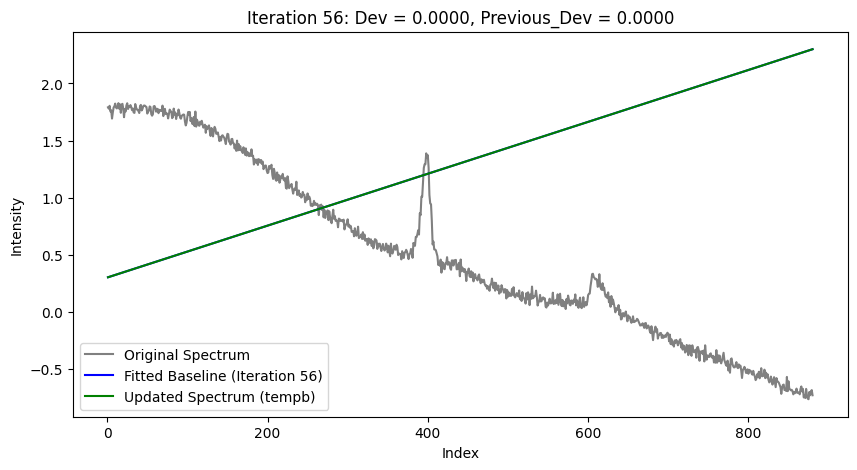

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


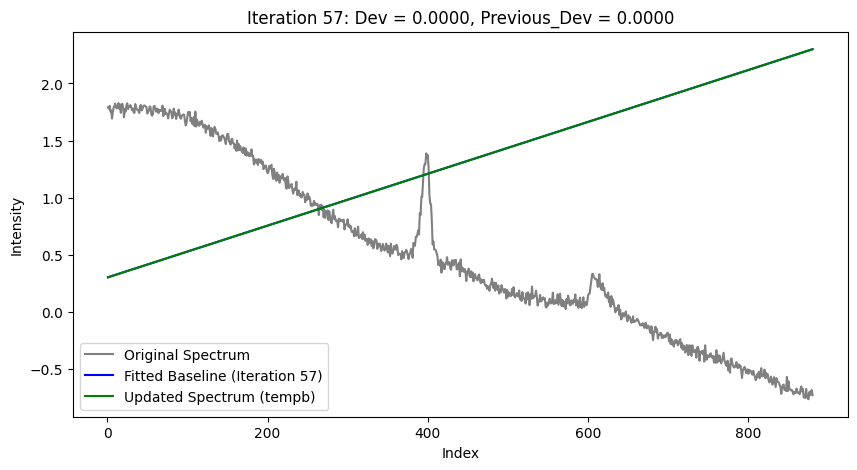

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


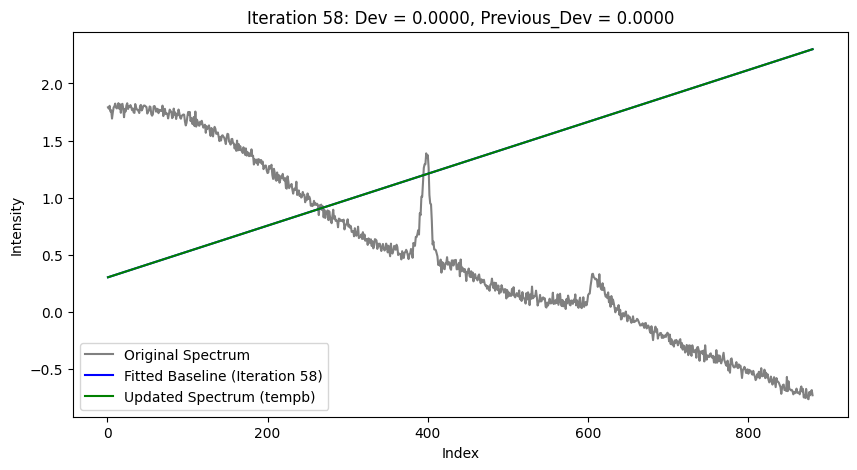

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


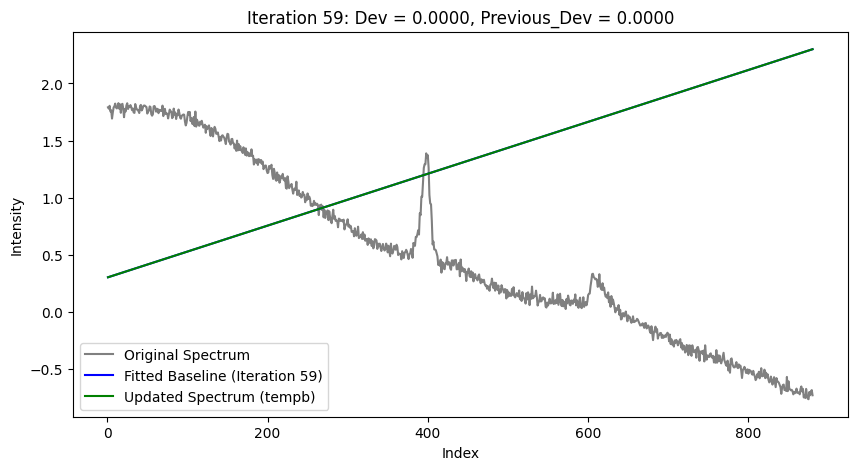

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


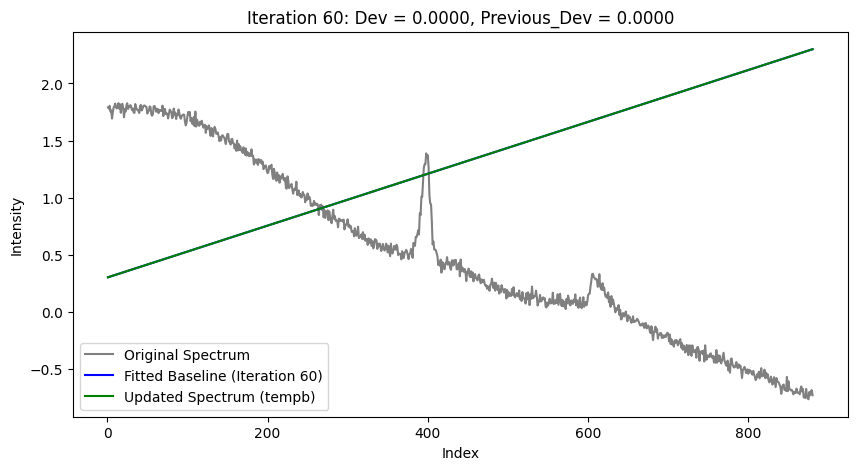

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


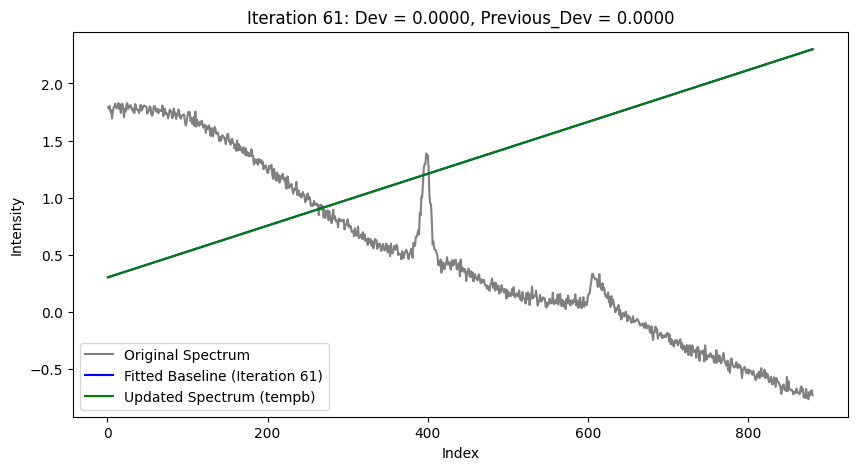

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


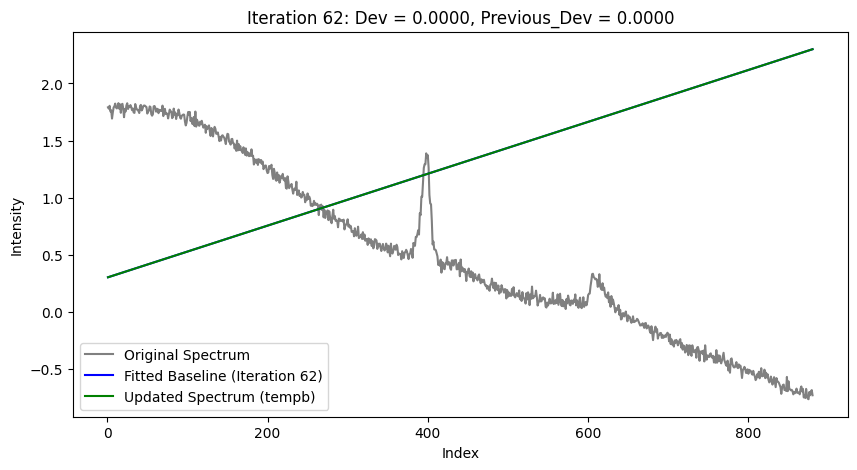

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


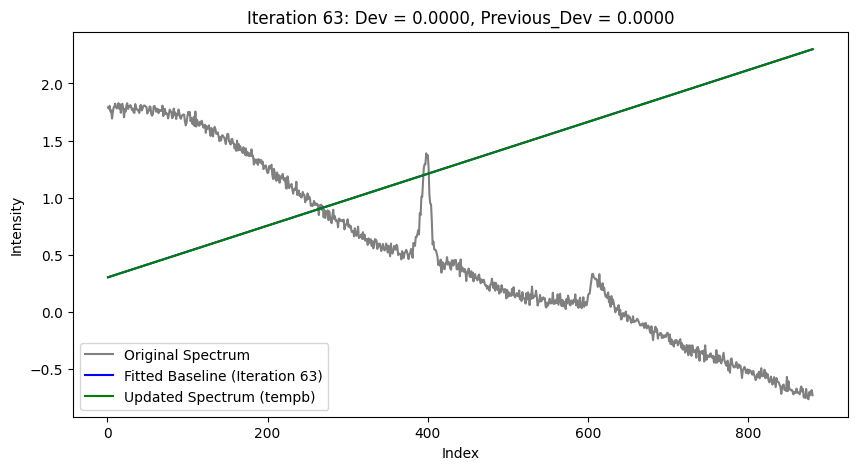

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


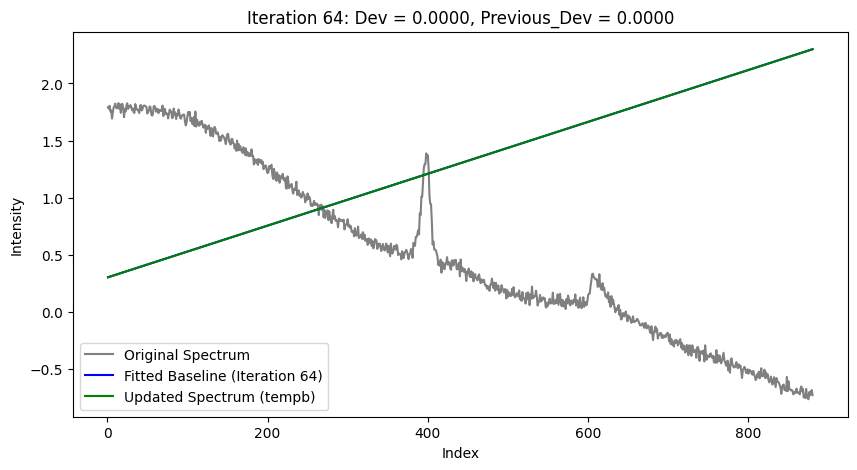

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


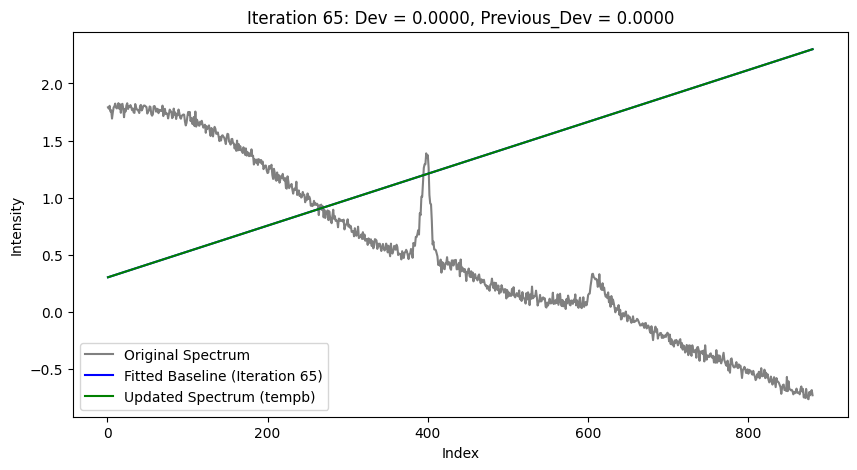

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


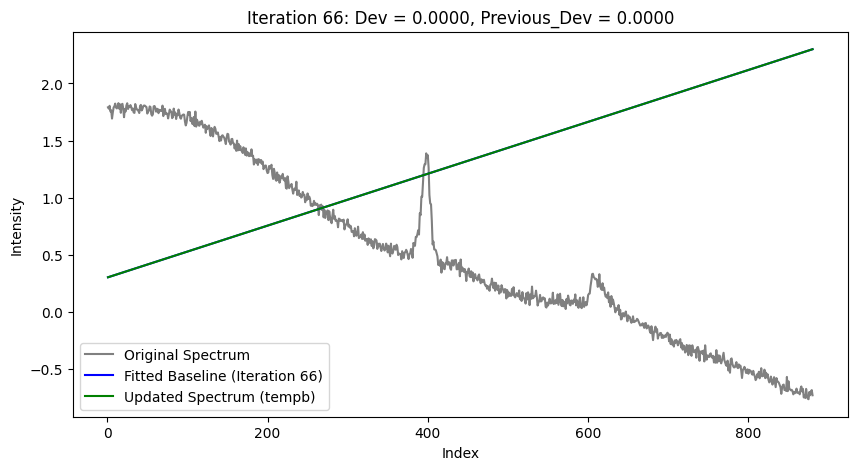

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


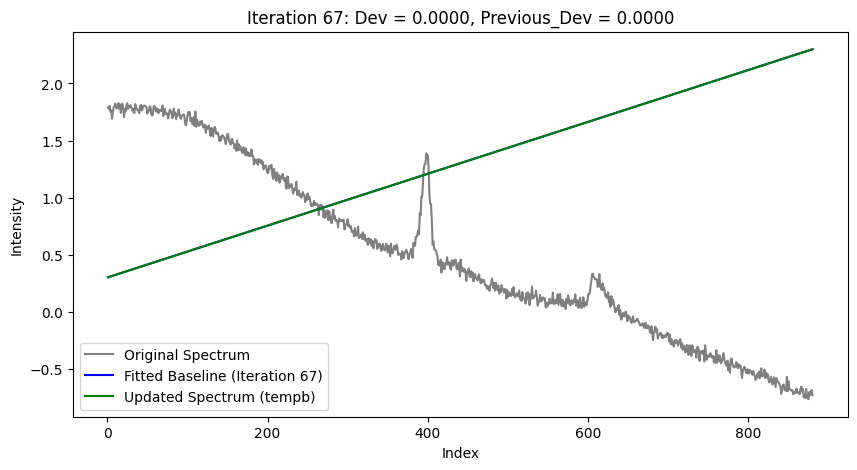

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


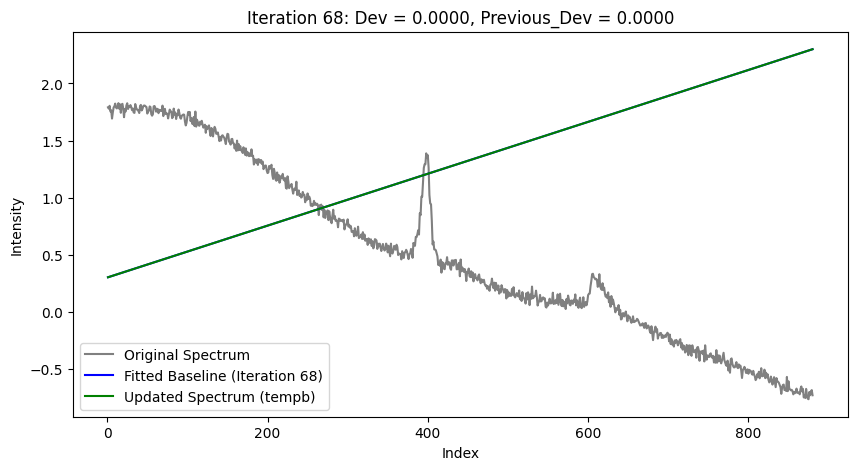

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


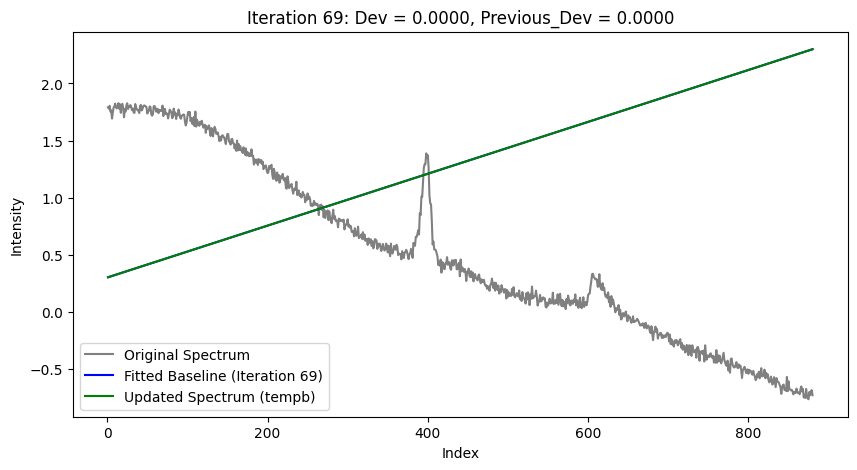

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


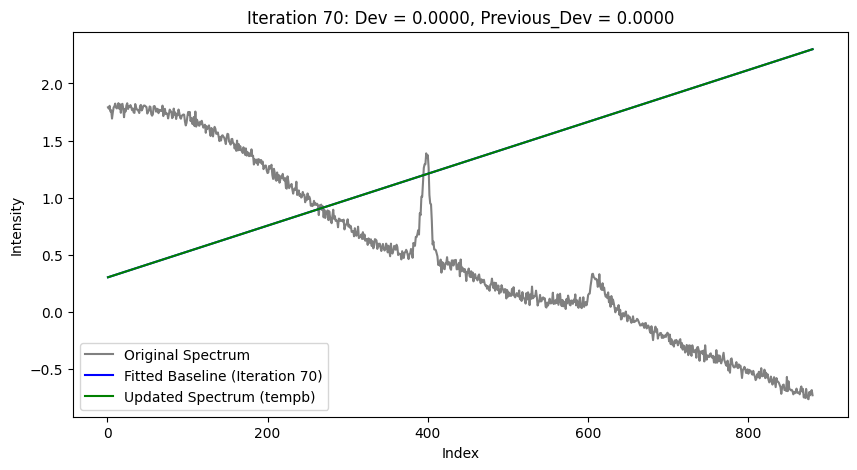

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


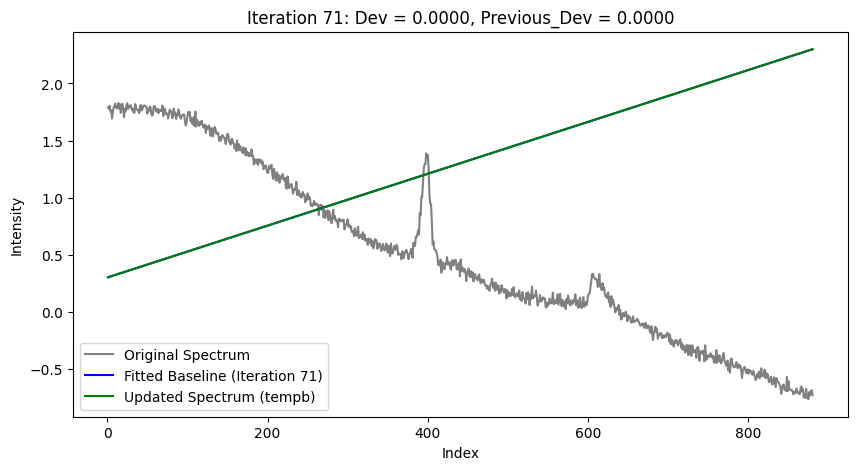

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


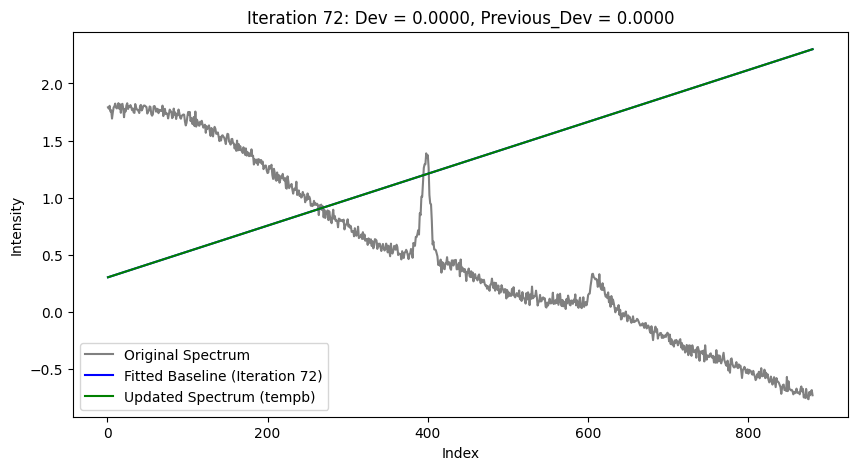

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


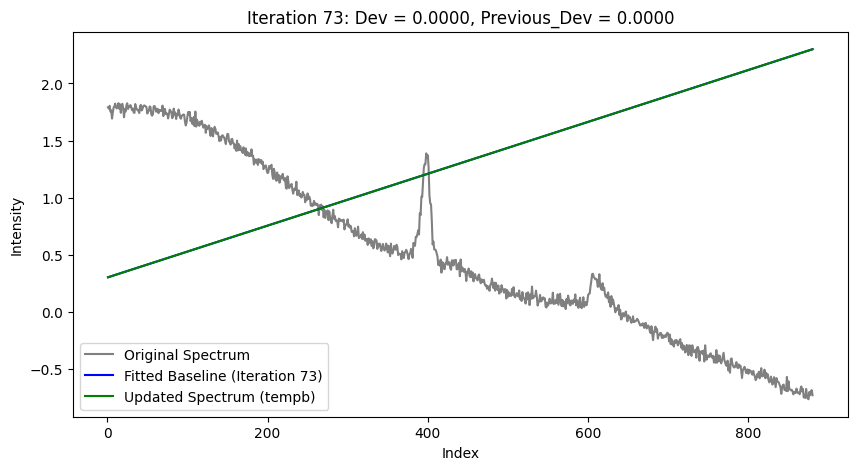

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


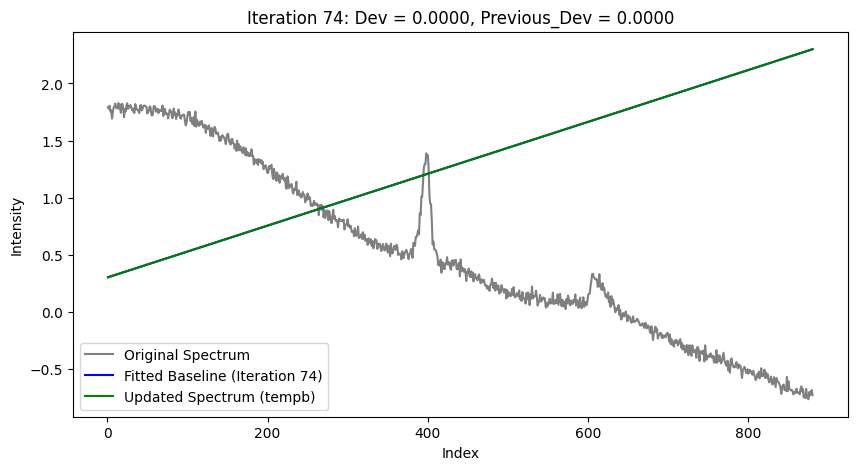

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


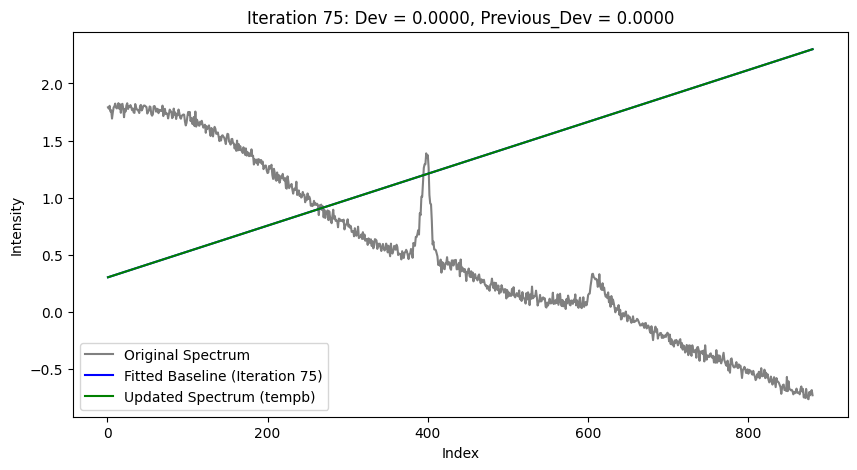

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


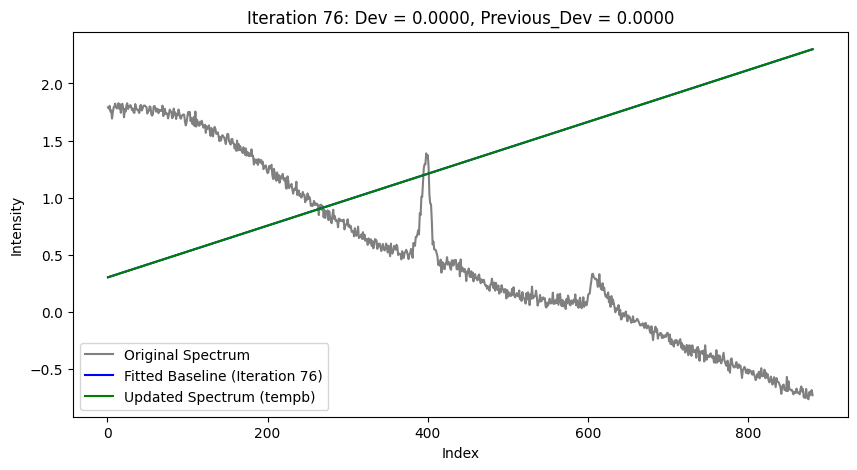

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


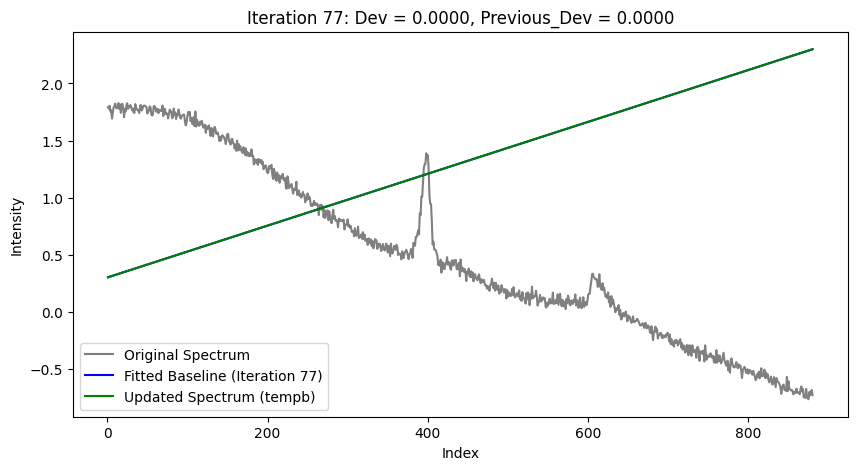

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


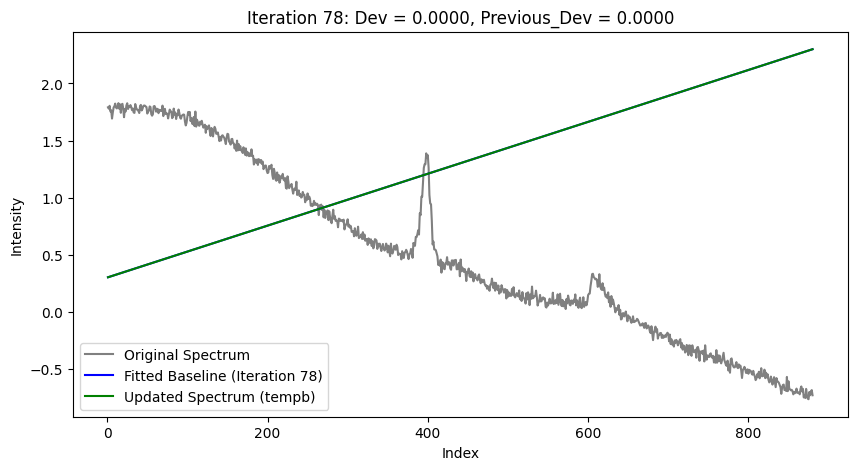

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


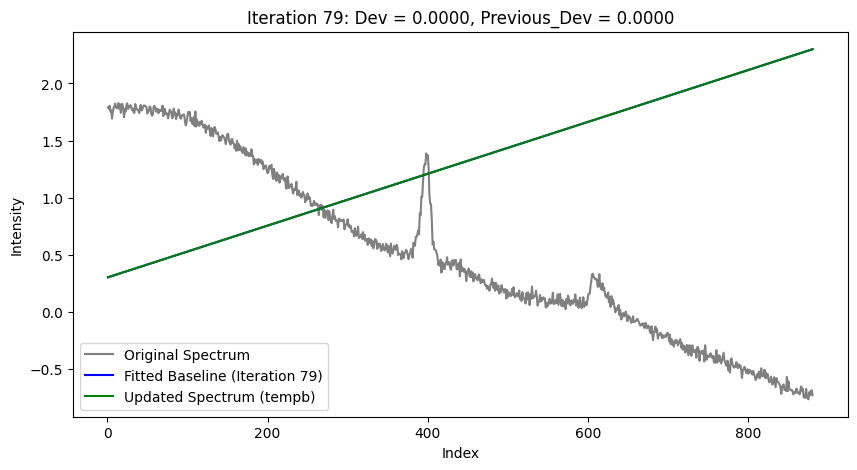

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


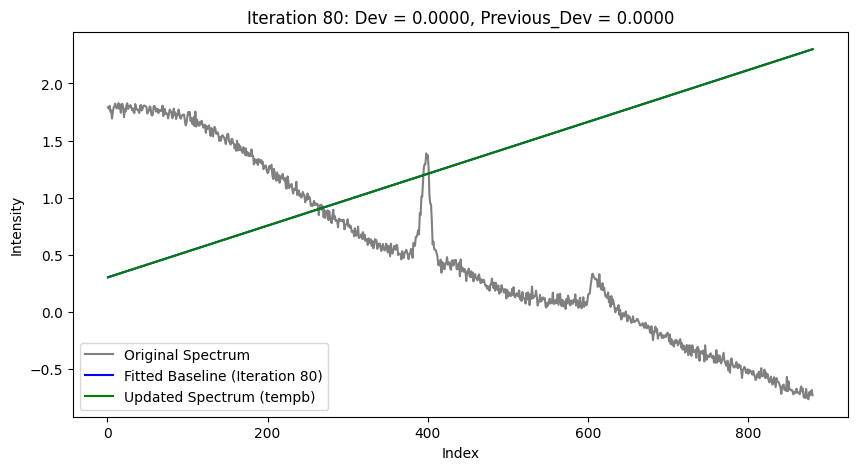

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


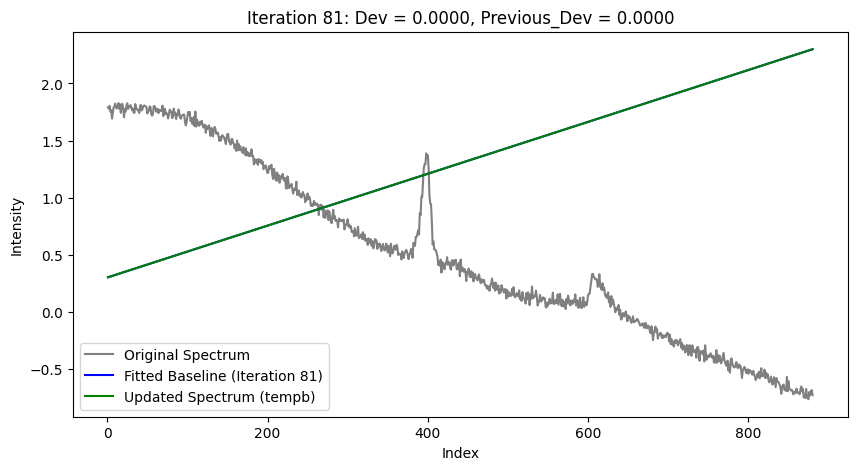

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


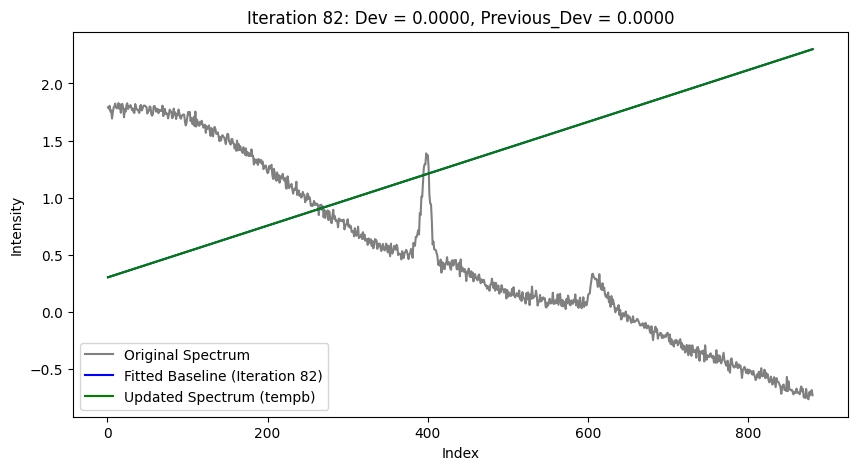

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


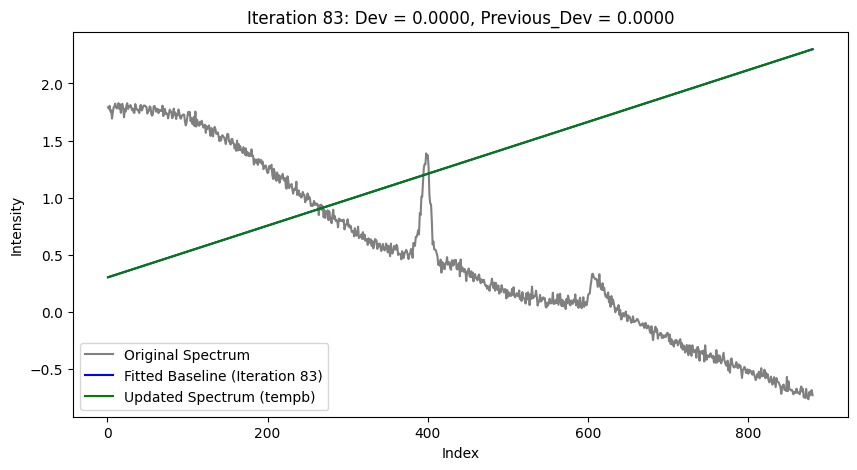

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


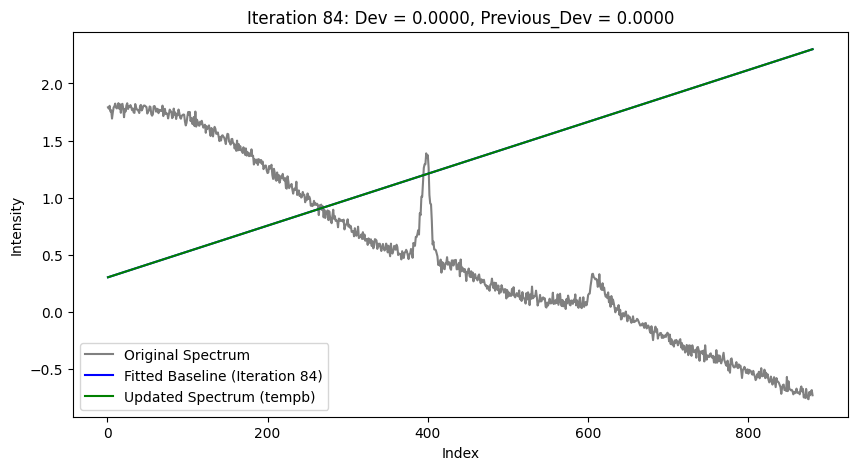

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


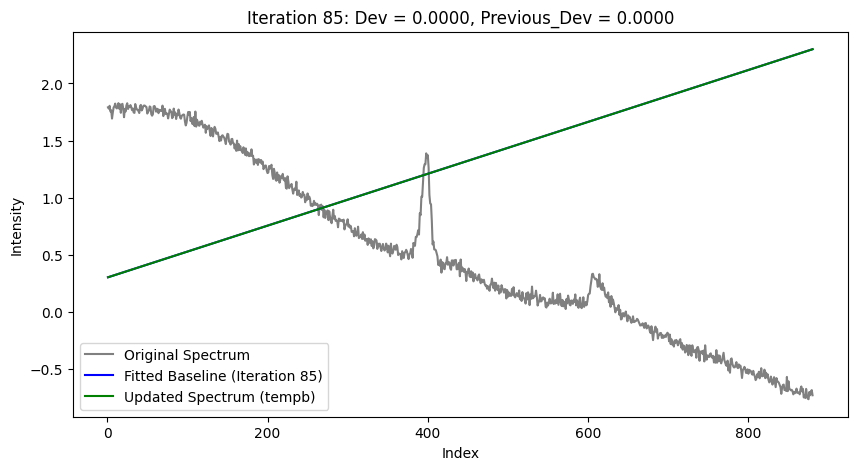

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


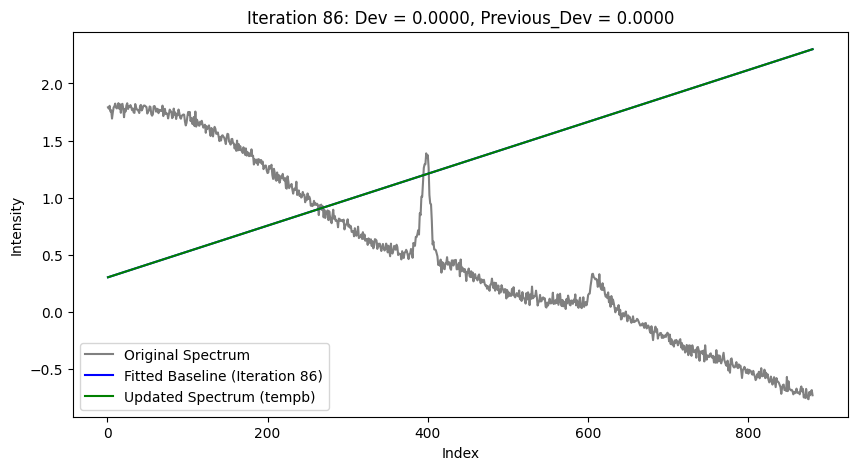

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


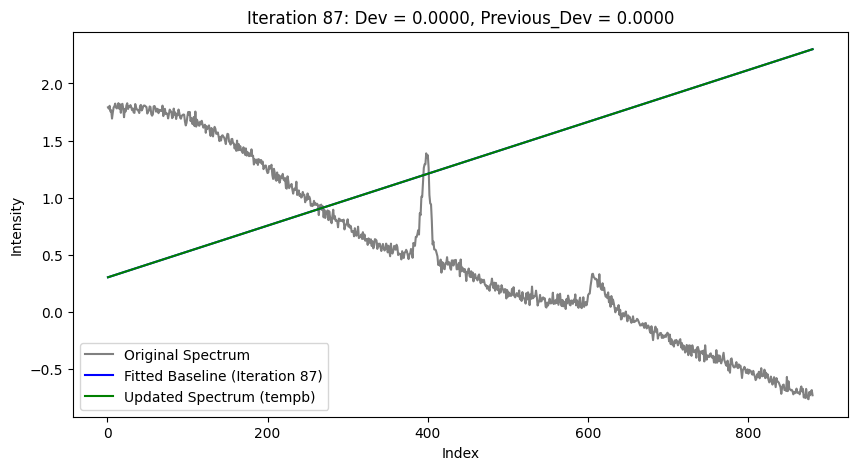

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


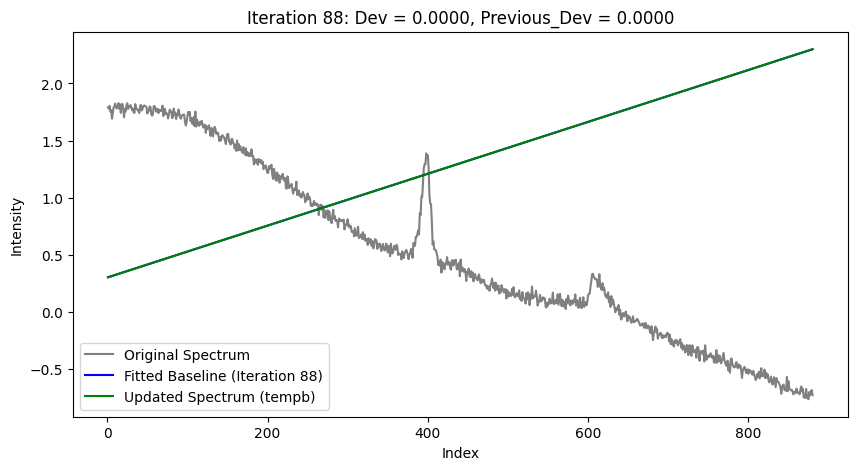

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


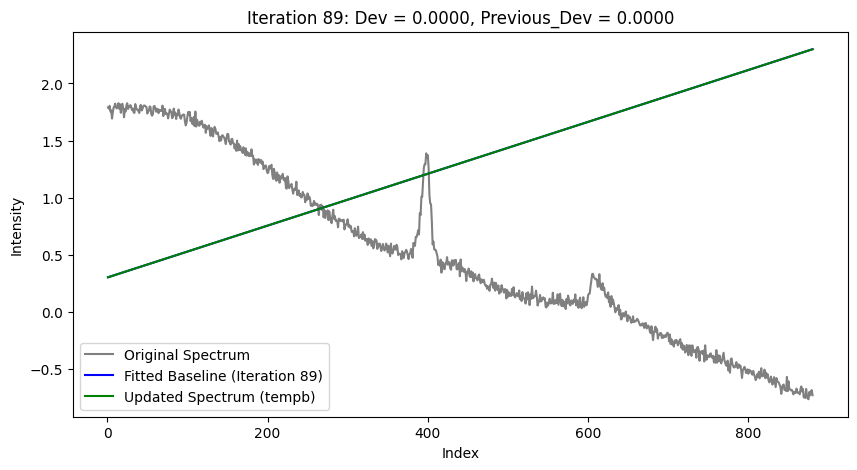

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


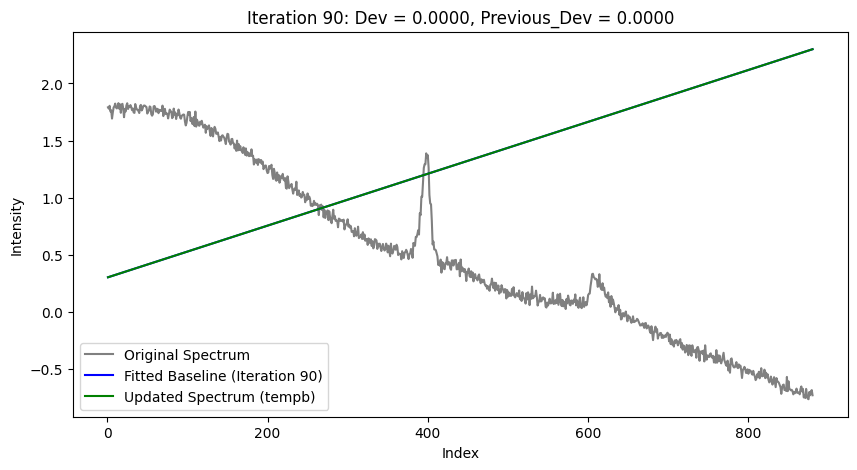

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


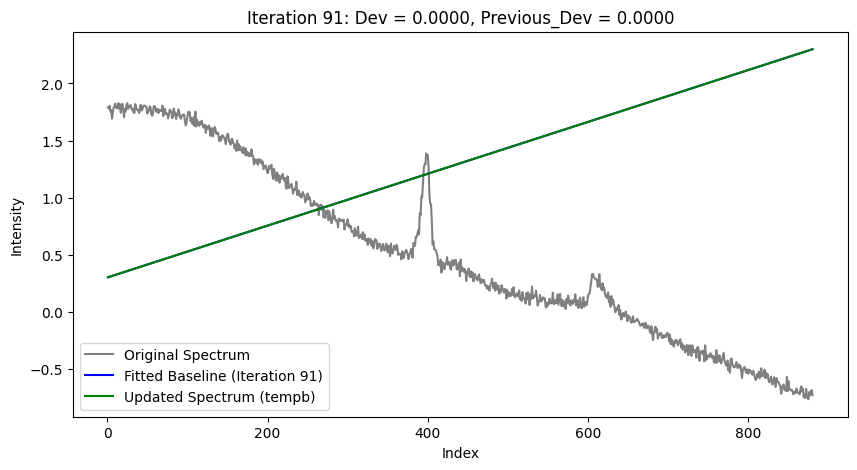

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


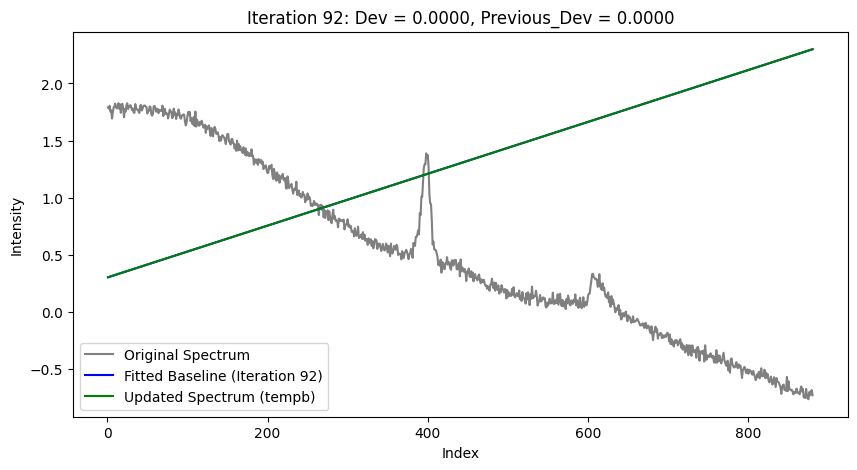

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


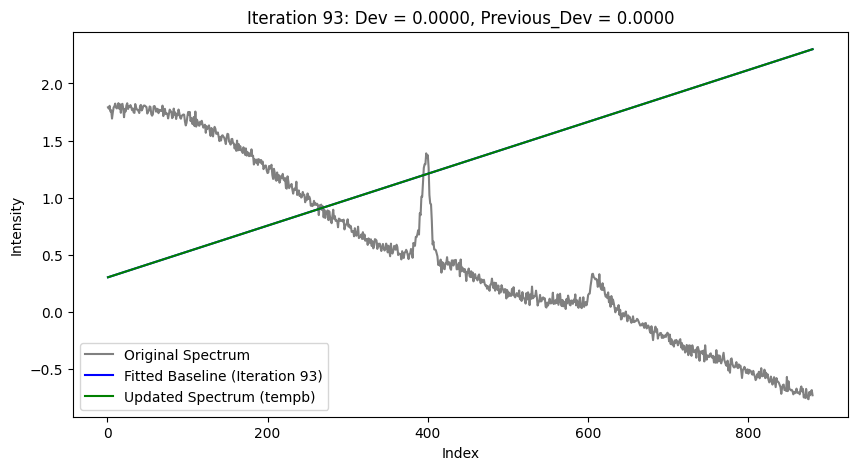

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


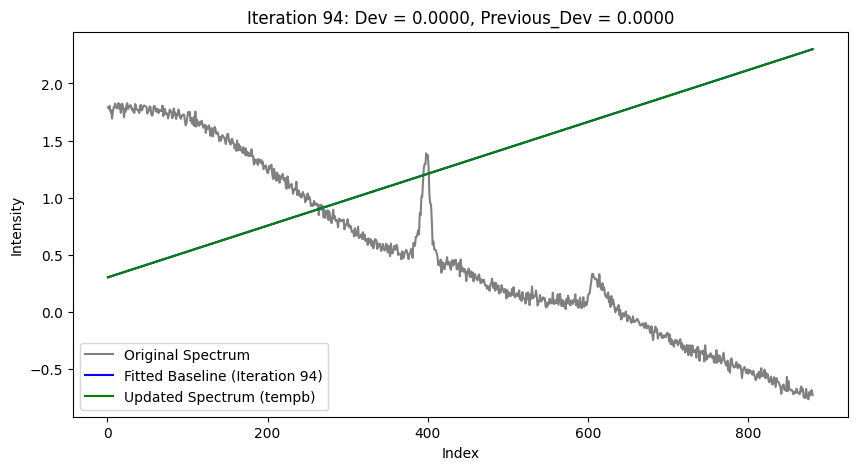

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


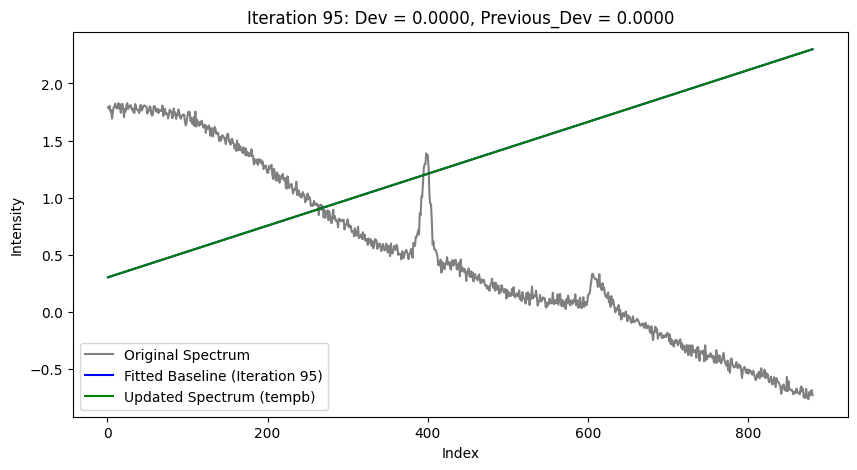

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


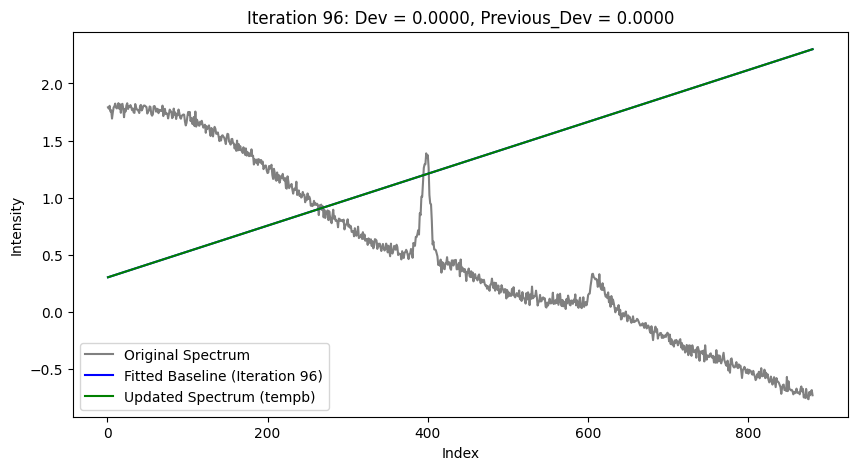

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


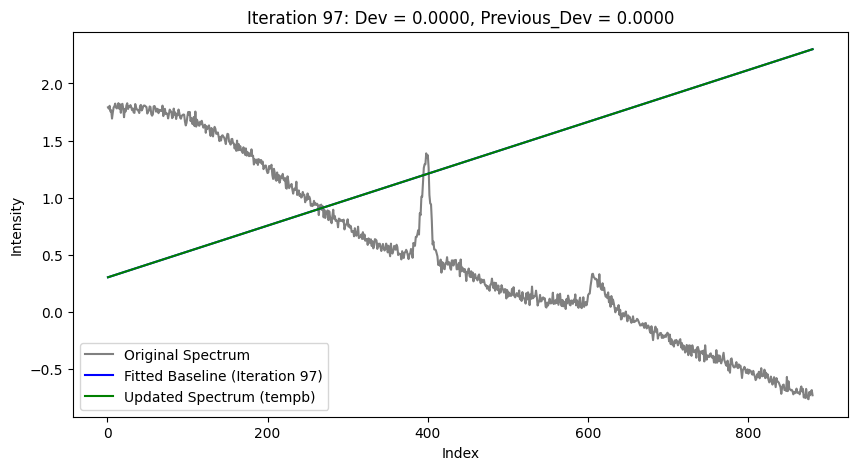

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


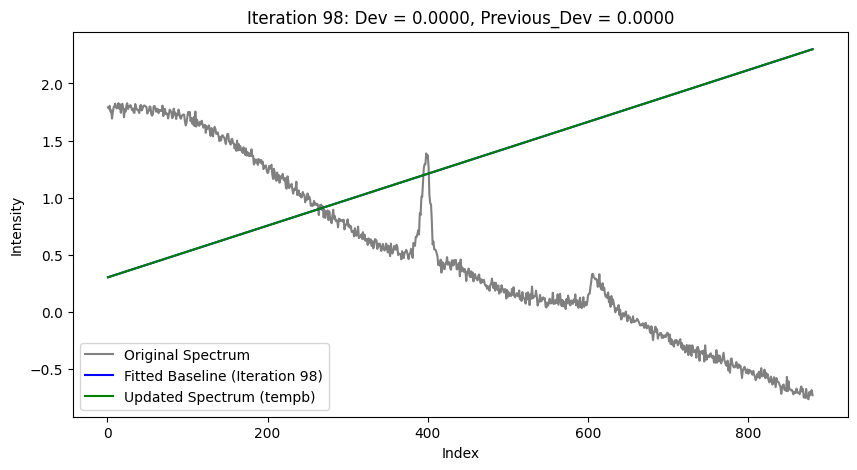

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


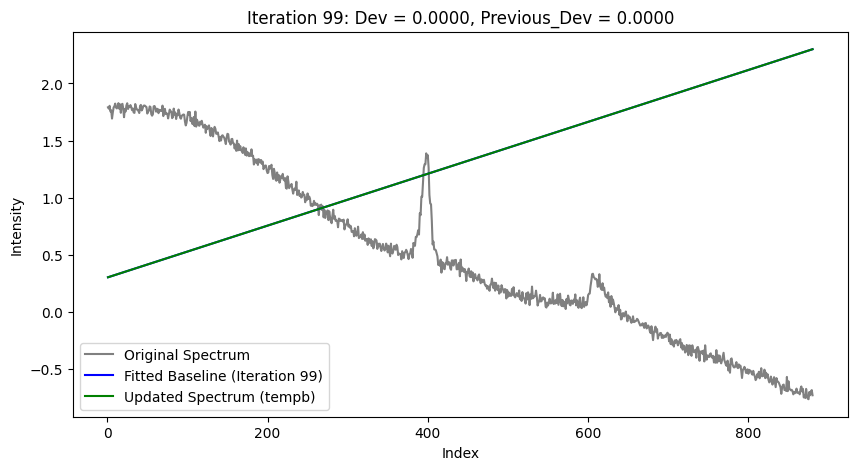

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


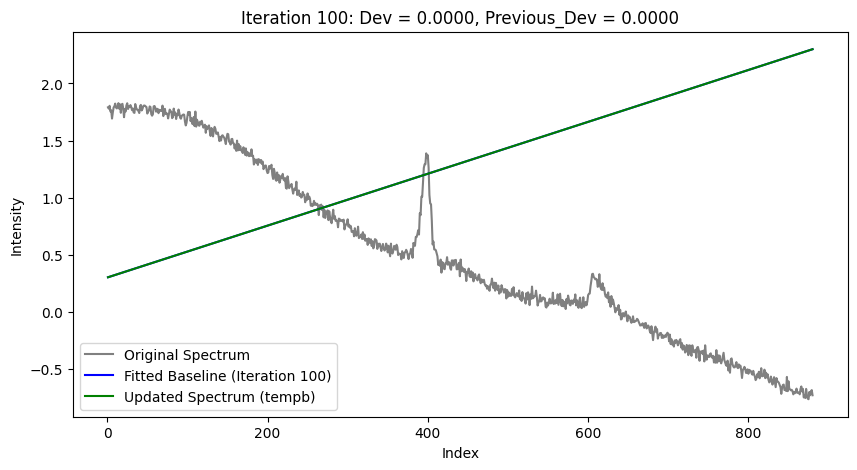

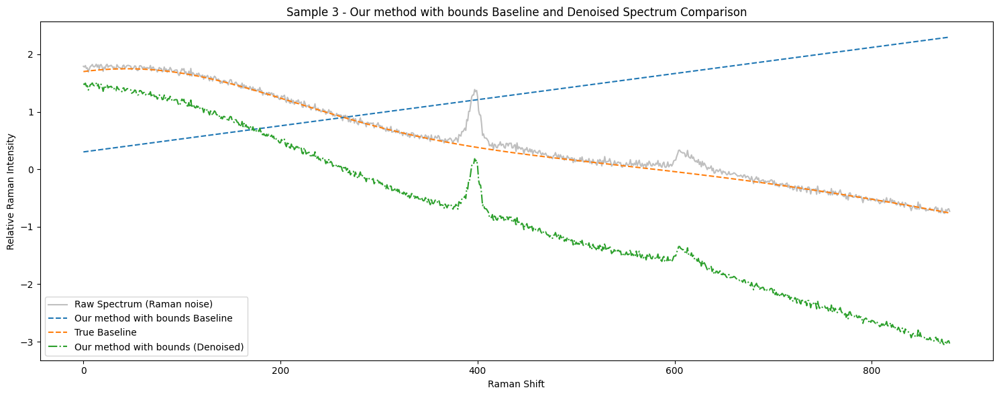

tf.Tensor([[0.0000000e+00 1.0000000e+00 2.1906309e-33]], shape=(1, 3), dtype=float32)


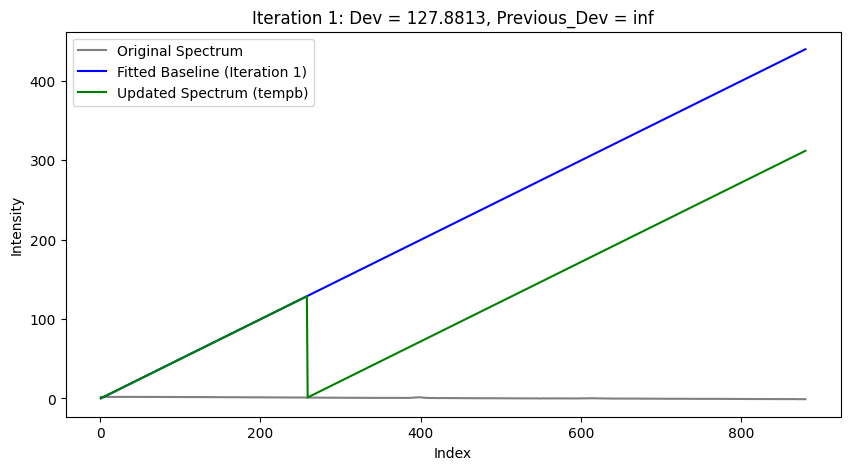

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


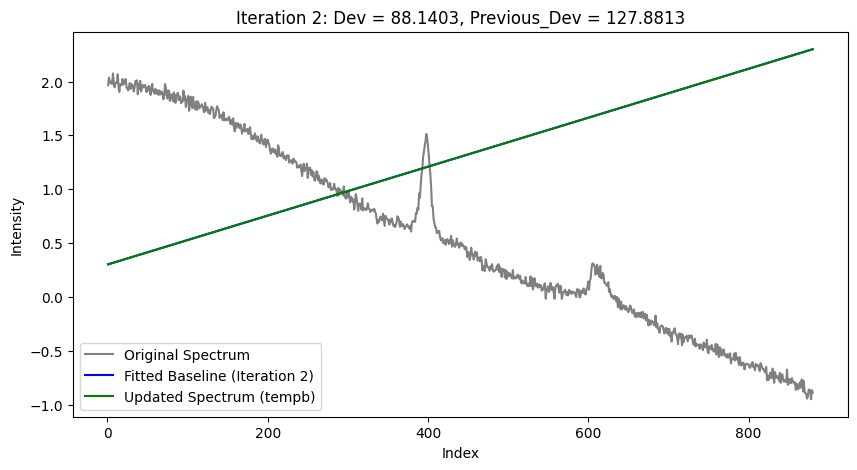

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


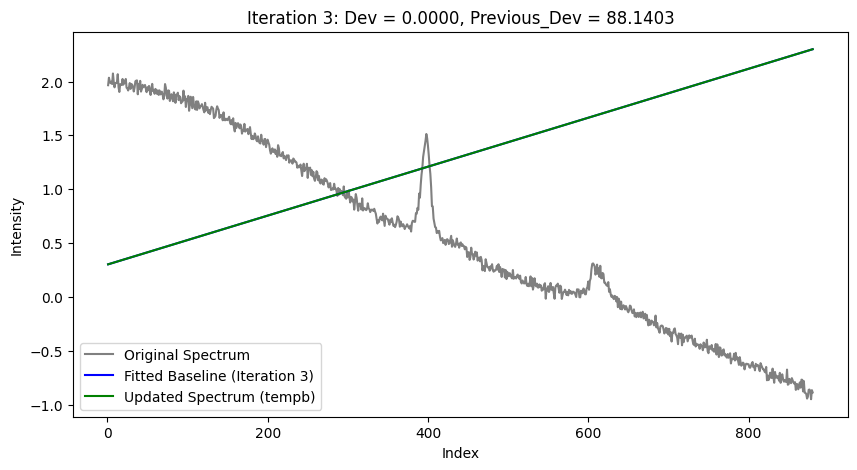

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


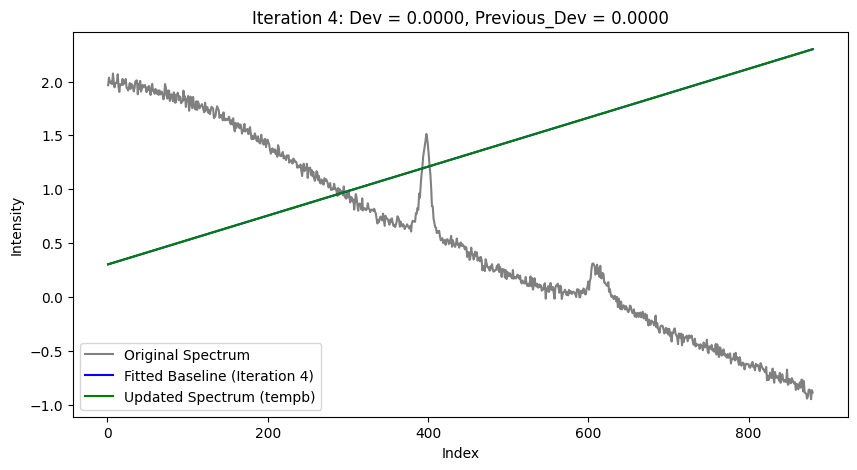

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


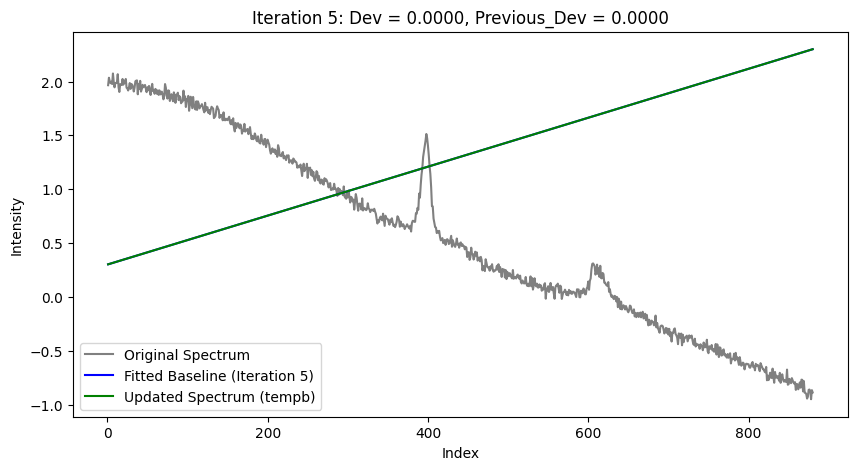

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


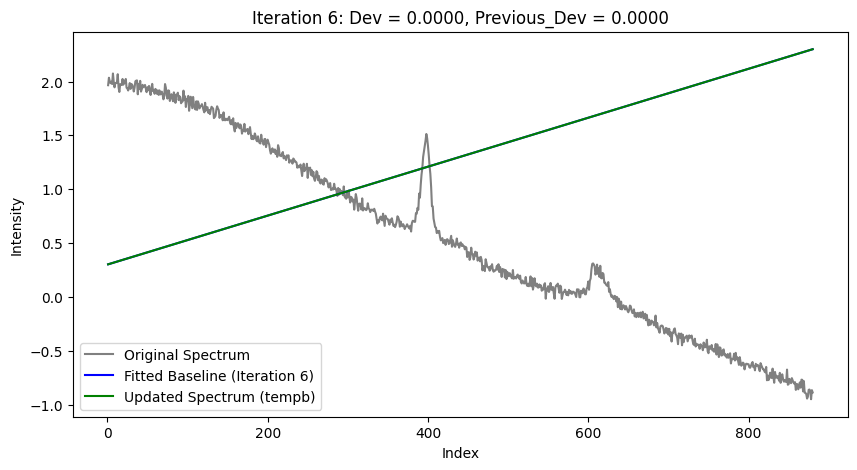

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


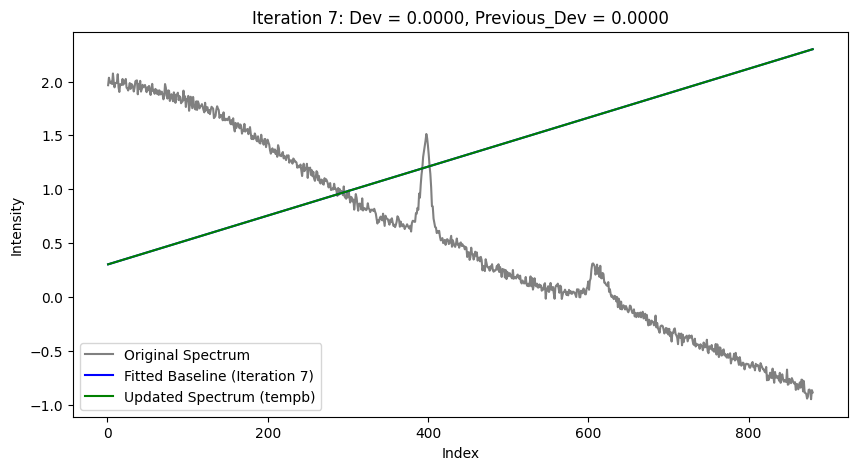

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


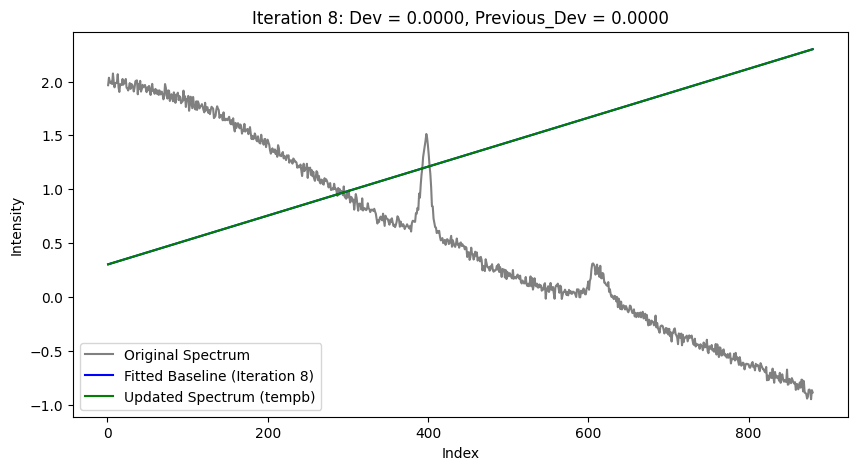

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


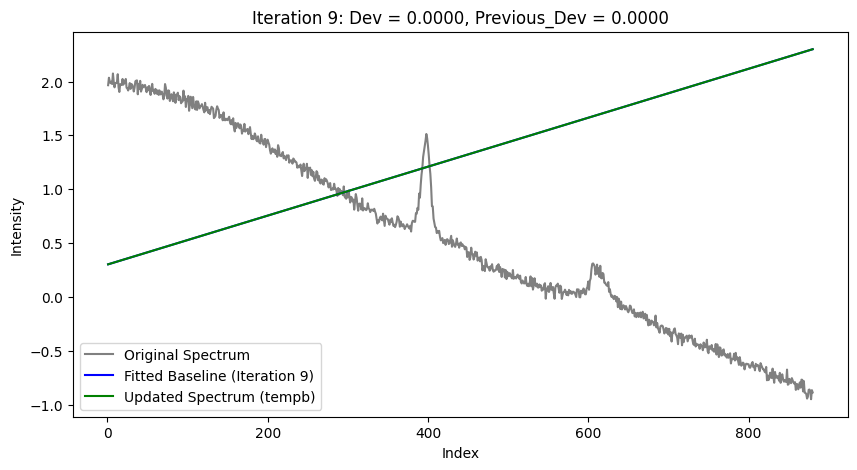

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


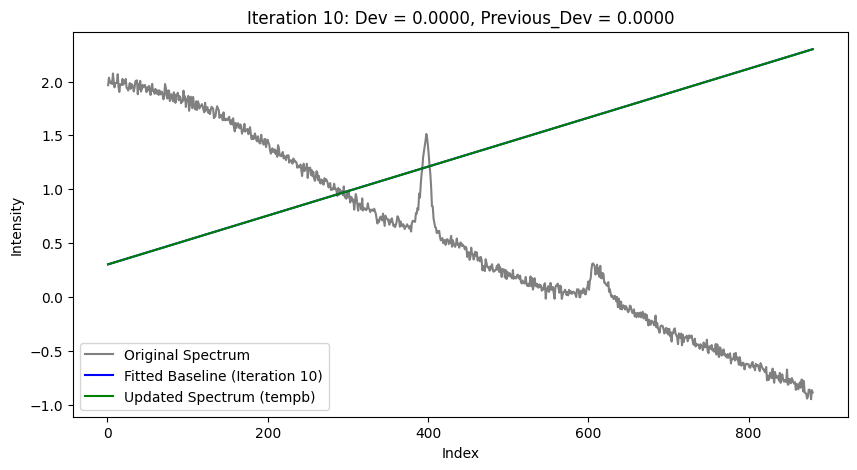

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


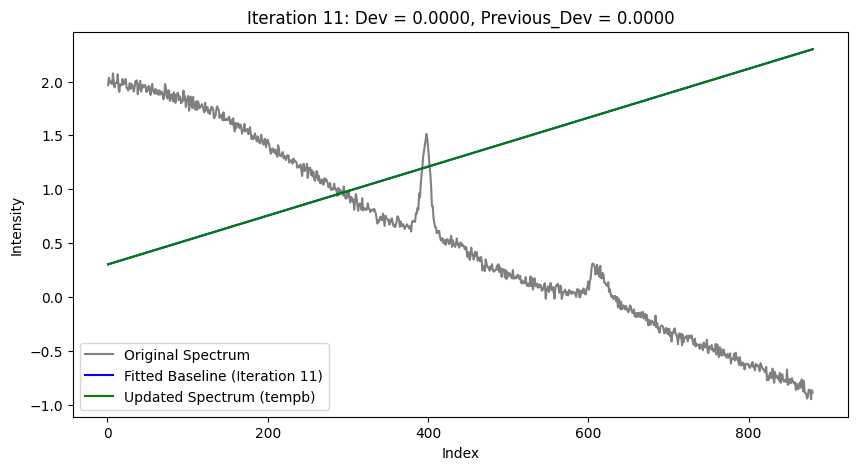

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


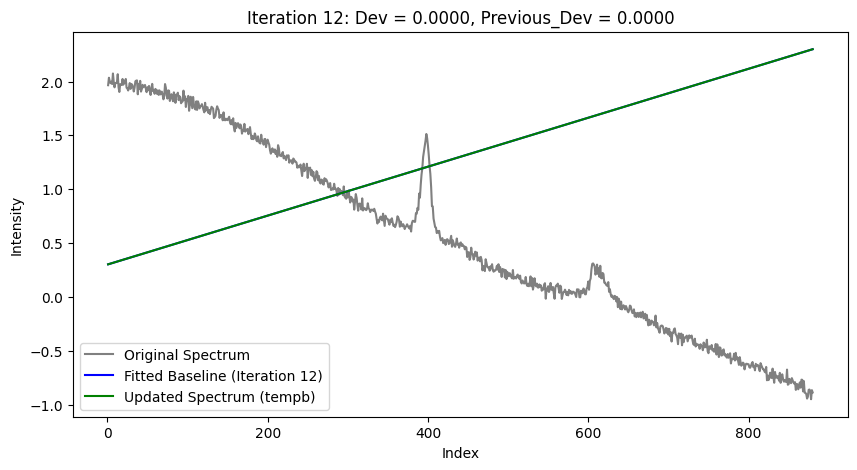

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


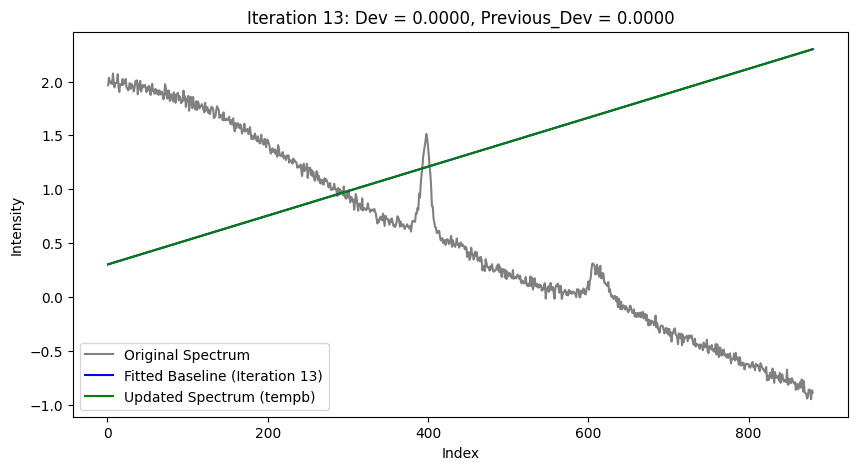

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


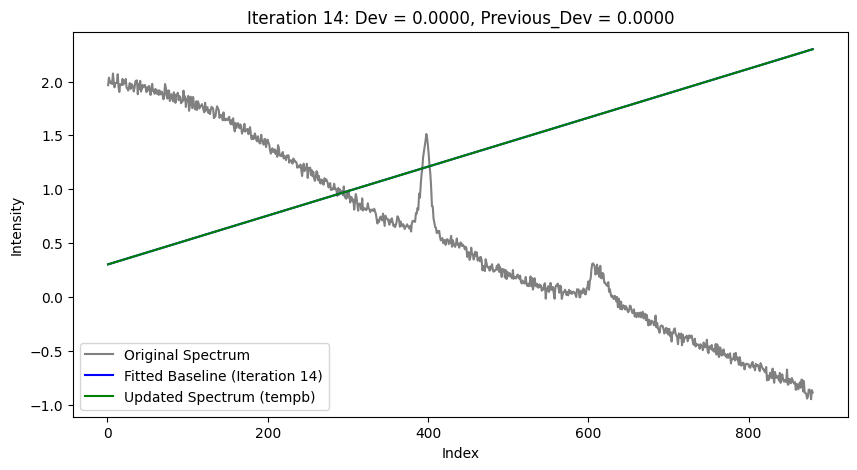

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


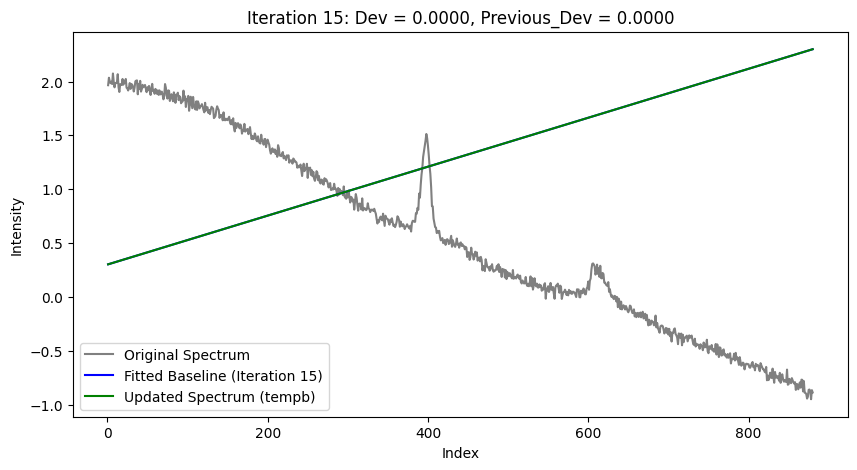

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


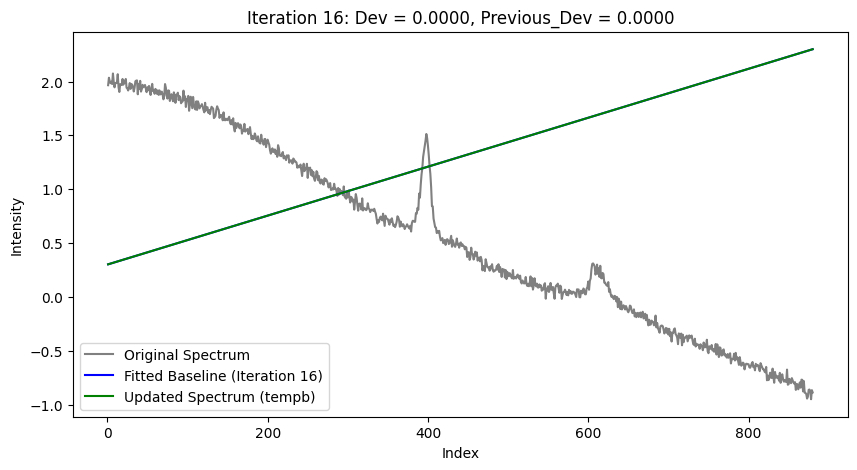

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


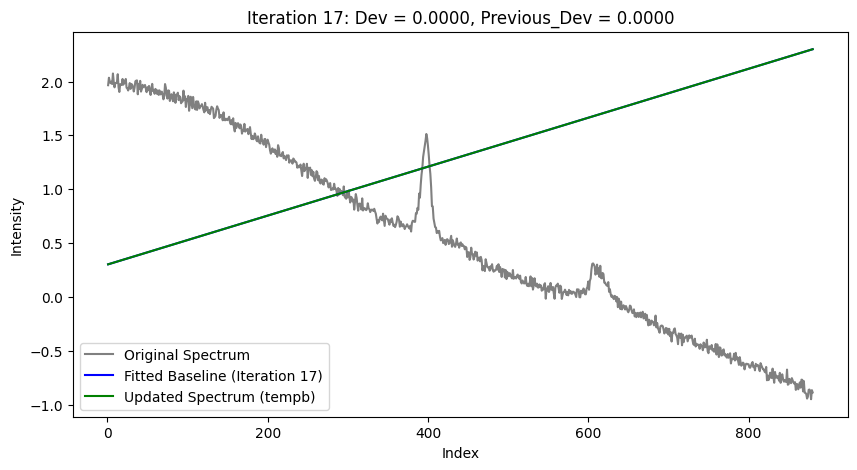

tf.Tensor([[1. 0. 0.]], shape=(1, 3), dtype=float32)


KeyboardInterrupt: 

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import os
import tensorflow as tf  # Assuming you need this for certain TensorFlow operations

# Ensure the plots directory exists
os.makedirs('./plots', exist_ok=True)

# RMSE Calculation
def calculate_rmse(signal, baseline):
    return np.sqrt(np.mean((signal - baseline) ** 2))

# New SNR Calculation
def calculate_snr(y_s, y_hat):
    numerator = np.sum(y_s)
    denominator = np.sum((y_s - y_hat) ** 2)
    snr = numerator / denominator
    return snr

# Loop through samples for RMSE and SNR calculations
for i in range(15):
    sample_data = x_train[i]  # Noisy original signal
    true_data = input2[i] / max(input2[i])  # Normalized true Raman signal
    
    # Calculate different baselines
    B = iterative_fitting_with_bounds(sample_data, 100)
    # B_1 = iterative_fitting_with_bounds_no(sample_data, 100)
    # base_lines2, _ = pybaselines.polynomial.imodpoly(data=sample_data, poly_order=6, max_iter=500)
    # B3 = airPLS(sample_data)
    
    # Real baseline
    baseline = baseline_train[i]
    
    # # RMSE Calculation
    # rmse_B = calculate_rmse(B, baseline)
    # rmse_B_1 = calculate_rmse(B_1, baseline)
    # rmse_base_lines2 = calculate_rmse(base_lines2, baseline)
    # rmse_B3 = calculate_rmse(B3, baseline)
    # 
    # # SNR Calculation for each baseline removal method
    # snr_after_baseline_B = calculate_snr(true_data, sample_data - B)
    # snr_after_baseline_B_1 = calculate_snr(true_data, sample_data - B_1)
    # snr_after_baseline_base_lines2 = calculate_snr(true_data, sample_data - base_lines2)
    # snr_after_baseline_B3 = calculate_snr(true_data, sample_data - B3)
    # 
    # # Print RMSE and SNR values
    # print(f"Sample {i+1}:")
    # print(f"RMSE - Our method with bounds: {rmse_B:.4f}, Based method with bounds: {rmse_B_1:.4f}, Imodpoly: {rmse_base_lines2:.4f}, airPLS: {rmse_B3:.4f}")
    # print(f"SNR after Baseline Removal - Our method with bounds: {snr_after_baseline_B:.4f}, Based method with bounds: {snr_after_baseline_B_1:.4f}, Imodpoly: {snr_after_baseline_base_lines2:.4f}, airPLS: {snr_after_baseline_B3:.4f}\n")
    # 
    # Danh sách các baseline và nhãn
    baselines = {
        # "airPLS": B3,
        "Our method with bounds": B,
        # "Based method with bounds": B_1,
        # "Imodpoly": base_lines2
    }

    # Tạo một biểu đồ duy nhất để hiển thị phổ gốc, baseline dự đoán, và phổ sau khi trừ baseline
    for name, baseline_data in baselines.items():
        plt.figure(figsize=(15, 6))
        
        # 1. Plot phổ gốc (raw spectrum)
        plt.plot(sample_data, label="Raw Spectrum (Raman noise)", color="gray", alpha=0.5)
        
        # 2. Plot baseline dự đoán
        plt.plot(baseline_data, label=f"{name} Baseline", linestyle="--")
        plt.plot(baseline, label="True Baseline", linestyle="--")
    
        
        # 3. Plot phổ sau khi trừ baseline (denoised spectrum)
        denoised_spectrum = sample_data - baseline_data
        plt.plot(denoised_spectrum, label=f"{name} (Denoised)", linestyle="-.")
    
        # Thiết lập nhãn và tiêu đề
        plt.xlabel("Raman Shift")
        plt.ylabel("Relative Raman Intensity")
        plt.legend()
        plt.title(f"Sample {i+1} - {name} Baseline and Denoised Spectrum Comparison")
        plt.tight_layout()  # Sắp xếp bố cục gọn gàng trước khi lưu
    
        # Lưu hình ảnh
        # plt.savefig(f"./plots/sample_{i+1}_{name.replace(' ', '_').lower()}_comparison_full.png")
        plt.show()
        plt.close()  # Đóng plot để giải phóng bộ nhớ
    


tf.Tensor([[1.0000000e+00 2.9777598e-30 3.8261835e-18]], shape=(1, 3), dtype=float32)


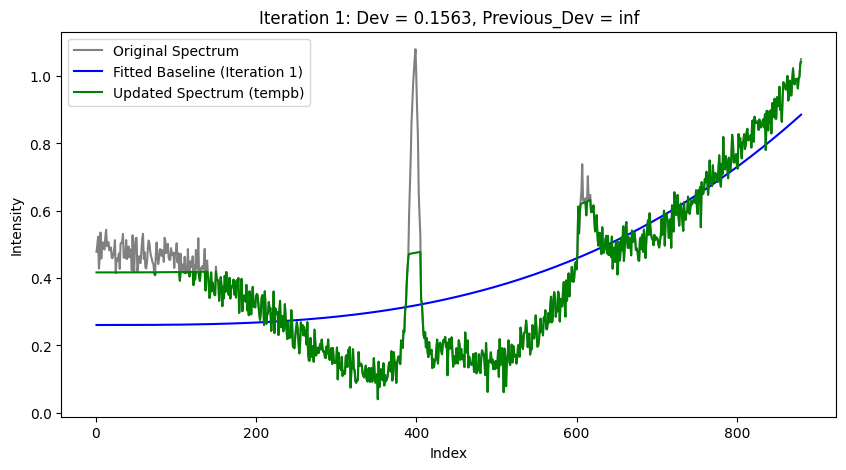

tf.Tensor([[1.0000000e+00 3.2293801e-31 7.4481625e-18]], shape=(1, 3), dtype=float32)


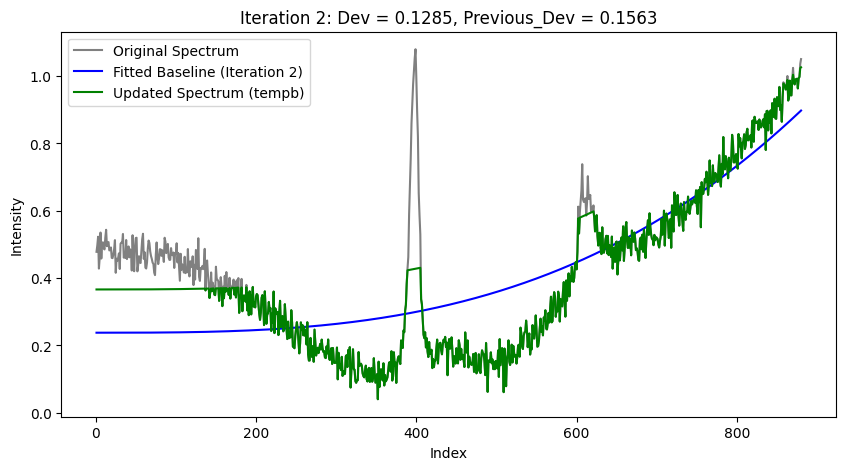

tf.Tensor([[1.0000000e+00 2.8463858e-32 1.2396522e-18]], shape=(1, 3), dtype=float32)


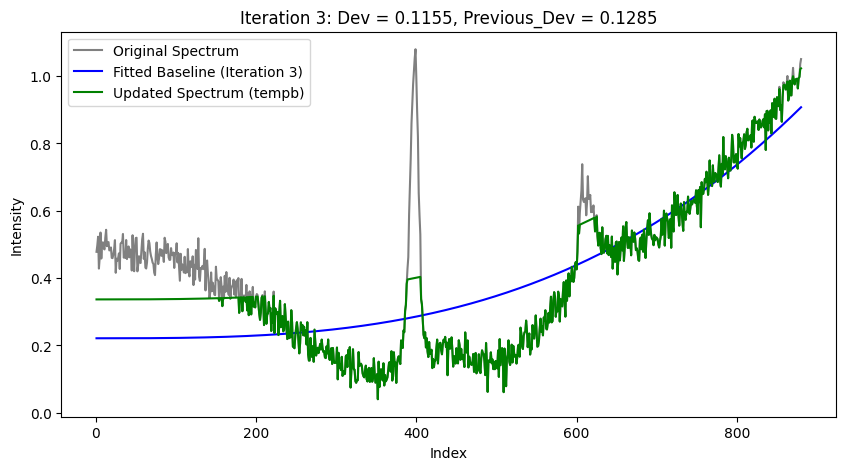

tf.Tensor([[1.0000000e+00 3.7610059e-33 1.4812707e-19]], shape=(1, 3), dtype=float32)


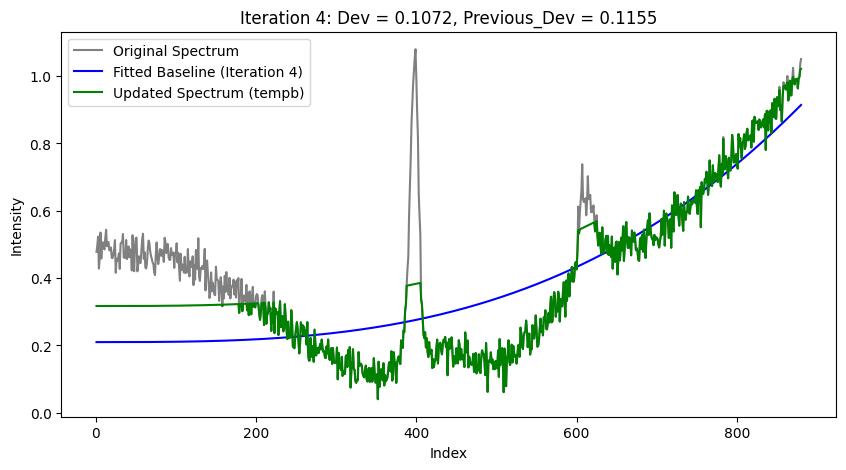

tf.Tensor([[1.0000000e+00 1.0681904e-33 3.3100828e-20]], shape=(1, 3), dtype=float32)


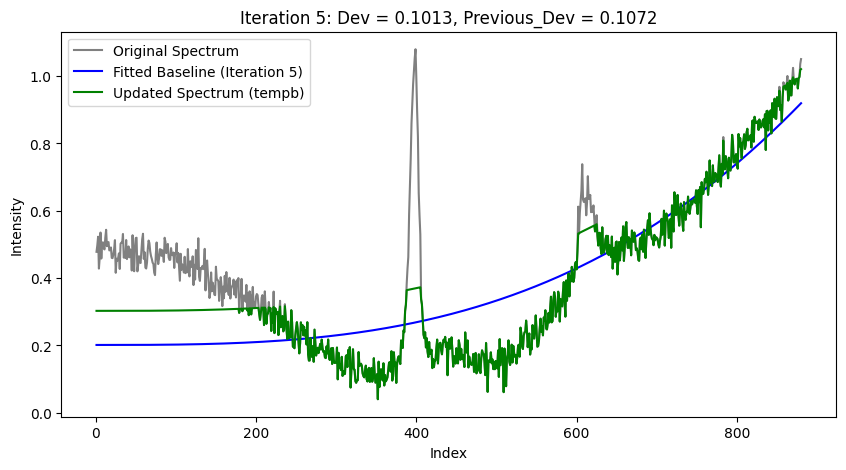

tf.Tensor([[1.0000000e+00 4.0267418e-34 9.9373811e-21]], shape=(1, 3), dtype=float32)


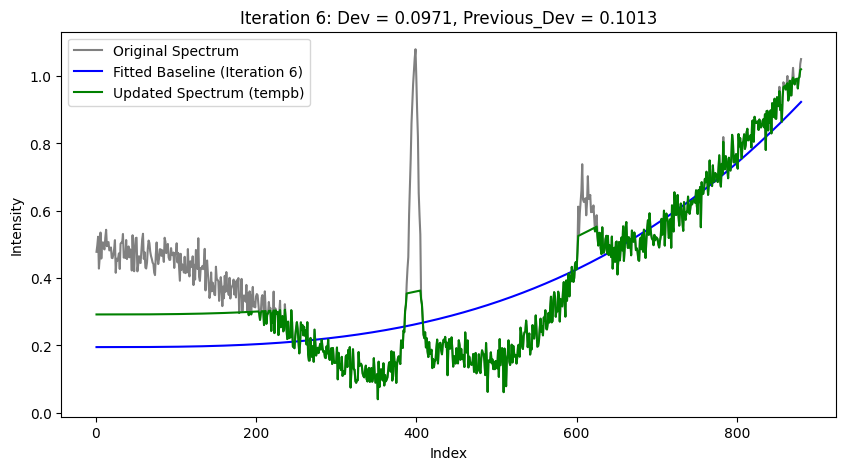

tf.Tensor([[1.0000000e+00 1.9742508e-34 3.3309176e-21]], shape=(1, 3), dtype=float32)


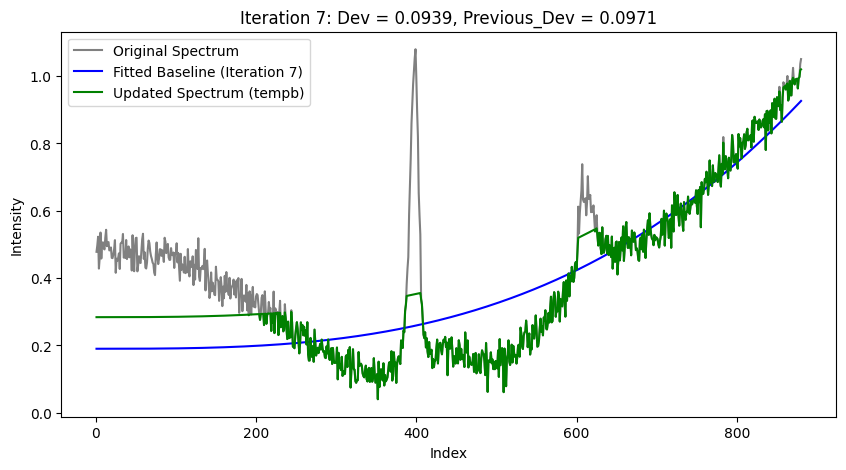

tf.Tensor([[1.0000000e+00 1.2521558e-34 1.5135763e-21]], shape=(1, 3), dtype=float32)


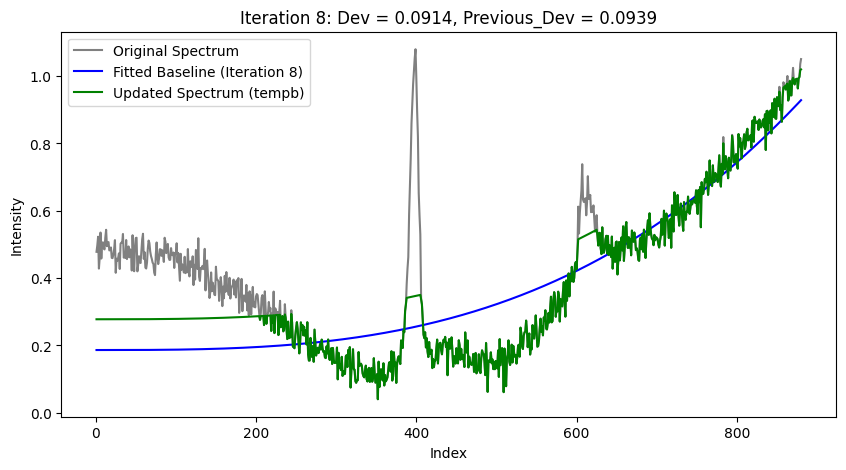

tf.Tensor([[1.0000000e+00 9.3331743e-35 8.7815875e-22]], shape=(1, 3), dtype=float32)


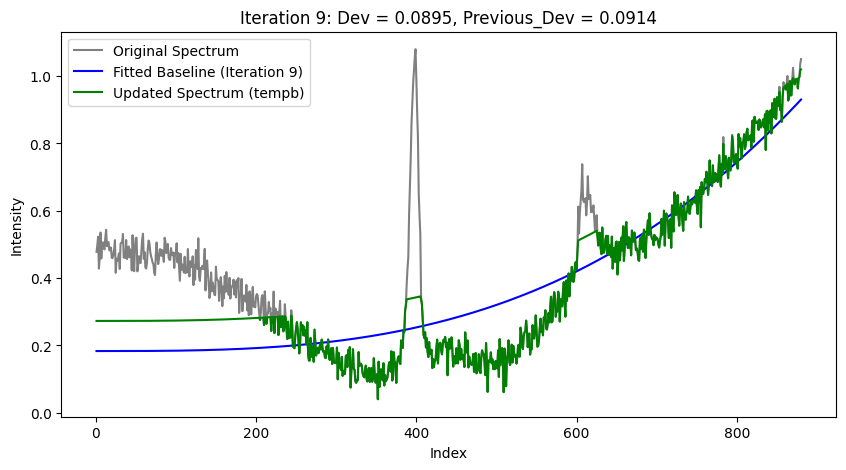

tf.Tensor([[1.0000000e+00 7.4167971e-35 5.7139616e-22]], shape=(1, 3), dtype=float32)


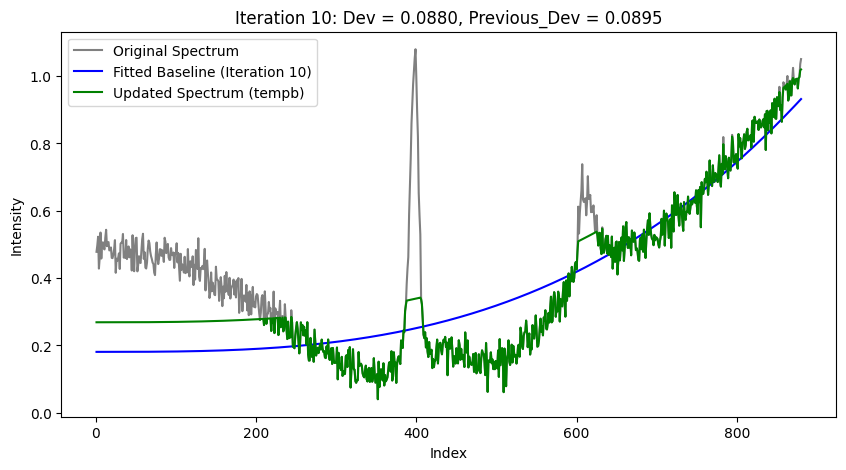

tf.Tensor([[1.0000000e+00 6.1448485e-35 4.0304852e-22]], shape=(1, 3), dtype=float32)


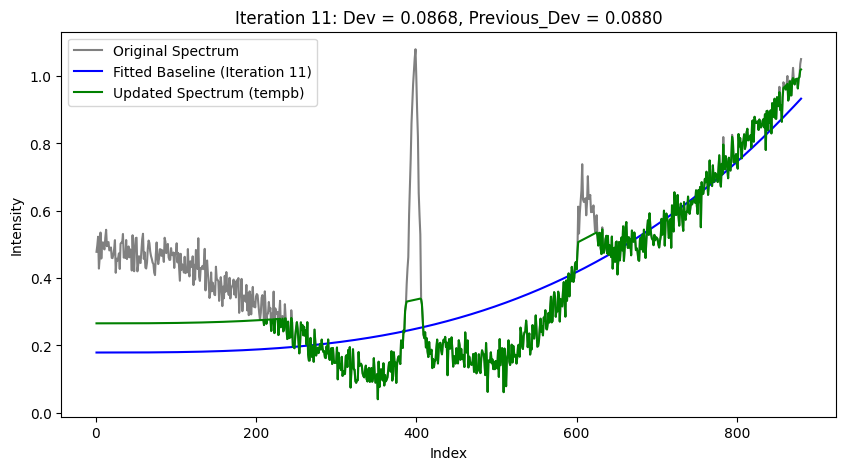

tf.Tensor([[1.0000000e+00 5.2876204e-35 3.0550467e-22]], shape=(1, 3), dtype=float32)


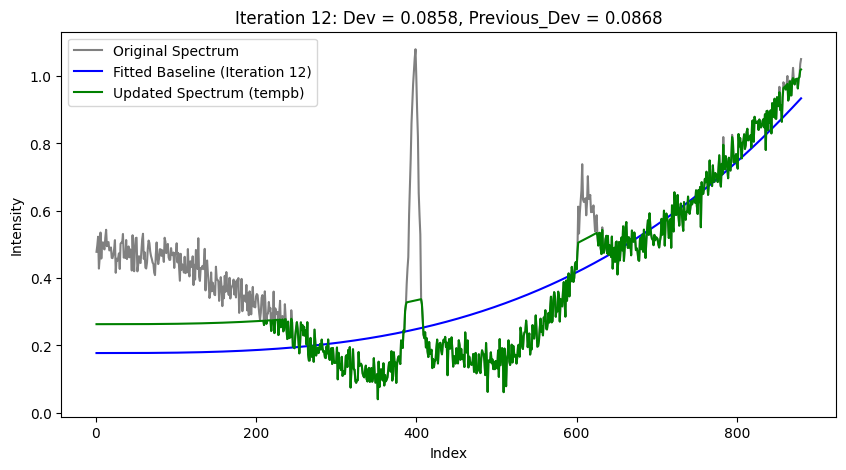

tf.Tensor([[1.0000000e+00 4.6824282e-35 2.4491960e-22]], shape=(1, 3), dtype=float32)


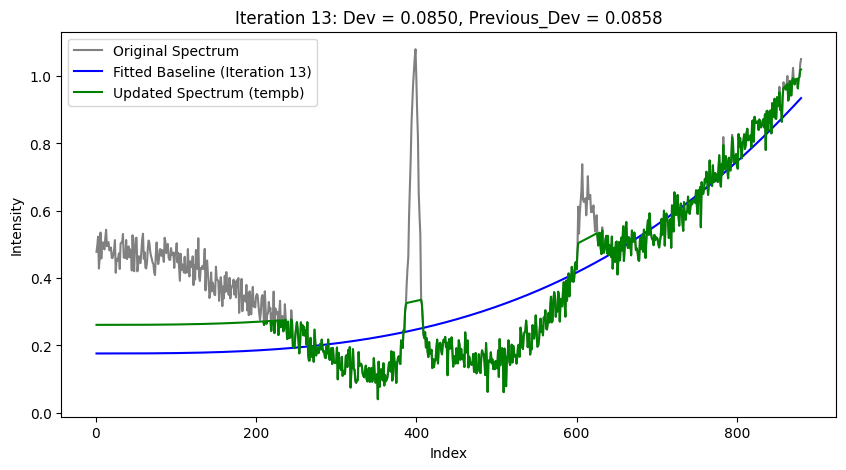

tf.Tensor([[1.0000000e+00 4.2624240e-35 2.0581779e-22]], shape=(1, 3), dtype=float32)


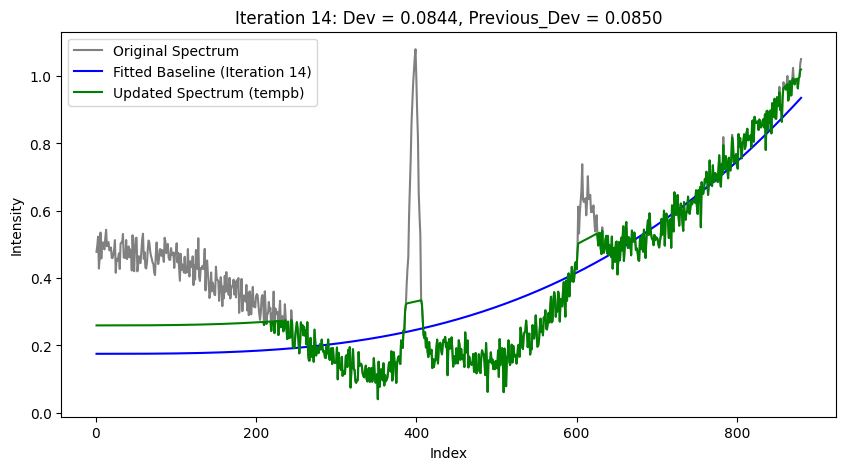

tf.Tensor([[1.0000000e+00 3.9593083e-35 1.7846664e-22]], shape=(1, 3), dtype=float32)


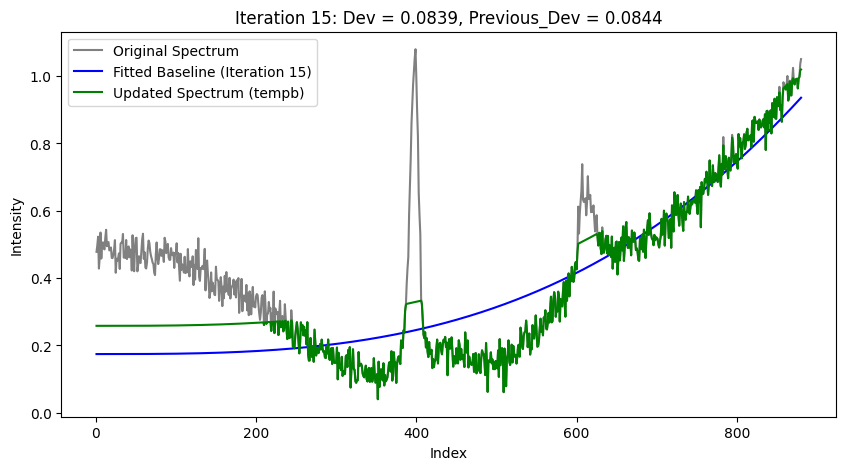

tf.Tensor([[1.0000000e+00 3.6016648e-35 1.5755395e-22]], shape=(1, 3), dtype=float32)


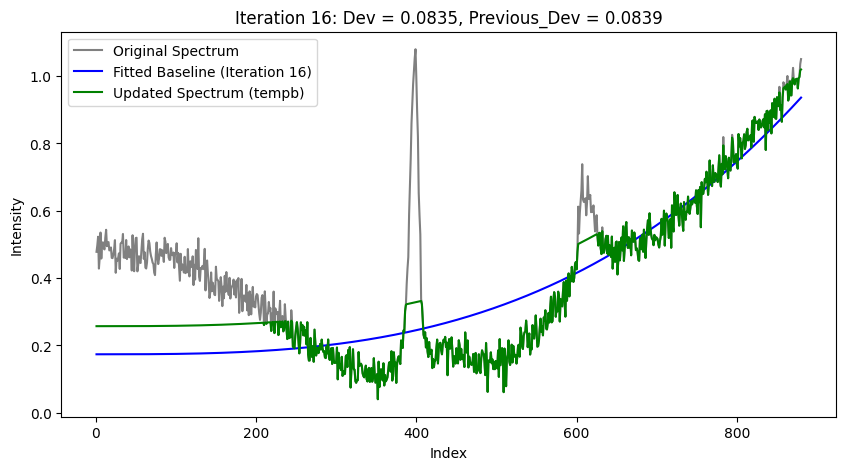

Converged at iteration 16 with threshold: 0.005


In [17]:
import numpy as np
import matplotlib.pyplot as plt
import os
import tensorflow as tf  # Assuming you need this for certain TensorFlow operations

# Ensure the plots directory exists
os.makedirs('./plots', exist_ok=True)

# RMSE Calculation
def calculate_rmse(signal, baseline):
    return np.sqrt(np.mean((signal - baseline) ** 2))

# New SNR Calculation
def calculate_snr(y_s, y_hat):
    numerator = np.sum(y_s)
    denominator = np.sum((y_s - y_hat) ** 2)
    snr = numerator / denominator
    return snr

sample_data = x_train[9]  # Noisy original signal
true_data = input2[i] / max(input2[5])  # Normalized true Raman signal
# Loop through samples for RMSE and SNR calculations

    
   
    
    # Calculate different baselines
B= iterative_fitting_with_bounds(sample_data, 100)
  
    # Real baseline
baseline = baseline_train[i]
  

In [ ]:
!pip install scikit-image

In [29]:
import numpy as np
import tensorflow as tf
import time
from skimage.metrics import structural_similarity as ssim

def calculate_rmse(y_true, y_pred):
    return np.sqrt(np.mean((y_true - y_pred) ** 2))

# Hàm tính SNR
def calculate_snr(y_s, y_hat):
    numerator = np.sum(y_s)
    denominator = np.sum((y_s - y_hat) ** 2)
    return numerator / denominator

# Hàm tính SSIM
def calculate_ssim(y_true, y_pred):
    return ssim(y_true, y_pred, data_range=y_true.max() - y_true.min())

# Thiết lập số lượng mẫu trên mỗi nhóm và tổng số mẫu cần đo
group_size = 32
total_samples = 3200  # Số mẫu cần tính
num_groups = total_samples // group_size

# Biến lưu trữ tổng SNR, MSE và SSIM cho tất cả mẫu
total_snr_B = total_snr_B_1 = total_snr_base_lines2 = total_snr_B3 = 0
total_mse_B = total_mse_B_1 = total_mse_base_lines2 = total_mse_B3 = 0
total_ssim_B = total_ssim_B_1 = total_ssim_base_lines2 = total_ssim_B3 = 0

# Biến lưu trữ thời gian thực thi của mỗi phương pháp
total_time_B = total_time_B_1 = total_time_base_lines2 = total_time_B3 = 0

# Ghi lại thời gian bắt đầu tổng quát
start_time = time.time()

# Chạy qua từng nhóm mẫu và tính trung bình cho mỗi nhóm
print(f"Running total: {num_groups} batches of size {group_size}")
for group_idx in range(num_groups):
    print(f"Processing group {group_idx + 1}/{num_groups}")

    # Biến để lưu trữ SNR, MSE và SSIM cho từng nhóm
    group_snr_B = group_snr_B_1 = group_snr_base_lines2 = group_snr_B3 = 0
    group_mse_B = group_mse_B_1 = group_mse_base_lines2 = group_mse_B3 = 0
    group_ssim_B = group_ssim_B_1 = group_ssim_base_lines2 = group_ssim_B3 = 0

    for i in range(group_size):
        sample_index = group_idx * group_size + i
        sample_data = x_train[sample_index]  # Tín hiệu gốc có nhiễu
        true_data = input2[sample_index] / max(input2[sample_index])  # Chuẩn hóa tín hiệu Raman thực
        baseline = baseline_train[sample_index]

        # Tính baseline cho từng phương pháp và đo thời gian thực hiện
        start_B = time.time()
        B = iterative_fitting_with_bounds(sample_data, 100)
        total_time_B += time.time() - start_B

        start_B_1 = time.time()
        B_1 = iterative_fitting_with_bounds_no(sample_data, 100)
        total_time_B_1 += time.time() - start_B_1

        start_base_lines2 = time.time()
        base_lines2, _ = pybaselines.polynomial.imodpoly(data=tf.expand_dims(sample_data, axis=0)[0], poly_order=6, max_iter=500)
        total_time_base_lines2 += time.time() - start_base_lines2

        start_B3 = time.time()
        B3 = airPLS(sample_data)
        total_time_B3 += time.time() - start_B3

        # Tính SNR cho từng phương pháp khử baseline
        group_snr_B += calculate_snr(true_data, sample_data - B)
        group_snr_B_1 += calculate_snr(true_data, sample_data - B_1)
        group_snr_base_lines2 += calculate_snr(true_data, sample_data - base_lines2)
        group_snr_B3 += calculate_snr(true_data, sample_data - B3)

        # Tính MSE cho từng phương pháp
        group_mse_B += calculate_rmse(baseline, sample_data - B)
        group_mse_B_1 += calculate_rmse(baseline, sample_data - B_1)
        group_mse_base_lines2 += calculate_rmse(baseline, sample_data - base_lines2)
        group_mse_B3 += calculate_rmse(baseline, sample_data - B3)

        # Tính SSIM cho từng phương pháp
        group_ssim_B += calculate_ssim(true_data, sample_data - B)
        group_ssim_B_1 += calculate_ssim(true_data, sample_data - B_1)
        group_ssim_base_lines2 += calculate_ssim(true_data, sample_data - base_lines2)
        group_ssim_B3 += calculate_ssim(true_data, sample_data - B3)

    # Cộng dồn SNR, MSE, và SSIM trung bình của mỗi nhóm vào tổng
    total_snr_B += group_snr_B / group_size
    total_snr_B_1 += group_snr_B_1 / group_size
    total_snr_base_lines2 += group_snr_base_lines2 / group_size
    total_snr_B3 += group_snr_B3 / group_size

    total_mse_B += group_mse_B / group_size
    total_mse_B_1 += group_mse_B_1 / group_size
    total_mse_base_lines2 += group_mse_base_lines2 / group_size
    total_mse_B3 += group_mse_B3 / group_size

    total_ssim_B += group_ssim_B / group_size
    total_ssim_B_1 += group_ssim_B_1 / group_size
    total_ssim_base_lines2 += group_ssim_base_lines2 / group_size
    total_ssim_B3 += group_ssim_B3 / group_size

    # In ra các chỉ số của nhóm hiện tại
    print(f"Group {group_idx + 1} - Average SNR:")
    print(f"Our method with bounds: {group_snr_B / group_size:.4f}, Based method with bounds: {group_snr_B_1 / group_size:.4f}, Imodpoly: {group_snr_base_lines2 / group_size:.4f}, airPLS: {group_snr_B3 / group_size:.4f}")
    print(f"Group {group_idx + 1} - Average MSE:")
    print(f"Our method with bounds: {group_mse_B / group_size:.4f}, Based method with bounds: {group_mse_B_1 / group_size:.4f}, Imodpoly: {group_mse_base_lines2 / group_size:.4f}, airPLS: {group_mse_B3 / group_size:.4f}")
    print(f"Group {group_idx + 1} - Average SSIM:")
    print(f"Our method with bounds: {group_ssim_B / group_size:.4f}, Based method with bounds: {group_ssim_B_1 / group_size:.4f}, Imodpoly: {group_ssim_base_lines2 / group_size:.4f}, airPLS: {group_ssim_B3 / group_size:.4f}")
    print("-" * 50)

# Ghi lại thời gian tổng thể kết thúc
end_time = time.time()
execution_time = end_time - start_time

# Tính SNR, MSE và SSIM trung bình cho tất cả các nhóm
average_snr_B = total_snr_B / num_groups
average_snr_B_1 = total_snr_B_1 / num_groups
average_snr_base_lines2 = total_snr_base_lines2 / num_groups
average_snr_B3 = total_snr_B3 / num_groups

average_mse_B = total_mse_B / num_groups
average_mse_B_1 = total_mse_B_1 / num_groups
average_mse_base_lines2 = total_mse_base_lines2 / num_groups
average_mse_B3 = total_mse_B3 / num_groups

average_ssim_B = total_ssim_B / num_groups
average_ssim_B_1 = total_ssim_B_1 / num_groups
average_ssim_base_lines2 = total_ssim_base_lines2 / num_groups
average_ssim_B3 = total_ssim_B3 / num_groups

# Tính thời gian thực thi trung bình của mỗi phương pháp
average_time_B = total_time_B / total_samples
average_time_B_1 = total_time_B_1 / total_samples
average_time_base_lines2 = total_time_base_lines2 / total_samples
average_time_B3 = total_time_B3 / total_samples

# In ra các kết quả tổng kết
print("\nOverall Average SNR:")
print(f"Our method with bounds: {average_snr_B:.4f}")
print(f"Based method with bounds: {average_snr_B_1:.4f}")
print(f"Imodpoly: {average_snr_base_lines2:.4f}")
print(f"airPLS: {average_snr_B3:.4f}")

print("\nOverall Average MSE:")
print(f"Our method with bounds: {average_mse_B:.4f}")
print(f"Based method with bounds: {average_mse_B_1:.4f}")
print(f"Imodpoly: {average_mse_base_lines2:.4f}")
print(f"airPLS: {average_mse_B3:.4f}")

print("\nOverall Average SSIM:")
print(f"Our method with bounds: {average_ssim_B:.4f}")
print(f"Based method with bounds: {average_ssim_B_1:.4f}")
print(f"Imodpoly: {average_ssim_base_lines2:.4f}")
print(f"airPLS: {average_ssim_B3:.4f}")

print("\nAverage Execution Time per Method:")
print(f"Our method with bounds: {average_time_B:.6f} seconds")
print(f"Based method with bounds: {average_time_B_1:.6f} seconds")
print(f"Imodpoly: {average_time_base_lines2:.6f} seconds")
print(f"airPLS: {average_time_B3:.6f} seconds")

print("\nTotal Execution Time:", execution_time, "seconds")


Running total: 100 batches of size 32
Processing group 1/100
Group 1 - Average SNR:
Our method with bounds: 64.4868, Based method with bounds: 7.3248, Imodpoly: 63.1942, airPLS: 16.0244
Group 1 - Average MSE:
Our method with bounds: 119.2862, Based method with bounds: 0.5432, Imodpoly: 0.6308, airPLS: 0.5682
Group 1 - Average SSIM:
Our method with bounds: 0.2339, Based method with bounds: 0.3268, Imodpoly: 0.4419, airPLS: 0.5666
--------------------------------------------------
Processing group 2/100
Group 2 - Average SNR:
Our method with bounds: 101.5354, Based method with bounds: 9.7882, Imodpoly: 62.6665, airPLS: 17.5735
Group 2 - Average MSE:
Our method with bounds: 87.6104, Based method with bounds: 0.5012, Imodpoly: 0.5598, airPLS: 0.5271
Group 2 - Average SSIM:
Our method with bounds: 0.3347, Based method with bounds: 0.3624, Imodpoly: 0.4537, airPLS: 0.5731
--------------------------------------------------
Processing group 3/100
Group 3 - Average SNR:
Our method with bounds: 

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
import pybaselines
import time
from skimage.metrics import structural_similarity as ssim

# Hàm baseline_RCF
def baseline_RCF(y, Radius):        
    temp = np.array(y)
    temp = (temp - min(temp)) / (max(temp) - min(temp)) * len(temp)        
    Rx = np.ones(len(temp), int) * int(Radius)  
    Y_RCF_all = []
    filtered_all = []
    for i in range(len(Rx)):
        if Rx[i] < 2:
            Rx[i] = Rx[i - 1]        
    subtracted = np.ones(len(temp)) * max(temp)  
    for i in range(len(y) - 1):
        if i < Rx[i]:
            left = -i
        else:
            left = -Rx[i]
        if (i + Rx[i]) > len(y):
            right = len(y) - i
        else:
            right = Rx[i]
        C = np.array(range(left, right))
        C = np.sqrt(Rx[i]**2 - C**2)    
        Y_RCF = temp[(i + left):(i + right)] - C
        filtered = Y_RCF - min(Y_RCF)    
        Y_RCF_all.append(Y_RCF)
        filtered_all.append(filtered)
        for j in range(left, right):
            subtracted[i + j] = min(subtracted[i + j], filtered[j - left])
    subtracted = subtracted / max(subtracted)
    return subtracted

# Hàm tính SNR
def calculate_snr(y_s, y_hat):
    numerator = np.sum(y_s)
    denominator = np.sum((y_s - y_hat) ** 2)
    return numerator / denominator

# Hàm tính RMSE
def calculate_rmse(y_true, y_pred):
    return np.sqrt(np.mean((y_true - y_pred) ** 2))

# Hàm tính SSIM
def calculate_ssim(y_true, y_pred):
    return ssim(y_true, y_pred, data_range=y_true.max() - y_true.min())

# Thiết lập số lượng mẫu trên mỗi nhóm và tổng số mẫu cần đo
group_size = 32
total_samples = 3200  # Số mẫu cần tính
num_groups = total_samples // group_size

# Biến lưu trữ tổng SNR, MSE và SSIM cho tất cả mẫu
total_snr_rcf = 0
total_mse_rcf = 0
total_ssim_rcf = 0
total_snr_airpls = 0
total_mse_airpls = 0
total_ssim_airpls = 0

# Biến lưu trữ thời gian thực thi của phương pháp RCF và airPLS
total_time_rcf = 0
total_time_airpls = 0

# Ghi lại thời gian bắt đầu tổng quát
start_time = time.time()

# Chạy qua từng nhóm mẫu và tính trung bình cho mỗi nhóm
print(f"Running total: {num_groups} batches of size {group_size}")
for group_idx in range(num_groups):
    print(f"Processing group {group_idx + 1}/{num_groups}")

    # Biến để lưu trữ SNR, MSE và SSIM cho từng nhóm
    group_snr_rcf = 0
    group_mse_rcf = 0
    group_ssim_rcf = 0
    group_snr_airpls = 0
    group_mse_airpls = 0
    group_ssim_airpls = 0

    for i in range(group_size):
        sample_index = group_idx * group_size + i
        sample_data = x_train[sample_index]  # Tín hiệu gốc có nhiễu
        true_data = input2[sample_index] / max(input2[sample_index])  # Chuẩn hóa tín hiệu Raman thực

        # Tính baseline RCF và đo thời gian thực hiện
        start_rcf = time.time()
        baseline_rcf = baseline_RCF(sample_data, Radius=100)
        total_time_rcf += time.time() - start_rcf

        # Tính baseline airPLS và đo thời gian thực hiện
        start_airpls = time.time()
        baseline_airpls = airPLS(sample_data)
        total_time_airpls += time.time() - start_airpls

        # Tính SNR, MSE và SSIM cho RCF
        denoised_data_rcf = baseline_rcf
        group_snr_rcf += calculate_snr(true_data, denoised_data_rcf)
        group_mse_rcf += calculate_rmse(true_data, denoised_data_rcf)
        group_ssim_rcf += calculate_ssim(true_data, denoised_data_rcf)

        # Tính SNR, MSE và SSIM cho airPLS
        denoised_data_airpls = sample_data - baseline_airpls
        group_snr_airpls += calculate_snr(true_data, denoised_data_airpls)
        group_mse_airpls += calculate_rmse(true_data, denoised_data_airpls)
        group_ssim_airpls += calculate_ssim(true_data, denoised_data_airpls)

    # Cộng dồn SNR, MSE, và SSIM trung bình của mỗi nhóm vào tổng
    total_snr_rcf += group_snr_rcf / group_size
    total_mse_rcf += group_mse_rcf / group_size
    total_ssim_rcf += group_ssim_rcf / group_size

    total_snr_airpls += group_snr_airpls / group_size
    total_mse_airpls += group_mse_airpls / group_size
    total_ssim_airpls += group_ssim_airpls / group_size

    # In ra các chỉ số của nhóm hiện tại
    print(f"Group {group_idx + 1} - Average Metrics:")
    print(f"RCF - SNR: {group_snr_rcf / group_size:.4f}, MSE: {group_mse_rcf / group_size:.4f}, SSIM: {group_ssim_rcf / group_size:.4f}")
    print(f"airPLS - SNR: {group_snr_airpls / group_size:.4f}, MSE: {group_mse_airpls / group_size:.4f}, SSIM: {group_ssim_airpls / group_size:.4f}")
    print("-" * 50)

# Ghi lại thời gian tổng thể kết thúc
end_time = time.time()
execution_time = end_time - start_time

# Tính SNR, MSE và SSIM trung bình cho tất cả các nhóm
average_snr_rcf = total_snr_rcf / num_groups
average_mse_rcf = total_mse_rcf / num_groups
average_ssim_rcf = total_ssim_rcf / num_groups

average_snr_airpls = total_snr_airpls / num_groups
average_mse_airpls = total_mse_airpls / num_groups
average_ssim_airpls = total_ssim_airpls / num_groups

# Tính thời gian thực thi trung bình của phương pháp RCF và airPLS
average_time_rcf = total_time_rcf / total_samples
average_time_airpls = total_time_airpls / total_samples

# In ra các kết quả tổng kết
print("\nOverall Average Metrics:")
print(f"RCF - SNR: {average_snr_rcf:.4f}, MSE: {average_mse_rcf:.4f}, SSIM: {average_ssim_rcf:.4f}")
print(f"airPLS - SNR: {average_snr_airpls:.4f}, MSE: {average_mse_airpls:.4f}, SSIM: {average_ssim_airpls:.4f}")

print("\nAverage Execution Time:")
print(f"RCF: {average_time_rcf:.6f} seconds")
print(f"airPLS: {average_time_airpls:.6f} seconds")

print("\nTotal Execution Time:", execution_time, "seconds")

# Vẽ biểu đồ 10 phổ đầu tiên
plt.figure(figsize=(20, 10))
for i in range(10):
    sample_data = x_train[i]  # Tín hiệu gốc có nhiễu
    true_data = input2[i] / max(input2[i])  # Chuẩn hóa tín hiệu Raman thực

    # Tính baseline RCF
    baseline_rcf = baseline_RCF(sample_data, Radius=100)
    denoised_data_rcf = baseline_rcf

    # Tính baseline airPLS
    baseline_airpls = iterative_fitting_with_bounds(sample_data)
    denoised_data_airpls = sample_data - baseline_airpls

    # Vẽ phổ
    plt.subplot(2, 5, i + 1)
    plt.plot(sample_data, label="Noisy Signal", alpha=0.6)
    plt.plot(true_data, label="True Signal", linestyle="--")
    plt.plot(denoised_data_rcf, label="Denoised by RCF", linestyle="-.", alpha=0.8)
    plt.plot(denoised_data_airpls, label="Denoised by airPLS", linestyle=":", alpha=0.8)
    plt.title(f"Sample {i + 1}")
    plt.legend()

plt.tight_layout()
plt.show()


Running total: 100 batches of size 32
Processing group 1/100
Group 1 - Average Metrics:
RCF - SNR: 35.4569, MSE: 0.0417, SSIM: 0.6216
airPLS - SNR: 16.0244, MSE: 0.0892, SSIM: 0.5666
--------------------------------------------------
Processing group 2/100
Group 2 - Average Metrics:
RCF - SNR: 39.0952, MSE: 0.0406, SSIM: 0.6198
airPLS - SNR: 17.5735, MSE: 0.0697, SSIM: 0.5731
--------------------------------------------------
Processing group 3/100


KeyboardInterrupt: 

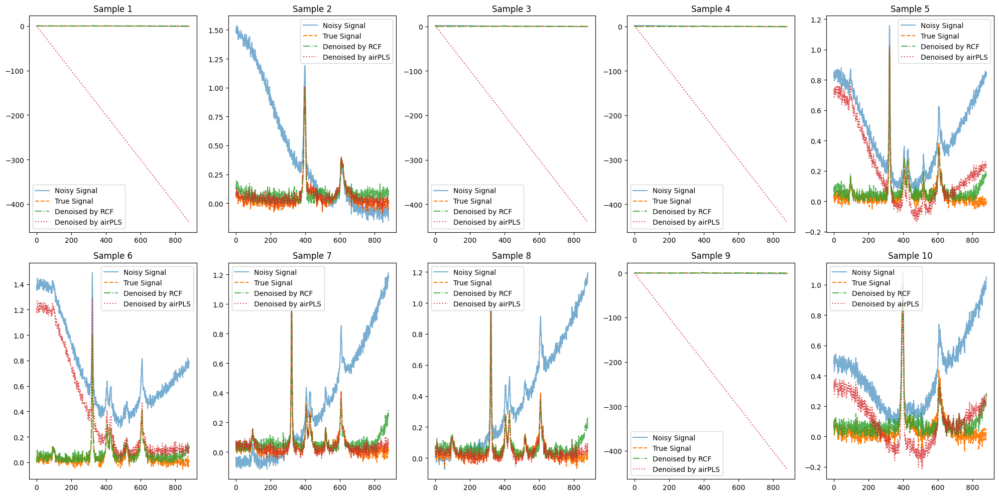

In [33]:
# Vẽ biểu đồ 10 phổ đầu tiên
plt.figure(figsize=(20, 10))
for i in range(10):
    sample_data = x_train[i]  # Tín hiệu gốc có nhiễu
    true_data = input2[i] / max(input2[i])  # Chuẩn hóa tín hiệu Raman thực

    # Tính baseline RCF
    baseline_rcf = baseline_RCF(sample_data, Radius=100)
    denoised_data_rcf = baseline_rcf

    # Tính baseline airPLS
    baseline_airpls = iterative_fitting_with_bounds(sample_data,500)
    denoised_data_airpls = sample_data - baseline_airpls

    # Vẽ phổ
    plt.subplot(2, 5, i + 1)
    plt.plot(sample_data, label="Noisy Signal", alpha=0.6)
    plt.plot(true_data, label="True Signal", linestyle="--")
    plt.plot(denoised_data_rcf, label="Denoised by RCF", linestyle="-.", alpha=0.8)
    plt.plot(denoised_data_airpls, label="Denoised by airPLS", linestyle=":", alpha=0.8)
    plt.title(f"Sample {i + 1}")
    plt.legend()

plt.tight_layout()
plt.show()


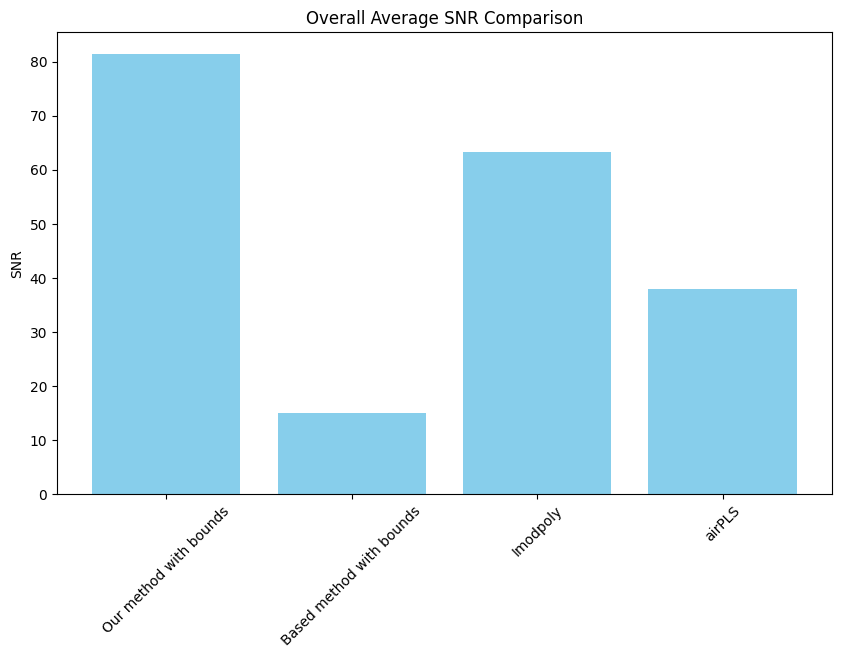

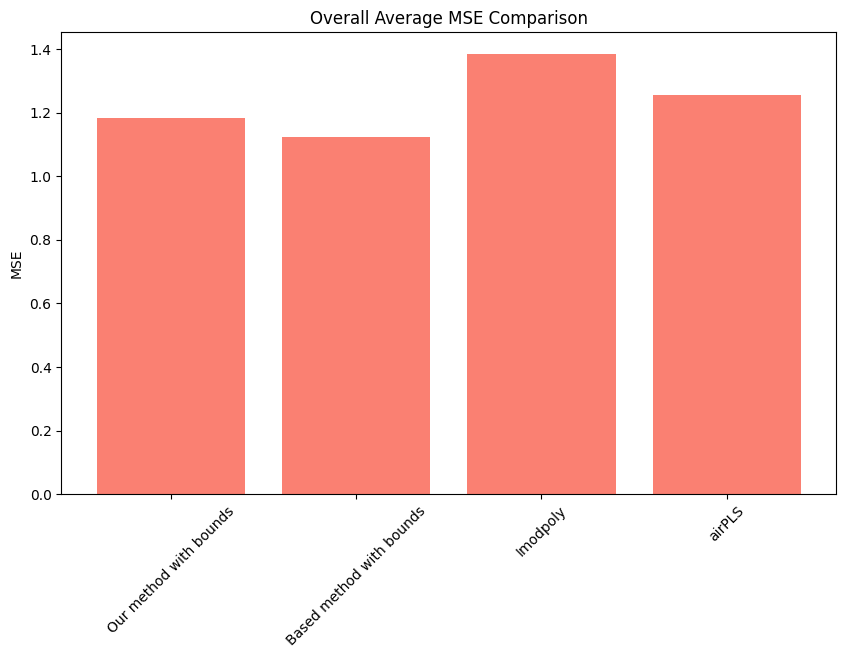

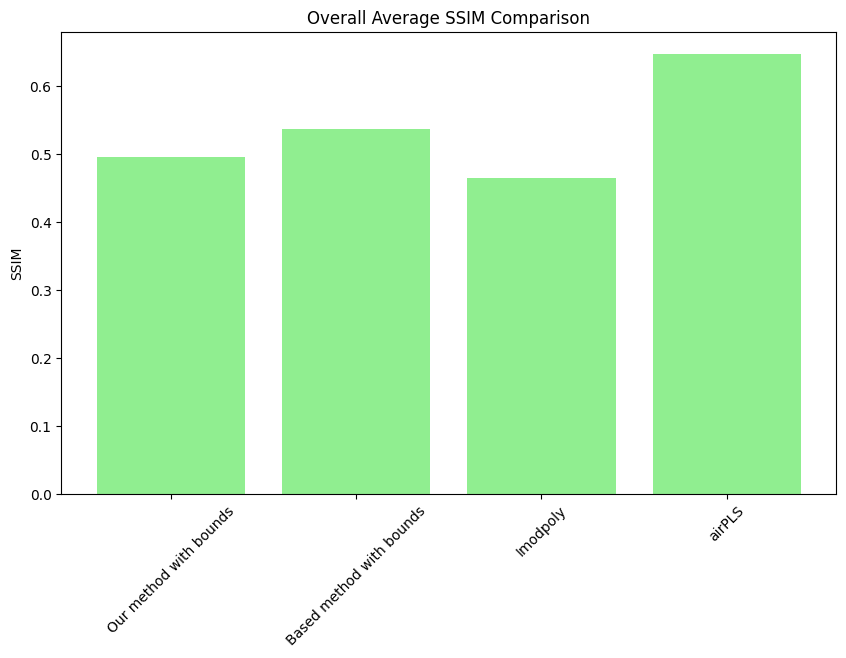

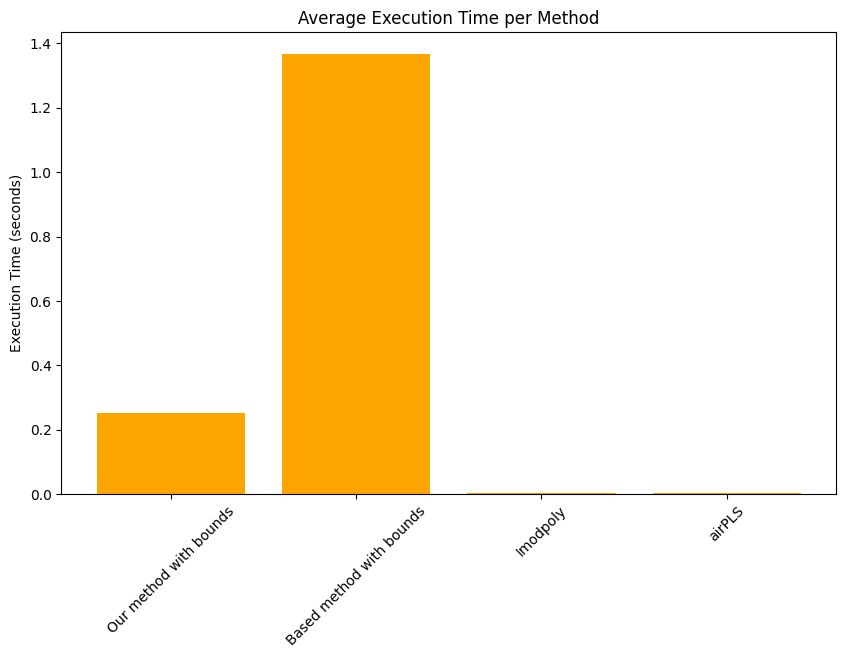

In [4]:
import matplotlib.pyplot as plt
import numpy as np

# Dữ liệu
methods = ["Our method with bounds", "Based method with bounds", "Imodpoly", "airPLS"]
snr_values = [81.3936, 14.9755, 63.3302, 37.9712]
mse_values = [1.1833, 1.1226, 1.3837, 1.2554]
ssim_values = [0.4966, 0.5371, 0.4649, 0.6476]
execution_time_values = [0.251361, 1.366400, 0.002345, 0.003446]

# Thiết lập số liệu để vẽ biểu đồ
x = np.arange(len(methods))

# Vẽ biểu đồ SNR
plt.figure(figsize=(10, 6))
plt.bar(x, snr_values, color='skyblue')
plt.xticks(x, methods, rotation=45)
plt.ylabel("SNR")
plt.title("Overall Average SNR Comparison")
plt.savefig("Overall_average_snr_comparison.png") 
plt.show()

# Vẽ biểu đồ MSE
plt.figure(figsize=(10, 6))
plt.bar(x, mse_values, color='salmon')
plt.xticks(x, methods, rotation=45)
plt.ylabel("MSE")
plt.title("Overall Average MSE Comparison")
plt.savefig("Overall Average MSE Comparison.png") 
plt.show()

# Vẽ biểu đồ SSIM
plt.figure(figsize=(10, 6))
plt.bar(x, ssim_values, color='lightgreen')
plt.xticks(x, methods, rotation=45)
plt.ylabel("SSIM")
plt.title("Overall Average SSIM Comparison")
plt.savefig("Overall Average SSIM Comparison.png") 
plt.show()

# Vẽ biểu đồ Thời gian thực thi trung bình
plt.figure(figsize=(10, 6))
plt.bar(x, execution_time_values, color='orange')
plt.xticks(x, methods, rotation=45)
plt.ylabel("Execution Time (seconds)")
plt.title("Average Execution Time per Method")
plt.savefig("Average Execution Time per Method.png") 
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Dữ liệu cho các phương pháp
data = {
    "Method": ["Our method with bounds", "Based method with bounds", "Imodpoly", "airPLS"],
    "SNR": [81.3936, 14.9755, 63.3302, 37.9712],
    "MSE": [1.1833, 1.1226, 1.3837, 1.2554],
    "SSIM": [0.4966, 0.5371, 0.4649, 0.6476],
    "Execution Time (seconds)": [0.251361, 1.366400, 0.002345, 0.003446]
}

# Tạo DataFrame
df = pd.DataFrame(data)

# Vẽ bảng bằng matplotlib
fig, ax = plt.subplots(figsize=(10, 2))  # Kích thước hình ảnh
ax.axis('tight')
ax.axis('off')
table = ax.table(cellText=df.values, colLabels=df.columns, cellLoc='center', loc='center')

# Lưu bảng dưới dạng ảnh
plt.savefig("table_comparison.png", dpi=300, bbox_inches='tight')
plt.show()


In [ ]:
# import os
# import numpy as np
# import tensorflow as tf
# import matplotlib.pyplot as plt
# import pandas as pd
# import pybaselines
# import time  # Thêm import cho module time
# 
# print("start")
# 
# # Định nghĩa hàm tính RMSE
# def calculate_rmse(y_true, y_pred):
#     """
#     Function to calculate Root Mean Squared Error (RMSE)
# 
#     Parameters:
#     - y_true: numpy array, true values
#     - y_pred: numpy array, predicted values
# 
#     Returns:
#     - rmse: float, RMSE value
#     """
#     # Reshape y_true_batch để có cùng kích thước với y_pred_batch
#     rmse = np.sqrt(np.mean((y_true - y_pred)**2))
#     return rmse
# 
# # Đọc dữ liệu từ tệp CSV vào DataFrame, bỏ qua dòng đầu tiên
# df = pd.read_csv("./data/Baseline_test_01104.csv", skiprows=1, header=None)
# 
# # Chuyển đổi DataFrame thành mảng numpy
# data_array = df.values
# 
# print("Đọc dữ liệu")
# 
# # Tách nhãn từ dữ liệu
# y_train = data_array[:, :2]
# y_train = tf.cast(y_train, tf.float32)
# 
# # Tách dữ liệu vào x_train
# x_train = data_array[:, 2:882]
# baseline_train = data_array[:, 882:]
# 
# # Tạo dataset từ dữ liệu
# dataset = tf.data.Dataset.from_tensor_slices((x_train, baseline_train)).batch(32)
# 
# num_batches = len(dataset)
# total_rmse = 0.0
# total_rmse_airPLS = 0.0
# total_rmse_IModpoly = 0.0
# total_rmse_noModify = 0.0
# 
# total_time_noModify = 0.0
# total_time = 0.0
# total_time_airPLS = 0.0
# total_time_IModpoly = 0.0
# 
# Raman_our = np.zeros((300, 880, 1))
# Raman_no = np.zeros((300, 880, 1))
# Raman_airPLS = np.zeros((300, 880, 1))
# Raman_IModpoly = np.zeros((300, 880, 1))
# Raman_raw = np.zeros((300, 880, 1))
# j = 0
# 
# # Lặp qua từng batch trong dataset
# for i, (X_batch, y_true_batch) in enumerate(dataset):
#     total_rmse_batch = 0.0
#     total_rmse_airPLS_batch = 0.0
#     total_rmse_IModpoly_batch = 0.0
#     total_rmse_noModify_batch = 0.0
#     
#     start_time = time.time()
#     for X, y in zip(X_batch, y_true_batch):
#         X = np.array(X)
#         Raman_raw[j,:,:] = (X * 100).reshape(1,880,1)
#         y = np.array(y)
#         # Đo thời gian thực thi cho iterative_fitting_with_bounds_no
#         start = time.time()
#         y_pred_batch_noModify = iterative_fitting_with_bounds_no(X, 50)
#         end = time.time()
#         total_time_noModify += (end - start)
#         Raman_no[j,:,:] = ((X - y_pred_batch_noModify) * 100).reshape(1,880,1)
#         
#         # Đo thời gian thực thi cho iterative_fitting_with_bounds
#         start = time.time()
#         y_pred_batch = iterative_fitting_with_bounds(X, 50)
#         end = time.time()
#         total_time += (end - start)
#         Raman_our[j,:,:] = ((X - y_pred_batch) * 100).reshape(1,880,1)
#         
#         # Đo thời gian thực thi cho airPLS
#         start = time.time()
#         B3 = airPLS(X)
#         end = time.time()
#         total_time_airPLS += (end - start)
#         Raman_airPLS[j,:,:] = ((X - B3) * 100).reshape(1,880,1)
# 
#         # Đo thời gian thực thi cho pybaselines.polynomial.imodpoly
#         start = time.time()
#         base_lines2, _ = pybaselines.polynomial.imodpoly(data=X, poly_order=3, max_iter=500)
#         end = time.time()
#         total_time_IModpoly += (end - start)
#         Raman_IModpoly[j,:,:] = ((X - base_lines2) * 100).reshape(1,880,1)
# 
#         # Tính toán RMSE cho mỗi batch    
#         rmse = calculate_rmse(y, y_pred_batch)
#         rmse_airPLS = calculate_rmse(y, B3)
#         rmse_noModify = calculate_rmse(y, y_pred_batch_noModify)
#         rmse_IModpoly = calculate_rmse(y, base_lines2)
#         
#         total_rmse_batch += rmse
#         total_rmse_airPLS_batch += rmse_airPLS
#         total_rmse_noModify_batch += rmse_noModify
#         total_rmse_IModpoly_batch += rmse_IModpoly
#         
#         j+=1
#     
#     total_rmse += (total_rmse_batch / len(X_batch))
#     total_rmse_airPLS += (total_rmse_airPLS_batch / len(X_batch))
#     total_rmse_noModify += (total_rmse_noModify_batch / len(X_batch))
#     total_rmse_IModpoly += (total_rmse_IModpoly_batch / len(X_batch))
#     
#     # In RMSE cho từng batch
#     print(f"Batch {i + 1}/{num_batches}: RMSE IModpoly {total_rmse_IModpoly_batch/len(X_batch)}, RMSE airPLS {total_rmse_airPLS_batch/len(X_batch)}, RMSE noModify {total_rmse_noModify_batch/len(X_batch)}, RMSE {total_rmse_batch/len(X_batch)}")
#     
#     # In thời gian thực thi cho từng batch
#     # print(f"Batch {i + 1}/{num_batches}: Time No Modify {total_time_noModify}, Time AirPLS {total_time_airPLS}, Time IModpoly {total_time_IModpoly}, Time {total_time}")
#     
#     print("---------------------------------------------------")
# 
# # Tính toán RMSE trung bình trên toàn bộ dataset
# average_rmse = total_rmse / num_batches
# average_rmse_airPLS = total_rmse_airPLS / num_batches
# average_rmse_noModify = total_rmse_noModify / num_batches
# average_rmse_IModpoly = total_rmse_IModpoly / num_batches
# 
# # Tính thời gian thực thi trung bình cho mỗi hàm
# average_time_noModify = total_time_noModify / (num_batches * len(X_batch))
# average_time_airPLS = total_time_airPLS / (num_batches * len(X_batch))
# average_time_IModpoly = total_time_IModpoly / (num_batches * len(X_batch))
# average_time = total_time / (num_batches * len(X_batch))
# 
# print("Average RMSE on the entire dataset:", average_rmse)
# print("Average RMSE_airPLS on the entire dataset:", average_rmse_airPLS)
# print("Average RMSE_noModify on the entire dataset:", average_rmse_noModify)
# print("Average RMSE_IModpoly on the entire dataset:", average_rmse_IModpoly)
# print("--------------------------------")
# print("Average Time No Modify on the entire dataset:", average_time_noModify)
# print("Average Time AirPLS on the entire dataset:", average_time_airPLS)
# print("Average Time IModpoly on the entire dataset:", average_time_IModpoly)
# print("Average Time on the entire dataset:", average_time)
# 
# # Lưu các phổ đã khử nhiễu baseline để test khử nhiễu dao động rồi định danh các chất
# np.save('./data/our.npy', Raman_our) 
# np.save('./data/no.npy', Raman_no) 
# np.save('./data/airPLS.npy', Raman_airPLS) 
# np.save('./data/IModpoly.npy', Raman_IModpoly)
# np.save('./data/Raw.npy', Raman_raw)
# print("done")

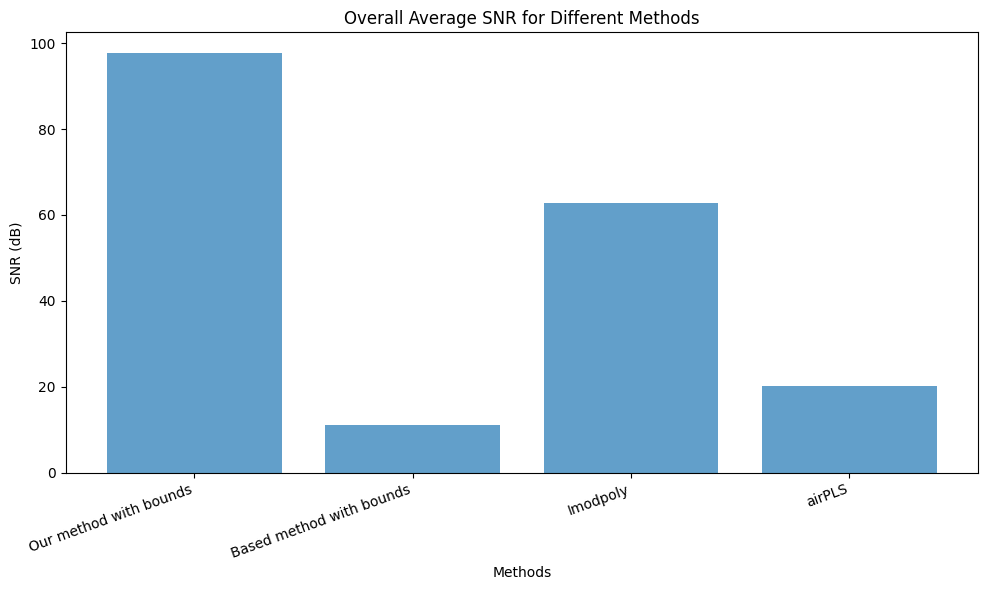

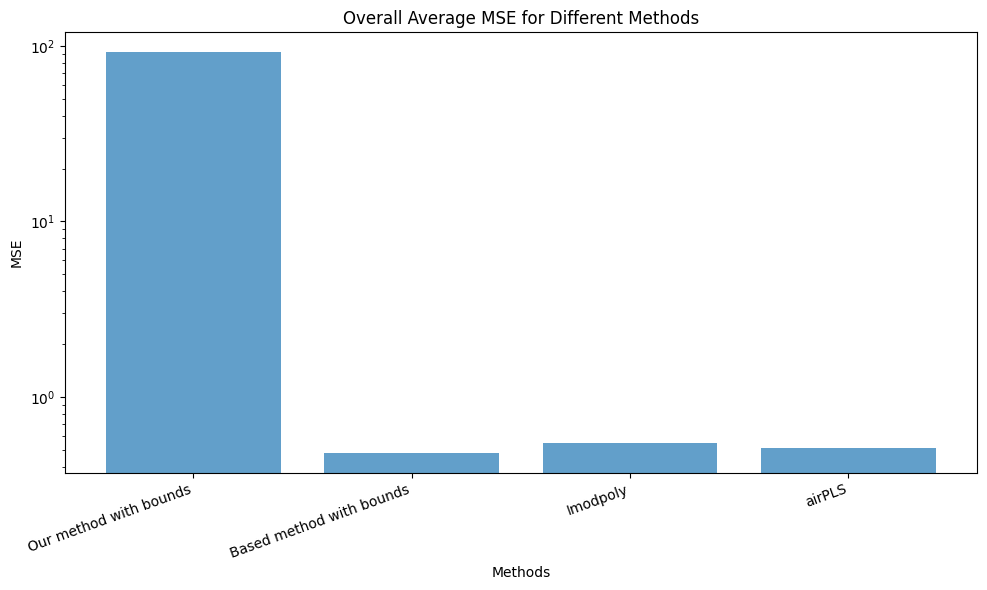

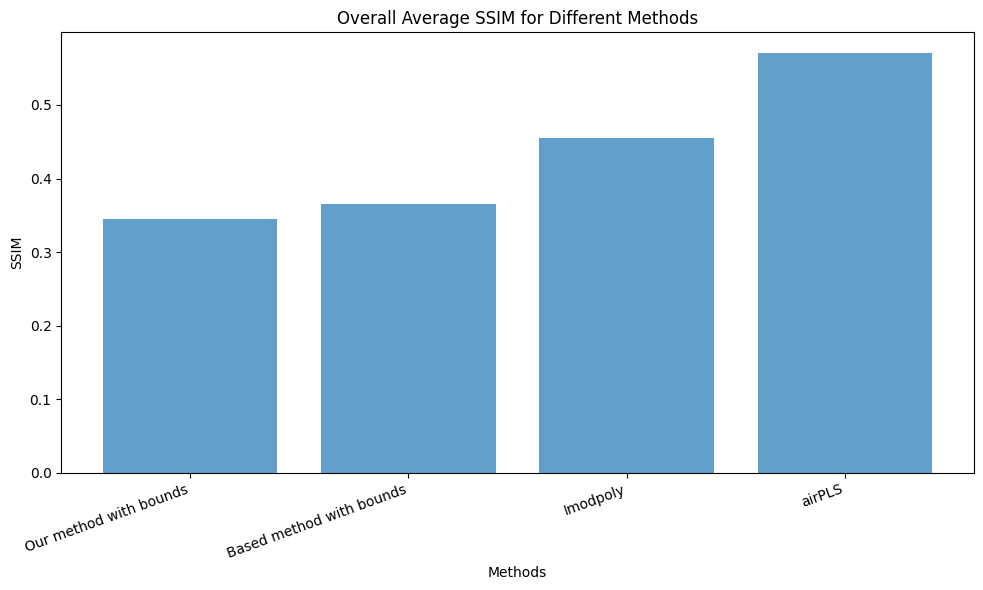

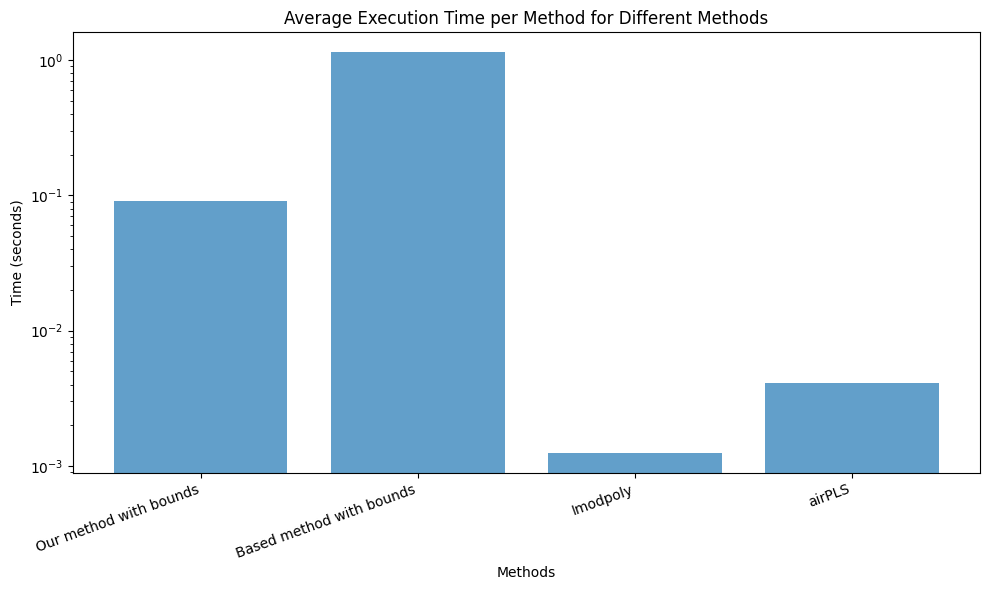

In [34]:
import matplotlib.pyplot as plt
import numpy as np

# Data
methods = ["Our method with bounds", "Based method with bounds", "Imodpoly", "airPLS"]
snr_values = [97.6463, 10.9804, 62.6977, 20.2425]
mse_values = [92.1821, 0.4805, 0.5440, 0.5106]
ssim_values = [0.3451, 0.3657, 0.4552, 0.5703]
execution_time = [0.091154, 1.140802, 0.001256, 0.004077]

# Creating the bar charts
def create_bar_chart(metric_values, metric_name, ylabel, log_scale=False):
    x_pos = np.arange(len(methods))
    plt.figure(figsize=(10, 6))
    plt.bar(x_pos, metric_values, alpha=0.7)
    plt.xticks(x_pos, methods, rotation=20, ha='right')
    plt.title(f"{metric_name} for Different Methods")
    plt.ylabel(ylabel)
    plt.xlabel("Methods")
    if log_scale:
        plt.yscale("log")
    plt.tight_layout()
    plt.show()

# Plot SNR
create_bar_chart(snr_values, "Overall Average SNR", "SNR (dB)")

# Plot MSE
create_bar_chart(mse_values, "Overall Average MSE", "MSE", log_scale=True)

# Plot SSIM
create_bar_chart(ssim_values, "Overall Average SSIM", "SSIM")

# Plot Execution Time
create_bar_chart(execution_time, "Average Execution Time per Method", "Time (seconds)", log_scale=True)


In [2]:
import numpy as np

def poly_baseline(x):
    p = np.random.uniform(1, 3)
    intensity = np.random.uniform(0.5, 1.5)
    b = np.random.uniform(-0.3, 0.3)
    y = (x / len(x)) ** p
    return (y / y.max()) * intensity + b, (p, intensity, b)

def negative_poly_baseline(x):
    p = np.random.uniform(1, 3)
    intensity = np.random.uniform(0.5, 1.5)
    b = np.random.uniform(-0.3, 0.3)
    y = (x / len(x)) ** p
    return (-y / y.max()) * intensity + b, (p, intensity, b)

def gaussian_baseline(x):
    mean = np.random.uniform(0, 50)
    sd = np.random.uniform(150, 250)
    intensity = np.random.uniform(0.5, 1.5)
    b = np.random.uniform(-0.3, 0.3)
    y = np.exp(-(x - mean) ** 2 / (2 * sd ** 2)) / (sd * np.sqrt(2 * np.pi))
    return (y / y.max()) * intensity + b, (mean, sd, intensity, b)

def generate_spectrum(input, num_baselines=3):
    x_range = np.linspace(0, input.shape[0] - 1, input.shape[0])
    
    while True:
        baseline_labels = np.random.randint(0, 2, size=num_baselines) 
        if np.any(baseline_labels != 0):  # Kiểm tra có ít nhất 1 baseline được áp dụng
            break

    baselines = [poly_baseline, negative_poly_baseline, gaussian_baseline]
    baseline_names = ["poly_baseline", "negative_poly_baseline", "gaussian_baseline"]

    noisy_spectrum = np.copy(input).flatten()
    applied_baselines = np.zeros_like(noisy_spectrum)

    baseline_details = []  # Lưu thông tin loại baseline và hệ số tương ứng

    for i in range(num_baselines):
        if baseline_labels[i] == 1:
            baseline_func = baselines[i]
            baseline_name = baseline_names[i]  # Lấy tên loại baseline
            baseline, coeffs = baseline_func(x_range)  # Sinh dữ liệu baseline và hệ số
            noisy_spectrum += baseline
            applied_baselines += baseline
            baseline_details.append((baseline_name, coeffs))  # Lưu tên và hệ số baseline
    
    return noisy_spectrum, baseline_labels, applied_baselines, baseline_details

In [3]:
import numpy as np
import pandas as pd

# Thiết lập số lượng mẫu cần sinh
num_samples = 3200
all_noisy_spectra = []
all_baseline_labels = []
all_baseline_applied = []
all_baseline_details = []

# Load dataset
Input_Data = './data/dataset_pure_132.npy'
Inputs = np.load(Input_Data)
Inputs = Inputs.reshape(-1, Inputs.shape[2], Inputs.shape[3], Inputs.shape[4])

# Danh sách các loại baseline có thể có và số lượng hệ số tương ứng
baseline_info = {
    "poly_baseline": 3,
    "negative_poly_baseline": 3,
    "gaussian_baseline": 4
}

# Sinh 3200 mẫu
sample_count = 0
for inputs in Inputs:
    if sample_count >= num_samples:
        break

    noisy_spectrum, baseline_labels, baseline_applied, baseline_details = generate_spectrum(inputs[1, :, :], num_baselines=3)

    all_baseline_labels.append(baseline_labels.flatten())
    all_noisy_spectra.append(noisy_spectrum.flatten())
    all_baseline_applied.append(baseline_applied.flatten())

    # Tạo dictionary để lưu thông tin các baseline
    baseline_dict = {name: [0] * num_coeffs for name, num_coeffs in baseline_info.items()}

    # Cập nhật hệ số cho các baseline đã được sử dụng
    for baseline_name, coeffs in baseline_details:
        if coeffs is not None:
            baseline_dict[baseline_name] = list(coeffs)

    # Ghi tất cả baseline (kể cả những cái không được dùng)
    for name, num_coeffs in baseline_info.items():
        # Đảm bảo đúng số lượng hệ số
        all_baseline_details.append([sample_count, name] + baseline_dict[name] + [None] * (4 - len(baseline_dict[name])))

    sample_count += 1  # Tăng số lượng mẫu đã sinh lên 1

# Chuyển đổi danh sách thành mảng numpy
all_baseline_labels = np.array(all_baseline_labels)
all_noisy_spectra = np.array(all_noisy_spectra)
all_baseline_applied = np.array(all_baseline_applied)

# Tạo DataFrame cho dữ liệu chính (labels, spectra, baselines)
df_labels = pd.DataFrame(all_baseline_labels)
df_spectra = pd.DataFrame(all_noisy_spectra)
df_basline = pd.DataFrame(all_baseline_applied)

# Kết hợp các DataFrame chính
df_main = pd.concat([df_labels, df_spectra, df_basline], axis=1)
df_main.to_csv('./data/Baseline_test_132.csv', index=False)
print('ok')

# Tạo DataFrame cho baseline details
df_baseline_details = pd.DataFrame(
    all_baseline_details, 
    columns=["Sample Index", "Baseline Type", "Coefficient 1", "Coefficient 2", "Coefficient 3", "Coefficient 4"]
)

# Lưu cả hai DataFrame vào file Excel, mỗi cái trên 1 sheet
with pd.ExcelWriter('./data/Baseline_test_132_detailed.xlsx') as writer:
    df_main.to_excel(writer, sheet_name='Main Data', index=False)
    df_baseline_details.to_excel(writer, sheet_name='Baseline Details', index=False)

print('Lưu thành công!')


ok
Lưu thành công!


In [10]:
import pandas as pd

# Đọc file CSV
df_baseline_details = pd.read_csv('./data/Baseline_test_112.csv')

# In 5 dòng đầu
print(df_baseline_details.head())


   0  1  2       0.1       1.1       2.1         3         4         5  \
0  1  0  1  1.019527  1.106141  1.072313  1.041834  1.075799  1.009825   
1  0  0  1  0.755494  0.735773  0.775022  0.752962  0.801936  0.771573   
2  1  0  1  0.980143  0.965916  0.989720  0.938075  0.946453  0.872937   
3  1  0  1  1.741552  1.810702  1.778609  1.760117  1.774092  1.752087   
4  1  1  1  0.361490  0.393061  0.396238  0.379370  0.337670  0.396197   

          6  ...     870.1     871.1     872.1     873.1     874.1     875.1  \
0  1.013563  ...  1.554827  1.559363  1.563909  1.568465  1.573030  1.577606   
1  0.731054  ... -0.282065 -0.282078 -0.282091 -0.282103 -0.282116 -0.282128   
2  0.924216  ...  1.272924  1.275257  1.277594  1.279933  1.282275  1.284619   
3  1.850442  ...  0.958318  0.959583  0.960848  0.962114  0.963382  0.964650   
4  0.353341  ...  0.271043  0.274245  0.277456  0.280676  0.283904  0.287141   

      876.1     877.1     878.1     879.1  
0  1.582192  1.586787  1.59139

In [50]:
# Dictionary chứa số lượng hệ số của từng loại baseline
baseline_param_count = {
    "poly_baseline": 3,
    "negative_poly_baseline": 3,
    "gaussian_baseline": 4,
    "pg_baseline": 6,
    "pd_baseline": 5,
    "dg_baseline": 6,
    "pdg_baseline": 8
}

# Hàm lưu thông tin hệ số dự đoán theo từng vòng lặp
def save_predicted_baseline(sample_index, iteration, baseline_name, params):
    num_params = len(params)
    all_predicted_baseline_details.append([sample_index, iteration, baseline_name] + list(params) + [None] * (8 - num_params))
def mix_min(sp, baseline):
    new_baseline = np.minimum(baseline,sp)    
    return new_baseline
# Hàm fitting với lưu thông tin hệ số
def iterative_fitting_with_bounds(sp, ite, sample_index, threshold=0.005):
    x = np.linspace(1, 880, 880)  
    tempb = sp.copy()
    Previous_Dev = float('inf')  
    fitted_baseline = np.zeros(880)
    
    torch_tempb = np.expand_dims(tempb, axis=0)
   
    for i in range(ite):
        # Dự đoán loại baseline từ mô hình
        tadvice = model(torch_tempb)

        # Chọn baseline function dựa trên dự đoán
        if tadvice[0][0] > 0.5 and tadvice[0][1] > 0.5 and tadvice[0][2] > 0.5:
            baseline_name = "pdg_baseline"
            p, _ = curve_fit(pdg_baseline, x, tempb,
                             bounds=([1, 0.5, 1, 0.5, 0, 150, 0.5, -0.3],
                                     [3, 2, 3, 2, 50, 250, 2, 0.3]))
            fitted_baseline = pdg_baseline(x, *p)

        elif tadvice[0][0] > 0.5 and tadvice[0][1] > 0.5:
            baseline_name = "pd_baseline"
            p, _ = curve_fit(pd_baseline, x, tempb,
                             bounds=([1, 0.5, 1, 0.5, -0.3],
                                     [3, 2, 3, 2, 0.3]))
            fitted_baseline = pd_baseline(x, *p)

        elif tadvice[0][0] > 0.5 and tadvice[0][2] > 0.5:
            baseline_name = "pg_baseline"
            p, _ = curve_fit(pg_baseline, x, tempb,
                             bounds=([1, 0.5, 0, 150, 0.5, -0.3],
                                     [3, 2, 50, 250, 2, 0.3]))
            fitted_baseline = pg_baseline(x, *p)

        elif tadvice[0][1] > 0.5 and tadvice[0][2] > 0.5:
            baseline_name = "dg_baseline"
            p, _ = curve_fit(dg_baseline, x, tempb,
                             bounds=([1, 0.5, 0, 150, 0.5, -0.3],
                                     [3, 2, 50, 250, 2, 0.3]))
            fitted_baseline = dg_baseline(x, *p)

        elif tadvice[0][0] > 0.5:
            baseline_name = "poly_baseline"
            p, _ = curve_fit(poly_baseline, x, tempb,
                             bounds=([1, 0.5, -0.3], [3, 2, 0.3]))
            fitted_baseline = poly_baseline(x, *p)

        elif tadvice[0][1] > 0.5:
            baseline_name = "negative_poly_baseline"
            p, _ = curve_fit(negative_poly_baseline, x, tempb,
                             bounds=([1, 0.5, -0.3], [3, 2, 0.3]))
            fitted_baseline = negative_poly_baseline(x, *p)

        elif tadvice[0][2] > 0.5:
            baseline_name = "gaussian_baseline"
            p, _ = curve_fit(gaussian_baseline, x, tempb,
                             bounds=([0, 150, 0.5, -0.3], [50, 250, 2, 0.3]))
            fitted_baseline = gaussian_baseline(x, *p)

        else:
            continue  # Không áp dụng baseline nào

        # Lưu hệ số dự đoán vào danh sách
        save_predicted_baseline(sample_index, i, baseline_name, p)

        # Cập nhật giá trị phổ để tiếp tục lặp
        Dev = np.std(tempb - fitted_baseline)
        tempb = mix_min(sp, fitted_baseline)
        
        torch_tempb = np.expand_dims(tempb, axis=0)

        # Kiểm tra điều kiện dừng sớm
        if i > 0 and np.abs((Dev - Previous_Dev) / Dev) < threshold:
            break
        Previous_Dev = Dev

    return fitted_baseline

In [ ]:
all_predicted_baseline_details = []
# Lặp qua từng phổ trong tập dữ liệu
for i in range(3200):
    print(i)
    sample_data = x_train[i]  
    true_data = input2[i] / max(input2[i])  
    B = iterative_fitting_with_bounds(sample_data, 100, sample_index=i)
    print("---------------")

# Tạo DataFrame từ danh sách lưu hệ số dự đoán
max_params = max(baseline_param_count.values())  # Tìm số hệ số lớn nhất (VD: 8)

df_predicted_baseline = pd.DataFrame(
    all_predicted_baseline_details, 
    columns=["Sample Index", "Iteration", "Baseline Type"] + [f"Coefficient {i+1}" for i in range(max_params)]
)

# Lưu vào file Excel
with pd.ExcelWriter('./data/Baseline_predicted_details_1.xlsx') as writer:
    df_predicted_baseline.to_excel(writer, sheet_name='Predicted Baseline', index=False)

print('Lưu thành công file dự đoán hệ số!')


0
---------------
1
---------------
2
---------------
3
---------------
4
---------------
5
---------------
6
---------------
7
---------------
8
---------------
9
---------------
10
---------------
11
---------------
12
---------------
13
---------------
14
---------------
15
---------------
16
---------------
17
---------------
18
---------------
19
---------------
20
---------------
21
---------------
22
---------------
23
---------------
24
---------------
25
---------------
26
---------------
27
---------------
28
---------------
29
---------------
30
---------------
31
---------------
32
---------------
33
---------------
34
---------------
35
---------------
36
---------------
37
---------------
38
---------------
39
---------------
40
---------------
41
---------------
42
---------------
43
---------------
44
---------------
45
---------------
46
---------------
47
---------------
48
---------------
49
---------------
50
---------------
51
---------------
52
---------------
53


In [32]:
# Đọc dữ liệu từ file Excel của true baseline
true_baseline_path = "./data/Baseline_test_132_detailed.xlsx"
df_true = pd.read_excel(true_baseline_path, sheet_name="Baseline Details")

# Đọc dữ liệu từ file Excel của predicted baseline
predicted_baseline_path = "./data/Baseline_predicted_details.xlsx"
df_predicted = pd.read_excel(predicted_baseline_path, sheet_name="Predicted Baseline")

# Chuẩn hóa tên cột để tránh lỗi
df_true.columns = df_true.columns.str.strip()
df_predicted.columns = df_predicted.columns.str.strip()

# Danh sách baseline chính cần giữ lại
baseline_core = ["poly_baseline", "negative_poly_baseline", "gaussian_baseline"]

# Lọc dữ liệu của true và predicted chỉ gồm các baseline cần thiết
df_true_filtered = df_true[df_true["Baseline Type"].isin(baseline_core)]
df_predicted_filtered = df_predicted[df_predicted["Baseline Type"].isin(baseline_core)]

# Lấy bản cập nhật mới nhất của mỗi baseline cho mỗi Sample Index
df_predicted_latest = df_predicted_filtered.groupby(["Sample Index", "Baseline Type"]).last().reset_index()

# Tạo một danh sách chứa dữ liệu mới
data_rows = []

# Lấy danh sách Sample Index duy nhất
sample_indices = df_true_filtered["Sample Index"].unique()

# Xây dựng DataFrame theo định dạng yêu cầu
columns = ["Sample Index", "Baseline Type"] + [f"True Coefficient {i+1}" for i in range(8)] + [f"Predicted Coefficient {i+1}" for i in range(8)]
df_final = pd.DataFrame(columns=columns)

# Lặp qua từng Sample Index để đảm bảo mỗi baseline đều có mặt
for sample in sample_indices:
    for baseline in baseline_core:
        row_data = {"Sample Index": sample, "Baseline Type": baseline}

        # Lấy dữ liệu True
        true_data = df_true_filtered[(df_true_filtered["Sample Index"] == sample) & (df_true_filtered["Baseline Type"] == baseline)]
        if not true_data.empty:
            true_values = true_data.iloc[0, 2:].values  # Lấy hệ số thực tế
        else:
            true_values = [0] * 8  # Nếu baseline không tồn tại, đặt tất cả hệ số bằng 0

        # Lấy dữ liệu Predicted
        predicted_data = df_predicted_latest[(df_predicted_latest["Sample Index"] == sample) & (df_predicted_latest["Baseline Type"] == baseline)]
        if not predicted_data.empty:
            predicted_values = predicted_data.iloc[0, 2:].values  # Lấy hệ số dự đoán
        else:
            predicted_values = [0] * 8  # Nếu baseline không tồn tại, đặt tất cả hệ số bằng 0

        # Gán hệ số vào row_data
        for i, val in enumerate(true_values):
            row_data[f"True Coefficient {i+1}"] = val

        for i, val in enumerate(predicted_values):
            row_data[f"Predicted Coefficient {i+1}"] = val

        # Thêm hàng dữ liệu vào danh sách
        data_rows.append(row_data)

# Chuyển danh sách sang DataFrame
df_final = pd.DataFrame(data_rows)

# Lưu vào file Excel theo định dạng mới
output_path = "./data/Baseline_comparison.xlsx"
df_final.to_excel(output_path, index=False)

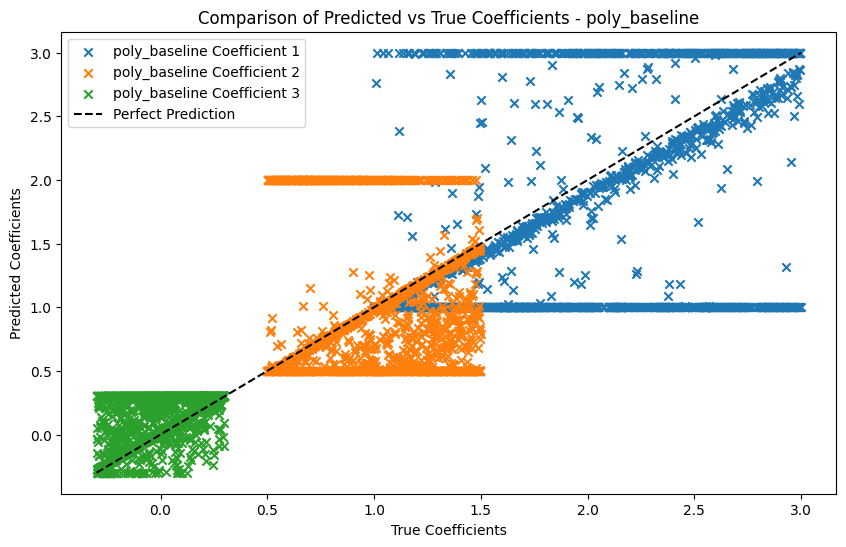

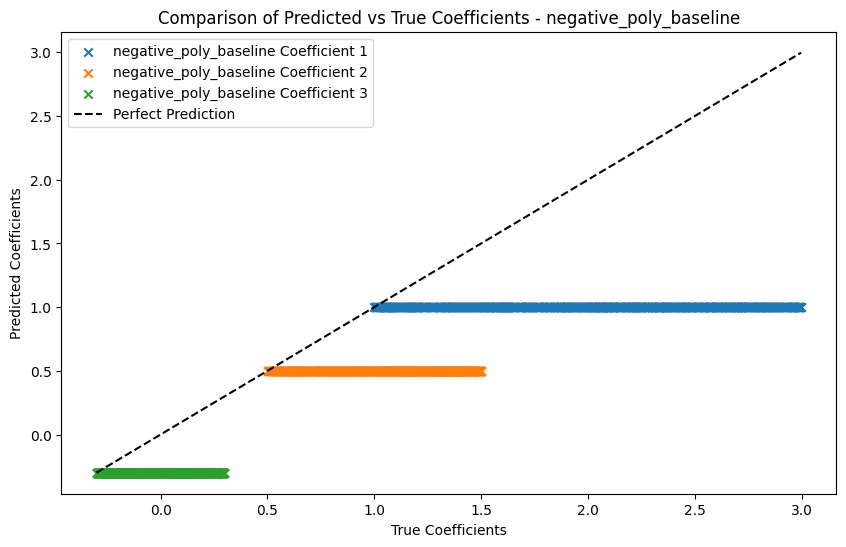

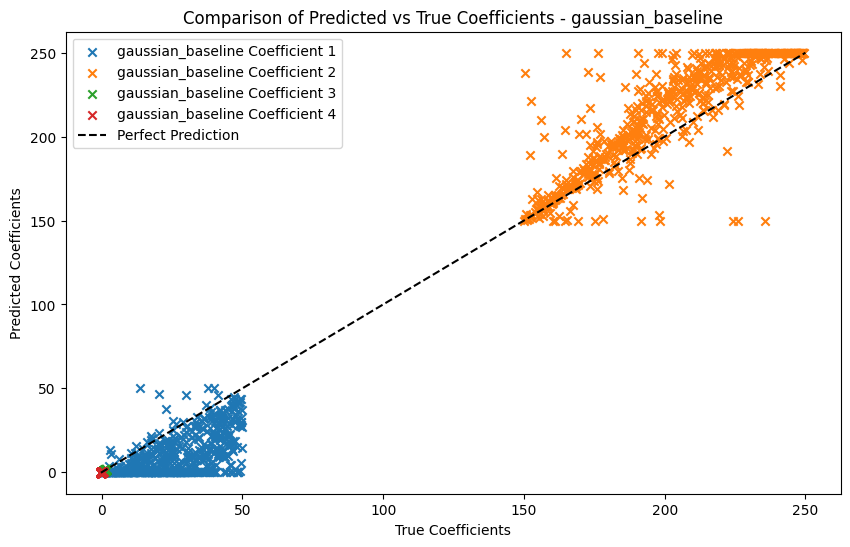

In [48]:
# Đọc lại dữ liệu từ file Excel mới được tải lên
file_path = "./data/Baseline_comparison.xlsx"
df_data = pd.read_excel(file_path, sheet_name="Sheet1")

# Điền các giá trị NaN thành 0 để tránh lỗi khi tính toán
df_data.fillna(0, inplace=True)

# Xác định các loại baseline có trong dữ liệu
baseline_types = df_data["Baseline Type"].unique()

# Tính số lần mô hình dự đoán đúng sự xuất hiện của baseline
df_data["Correct_Presence"] = (
    ((df_data.filter(like="True Coefficient") != 0).sum(axis=1) > 0) &
    ((df_data.filter(like="Predicted Coefficient") != 0).sum(axis=1) > 0)
) | (
    ((df_data.filter(like="True Coefficient") == 0).sum(axis=1) == df_data.filter(like="True Coefficient").shape[1]) &
    ((df_data.filter(like="Predicted Coefficient") == 0).sum(axis=1) == df_data.filter(like="Predicted Coefficient").shape[1])
)

# Tổng số lần dự đoán đúng sự xuất hiện của baseline
total_correct_predictions = df_data["Correct_Presence"].sum()
total_samples = len(df_data)

# Chuẩn bị dữ liệu để vẽ biểu đồ so sánh hệ số dự đoán và thực tế
df_valid = df_data[df_data["Correct_Presence"] & (df_data.filter(like="Predicted Coefficient").sum(axis=1) > 0)]

# Vẽ lại biểu đồ đảm bảo hiển thị hệ số âm nếu có
for baseline in baseline_types:
    df_baseline = df_valid[df_valid["Baseline Type"] == baseline]
    
    if not df_baseline.empty:
        plt.figure(figsize=(10, 6))
        
        # Xác định số hệ số đúng cho baseline này, bỏ hệ số thứ 4 nếu là hàm poly
        num_coefficients = len([col for col in df_baseline.columns if "True Coefficient" in col])
        if "poly_baseline" in baseline or "negative_poly_baseline" in baseline:
            num_coefficients = 3  # Các hàm poly chỉ có 3 hệ số, bỏ hệ số thứ 4 nếu có

        # Lấy danh sách hệ số thực tế và dự đoán
        true_coeffs = [f"True Coefficient {i}" for i in range(1, num_coefficients + 1)]
        pred_coeffs = [f"Predicted Coefficient {i}" for i in range(1, num_coefficients + 1)]
        
        # Tìm min/max để đảm bảo trục hiển thị đúng kể cả với số âm
        min_val = min(df_baseline[true_coeffs].values.min(), df_baseline[pred_coeffs].values.min())
        max_val = max(df_baseline[true_coeffs].values.max(), df_baseline[pred_coeffs].values.max())

        # Chỉ vẽ nếu hệ số có giá trị khác 0
        for i, (t_col, p_col) in enumerate(zip(true_coeffs, pred_coeffs), start=1):
            if df_baseline[[t_col, p_col]].sum().sum() != 0:  # Nếu có ít nhất một giá trị khác 0 thì vẽ
                plt.scatter(df_baseline[t_col], df_baseline[p_col], label=f"{baseline} Coefficient {i}", marker='x')

        # Đường dự đoán hoàn hảo
        plt.plot([min_val, max_val], [min_val, max_val], 'k--', label="Perfect Prediction")

      
        plt.xlabel("True Coefficients")
        plt.ylabel("Predicted Coefficients")
        plt.legend()
        plt.title(f"Comparison of Predicted vs True Coefficients - {baseline}")
        plt.show()


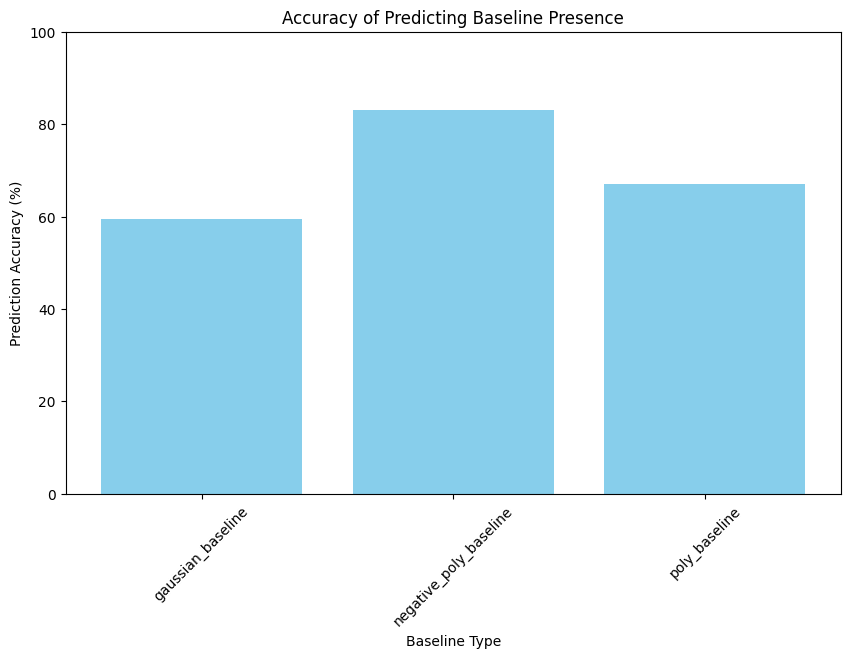

In [36]:
import matplotlib.pyplot as plt
import numpy as np

# Đếm số lần mỗi baseline có mặt thực tế và số lần dự đoán đúng sự xuất hiện
baseline_counts = df_data.groupby("Baseline Type")["Correct_Presence"].sum()
total_baseline_counts = df_data["Baseline Type"].value_counts()

# Tính tỷ lệ dự đoán đúng của từng baseline
baseline_accuracy = (baseline_counts / total_baseline_counts) * 100

# Vẽ biểu đồ thể hiện độ chính xác dự đoán sự xuất hiện của từng baseline
plt.figure(figsize=(10, 6))
plt.bar(baseline_accuracy.index, baseline_accuracy.values, color='skyblue')
plt.xlabel("Baseline Type")
plt.ylabel("Prediction Accuracy (%)")
plt.title("Accuracy of Predicting Baseline Presence")
plt.xticks(rotation=45)
plt.ylim(0, 100)
plt.show()

